In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

1. **load and investigate the data**

In [2]:
tennis = pd.read_csv('/home/roshan/Desktop/Supervisedlearning/supervisedlearning/tennis_stats.csv')
tennis.head()


,Player,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
0,Pedro Sousa,2016,0.88,0.50,0.38,0.50,0.39,0,0.14,7,...,0.11,0.38,8,0.50,0.43,0.50,1,2,39820,119
1,Roman Safiullin,2017,0.84,0.62,0.26,0.33,0.07,7,0.00,7,...,0.00,0.20,9,0.67,0.41,0.57,0,1,17334,381
2,Pedro Sousa,2017,0.83,0.60,0.28,0.53,0.44,2,0.38,10,...,0.16,0.34,17,0.65,0.45,0.59,4,1,109827,119
3,Rogerio Dutra Silva,2010,0.83,0.64,0.34,0.59,0.33,2,0.33,5,...,0.14,0.34,15,0.80,0.49,0.63,0,0,9761,125
4,Daniel Gimeno-Traver,2017,0.81,0.54,0.00,0.33,0.33,1,0.00,2,...,0.00,0.20,2,0.50,0.35,0.50,0,1,32879,272


In [3]:
tennis.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1721 entries, 0 to 1720
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Player                      1721 non-null   object 
 1   Year                        1721 non-null   int64  
 2   FirstServe                  1721 non-null   float64
 3   FirstServePointsWon         1721 non-null   float64
 4   FirstServeReturnPointsWon   1721 non-null   float64
 5   SecondServePointsWon        1721 non-null   float64
 6   SecondServeReturnPointsWon  1721 non-null   float64
 7   Aces                        1721 non-null   int64  
 8   BreakPointsConverted        1721 non-null   float64
 9   BreakPointsFaced            1721 non-null   int64  
 10  BreakPointsOpportunities    1721 non-null   int64  
 11  BreakPointsSaved            1721 non-null   float64
 12  DoubleFaults                1721 non-null   int64  
 13  ReturnGamesPlayed           1721 

In [4]:
tennis.describe()

,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,BreakPointsOpportunities,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
count,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,...,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1.721000e+03,1721.000000
mean,2013.646717,0.598053,0.680738,0.261673,0.479733,0.466432,97.105171,0.369407,112.003486,102.918071,...,0.173823,0.342208,197.650203,0.715590,0.473155,0.599245,7.876816,9.278908,2.344928e+05,269.610691
std,2.488018,0.054533,0.070422,0.056639,0.066902,0.068447,137.966077,0.162987,119.247651,122.761670,...,0.080880,0.049369,221.208703,0.123287,0.037139,0.057718,10.183716,8.996450,2.530537e+05,277.341947
min,2009.000000,0.360000,0.270000,0.000000,0.060000,0.000000,0.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.220000,0.250000,0.000000,0.000000,1.080000e+02,3.000000
25%,2012.000000,0.570000,0.650000,0.240000,0.460000,0.440000,7.000000,0.320000,15.000000,9.000000,...,0.130000,0.320000,22.000000,0.670000,0.460000,0.570000,0.000000,2.000000,4.931100e+04,83.000000
50%,2014.000000,0.600000,0.690000,0.270000,0.490000,0.480000,34.000000,0.380000,55.000000,41.000000,...,0.180000,0.350000,86.000000,0.750000,0.480000,0.610000,3.000000,5.000000,1.252120e+05,166.000000
75%,2016.000000,0.630000,0.720000,0.290000,0.520000,0.500000,140.000000,0.430000,201.000000,172.000000,...,0.220000,0.370000,348.000000,0.790000,0.500000,0.630000,13.000000,17.000000,3.500750e+05,333.000000
max,2017.000000,0.880000,0.890000,0.480000,0.920000,0.750000,1185.000000,1.000000,507.000000,573.000000,...,0.560000,0.510000,916.000000,1.000000,0.820000,0.820000,48.000000,36.000000,1.074562e+06,1443.000000


In [5]:
tennis.columns

Index(['Player', 'Year', 'FirstServe', 'FirstServePointsWon',
       'FirstServeReturnPointsWon', 'SecondServePointsWon',
       'SecondServeReturnPointsWon', 'Aces', 'BreakPointsConverted',
       'BreakPointsFaced', 'BreakPointsOpportunities', 'BreakPointsSaved',
       'DoubleFaults', 'ReturnGamesPlayed', 'ReturnGamesWon',
       'ReturnPointsWon', 'ServiceGamesPlayed', 'ServiceGamesWon',
       'TotalPointsWon', 'TotalServicePointsWon', 'Wins', 'Losses', 'Winnings',
       'Ranking'],
      dtype='object')

In [6]:
tennis.index

RangeIndex(start=0, stop=1721, step=1)

2. **Perform exploratory analysis on the data by plotting different features against the different outcomes. What relationships do you find between the features and outcomes? Do any of the features seem to predict the outcomes?**

Since the features 'Player and 'Year' help in identifying data and the features 'Wins', 'Losses', 'Winnings', 'Ranking' represent outcomes, here I keep these features in separate lists

In [7]:
#Identifier
identify = [i for i in tennis.columns[0:2]]

In [8]:
identify

['Player', 'Year']

In [9]:
#features
features = [ i for i in tennis.columns[2:-4]]

In [10]:
features

['FirstServe',
 'FirstServePointsWon',
 'FirstServeReturnPointsWon',
 'SecondServePointsWon',
 'SecondServeReturnPointsWon',
 'Aces',
 'BreakPointsConverted',
 'BreakPointsFaced',
 'BreakPointsOpportunities',
 'BreakPointsSaved',
 'DoubleFaults',
 'ReturnGamesPlayed',
 'ReturnGamesWon',
 'ReturnPointsWon',
 'ServiceGamesPlayed',
 'ServiceGamesWon',
 'TotalPointsWon',
 'TotalServicePointsWon']

In [11]:
#outcomes 
outcomes = [i for i in tennis.columns[-4:]]

In [12]:
outcomes

['Wins', 'Losses', 'Winnings', 'Ranking']

In [13]:
#Computing Pearson's correlation coefficient between features and outcomes
from scipy.stats import pearsonr
coeffs = []

for i in features:
    for j in outcomes:
        print(j+" vs "+i)
        print(pearsonr(tennis[i].values, tennis[j].values))
        coeffs.append([pearsonr(tennis[i].values, tennis[j].values)[0],i+' and '+j])
        print()



Wins vs FirstServe
(0.06483207778248018, 0.007135973821769212)

Losses vs FirstServe
(0.053736051077603035, 0.02579875806571636)

Winnings vs FirstServe
(0.05788214662085266, 0.016327737412652227)

Ranking vs FirstServe
(-0.06875861131845785, 0.004320625174664476)

Wins vs FirstServePointsWon
(0.35670162887564455, 8.531351014952202e-53)

Losses vs FirstServePointsWon
(0.3305809897996198, 3.663567991968624e-45)

Winnings vs FirstServePointsWon
(0.36112105949290035, 3.6850401189801415e-54)

Ranking vs FirstServePointsWon
(-0.1500039486700047, 4.00589328011312e-10)

Wins vs FirstServeReturnPointsWon
(0.2560289994722633, 3.673041035102105e-27)

Losses vs FirstServeReturnPointsWon
(0.2432784787577664, 1.3223045161364526e-24)

Winnings vs FirstServeReturnPointsWon
(0.24080834046115276, 3.9792957834193536e-24)

Ranking vs FirstServeReturnPointsWon
(-0.17866426231103497, 8.226634374912317e-14)

Wins vs SecondServePointsWon
(0.268978699538004, 6.579673489027201e-30)

Losses vs SecondServePoints

In [14]:
coeffs

[[0.06483207778248018, 'FirstServe and Wins'],
 [0.053736051077603035, 'FirstServe and Losses'],
 [0.05788214662085266, 'FirstServe and Winnings'],
 [-0.06875861131845785, 'FirstServe and Ranking'],
 [0.35670162887564455, 'FirstServePointsWon and Wins'],
 [0.3305809897996198, 'FirstServePointsWon and Losses'],
 [0.36112105949290035, 'FirstServePointsWon and Winnings'],
 [-0.1500039486700047, 'FirstServePointsWon and Ranking'],
 [0.2560289994722633, 'FirstServeReturnPointsWon and Wins'],
 [0.2432784787577664, 'FirstServeReturnPointsWon and Losses'],
 [0.24080834046115276, 'FirstServeReturnPointsWon and Winnings'],
 [-0.17866426231103497, 'FirstServeReturnPointsWon and Ranking'],
 [0.268978699538004, 'SecondServePointsWon and Wins'],
 [0.2509178795903475, 'SecondServePointsWon and Losses'],
 [0.28121480882884614, 'SecondServePointsWon and Winnings'],
 [-0.1810129228936526, 'SecondServePointsWon and Ranking'],
 [0.19309266293883165, 'SecondServeReturnPointsWon and Wins'],
 [0.185217123881

In [15]:
coeffs.sort(reverse = True)

In [16]:
coeffs

[[0.9433086885312065, 'BreakPointsFaced and Losses'],
 [0.9367552157905942, 'ReturnGamesPlayed and Losses'],
 [0.9351823440696653, 'ServiceGamesPlayed and Losses'],
 [0.9291525358241296, 'ServiceGamesPlayed and Wins'],
 [0.928407622580666, 'ReturnGamesPlayed and Wins'],
 [0.923453317366967, 'BreakPointsOpportunities and Wins'],
 [0.912984937841333, 'ServiceGamesPlayed and Winnings'],
 [0.9126126236635087, 'ReturnGamesPlayed and Winnings'],
 [0.9092952673707846, 'BreakPointsOpportunities and Losses'],
 [0.9004439010037777, 'BreakPointsOpportunities and Winnings'],
 [0.8834699298437749, 'BreakPointsFaced and Wins'],
 [0.8819221007707468, 'DoubleFaults and Losses'],
 [0.8760356989199047, 'BreakPointsFaced and Winnings'],
 [0.8546851784438939, 'DoubleFaults and Winnings'],
 [0.8474593354009934, 'DoubleFaults and Wins'],
 [0.825301192248861, 'Aces and Wins'],
 [0.7984043540699403, 'Aces and Winnings'],
 [0.7686283347845096, 'Aces and Losses'],
 [0.46106082878124993, 'TotalPointsWon and Winn

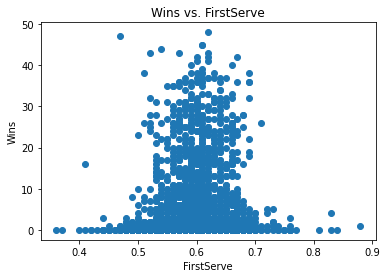

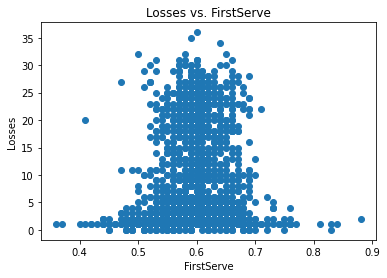

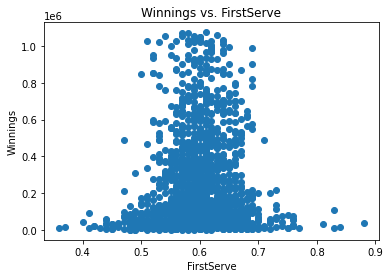

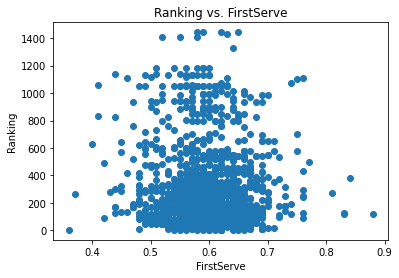

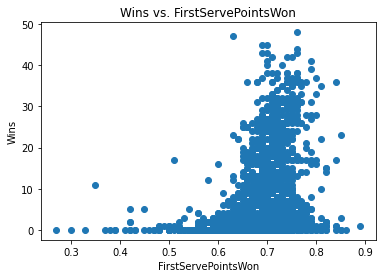

...

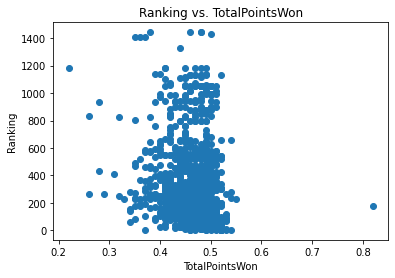

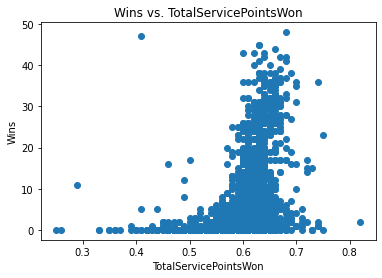

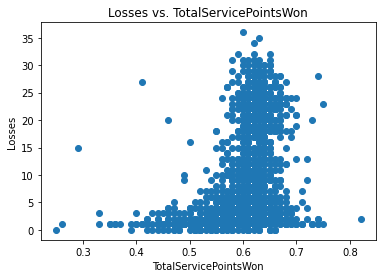

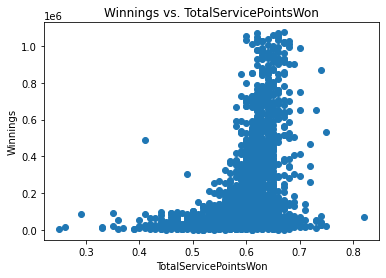

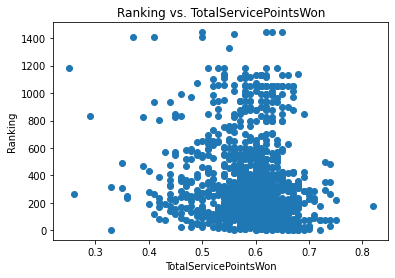

<Figure size 432x288 with 0 Axes>

In [17]:
for i in features:
    for j in outcomes:
        plt.scatter(tennis[i],tennis[j])
        plt.xlabel(i)
        plt.ylabel(j)
        plt.title('{} vs. {}'.format(j,i))
        plt.show()
        plt.clf()

### Single feature linear regression (all features)

Train score for predicting Wins from FirstServe:  0.005035393663308185
Test score for predicting Wins from FirstServe:  0.0011847338040879007 



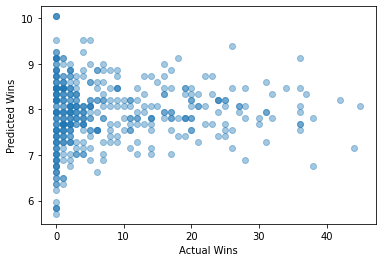

Train score for predicting Losses from FirstServe:  0.003401416627611953
Test score for predicting Losses from FirstServe:  0.001119558433536283 



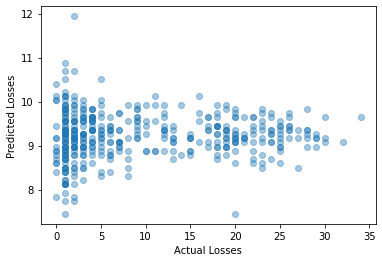

Train score for predicting Winnings from FirstServe:  0.007098857616613441
Test score for predicting Winnings from FirstServe:  -0.01386831492540419 



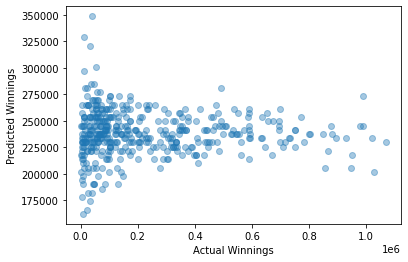

Train score for predicting Ranking from FirstServe:  0.002513126066682303
Test score for predicting Ranking from FirstServe:  0.007535584414974261 



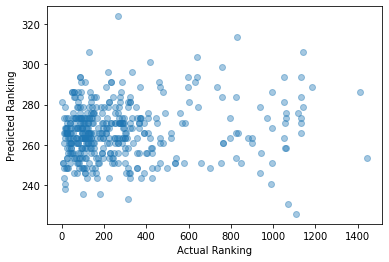

Train score for predicting Wins from FirstServePointsWon:  0.12976842773608255
Test score for predicting Wins from FirstServePointsWon:  0.11447161087689282 



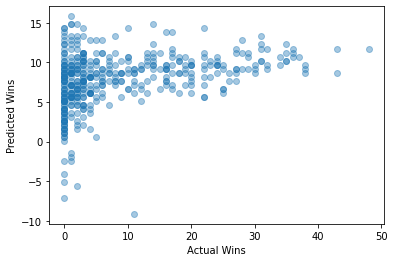

Train score for predicting Losses from FirstServePointsWon:  0.10911061854864246
Test score for predicting Losses from FirstServePointsWon:  0.10531532711510727 



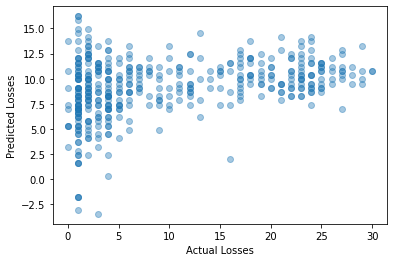

Train score for predicting Winnings from FirstServePointsWon:  0.13045868364718127
Test score for predicting Winnings from FirstServePointsWon:  0.1273850466405395 



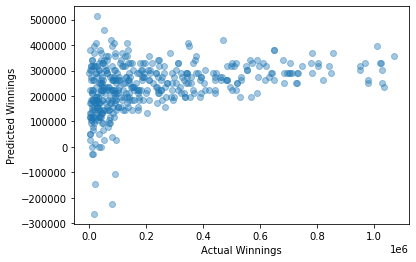

Train score for predicting Ranking from FirstServePointsWon:  0.022385415230944394
Test score for predicting Ranking from FirstServePointsWon:  0.022666430331350518 



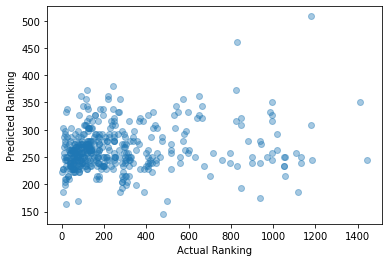

Train score for predicting Wins from FirstServeReturnPointsWon:  0.0615708201853753
Test score for predicting Wins from FirstServeReturnPointsWon:  0.07532802308067299 



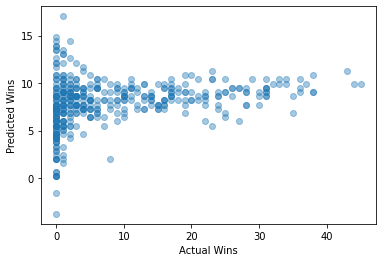

Train score for predicting Losses from FirstServeReturnPointsWon:  0.06169989656032826
Test score for predicting Losses from FirstServeReturnPointsWon:  0.05048784950484031 



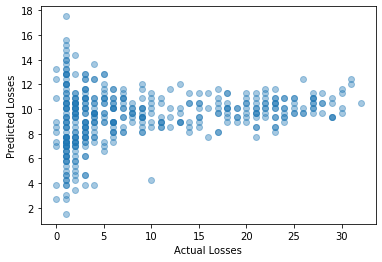

Train score for predicting Winnings from FirstServeReturnPointsWon:  0.054136685397433985
Test score for predicting Winnings from FirstServeReturnPointsWon:  0.06908529715479461 



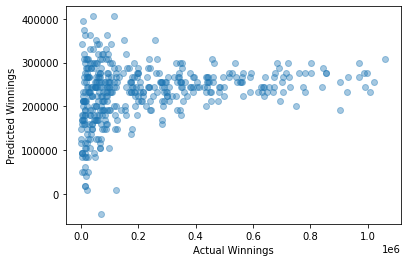

Train score for predicting Ranking from FirstServeReturnPointsWon:  0.024915122210307894
Test score for predicting Ranking from FirstServeReturnPointsWon:  0.05021507164608019 



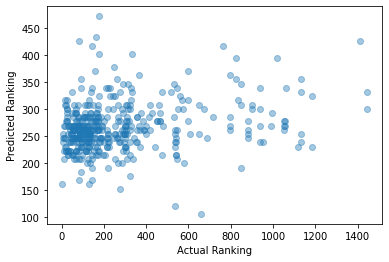

Train score for predicting Wins from SecondServePointsWon:  0.07633169214381408
Test score for predicting Wins from SecondServePointsWon:  0.060022247602027345 



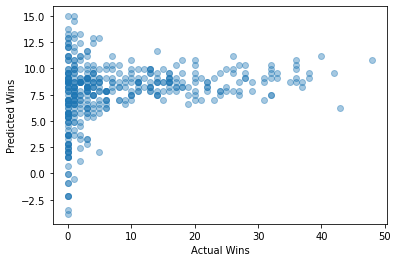

Train score for predicting Losses from SecondServePointsWon:  0.06534401149092428
Test score for predicting Losses from SecondServePointsWon:  0.05564777386475239 



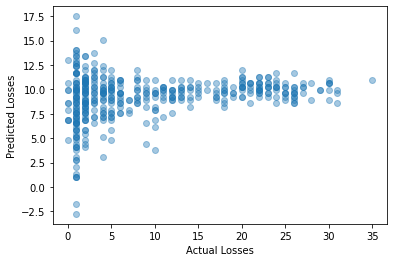

Train score for predicting Winnings from SecondServePointsWon:  0.07133370262908023
Test score for predicting Winnings from SecondServePointsWon:  0.08463014100761157 



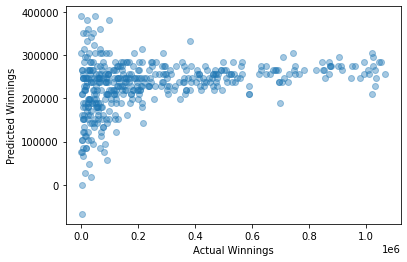

Train score for predicting Ranking from SecondServePointsWon:  0.03359949427608977
Test score for predicting Ranking from SecondServePointsWon:  0.030294676524411868 



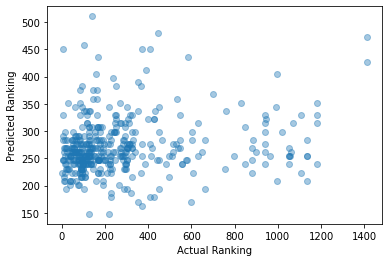

Train score for predicting Wins from SecondServeReturnPointsWon:  0.03166264690874698
Test score for predicting Wins from SecondServeReturnPointsWon:  0.04962680526620156 



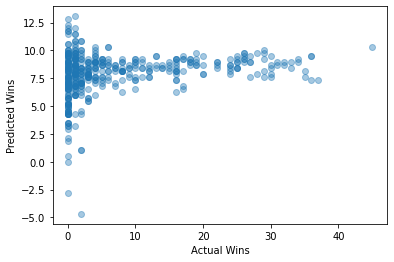

Train score for predicting Losses from SecondServeReturnPointsWon:  0.026261873393321755
Test score for predicting Losses from SecondServeReturnPointsWon:  0.05193549872201009 



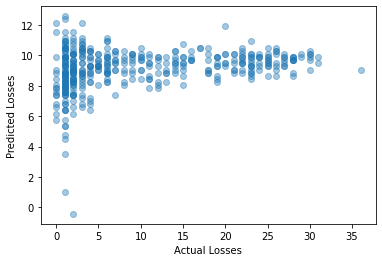

Train score for predicting Winnings from SecondServeReturnPointsWon:  0.04236409685957121
Test score for predicting Winnings from SecondServeReturnPointsWon:  0.03156330784495365 



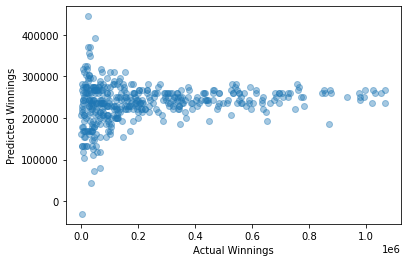

Train score for predicting Ranking from SecondServeReturnPointsWon:  0.030307226805296076
Test score for predicting Ranking from SecondServeReturnPointsWon:  0.003709425954284917 



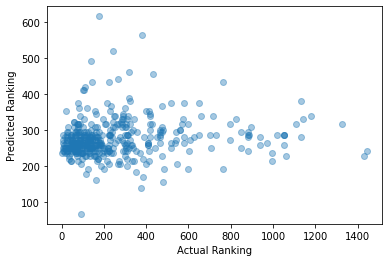

Train score for predicting Wins from Aces:  0.6719933969108551
Test score for predicting Wins from Aces:  0.7083084839251008 



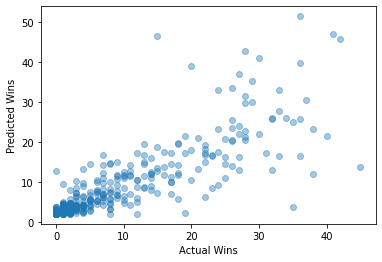

Train score for predicting Losses from Aces:  0.5995333166816004
Test score for predicting Losses from Aces:  0.5586076812465652 



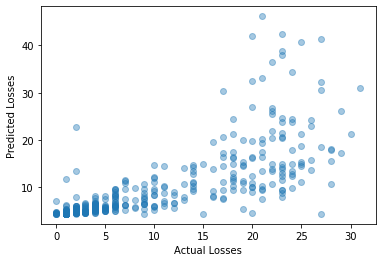

Train score for predicting Winnings from Aces:  0.6179239052238581
Test score for predicting Winnings from Aces:  0.6929715626398075 



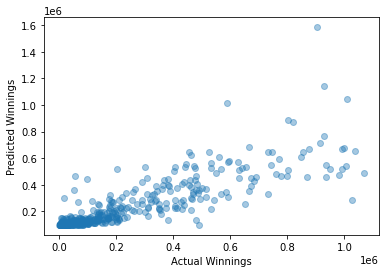

Train score for predicting Ranking from Aces:  0.08318469751271229
Test score for predicting Ranking from Aces:  0.04318834859492371 



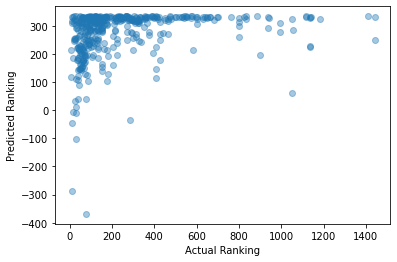

Train score for predicting Wins from BreakPointsConverted:  0.007216779356087
Test score for predicting Wins from BreakPointsConverted:  -0.008550401174873823 



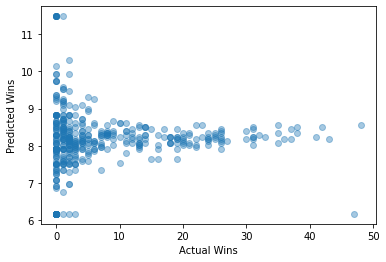

Train score for predicting Losses from BreakPointsConverted:  0.003409386038312645
Test score for predicting Losses from BreakPointsConverted:  0.004754322925189958 



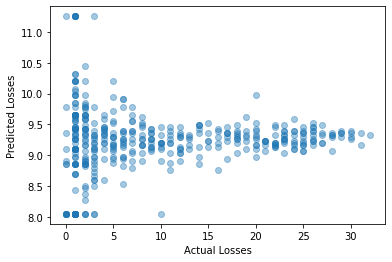

Train score for predicting Winnings from BreakPointsConverted:  0.007949123052003015
Test score for predicting Winnings from BreakPointsConverted:  -0.006049384714188699 



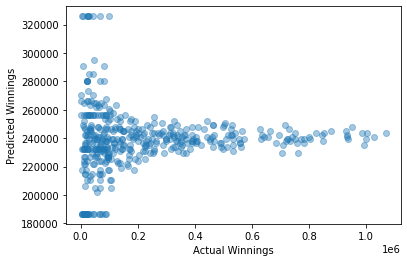

Train score for predicting Ranking from BreakPointsConverted:  0.002023729792180129
Test score for predicting Ranking from BreakPointsConverted:  -0.0059917462637859575 



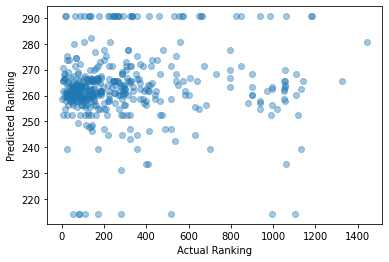

Train score for predicting Wins from BreakPointsFaced:  0.775043595458599
Test score for predicting Wins from BreakPointsFaced:  0.7968173494370436 



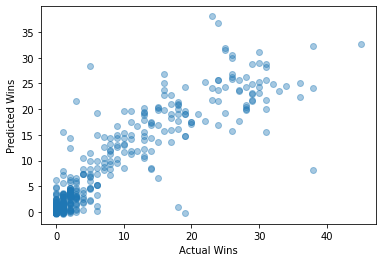

Train score for predicting Losses from BreakPointsFaced:  0.8946660204320578
Test score for predicting Losses from BreakPointsFaced:  0.8743742532018697 



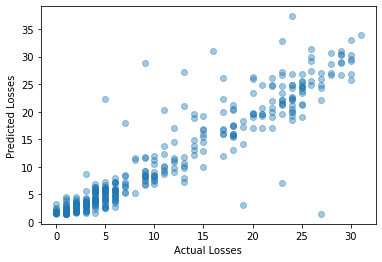

Train score for predicting Winnings from BreakPointsFaced:  0.7727772918599324
Test score for predicting Winnings from BreakPointsFaced:  0.7473687653981521 



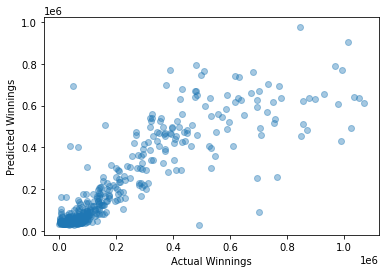

Train score for predicting Ranking from BreakPointsFaced:  0.09256107502886135
Test score for predicting Ranking from BreakPointsFaced:  0.11687498104467119 



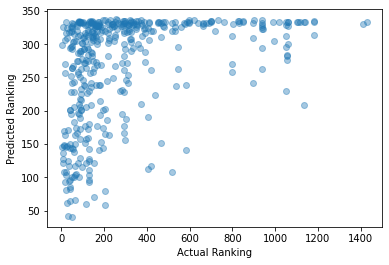

Train score for predicting Wins from BreakPointsOpportunities:  0.8820715623333836
Test score for predicting Wins from BreakPointsOpportunities:  0.7524946876857956 



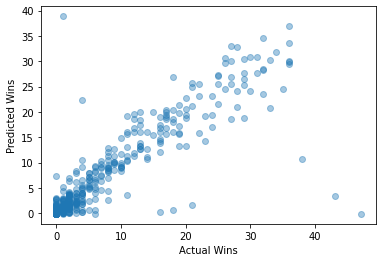

Train score for predicting Losses from BreakPointsOpportunities:  0.8226559288656734
Test score for predicting Losses from BreakPointsOpportunities:  0.8376481298542295 



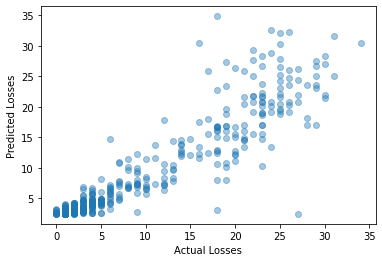

Train score for predicting Winnings from BreakPointsOpportunities:  0.7979721632977707
Test score for predicting Winnings from BreakPointsOpportunities:  0.8479523057493381 



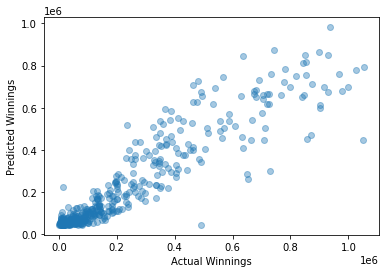

Train score for predicting Ranking from BreakPointsOpportunities:  0.10977224458037427
Test score for predicting Ranking from BreakPointsOpportunities:  0.10988759966129645 



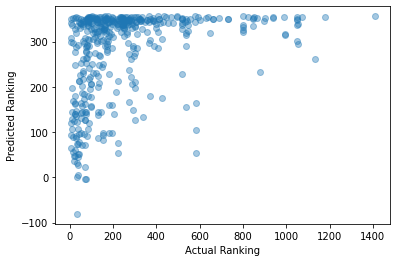

Train score for predicting Wins from BreakPointsSaved:  0.06547408854468528
Test score for predicting Wins from BreakPointsSaved:  0.056953959233115414 



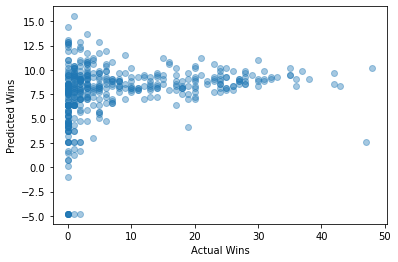

Train score for predicting Losses from BreakPointsSaved:  0.06777064508723052
Test score for predicting Losses from BreakPointsSaved:  0.039151916573835766 



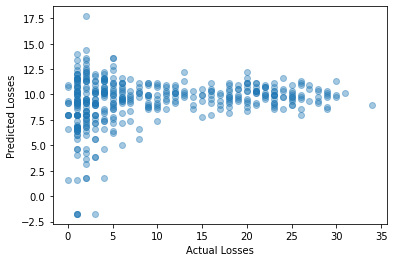

Train score for predicting Winnings from BreakPointsSaved:  0.06481414004719055
Test score for predicting Winnings from BreakPointsSaved:  0.0714647353481408 



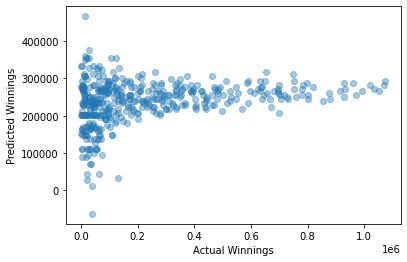

Train score for predicting Ranking from BreakPointsSaved:  0.010011363668675943
Test score for predicting Ranking from BreakPointsSaved:  0.02287208543685848 



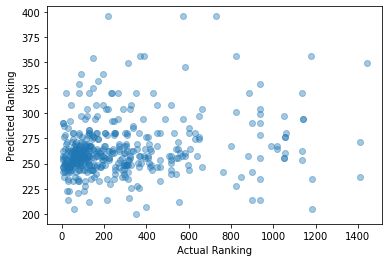

Train score for predicting Wins from DoubleFaults:  0.722339087568319
Test score for predicting Wins from DoubleFaults:  0.7052303142499003 



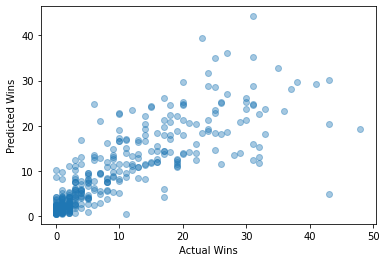

Train score for predicting Losses from DoubleFaults:  0.7729221471897756
Test score for predicting Losses from DoubleFaults:  0.7914294174685887 



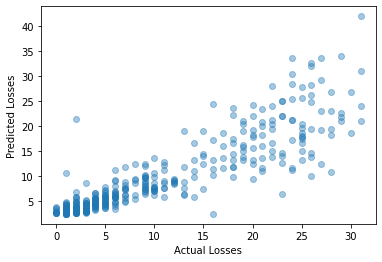

Train score for predicting Winnings from DoubleFaults:  0.7287675671021352
Test score for predicting Winnings from DoubleFaults:  0.73407962143632 



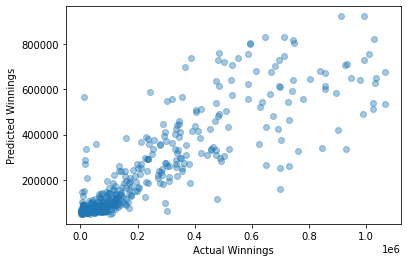

Train score for predicting Ranking from DoubleFaults:  0.09456045763366316
Test score for predicting Ranking from DoubleFaults:  0.08110743787790842 



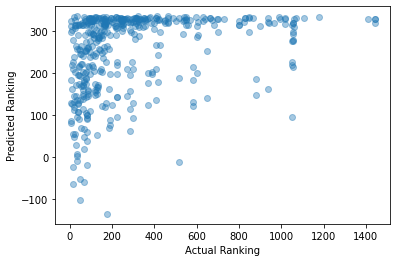

Train score for predicting Wins from ReturnGamesPlayed:  0.8587164728327663
Test score for predicting Wins from ReturnGamesPlayed:  0.870275190837445 



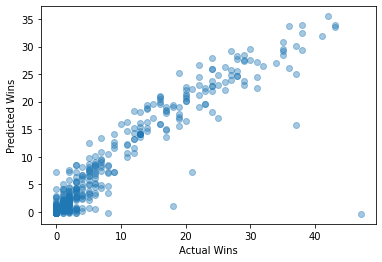

Train score for predicting Losses from ReturnGamesPlayed:  0.8724357388306765
Test score for predicting Losses from ReturnGamesPlayed:  0.8927031111845916 



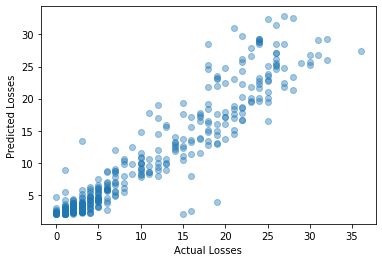

Train score for predicting Winnings from ReturnGamesPlayed:  0.8303962699320384
Test score for predicting Winnings from ReturnGamesPlayed:  0.8391939579058675 



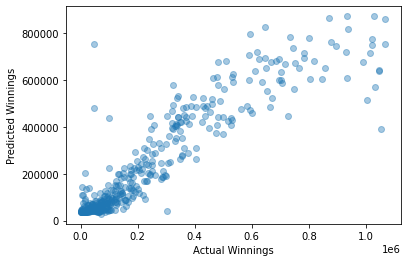

Train score for predicting Ranking from ReturnGamesPlayed:  0.11002746089534465
Test score for predicting Ranking from ReturnGamesPlayed:  0.09993415759964731 



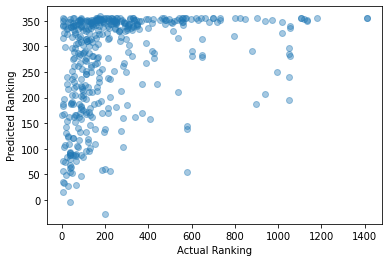

Train score for predicting Wins from ReturnGamesWon:  0.08550642429304034
Test score for predicting Wins from ReturnGamesWon:  0.08548322013215404 



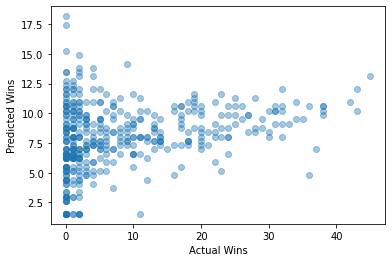

Train score for predicting Losses from ReturnGamesWon:  0.06738657692870287
Test score for predicting Losses from ReturnGamesWon:  0.07224460178681258 



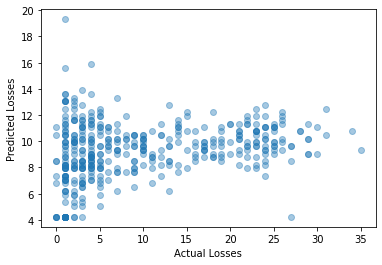

Train score for predicting Winnings from ReturnGamesWon:  0.07560145267241702
Test score for predicting Winnings from ReturnGamesWon:  0.08480624975594886 



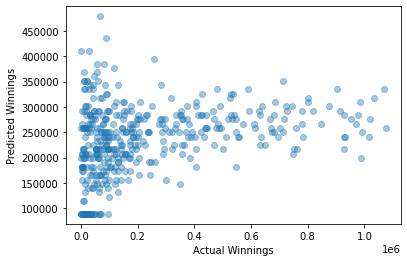

Train score for predicting Ranking from ReturnGamesWon:  0.04658064540430917
Test score for predicting Ranking from ReturnGamesWon:  -0.006072194842378087 



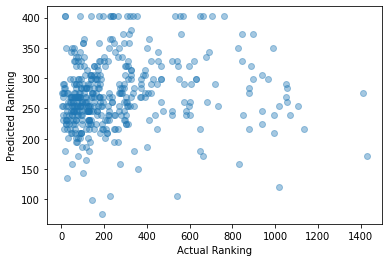

Train score for predicting Wins from ReturnPointsWon:  0.08761680712247288
Test score for predicting Wins from ReturnPointsWon:  0.04926113241447283 



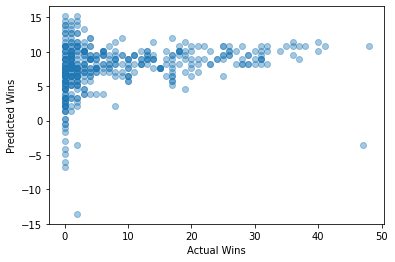

Train score for predicting Losses from ReturnPointsWon:  0.07070425485115939
Test score for predicting Losses from ReturnPointsWon:  0.06920310969216714 



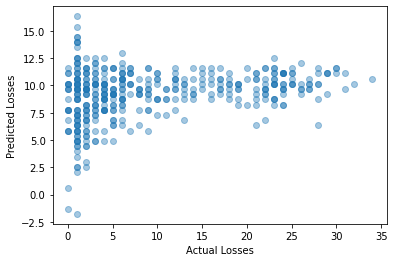

Train score for predicting Winnings from ReturnPointsWon:  0.06951219820480281
Test score for predicting Winnings from ReturnPointsWon:  0.08322383461494454 



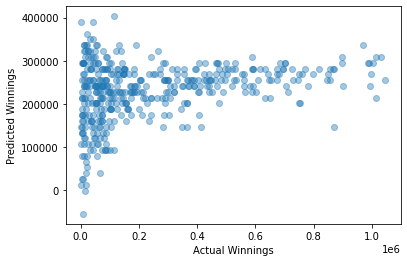

Train score for predicting Ranking from ReturnPointsWon:  0.05051714293169707
Test score for predicting Ranking from ReturnPointsWon:  0.010072223901104627 



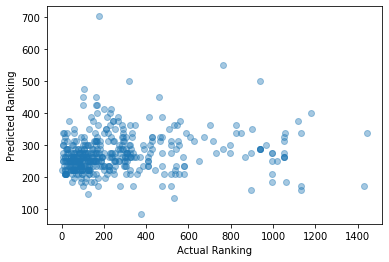

Train score for predicting Wins from ServiceGamesPlayed:  0.8513896563770114
Test score for predicting Wins from ServiceGamesPlayed:  0.9001862653083932 



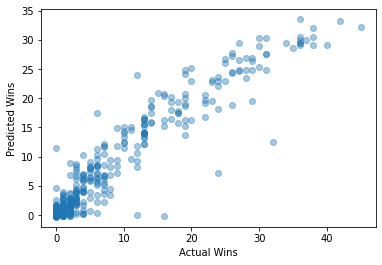

Train score for predicting Losses from ServiceGamesPlayed:  0.8744577950038002
Test score for predicting Losses from ServiceGamesPlayed:  0.874370612459029 



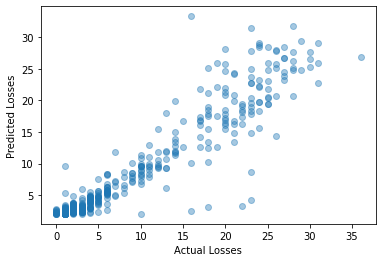

Train score for predicting Winnings from ServiceGamesPlayed:  0.8348247967667684
Test score for predicting Winnings from ServiceGamesPlayed:  0.8292482042803296 



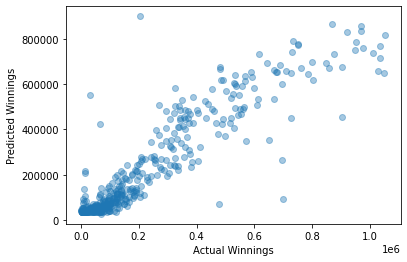

Train score for predicting Ranking from ServiceGamesPlayed:  0.12045863150590362
Test score for predicting Ranking from ServiceGamesPlayed:  0.07701758782225565 



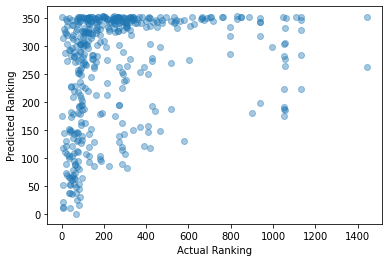

Train score for predicting Wins from ServiceGamesWon:  0.1616335233741254
Test score for predicting Wins from ServiceGamesWon:  0.10896071615215797 



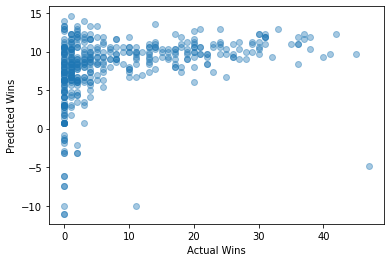

Train score for predicting Losses from ServiceGamesWon:  0.13250968378599837
Test score for predicting Losses from ServiceGamesWon:  0.14147691582642663 



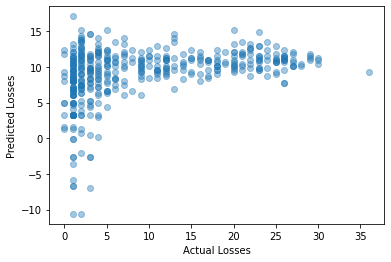

Train score for predicting Winnings from ServiceGamesWon:  0.15869966482915177
Test score for predicting Winnings from ServiceGamesWon:  0.1478552898210298 



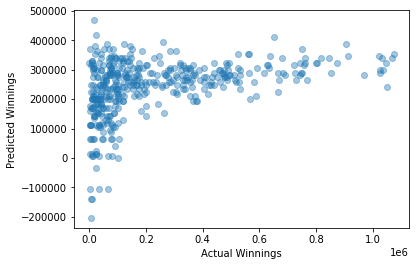

Train score for predicting Ranking from ServiceGamesWon:  0.04031642281118053
Test score for predicting Ranking from ServiceGamesWon:  0.03326520740859329 



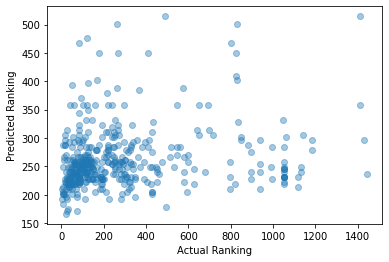

Train score for predicting Wins from TotalPointsWon:  0.20542977010288965
Test score for predicting Wins from TotalPointsWon:  0.227329500454591 



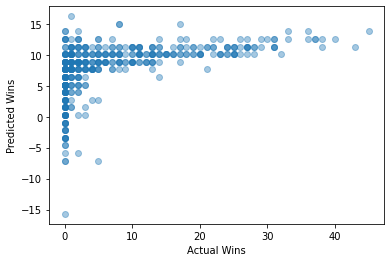

Train score for predicting Losses from TotalPointsWon:  0.16319766628436672
Test score for predicting Losses from TotalPointsWon:  0.24162246365530737 



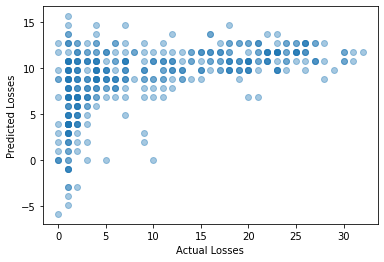

Train score for predicting Winnings from TotalPointsWon:  0.20854957151843323
Test score for predicting Winnings from TotalPointsWon:  0.22165257560482776 



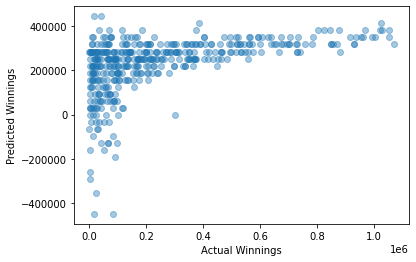

Train score for predicting Ranking from TotalPointsWon:  0.07744837470587096
Test score for predicting Ranking from TotalPointsWon:  0.06304823535366666 



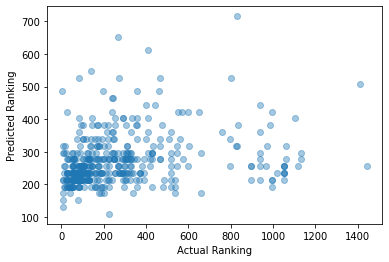

Train score for predicting Wins from TotalServicePointsWon:  0.15614163289971572
Test score for predicting Wins from TotalServicePointsWon:  0.16946662401219703 



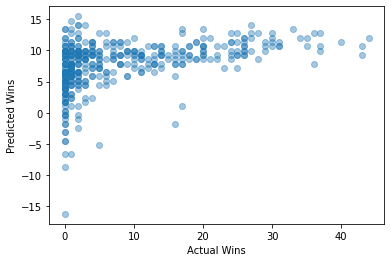

Train score for predicting Losses from TotalServicePointsWon:  0.141980354486005
Test score for predicting Losses from TotalServicePointsWon:  0.12576752127844326 



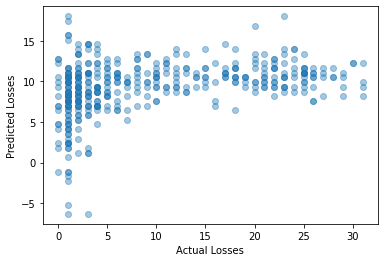

Train score for predicting Winnings from TotalServicePointsWon:  0.16082433374227845
Test score for predicting Winnings from TotalServicePointsWon:  0.17625950331874807 



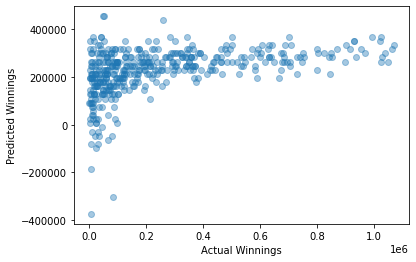

Train score for predicting Ranking from TotalServicePointsWon:  0.0350741364565752
Test score for predicting Ranking from TotalServicePointsWon:  0.06636591546951787 



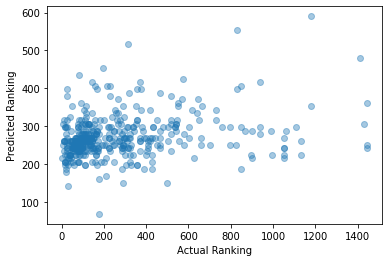

<Figure size 432x288 with 0 Axes>

In [24]:
results_single = []
for i in features:
    for j in outcomes:
        # # train, test, split the data
        x_train, x_test, y_train, y_test = train_test_split(tennis[i].values.reshape(-1,1), tennis[j].values.reshape(-1,1))
        # create and train Linear Regression model on training data 
        lr = LinearRegression()
        lr.fit(x_train, y_train)
        y_pred = lr.predict(x_test)
        print('Train score for predicting '+j+' from', i+': ', lr.score(x_train, y_train))
        print('Test score for predicting '+j+' from', i+': ', lr.score(x_test, y_test), '\n')
        plt.scatter(y_test, y_pred, alpha = 0.4)
        plt.xlabel('Actual '+j)
        plt.ylabel('Predicted '+j)
        plt.show()
        plt.clf()
        results_single.append([lr.score(x_train, y_train),lr.score(x_test, y_test), j+' vs. '+i])
    

In [25]:
results_single

[[0.005035393663308185, 0.0011847338040879007, 'Wins vs. FirstServe'],
 [0.003401416627611953, 0.001119558433536283, 'Losses vs. FirstServe'],
 [0.007098857616613441, -0.01386831492540419, 'Winnings vs. FirstServe'],
 [0.002513126066682303, 0.007535584414974261, 'Ranking vs. FirstServe'],
 [0.12976842773608255, 0.11447161087689282, 'Wins vs. FirstServePointsWon'],
 [0.10911061854864246, 0.10531532711510727, 'Losses vs. FirstServePointsWon'],
 [0.13045868364718127, 0.1273850466405395, 'Winnings vs. FirstServePointsWon'],
 [0.022385415230944394,
  0.022666430331350518,
  'Ranking vs. FirstServePointsWon'],
 [0.0615708201853753,
  0.07532802308067299,
  'Wins vs. FirstServeReturnPointsWon'],
 [0.06169989656032826,
  0.05048784950484031,
  'Losses vs. FirstServeReturnPointsWon'],
 [0.054136685397433985,
  0.06908529715479461,
  'Winnings vs. FirstServeReturnPointsWon'],
 [0.024915122210307894,
  0.05021507164608019,
  'Ranking vs. FirstServeReturnPointsWon'],
 [0.07633169214381408, 0.06002

In [26]:
results_single.sort(reverse=True)

In [27]:
results_single

[[0.8946660204320578, 0.8743742532018697, 'Losses vs. BreakPointsFaced'],
 [0.8820715623333836, 0.7524946876857956, 'Wins vs. BreakPointsOpportunities'],
 [0.8744577950038002, 0.874370612459029, 'Losses vs. ServiceGamesPlayed'],
 [0.8724357388306765, 0.8927031111845916, 'Losses vs. ReturnGamesPlayed'],
 [0.8587164728327663, 0.870275190837445, 'Wins vs. ReturnGamesPlayed'],
 [0.8513896563770114, 0.9001862653083932, 'Wins vs. ServiceGamesPlayed'],
 [0.8348247967667684, 0.8292482042803296, 'Winnings vs. ServiceGamesPlayed'],
 [0.8303962699320384, 0.8391939579058675, 'Winnings vs. ReturnGamesPlayed'],
 [0.8226559288656734,
  0.8376481298542295,
  'Losses vs. BreakPointsOpportunities'],
 [0.7979721632977707,
  0.8479523057493381,
  'Winnings vs. BreakPointsOpportunities'],
 [0.775043595458599, 0.7968173494370436, 'Wins vs. BreakPointsFaced'],
 [0.7729221471897756, 0.7914294174685887, 'Losses vs. DoubleFaults'],
 [0.7727772918599324, 0.7473687653981521, 'Winnings vs. BreakPointsFaced'],
 [0.

So, there is a strong positive correlation or relationship between Losses and BreakPointsFaced, Wins and BreakPointsOpportunities, Losses and ServiceGamesPlayed

In [28]:
# Considering R-squared value r >= 0.7 as a strong effect size or which means a good model,
r2_single = []
for i in results_single:
    if i[0] >=0.7:
        r2_single.append(i)


In [29]:
r2_single

[[0.8946660204320578, 0.8743742532018697, 'Losses vs. BreakPointsFaced'],
 [0.8820715623333836, 0.7524946876857956, 'Wins vs. BreakPointsOpportunities'],
 [0.8744577950038002, 0.874370612459029, 'Losses vs. ServiceGamesPlayed'],
 [0.8724357388306765, 0.8927031111845916, 'Losses vs. ReturnGamesPlayed'],
 [0.8587164728327663, 0.870275190837445, 'Wins vs. ReturnGamesPlayed'],
 [0.8513896563770114, 0.9001862653083932, 'Wins vs. ServiceGamesPlayed'],
 [0.8348247967667684, 0.8292482042803296, 'Winnings vs. ServiceGamesPlayed'],
 [0.8303962699320384, 0.8391939579058675, 'Winnings vs. ReturnGamesPlayed'],
 [0.8226559288656734,
  0.8376481298542295,
  'Losses vs. BreakPointsOpportunities'],
 [0.7979721632977707,
  0.8479523057493381,
  'Winnings vs. BreakPointsOpportunities'],
 [0.775043595458599, 0.7968173494370436, 'Wins vs. BreakPointsFaced'],
 [0.7729221471897756, 0.7914294174685887, 'Losses vs. DoubleFaults'],
 [0.7727772918599324, 0.7473687653981521, 'Winnings vs. BreakPointsFaced'],
 [0.

In [30]:
# These single regression models can be considered good models
for i in r2_single:
    print(i[-1])

Losses vs. BreakPointsFaced
Wins vs. BreakPointsOpportunities
Losses vs. ServiceGamesPlayed
Losses vs. ReturnGamesPlayed
Wins vs. ReturnGamesPlayed
Wins vs. ServiceGamesPlayed
Winnings vs. ServiceGamesPlayed
Winnings vs. ReturnGamesPlayed
Losses vs. BreakPointsOpportunities
Winnings vs. BreakPointsOpportunities
Wins vs. BreakPointsFaced
Losses vs. DoubleFaults
Winnings vs. BreakPointsFaced
Winnings vs. DoubleFaults
Wins vs. DoubleFaults


In [35]:
outcomes

['Wins', 'Losses', 'Winnings', 'Ranking']

In [38]:
print('These models can be considered good as per the R^2 value')
for i in r2_single:
    if i[-1].split()[0] == outcomes[0]:
        print(i[-1])
for i in r2_single:

    if i[-1].split()[0] == outcomes[1]:
        print(i[-1])
for i in r2_single:
    
    if i[-1].split()[0] == outcomes[2]:
        print(i[-1])
for i in r2_single:
    
    if i[-1].split()[0] == outcomes[3]:
        print(i[-1])

These models can be considered good as per the R^2 value
Wins vs. BreakPointsOpportunities
Wins vs. ReturnGamesPlayed
Wins vs. ServiceGamesPlayed
Wins vs. BreakPointsFaced
Wins vs. DoubleFaults
Losses vs. BreakPointsFaced
Losses vs. ServiceGamesPlayed
Losses vs. ReturnGamesPlayed
Losses vs. BreakPointsOpportunities
Losses vs. DoubleFaults
Winnings vs. ServiceGamesPlayed
Winnings vs. ReturnGamesPlayed
Winnings vs. BreakPointsOpportunities
Winnings vs. BreakPointsFaced
Winnings vs. DoubleFaults


In [65]:
two_features = [[i,j] for i in features for j in features if i !=j]

In [66]:
two_features

[['FirstServe', 'FirstServePointsWon'],
 ['FirstServe', 'FirstServeReturnPointsWon'],
 ['FirstServe', 'SecondServePointsWon'],
 ['FirstServe', 'SecondServeReturnPointsWon'],
 ['FirstServe', 'Aces'],
 ['FirstServe', 'BreakPointsConverted'],
 ['FirstServe', 'BreakPointsFaced'],
 ['FirstServe', 'BreakPointsOpportunities'],
 ['FirstServe', 'BreakPointsSaved'],
 ['FirstServe', 'DoubleFaults'],
 ['FirstServe', 'ReturnGamesPlayed'],
 ['FirstServe', 'ReturnGamesWon'],
 ['FirstServe', 'ReturnPointsWon'],
 ['FirstServe', 'ServiceGamesPlayed'],
 ['FirstServe', 'ServiceGamesWon'],
 ['FirstServe', 'TotalPointsWon'],
 ['FirstServe', 'TotalServicePointsWon'],
 ['FirstServePointsWon', 'FirstServe'],
 ['FirstServePointsWon', 'FirstServeReturnPointsWon'],
 ['FirstServePointsWon', 'SecondServePointsWon'],
 ['FirstServePointsWon', 'SecondServeReturnPointsWon'],
 ['FirstServePointsWon', 'Aces'],
 ['FirstServePointsWon', 'BreakPointsConverted'],
 ['FirstServePointsWon', 'BreakPointsFaced'],
 ['FirstServePoi

Train score for predicting Winnings from FirstServe and FirstServePointsWon: 0.13293080320713324
Test score for predicting Winnings from FirstServe and FirstServePointsWon: 0.14281810313669607 



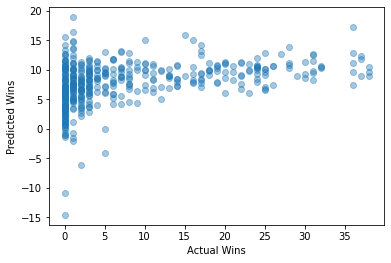

Train score for predicting Winnings from FirstServe and FirstServePointsWon: 0.1032110715623944
Test score for predicting Winnings from FirstServe and FirstServePointsWon: 0.14693272142673652 



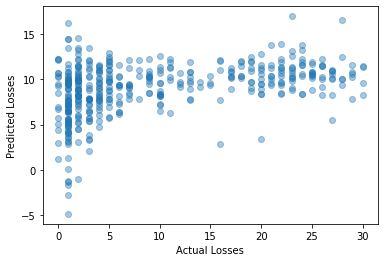

Train score for predicting Winnings from FirstServe and FirstServePointsWon: 0.14447233920383873
Test score for predicting Winnings from FirstServe and FirstServePointsWon: 0.11711148447037967 



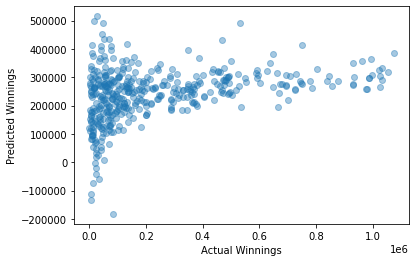

Train score for predicting Winnings from FirstServe and FirstServePointsWon: 0.031076296921382918
Test score for predicting Winnings from FirstServe and FirstServePointsWon: 0.019421337588208742 



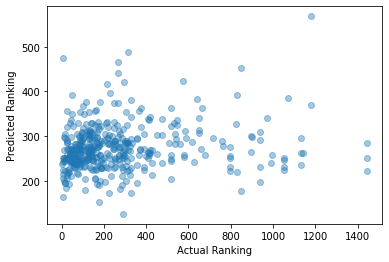

Train score for predicting Winnings from FirstServe and FirstServeReturnPointsWon: 0.0714301712620472
Test score for predicting Winnings from FirstServe and FirstServeReturnPointsWon: 0.05858237914659171 



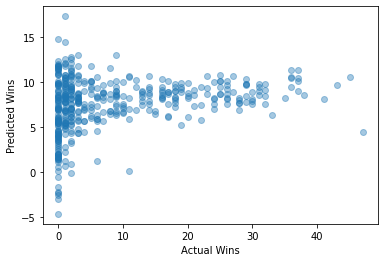

Train score for predicting Winnings from FirstServe and FirstServeReturnPointsWon: 0.06353908983284617
Test score for predicting Winnings from FirstServe and FirstServeReturnPointsWon: 0.05047814067894896 



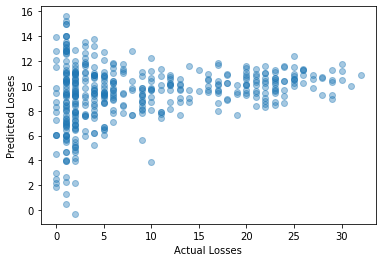

Train score for predicting Winnings from FirstServe and FirstServeReturnPointsWon: 0.05849163803620938
Test score for predicting Winnings from FirstServe and FirstServeReturnPointsWon: 0.06206327145664026 



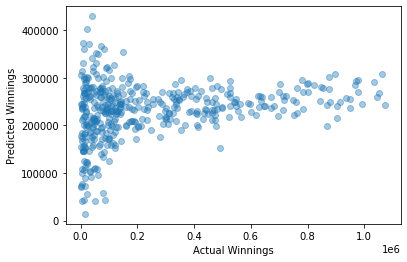

Train score for predicting Winnings from FirstServe and FirstServeReturnPointsWon: 0.03619543965615457
Test score for predicting Winnings from FirstServe and FirstServeReturnPointsWon: 0.029666966153661156 



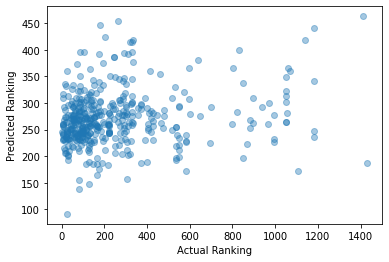

Train score for predicting Winnings from FirstServe and SecondServePointsWon: 0.08968534037007136
Test score for predicting Winnings from FirstServe and SecondServePointsWon: 0.02035200203863874 



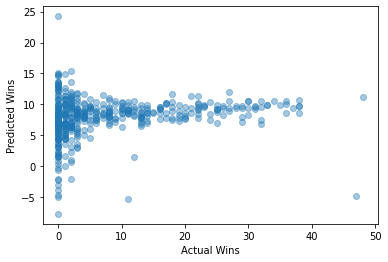

Train score for predicting Winnings from FirstServe and SecondServePointsWon: 0.06464711312455762
Test score for predicting Winnings from FirstServe and SecondServePointsWon: 0.05729597561125066 



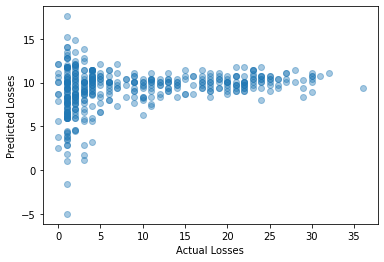

Train score for predicting Winnings from FirstServe and SecondServePointsWon: 0.07116533289642424
Test score for predicting Winnings from FirstServe and SecondServePointsWon: 0.09993456256506106 



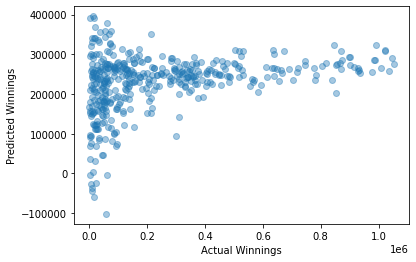

Train score for predicting Winnings from FirstServe and SecondServePointsWon: 0.034455402612692976
Test score for predicting Winnings from FirstServe and SecondServePointsWon: 0.03755011715902801 



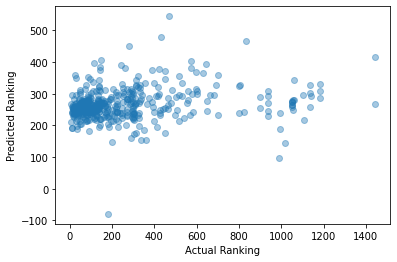

Train score for predicting Winnings from FirstServe and SecondServeReturnPointsWon: 0.03932094311495726
Test score for predicting Winnings from FirstServe and SecondServeReturnPointsWon: 0.04462513970408566 



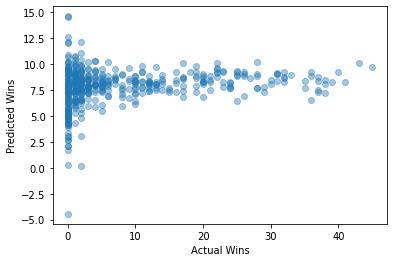

Train score for predicting Winnings from FirstServe and SecondServeReturnPointsWon: 0.04555109827709336
Test score for predicting Winnings from FirstServe and SecondServeReturnPointsWon: 0.004002037760732269 



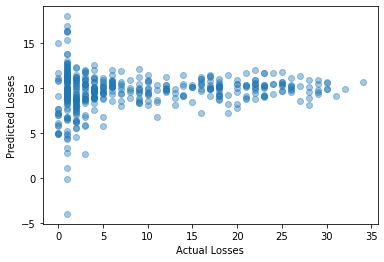

Train score for predicting Winnings from FirstServe and SecondServeReturnPointsWon: 0.0378605387962061
Test score for predicting Winnings from FirstServe and SecondServeReturnPointsWon: 0.056938239142669156 



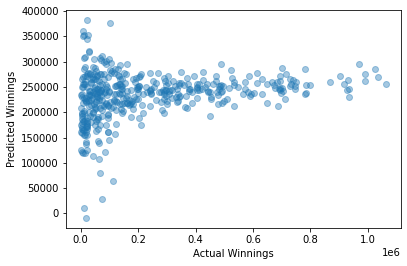

Train score for predicting Winnings from FirstServe and SecondServeReturnPointsWon: 0.03412803722354518
Test score for predicting Winnings from FirstServe and SecondServeReturnPointsWon: 0.01674012429209215 



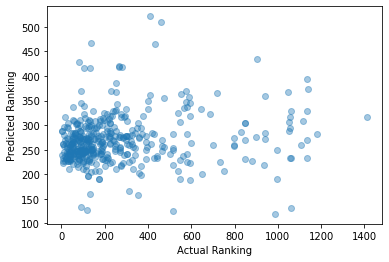

Train score for predicting Winnings from FirstServe and Aces: 0.679869515083006
Test score for predicting Winnings from FirstServe and Aces: 0.685029200353013 



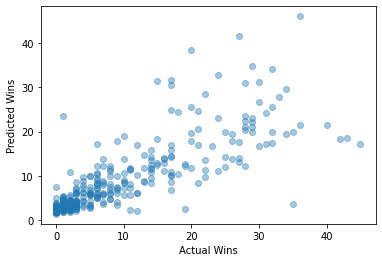

Train score for predicting Winnings from FirstServe and Aces: 0.6011905606765534
Test score for predicting Winnings from FirstServe and Aces: 0.5560691337751744 



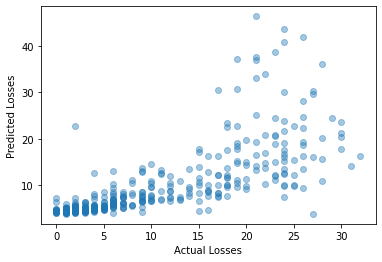

Train score for predicting Winnings from FirstServe and Aces: 0.639897383512788
Test score for predicting Winnings from FirstServe and Aces: 0.6300043523267551 



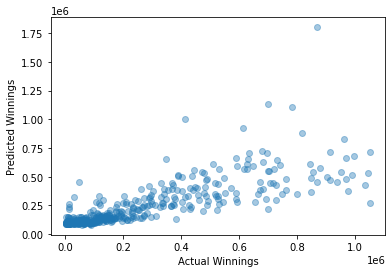

Train score for predicting Winnings from FirstServe and Aces: 0.07762886443671047
Test score for predicting Winnings from FirstServe and Aces: 0.08415523021398508 



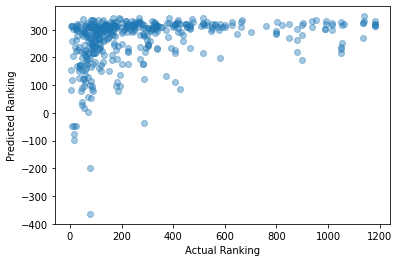

Train score for predicting Winnings from FirstServe and BreakPointsConverted: 0.010855994379265654
Test score for predicting Winnings from FirstServe and BreakPointsConverted: 0.008616797144338495 



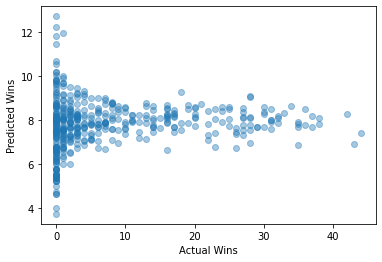

Train score for predicting Winnings from FirstServe and BreakPointsConverted: 0.006726504792129106
Test score for predicting Winnings from FirstServe and BreakPointsConverted: -0.014976282771286709 



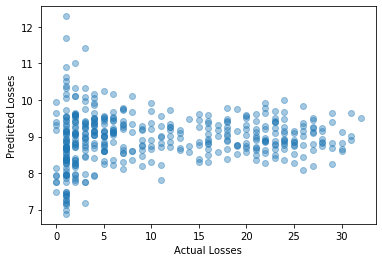

Train score for predicting Winnings from FirstServe and BreakPointsConverted: 0.009464189545004942
Test score for predicting Winnings from FirstServe and BreakPointsConverted: 0.0029441090863261414 



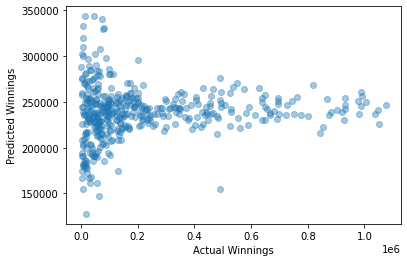

Train score for predicting Winnings from FirstServe and BreakPointsConverted: 0.005046092822835635
Test score for predicting Winnings from FirstServe and BreakPointsConverted: 0.007471432512746624 



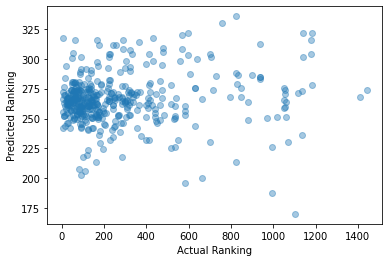

Train score for predicting Winnings from FirstServe and BreakPointsFaced: 0.7662168171910444
Test score for predicting Winnings from FirstServe and BreakPointsFaced: 0.8197236858511563 



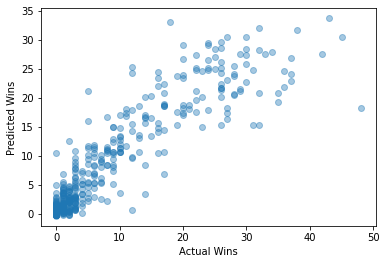

Train score for predicting Winnings from FirstServe and BreakPointsFaced: 0.893529018576926
Test score for predicting Winnings from FirstServe and BreakPointsFaced: 0.8784511662227354 



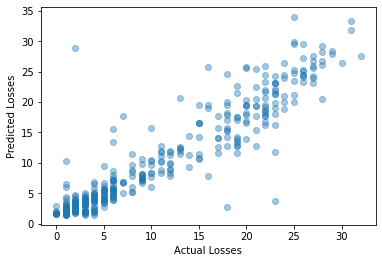

Train score for predicting Winnings from FirstServe and BreakPointsFaced: 0.763841501399389
Test score for predicting Winnings from FirstServe and BreakPointsFaced: 0.7776901970074221 



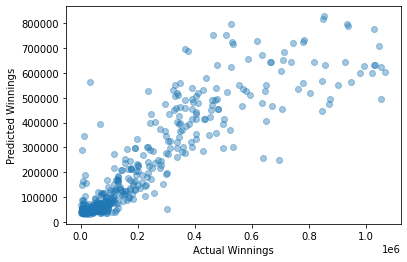

Train score for predicting Winnings from FirstServe and BreakPointsFaced: 0.11044696962751988
Test score for predicting Winnings from FirstServe and BreakPointsFaced: 0.08635413269241654 



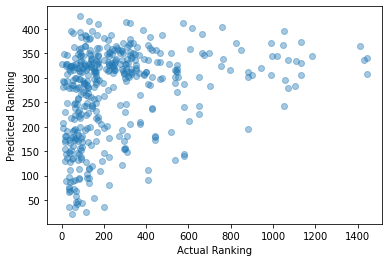

Train score for predicting Winnings from FirstServe and BreakPointsOpportunities: 0.8530646528063971
Test score for predicting Winnings from FirstServe and BreakPointsOpportunities: 0.8518079875321951 



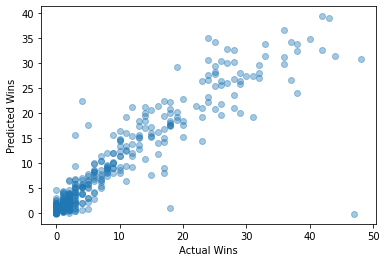

Train score for predicting Winnings from FirstServe and BreakPointsOpportunities: 0.8305108032716775
Test score for predicting Winnings from FirstServe and BreakPointsOpportunities: 0.8149430195568521 



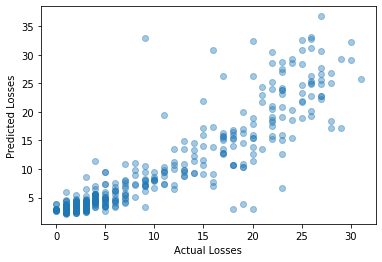

Train score for predicting Winnings from FirstServe and BreakPointsOpportunities: 0.8093171511471794
Test score for predicting Winnings from FirstServe and BreakPointsOpportunities: 0.8132782825869901 



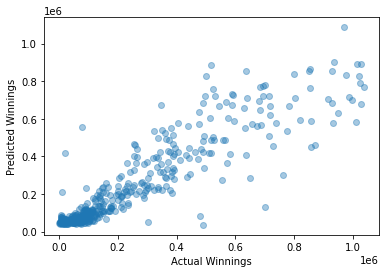

Train score for predicting Winnings from FirstServe and BreakPointsOpportunities: 0.1094634233787527
Test score for predicting Winnings from FirstServe and BreakPointsOpportunities: 0.12051072753834147 



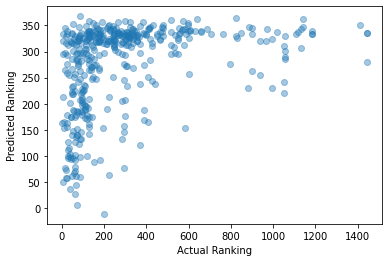

Train score for predicting Winnings from FirstServe and BreakPointsSaved: 0.05626689701499976
Test score for predicting Winnings from FirstServe and BreakPointsSaved: 0.08660935977379547 



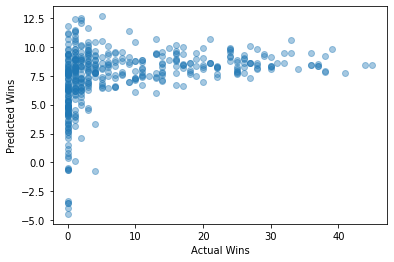

Train score for predicting Winnings from FirstServe and BreakPointsSaved: 0.06127804848187157
Test score for predicting Winnings from FirstServe and BreakPointsSaved: 0.05876145978618885 



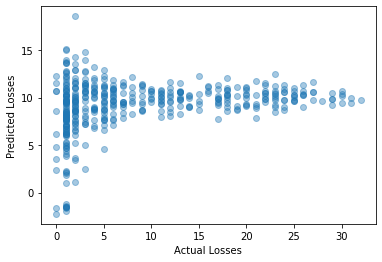

Train score for predicting Winnings from FirstServe and BreakPointsSaved: 0.07764650590804811
Test score for predicting Winnings from FirstServe and BreakPointsSaved: 0.032237709871637876 



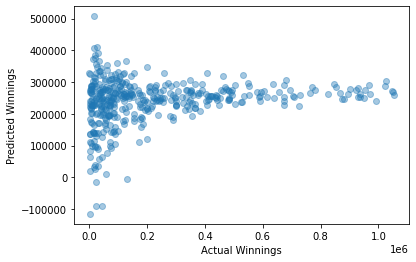

Train score for predicting Winnings from FirstServe and BreakPointsSaved: 0.020313447199434176
Test score for predicting Winnings from FirstServe and BreakPointsSaved: 0.007215357975478565 



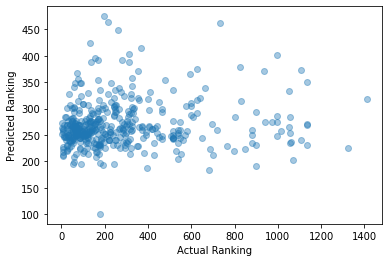

Train score for predicting Winnings from FirstServe and DoubleFaults: 0.7070659786869846
Test score for predicting Winnings from FirstServe and DoubleFaults: 0.7643760212002532 



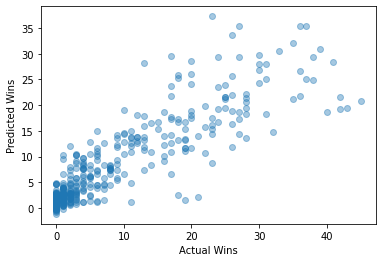

Train score for predicting Winnings from FirstServe and DoubleFaults: 0.777835022152124
Test score for predicting Winnings from FirstServe and DoubleFaults: 0.7894724462366858 



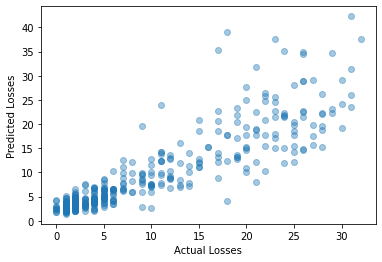

Train score for predicting Winnings from FirstServe and DoubleFaults: 0.7316317559686517
Test score for predicting Winnings from FirstServe and DoubleFaults: 0.7418501639336943 



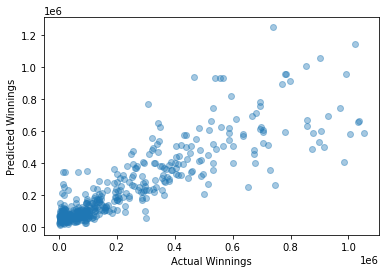

Train score for predicting Winnings from FirstServe and DoubleFaults: 0.10694869903712245
Test score for predicting Winnings from FirstServe and DoubleFaults: 0.057315124449568655 



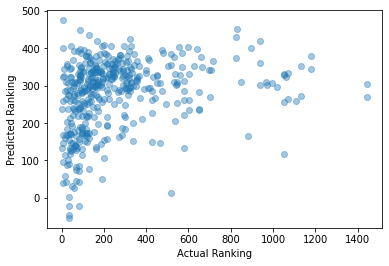

Train score for predicting Winnings from FirstServe and ReturnGamesPlayed: 0.8679339721547504
Test score for predicting Winnings from FirstServe and ReturnGamesPlayed: 0.8432337067125701 



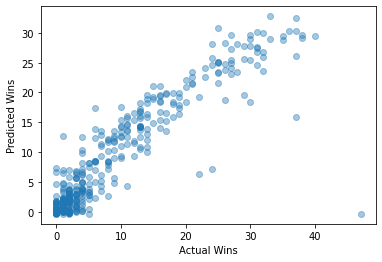

Train score for predicting Winnings from FirstServe and ReturnGamesPlayed: 0.8721221213604966
Test score for predicting Winnings from FirstServe and ReturnGamesPlayed: 0.8957570961155858 



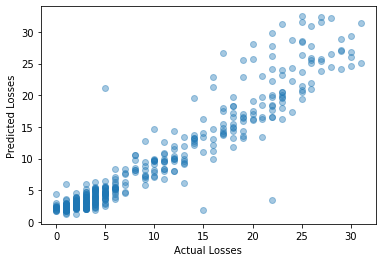

Train score for predicting Winnings from FirstServe and ReturnGamesPlayed: 0.8329914936625952
Test score for predicting Winnings from FirstServe and ReturnGamesPlayed: 0.8325980211725603 



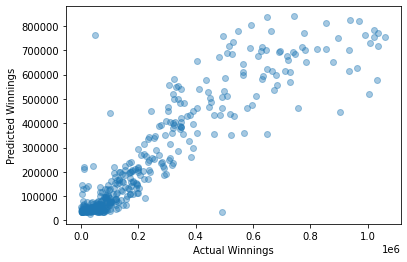

Train score for predicting Winnings from FirstServe and ReturnGamesPlayed: 0.10631632326894258
Test score for predicting Winnings from FirstServe and ReturnGamesPlayed: 0.12701370936145306 



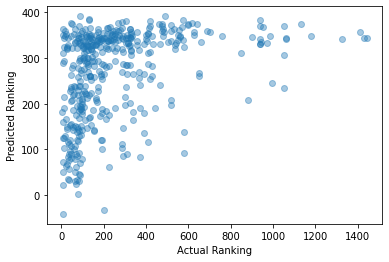

Train score for predicting Winnings from FirstServe and ReturnGamesWon: 0.08242148393454174
Test score for predicting Winnings from FirstServe and ReturnGamesWon: 0.10284610021695184 



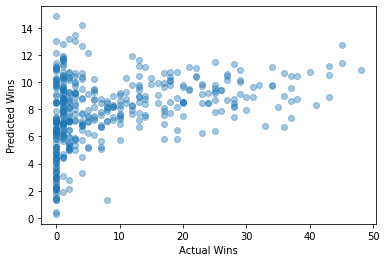

Train score for predicting Winnings from FirstServe and ReturnGamesWon: 0.07790692570668578
Test score for predicting Winnings from FirstServe and ReturnGamesWon: 0.05584077752447769 



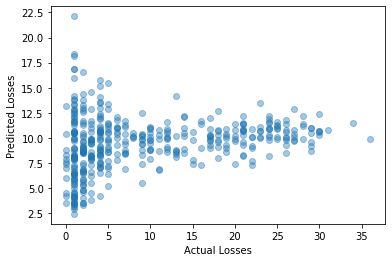

Train score for predicting Winnings from FirstServe and ReturnGamesWon: 0.08867526699625794
Test score for predicting Winnings from FirstServe and ReturnGamesWon: 0.055571821992733694 



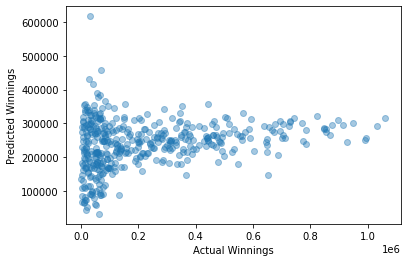

Train score for predicting Winnings from FirstServe and ReturnGamesWon: 0.04843559477614868
Test score for predicting Winnings from FirstServe and ReturnGamesWon: 0.01703691582005107 



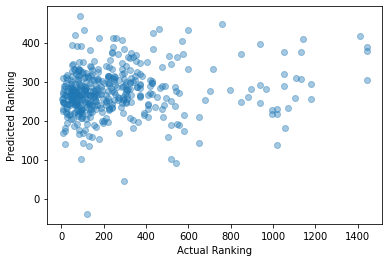

Train score for predicting Winnings from FirstServe and ReturnPointsWon: 0.07818615032958576
Test score for predicting Winnings from FirstServe and ReturnPointsWon: 0.0948355274978363 



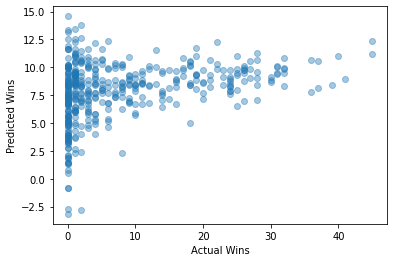

Train score for predicting Winnings from FirstServe and ReturnPointsWon: 0.07738584929437253
Test score for predicting Winnings from FirstServe and ReturnPointsWon: 0.05668784266465621 



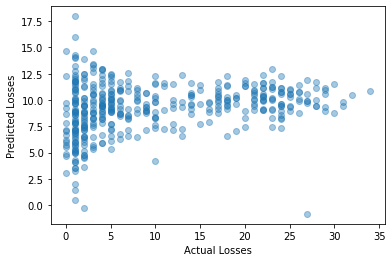

Train score for predicting Winnings from FirstServe and ReturnPointsWon: 0.09054156557708382
Test score for predicting Winnings from FirstServe and ReturnPointsWon: 0.029814869967490498 



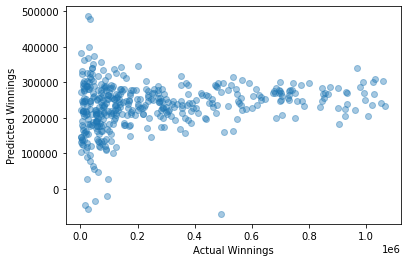

Train score for predicting Winnings from FirstServe and ReturnPointsWon: 0.0613631560621245
Test score for predicting Winnings from FirstServe and ReturnPointsWon: -0.0005176426519890587 



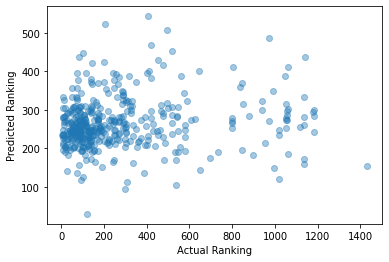

Train score for predicting Winnings from FirstServe and ServiceGamesPlayed: 0.857609600535669
Test score for predicting Winnings from FirstServe and ServiceGamesPlayed: 0.8778080571926989 



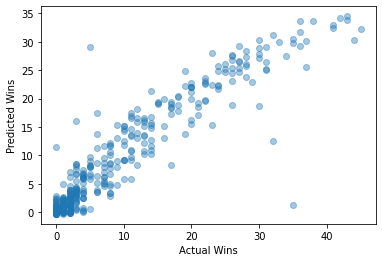

Train score for predicting Winnings from FirstServe and ServiceGamesPlayed: 0.8699198095770696
Test score for predicting Winnings from FirstServe and ServiceGamesPlayed: 0.8893787379869729 



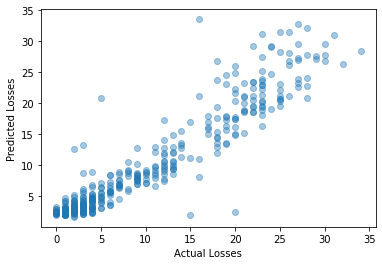

Train score for predicting Winnings from FirstServe and ServiceGamesPlayed: 0.839495020137467
Test score for predicting Winnings from FirstServe and ServiceGamesPlayed: 0.8163020936724429 



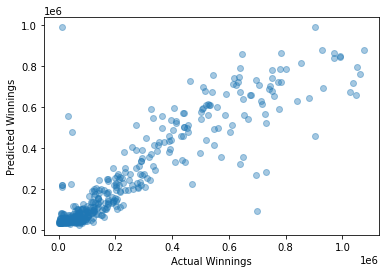

Train score for predicting Winnings from FirstServe and ServiceGamesPlayed: 0.1011498878687117
Test score for predicting Winnings from FirstServe and ServiceGamesPlayed: 0.14034918458583823 



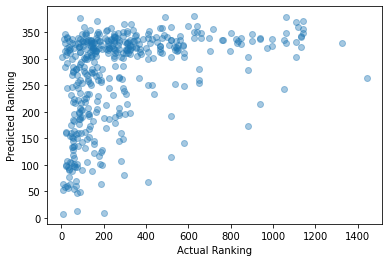

Train score for predicting Winnings from FirstServe and ServiceGamesWon: 0.15804491191827208
Test score for predicting Winnings from FirstServe and ServiceGamesWon: 0.11090636872849446 



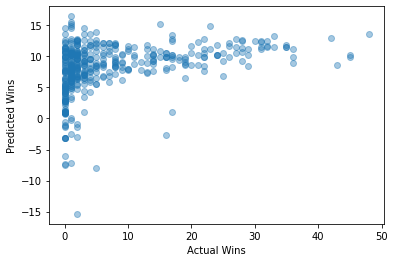

Train score for predicting Winnings from FirstServe and ServiceGamesWon: 0.13906636146425122
Test score for predicting Winnings from FirstServe and ServiceGamesWon: 0.12214262423331335 



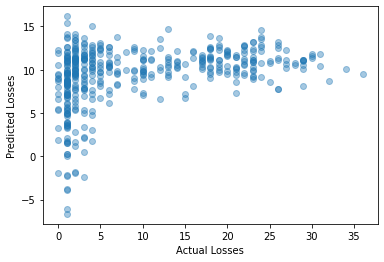

Train score for predicting Winnings from FirstServe and ServiceGamesWon: 0.15429880900237125
Test score for predicting Winnings from FirstServe and ServiceGamesWon: 0.15982555236339757 



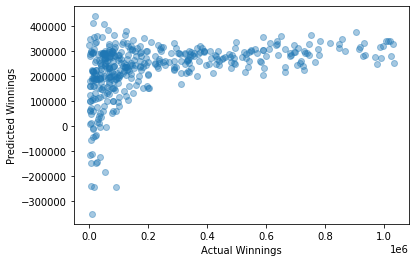

Train score for predicting Winnings from FirstServe and ServiceGamesWon: 0.03792551790582299
Test score for predicting Winnings from FirstServe and ServiceGamesWon: 0.04606020811041034 



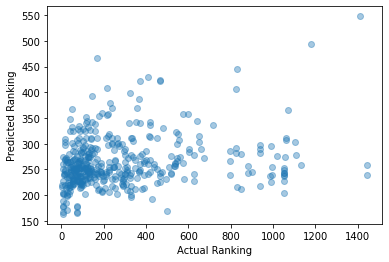

Train score for predicting Winnings from FirstServe and TotalPointsWon: 0.2057401456199459
Test score for predicting Winnings from FirstServe and TotalPointsWon: 0.22418761263044806 



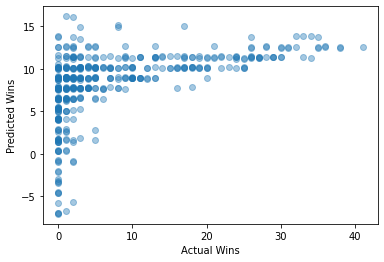

Train score for predicting Winnings from FirstServe and TotalPointsWon: 0.17633588893338772
Test score for predicting Winnings from FirstServe and TotalPointsWon: 0.19322784805426474 



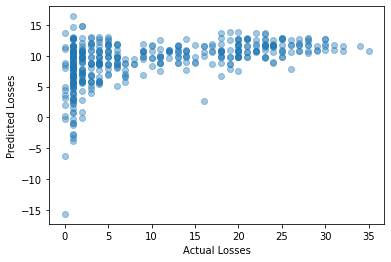

Train score for predicting Winnings from FirstServe and TotalPointsWon: 0.21815826000908323
Test score for predicting Winnings from FirstServe and TotalPointsWon: 0.19442251904326202 



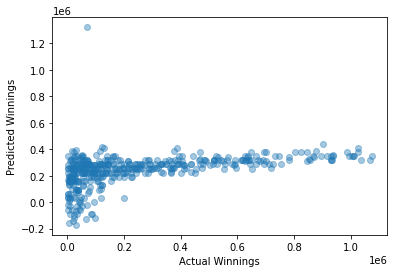

Train score for predicting Winnings from FirstServe and TotalPointsWon: 0.07154725314560406
Test score for predicting Winnings from FirstServe and TotalPointsWon: 0.07957026698289638 



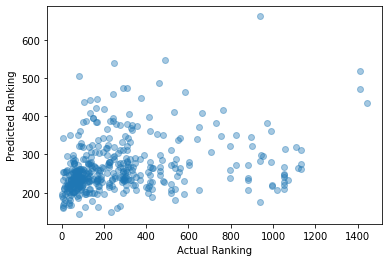

Train score for predicting Winnings from FirstServe and TotalServicePointsWon: 0.15156096162454624
Test score for predicting Winnings from FirstServe and TotalServicePointsWon: 0.18294735555234154 



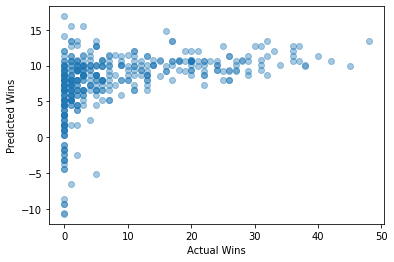

Train score for predicting Winnings from FirstServe and TotalServicePointsWon: 0.13683299320032216
Test score for predicting Winnings from FirstServe and TotalServicePointsWon: 0.13846581768939514 



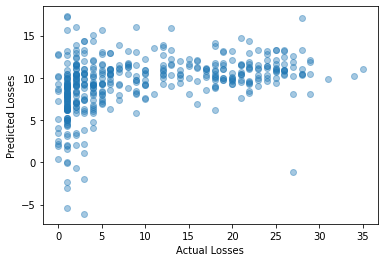

Train score for predicting Winnings from FirstServe and TotalServicePointsWon: 0.16538137690121368
Test score for predicting Winnings from FirstServe and TotalServicePointsWon: 0.16896067086310962 



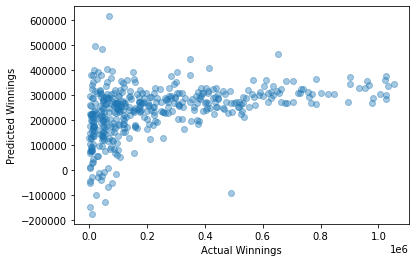

Train score for predicting Winnings from FirstServe and TotalServicePointsWon: 0.04278609830396529
Test score for predicting Winnings from FirstServe and TotalServicePointsWon: 0.0432476146525963 



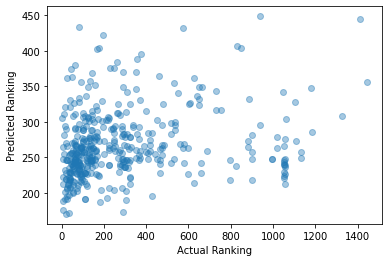

Train score for predicting Winnings from FirstServePointsWon and FirstServe: 0.14397079833589155
Test score for predicting Winnings from FirstServePointsWon and FirstServe: 0.10147431059042245 



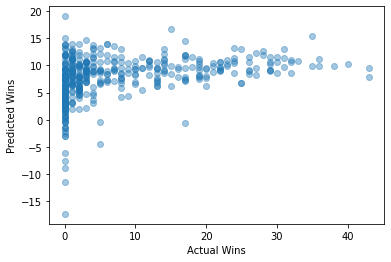

Train score for predicting Winnings from FirstServePointsWon and FirstServe: 0.1201550480916953
Test score for predicting Winnings from FirstServePointsWon and FirstServe: 0.10026756873412945 



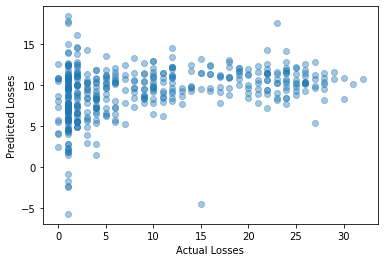

Train score for predicting Winnings from FirstServePointsWon and FirstServe: 0.13186201034369172
Test score for predicting Winnings from FirstServePointsWon and FirstServe: 0.15048476363386665 



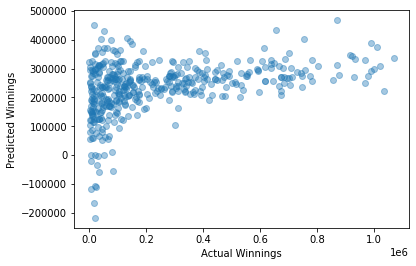

Train score for predicting Winnings from FirstServePointsWon and FirstServe: 0.024771302731017353
Test score for predicting Winnings from FirstServePointsWon and FirstServe: 0.03722931522675865 



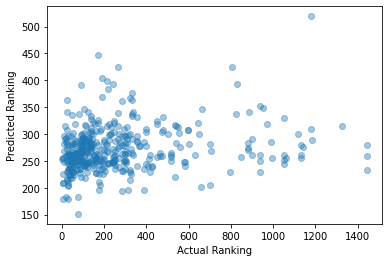

Train score for predicting Winnings from FirstServePointsWon and FirstServeReturnPointsWon: 0.18678715634587384
Test score for predicting Winnings from FirstServePointsWon and FirstServeReturnPointsWon: 0.19210592540419846 



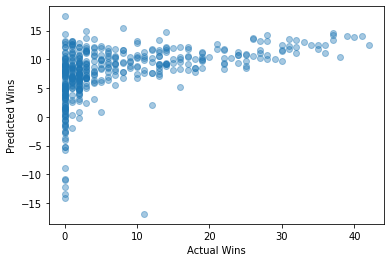

Train score for predicting Winnings from FirstServePointsWon and FirstServeReturnPointsWon: 0.17270610973536094
Test score for predicting Winnings from FirstServePointsWon and FirstServeReturnPointsWon: 0.12189951095031959 



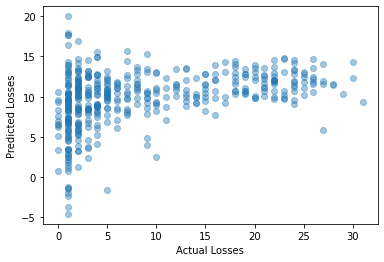

Train score for predicting Winnings from FirstServePointsWon and FirstServeReturnPointsWon: 0.19164168522554426
Test score for predicting Winnings from FirstServePointsWon and FirstServeReturnPointsWon: 0.16464498439495032 



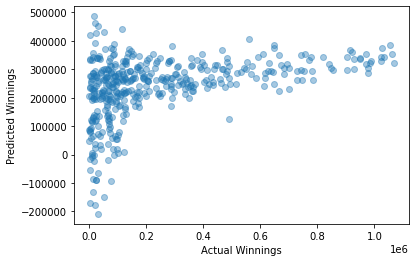

Train score for predicting Winnings from FirstServePointsWon and FirstServeReturnPointsWon: 0.06894137998359606
Test score for predicting Winnings from FirstServePointsWon and FirstServeReturnPointsWon: -0.002726538103997145 



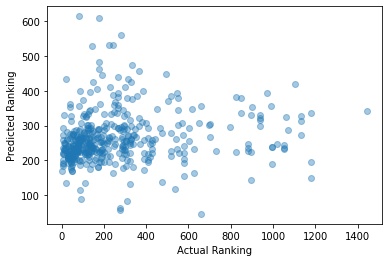

Train score for predicting Winnings from FirstServePointsWon and SecondServePointsWon: 0.14900634772500354
Test score for predicting Winnings from FirstServePointsWon and SecondServePointsWon: 0.16777303021529755 



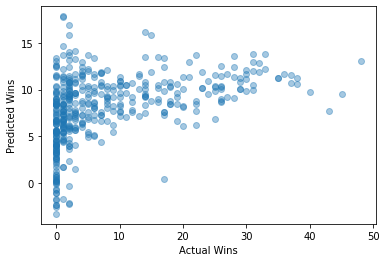

Train score for predicting Winnings from FirstServePointsWon and SecondServePointsWon: 0.13304587135892032
Test score for predicting Winnings from FirstServePointsWon and SecondServePointsWon: 0.12910359391987014 



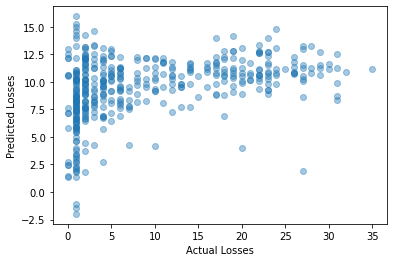

Train score for predicting Winnings from FirstServePointsWon and SecondServePointsWon: 0.1511326300286886
Test score for predicting Winnings from FirstServePointsWon and SecondServePointsWon: 0.18856028914891332 



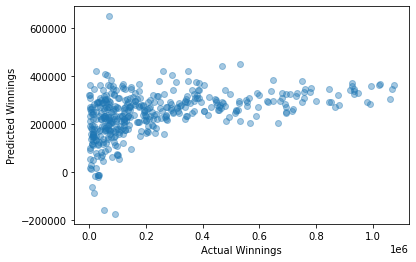

Train score for predicting Winnings from FirstServePointsWon and SecondServePointsWon: 0.04050203589006185
Test score for predicting Winnings from FirstServePointsWon and SecondServePointsWon: 0.036371442363504425 



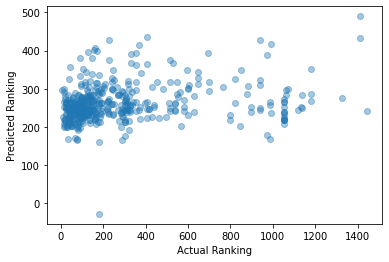

Train score for predicting Winnings from FirstServePointsWon and SecondServeReturnPointsWon: 0.16799103054396414
Test score for predicting Winnings from FirstServePointsWon and SecondServeReturnPointsWon: 0.1554034791236717 



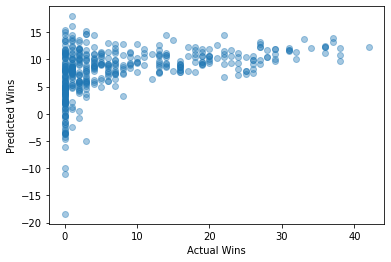

Train score for predicting Winnings from FirstServePointsWon and SecondServeReturnPointsWon: 0.12950693417434211
Test score for predicting Winnings from FirstServePointsWon and SecondServeReturnPointsWon: 0.18313015555106404 



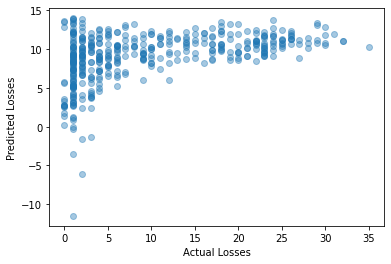

Train score for predicting Winnings from FirstServePointsWon and SecondServeReturnPointsWon: 0.1702455789041224
Test score for predicting Winnings from FirstServePointsWon and SecondServeReturnPointsWon: 0.1703330723843567 



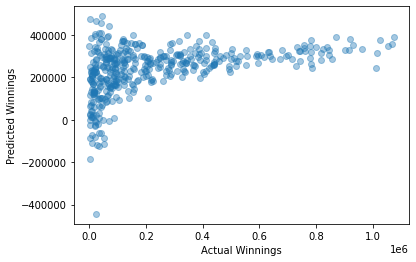

Train score for predicting Winnings from FirstServePointsWon and SecondServeReturnPointsWon: 0.053925978030557986
Test score for predicting Winnings from FirstServePointsWon and SecondServeReturnPointsWon: 0.029162126138121303 



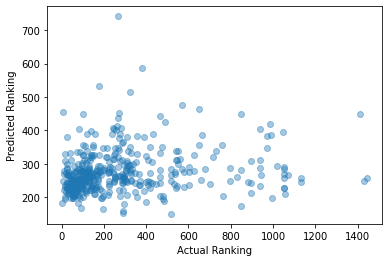

Train score for predicting Winnings from FirstServePointsWon and Aces: 0.6851186293376684
Test score for predicting Winnings from FirstServePointsWon and Aces: 0.671237025010712 



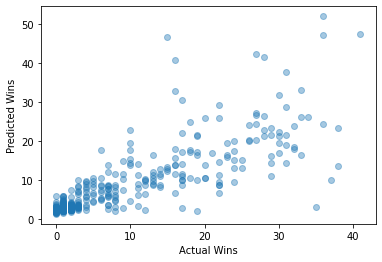

Train score for predicting Winnings from FirstServePointsWon and Aces: 0.5883614326068636
Test score for predicting Winnings from FirstServePointsWon and Aces: 0.5977795070568406 



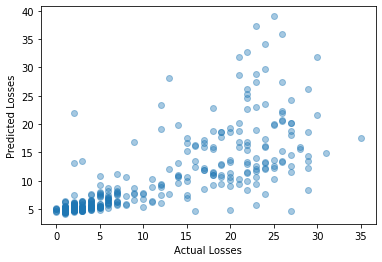

Train score for predicting Winnings from FirstServePointsWon and Aces: 0.6242962969969794
Test score for predicting Winnings from FirstServePointsWon and Aces: 0.6725314691477499 



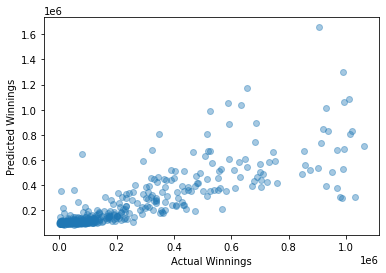

Train score for predicting Winnings from FirstServePointsWon and Aces: 0.0797102661212703
Test score for predicting Winnings from FirstServePointsWon and Aces: 0.07082932540448061 



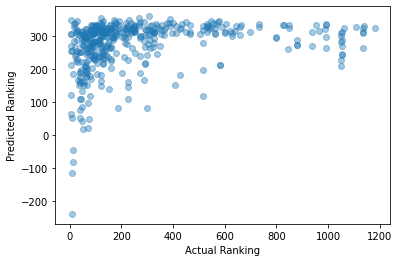

Train score for predicting Winnings from FirstServePointsWon and BreakPointsConverted: 0.14651437575192994
Test score for predicting Winnings from FirstServePointsWon and BreakPointsConverted: 0.09767435018741288 



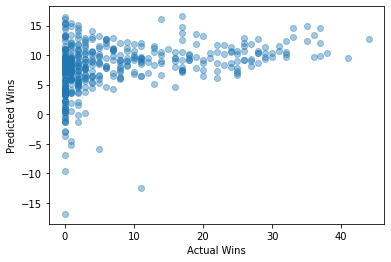

Train score for predicting Winnings from FirstServePointsWon and BreakPointsConverted: 0.1200303853961876
Test score for predicting Winnings from FirstServePointsWon and BreakPointsConverted: 0.09195159422915278 



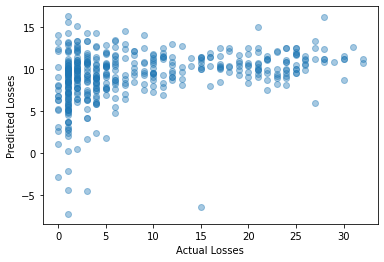

Train score for predicting Winnings from FirstServePointsWon and BreakPointsConverted: 0.14279596250713422
Test score for predicting Winnings from FirstServePointsWon and BreakPointsConverted: 0.11559176208792599 



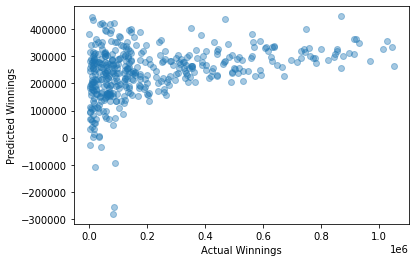

Train score for predicting Winnings from FirstServePointsWon and BreakPointsConverted: 0.028935273787566773
Test score for predicting Winnings from FirstServePointsWon and BreakPointsConverted: 0.01444209145421238 



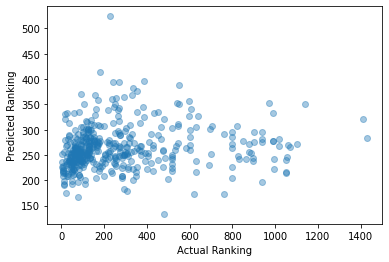

Train score for predicting Winnings from FirstServePointsWon and BreakPointsFaced: 0.7889680234443455
Test score for predicting Winnings from FirstServePointsWon and BreakPointsFaced: 0.7899056217614402 



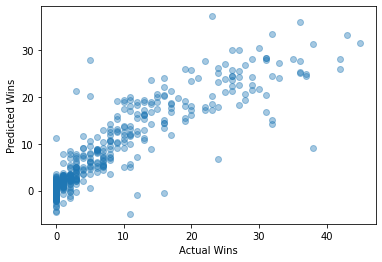

Train score for predicting Winnings from FirstServePointsWon and BreakPointsFaced: 0.9078602893513374
Test score for predicting Winnings from FirstServePointsWon and BreakPointsFaced: 0.8419038436255835 



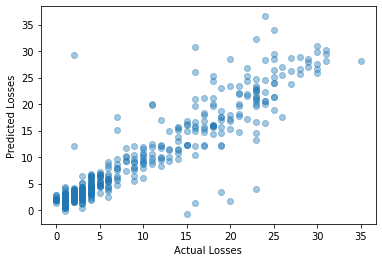

Train score for predicting Winnings from FirstServePointsWon and BreakPointsFaced: 0.772104834331161
Test score for predicting Winnings from FirstServePointsWon and BreakPointsFaced: 0.7946275839891168 



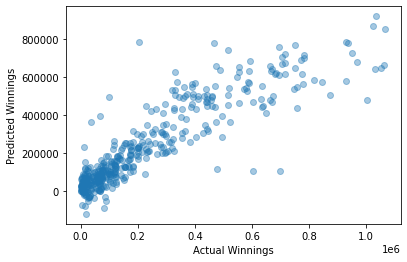

Train score for predicting Winnings from FirstServePointsWon and BreakPointsFaced: 0.10442048535305448
Test score for predicting Winnings from FirstServePointsWon and BreakPointsFaced: 0.11333997109668137 



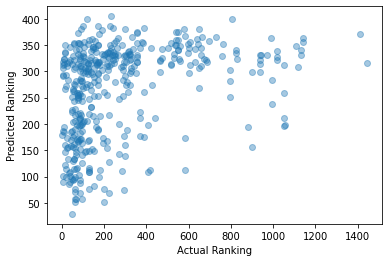

Train score for predicting Winnings from FirstServePointsWon and BreakPointsOpportunities: 0.8730632814592629
Test score for predicting Winnings from FirstServePointsWon and BreakPointsOpportunities: 0.8104237249416537 



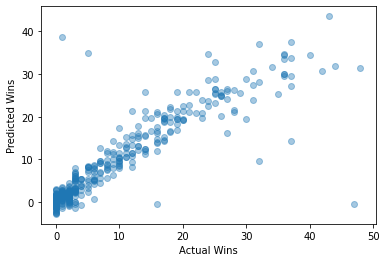

Train score for predicting Winnings from FirstServePointsWon and BreakPointsOpportunities: 0.8295482641284564
Test score for predicting Winnings from FirstServePointsWon and BreakPointsOpportunities: 0.8234801573597166 



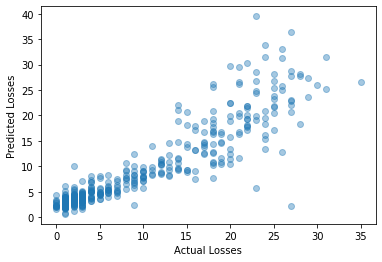

Train score for predicting Winnings from FirstServePointsWon and BreakPointsOpportunities: 0.8034862368002731
Test score for predicting Winnings from FirstServePointsWon and BreakPointsOpportunities: 0.8574746665696074 



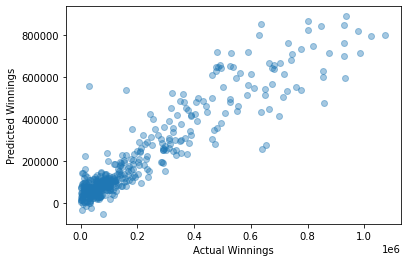

Train score for predicting Winnings from FirstServePointsWon and BreakPointsOpportunities: 0.12596889875475104
Test score for predicting Winnings from FirstServePointsWon and BreakPointsOpportunities: 0.07377353791394714 



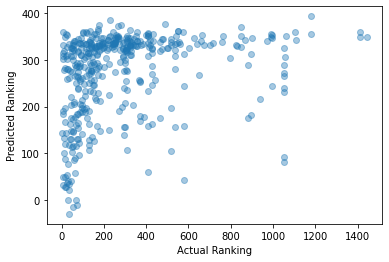

Train score for predicting Winnings from FirstServePointsWon and BreakPointsSaved: 0.14342056070192788
Test score for predicting Winnings from FirstServePointsWon and BreakPointsSaved: 0.13191749896320326 



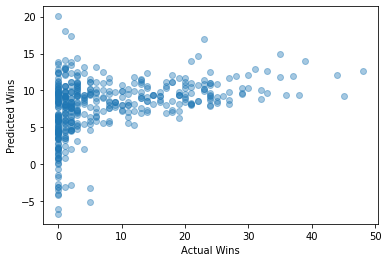

Train score for predicting Winnings from FirstServePointsWon and BreakPointsSaved: 0.11316347131805736
Test score for predicting Winnings from FirstServePointsWon and BreakPointsSaved: 0.1554903545552696 



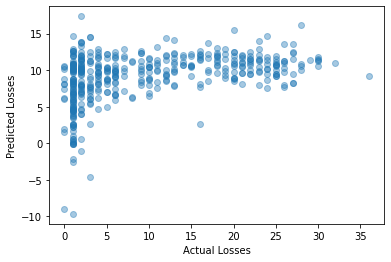

Train score for predicting Winnings from FirstServePointsWon and BreakPointsSaved: 0.14624566089043212
Test score for predicting Winnings from FirstServePointsWon and BreakPointsSaved: 0.13698551097792888 



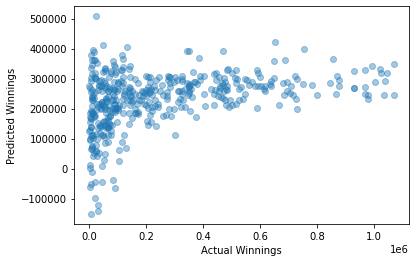

Train score for predicting Winnings from FirstServePointsWon and BreakPointsSaved: 0.024902091918087788
Test score for predicting Winnings from FirstServePointsWon and BreakPointsSaved: 0.031187494767795032 



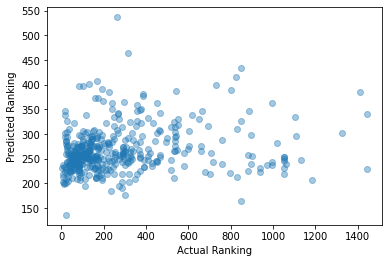

Train score for predicting Winnings from FirstServePointsWon and DoubleFaults: 0.7139630996099695
Test score for predicting Winnings from FirstServePointsWon and DoubleFaults: 0.7386343924484947 



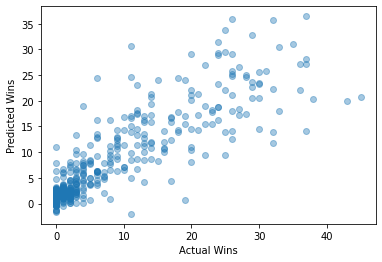

Train score for predicting Winnings from FirstServePointsWon and DoubleFaults: 0.7738644973572462
Test score for predicting Winnings from FirstServePointsWon and DoubleFaults: 0.7885037138657498 



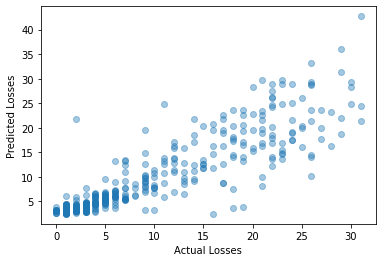

Train score for predicting Winnings from FirstServePointsWon and DoubleFaults: 0.7204768466437051
Test score for predicting Winnings from FirstServePointsWon and DoubleFaults: 0.7701503236370145 



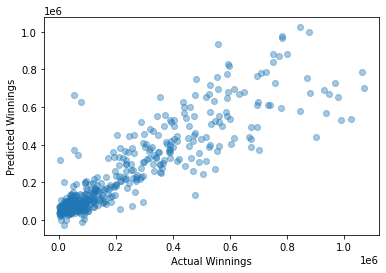

Train score for predicting Winnings from FirstServePointsWon and DoubleFaults: 0.10196993397716181
Test score for predicting Winnings from FirstServePointsWon and DoubleFaults: 0.0487498526851835 



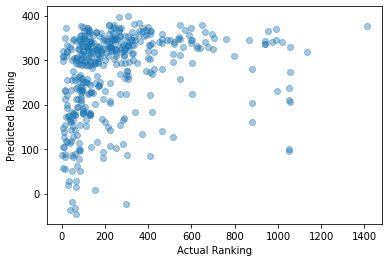

Train score for predicting Winnings from FirstServePointsWon and ReturnGamesPlayed: 0.8532416536443604
Test score for predicting Winnings from FirstServePointsWon and ReturnGamesPlayed: 0.8911522445012574 



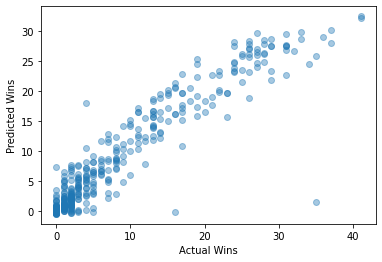

Train score for predicting Winnings from FirstServePointsWon and ReturnGamesPlayed: 0.8771745983421793
Test score for predicting Winnings from FirstServePointsWon and ReturnGamesPlayed: 0.8802157307995339 



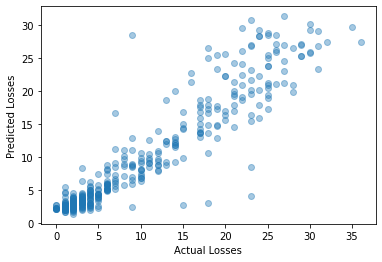

Train score for predicting Winnings from FirstServePointsWon and ReturnGamesPlayed: 0.8255715681102218
Test score for predicting Winnings from FirstServePointsWon and ReturnGamesPlayed: 0.8567230102664163 



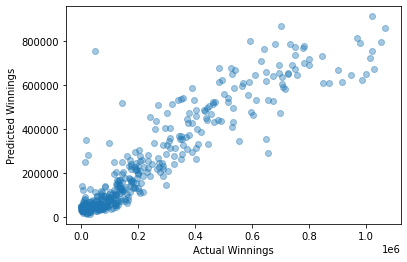

Train score for predicting Winnings from FirstServePointsWon and ReturnGamesPlayed: 0.10921645338409547
Test score for predicting Winnings from FirstServePointsWon and ReturnGamesPlayed: 0.11275482926778979 



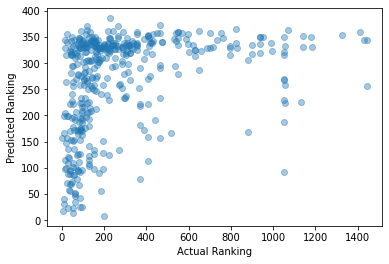

Train score for predicting Winnings from FirstServePointsWon and ReturnGamesWon: 0.21643372779020154
Test score for predicting Winnings from FirstServePointsWon and ReturnGamesWon: 0.20509733716242262 



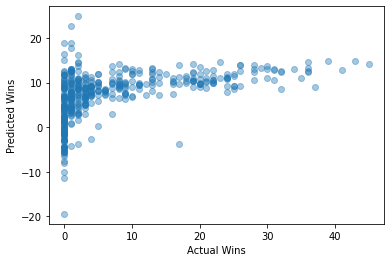

Train score for predicting Winnings from FirstServePointsWon and ReturnGamesWon: 0.1938389900573729
Test score for predicting Winnings from FirstServePointsWon and ReturnGamesWon: 0.13118620384064283 



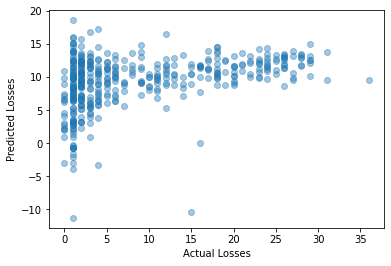

Train score for predicting Winnings from FirstServePointsWon and ReturnGamesWon: 0.212932311127778
Test score for predicting Winnings from FirstServePointsWon and ReturnGamesWon: 0.20110887871977115 



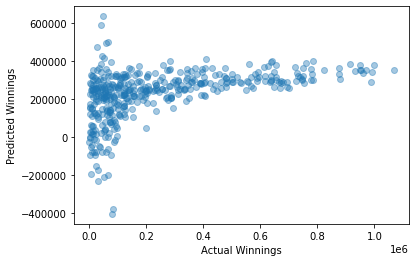

Train score for predicting Winnings from FirstServePointsWon and ReturnGamesWon: 0.0545556710473305
Test score for predicting Winnings from FirstServePointsWon and ReturnGamesWon: 0.07460418390967294 



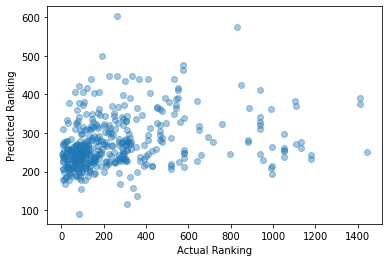

Train score for predicting Winnings from FirstServePointsWon and ReturnPointsWon: 0.2053403970362483
Test score for predicting Winnings from FirstServePointsWon and ReturnPointsWon: 0.20891801039276503 



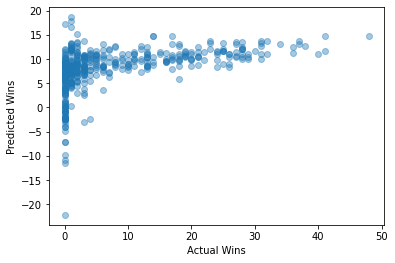

Train score for predicting Winnings from FirstServePointsWon and ReturnPointsWon: 0.1912821865689779
Test score for predicting Winnings from FirstServePointsWon and ReturnPointsWon: 0.14165226610307025 



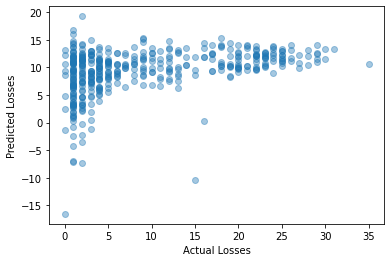

Train score for predicting Winnings from FirstServePointsWon and ReturnPointsWon: 0.20857008026792878
Test score for predicting Winnings from FirstServePointsWon and ReturnPointsWon: 0.1907146785299526 



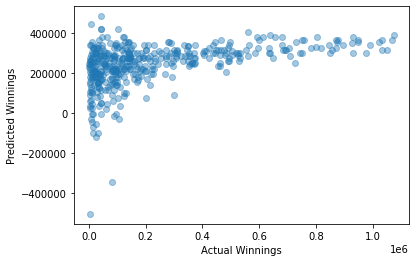

Train score for predicting Winnings from FirstServePointsWon and ReturnPointsWon: 0.061830598510357215
Test score for predicting Winnings from FirstServePointsWon and ReturnPointsWon: 0.06775740754964865 



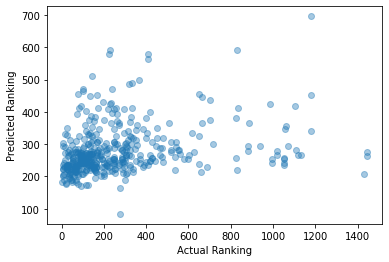

Train score for predicting Winnings from FirstServePointsWon and ServiceGamesPlayed: 0.8659465301390127
Test score for predicting Winnings from FirstServePointsWon and ServiceGamesPlayed: 0.8556262900262214 



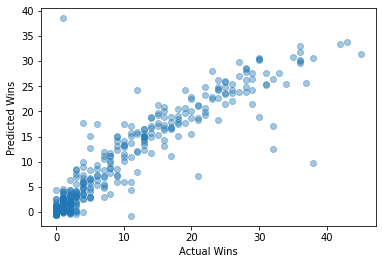

Train score for predicting Winnings from FirstServePointsWon and ServiceGamesPlayed: 0.868982679307849
Test score for predicting Winnings from FirstServePointsWon and ServiceGamesPlayed: 0.8941589593174442 



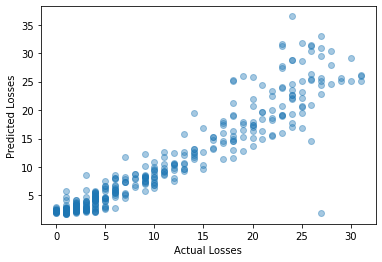

Train score for predicting Winnings from FirstServePointsWon and ServiceGamesPlayed: 0.8277293445257706
Test score for predicting Winnings from FirstServePointsWon and ServiceGamesPlayed: 0.85394084294515 



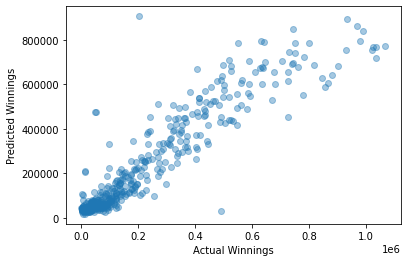

Train score for predicting Winnings from FirstServePointsWon and ServiceGamesPlayed: 0.09905226209250308
Test score for predicting Winnings from FirstServePointsWon and ServiceGamesPlayed: 0.15045709341448532 



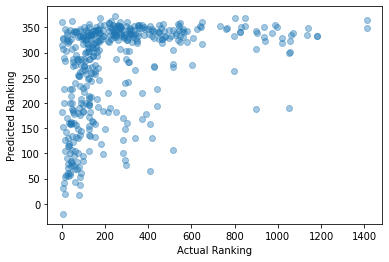

Train score for predicting Winnings from FirstServePointsWon and ServiceGamesWon: 0.15356490299331993
Test score for predicting Winnings from FirstServePointsWon and ServiceGamesWon: 0.14306603424376285 



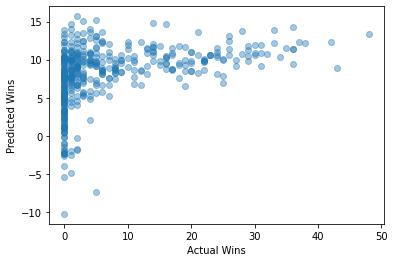

Train score for predicting Winnings from FirstServePointsWon and ServiceGamesWon: 0.13654116613441514
Test score for predicting Winnings from FirstServePointsWon and ServiceGamesWon: 0.1395943588736951 



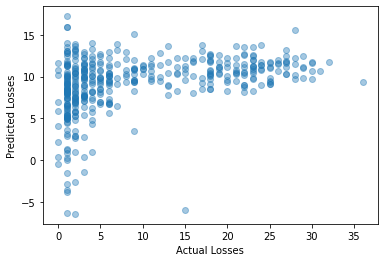

Train score for predicting Winnings from FirstServePointsWon and ServiceGamesWon: 0.1693838870922797
Test score for predicting Winnings from FirstServePointsWon and ServiceGamesWon: 0.13270827242087646 



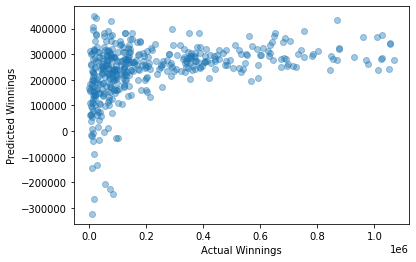

Train score for predicting Winnings from FirstServePointsWon and ServiceGamesWon: 0.038665500879543346
Test score for predicting Winnings from FirstServePointsWon and ServiceGamesWon: 0.034573554402526296 



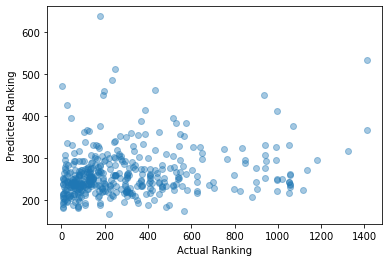

Train score for predicting Winnings from FirstServePointsWon and TotalPointsWon: 0.23222147327197684
Test score for predicting Winnings from FirstServePointsWon and TotalPointsWon: 0.1596980486968611 



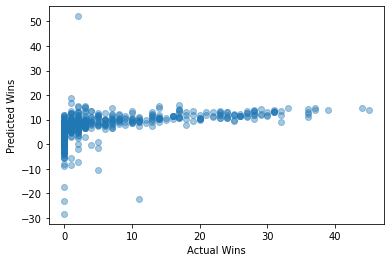

Train score for predicting Winnings from FirstServePointsWon and TotalPointsWon: 0.19247574049675079
Test score for predicting Winnings from FirstServePointsWon and TotalPointsWon: 0.1748138556723594 



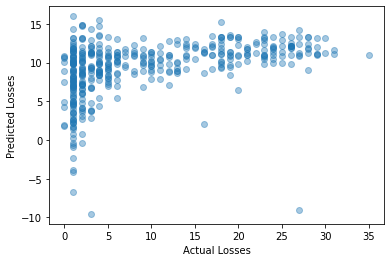

Train score for predicting Winnings from FirstServePointsWon and TotalPointsWon: 0.22455540226407086
Test score for predicting Winnings from FirstServePointsWon and TotalPointsWon: 0.20018603730184503 



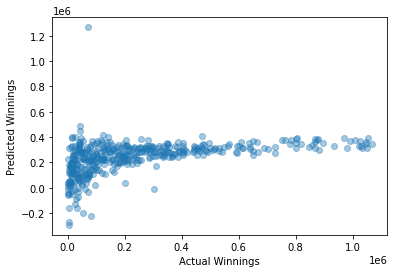

Train score for predicting Winnings from FirstServePointsWon and TotalPointsWon: 0.07873289201009537
Test score for predicting Winnings from FirstServePointsWon and TotalPointsWon: 0.06041282310658047 



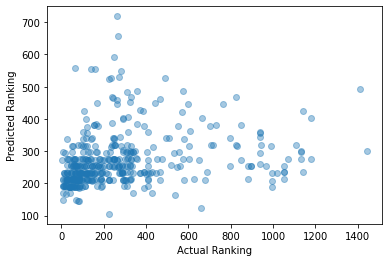

Train score for predicting Winnings from FirstServePointsWon and TotalServicePointsWon: 0.14772286760704612
Test score for predicting Winnings from FirstServePointsWon and TotalServicePointsWon: 0.19695696773360538 



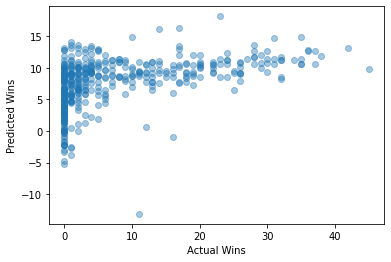

Train score for predicting Winnings from FirstServePointsWon and TotalServicePointsWon: 0.1326666350284461
Test score for predicting Winnings from FirstServePointsWon and TotalServicePointsWon: 0.15367684119753722 



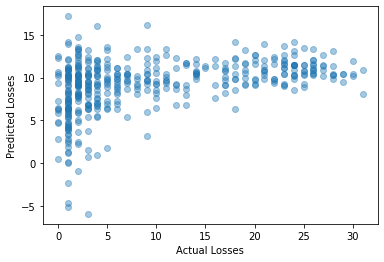

Train score for predicting Winnings from FirstServePointsWon and TotalServicePointsWon: 0.1804570495010277
Test score for predicting Winnings from FirstServePointsWon and TotalServicePointsWon: 0.09518559458626052 



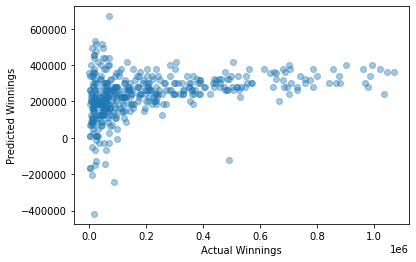

Train score for predicting Winnings from FirstServePointsWon and TotalServicePointsWon: 0.049841804689757185
Test score for predicting Winnings from FirstServePointsWon and TotalServicePointsWon: 0.03763975838654088 



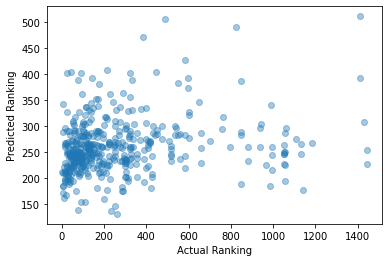

Train score for predicting Winnings from FirstServeReturnPointsWon and FirstServe: 0.06443144911137011
Test score for predicting Winnings from FirstServeReturnPointsWon and FirstServe: 0.08107024161173682 



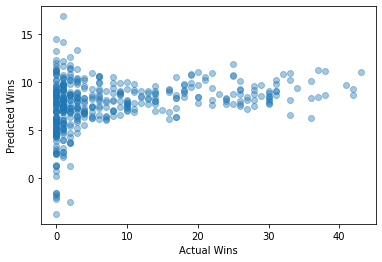

Train score for predicting Winnings from FirstServeReturnPointsWon and FirstServe: 0.05419397458550901
Test score for predicting Winnings from FirstServeReturnPointsWon and FirstServe: 0.06868540178959093 



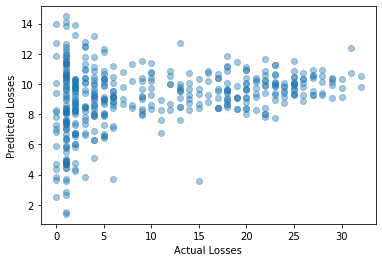

Train score for predicting Winnings from FirstServeReturnPointsWon and FirstServe: 0.06524030267637293
Test score for predicting Winnings from FirstServeReturnPointsWon and FirstServe: 0.03497848400596859 



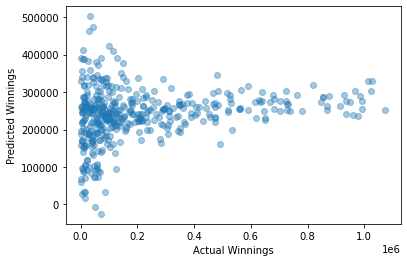

Train score for predicting Winnings from FirstServeReturnPointsWon and FirstServe: 0.0363434694177166
Test score for predicting Winnings from FirstServeReturnPointsWon and FirstServe: 0.03163165420905745 



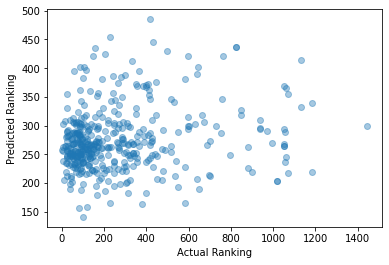

Train score for predicting Winnings from FirstServeReturnPointsWon and FirstServePointsWon: 0.19588793640056057
Test score for predicting Winnings from FirstServeReturnPointsWon and FirstServePointsWon: 0.16854946776828705 



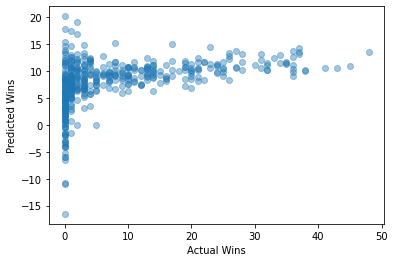

Train score for predicting Winnings from FirstServeReturnPointsWon and FirstServePointsWon: 0.167842445018488
Test score for predicting Winnings from FirstServeReturnPointsWon and FirstServePointsWon: 0.1516137637792273 



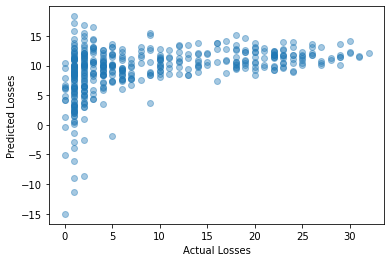

Train score for predicting Winnings from FirstServeReturnPointsWon and FirstServePointsWon: 0.1846987001824386
Test score for predicting Winnings from FirstServeReturnPointsWon and FirstServePointsWon: 0.18388625333599673 



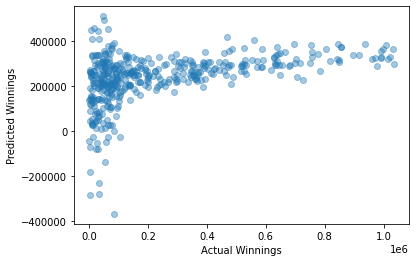

Train score for predicting Winnings from FirstServeReturnPointsWon and FirstServePointsWon: 0.05555581985739755
Test score for predicting Winnings from FirstServeReturnPointsWon and FirstServePointsWon: 0.04243786620454959 



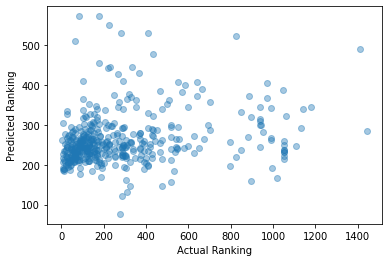

Train score for predicting Winnings from FirstServeReturnPointsWon and SecondServePointsWon: 0.12278060992158024
Test score for predicting Winnings from FirstServeReturnPointsWon and SecondServePointsWon: 0.13347544229661645 



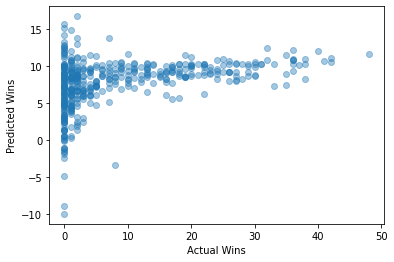

Train score for predicting Winnings from FirstServeReturnPointsWon and SecondServePointsWon: 0.12288954087762072
Test score for predicting Winnings from FirstServeReturnPointsWon and SecondServePointsWon: 0.07960843960174968 



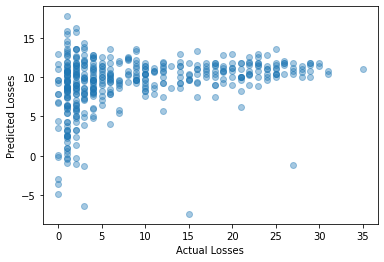

Train score for predicting Winnings from FirstServeReturnPointsWon and SecondServePointsWon: 0.1257910647410967
Test score for predicting Winnings from FirstServeReturnPointsWon and SecondServePointsWon: 0.13321989695615943 



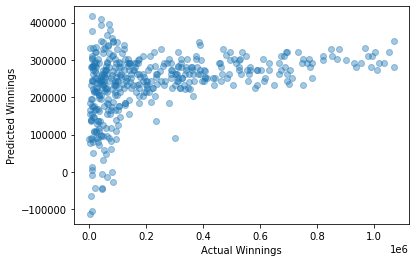

Train score for predicting Winnings from FirstServeReturnPointsWon and SecondServePointsWon: 0.06175308252858003
Test score for predicting Winnings from FirstServeReturnPointsWon and SecondServePointsWon: 0.04292948259458895 



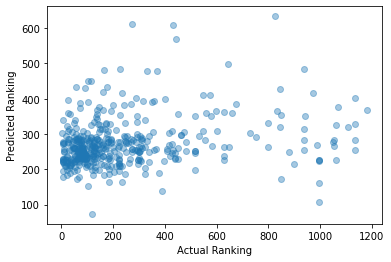

Train score for predicting Winnings from FirstServeReturnPointsWon and SecondServeReturnPointsWon: 0.08120320849758855
Test score for predicting Winnings from FirstServeReturnPointsWon and SecondServeReturnPointsWon: 0.07628113125129443 



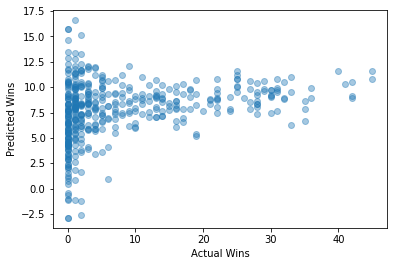

Train score for predicting Winnings from FirstServeReturnPointsWon and SecondServeReturnPointsWon: 0.07694233842005516
Test score for predicting Winnings from FirstServeReturnPointsWon and SecondServeReturnPointsWon: 0.05093174605415218 



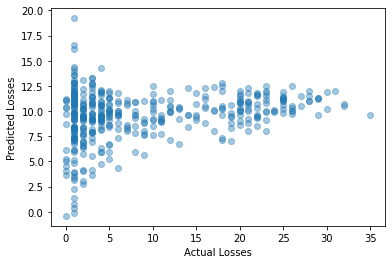

Train score for predicting Winnings from FirstServeReturnPointsWon and SecondServeReturnPointsWon: 0.07532330625551353
Test score for predicting Winnings from FirstServeReturnPointsWon and SecondServeReturnPointsWon: 0.07622171929302068 



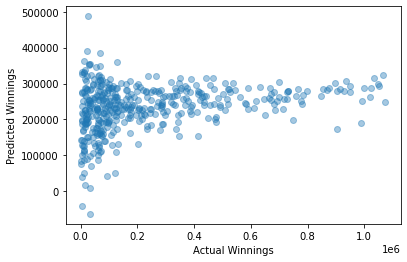

Train score for predicting Winnings from FirstServeReturnPointsWon and SecondServeReturnPointsWon: 0.048940477497857786
Test score for predicting Winnings from FirstServeReturnPointsWon and SecondServeReturnPointsWon: 0.02842561001853694 



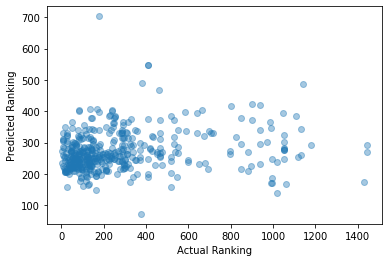

Train score for predicting Winnings from FirstServeReturnPointsWon and Aces: 0.7033538518612209
Test score for predicting Winnings from FirstServeReturnPointsWon and Aces: 0.6934903577938443 



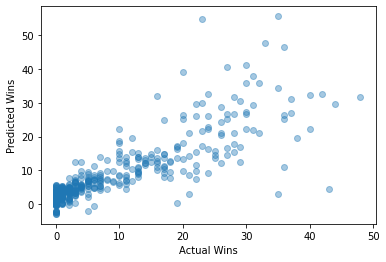

Train score for predicting Winnings from FirstServeReturnPointsWon and Aces: 0.6196779675465861
Test score for predicting Winnings from FirstServeReturnPointsWon and Aces: 0.5696543739556658 



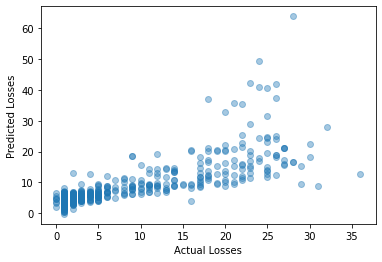

Train score for predicting Winnings from FirstServeReturnPointsWon and Aces: 0.6726553596198293
Test score for predicting Winnings from FirstServeReturnPointsWon and Aces: 0.596638895306218 



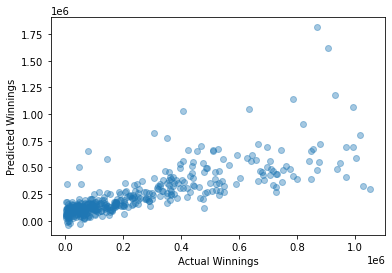

Train score for predicting Winnings from FirstServeReturnPointsWon and Aces: 0.09911621320907116
Test score for predicting Winnings from FirstServeReturnPointsWon and Aces: 0.07115611933584332 



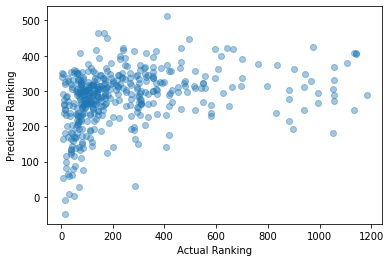

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsConverted: 0.0646135397312827
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsConverted: 0.06111511680817672 



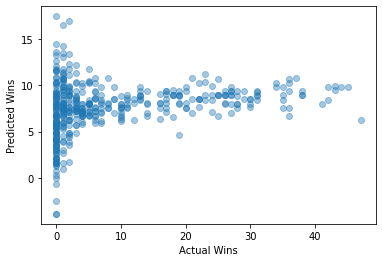

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsConverted: 0.05734298542680816
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsConverted: 0.06546422998231893 



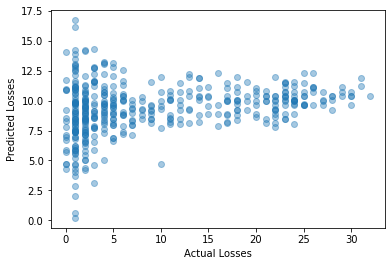

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsConverted: 0.07175791288622169
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsConverted: 0.009087094521531447 



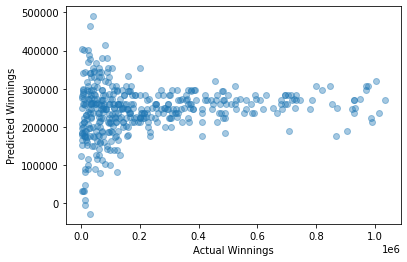

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsConverted: 0.03453875123579053
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsConverted: 0.022637723890773787 



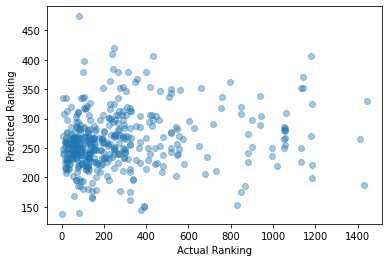

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsFaced: 0.777930696808768
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsFaced: 0.7877403391976092 



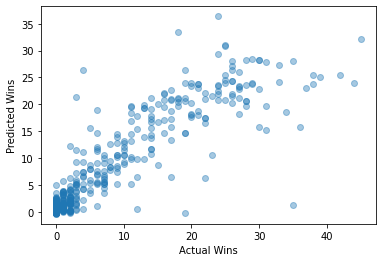

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsFaced: 0.8860478916971344
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsFaced: 0.9059269180919248 



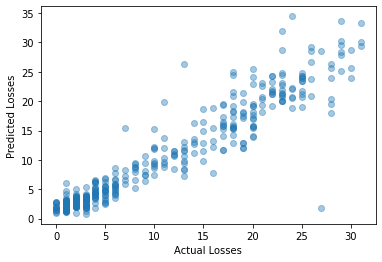

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsFaced: 0.760808702524946
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsFaced: 0.7889861582444979 



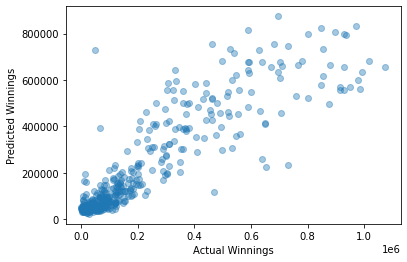

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsFaced: 0.10528489910759609
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsFaced: 0.12205020798549182 



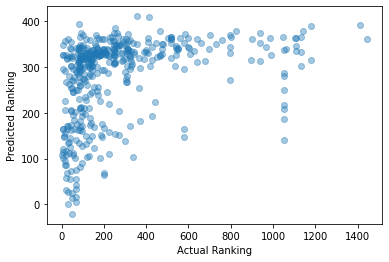

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsOpportunities: 0.8434317934314286
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsOpportunities: 0.8897521495639509 



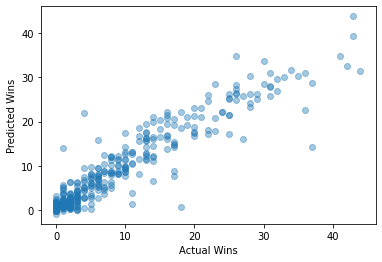

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsOpportunities: 0.8349103403941445
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsOpportunities: 0.8099887114683921 



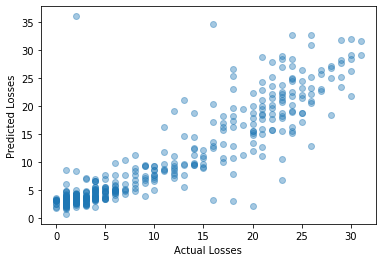

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsOpportunities: 0.8163152087308614
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsOpportunities: 0.8011715586194442 



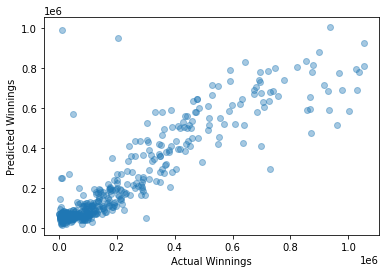

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsOpportunities: 0.12211742955710203
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsOpportunities: 0.10382875886888554 



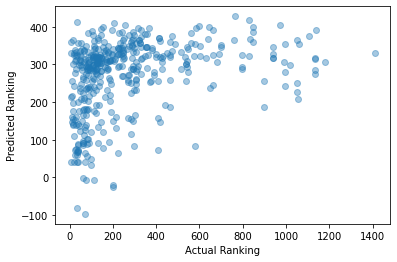

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsSaved: 0.12279443885117058
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsSaved: 0.12228958902833242 



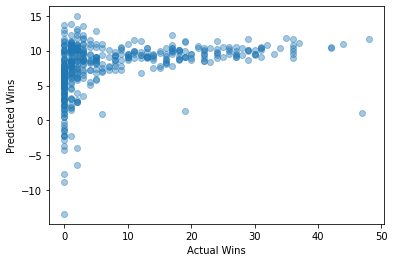

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsSaved: 0.11943566580903475
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsSaved: 0.09027935140147048 



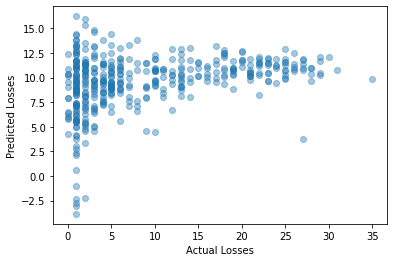

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsSaved: 0.113668335692221
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsSaved: 0.13097974602752938 



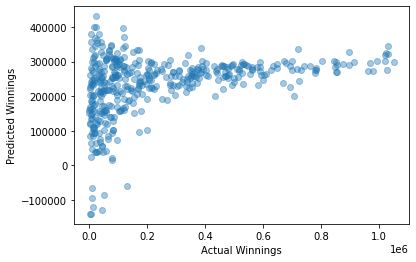

Train score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsSaved: 0.044861452625493785
Test score for predicting Winnings from FirstServeReturnPointsWon and BreakPointsSaved: 0.027022452708527545 



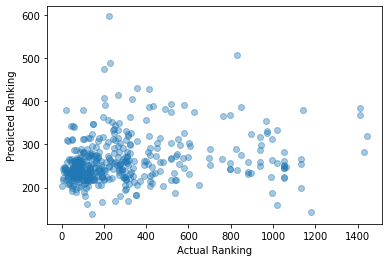

Train score for predicting Winnings from FirstServeReturnPointsWon and DoubleFaults: 0.720518637083855
Test score for predicting Winnings from FirstServeReturnPointsWon and DoubleFaults: 0.7170812521161106 



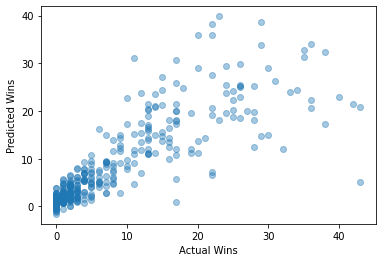

Train score for predicting Winnings from FirstServeReturnPointsWon and DoubleFaults: 0.774499023371412
Test score for predicting Winnings from FirstServeReturnPointsWon and DoubleFaults: 0.7897051277527734 



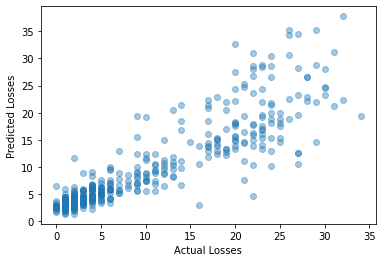

Train score for predicting Winnings from FirstServeReturnPointsWon and DoubleFaults: 0.7323151508675423
Test score for predicting Winnings from FirstServeReturnPointsWon and DoubleFaults: 0.7274750782418673 



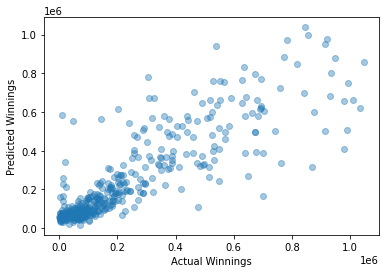

Train score for predicting Winnings from FirstServeReturnPointsWon and DoubleFaults: 0.10706010605381244
Test score for predicting Winnings from FirstServeReturnPointsWon and DoubleFaults: 0.0902403384738032 



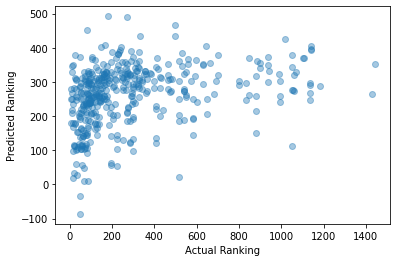

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesPlayed: 0.8594334115203042
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesPlayed: 0.8697424164462572 



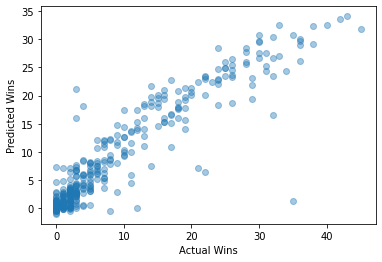

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesPlayed: 0.8877051965044035
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesPlayed: 0.8436594545229961 



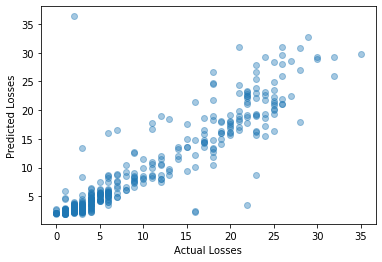

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesPlayed: 0.8375115853152468
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesPlayed: 0.8168244844462396 



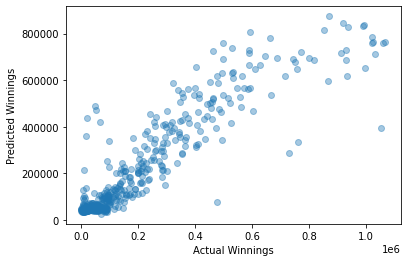

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesPlayed: 0.1295701941289723
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesPlayed: 0.08240491037252584 



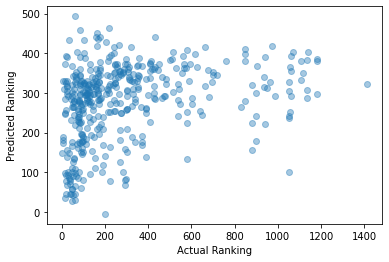

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesWon: 0.09357242482816874
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesWon: 0.06213102308191232 



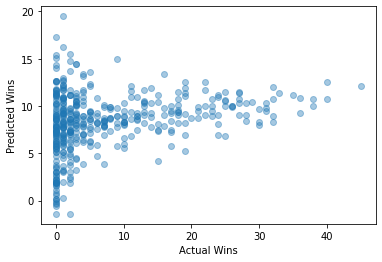

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesWon: 0.06851289819632256
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesWon: 0.08945764718295579 



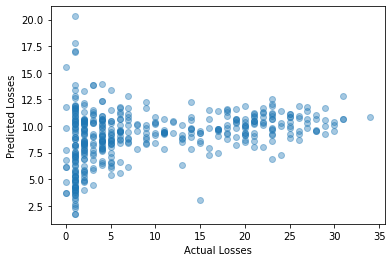

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesWon: 0.07939044051902955
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesWon: 0.08014669420067488 



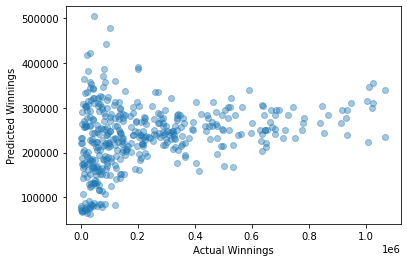

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesWon: 0.03644457960046388
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnGamesWon: 0.045353441424680896 



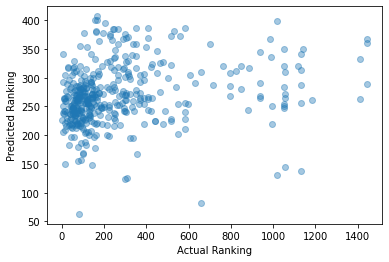

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnPointsWon: 0.08211691212688477
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnPointsWon: 0.06959575155908992 



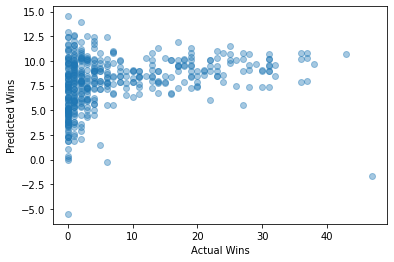

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnPointsWon: 0.06993226995341018
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnPointsWon: 0.07416319436396734 



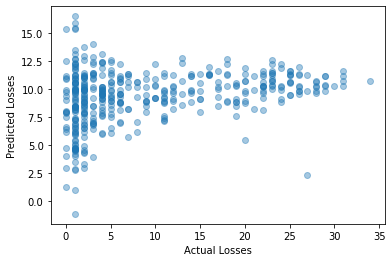

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnPointsWon: 0.06595524125318175
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnPointsWon: 0.09618237956543318 



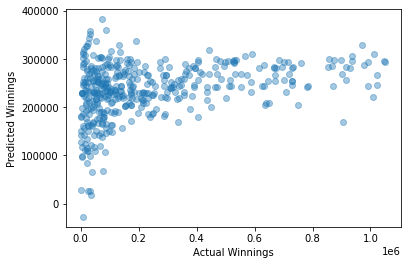

Train score for predicting Winnings from FirstServeReturnPointsWon and ReturnPointsWon: 0.04836994250779392
Test score for predicting Winnings from FirstServeReturnPointsWon and ReturnPointsWon: 0.01911832511641387 



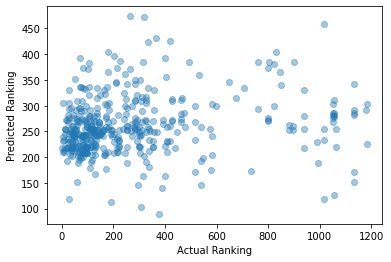

Train score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesPlayed: 0.8663908638915327
Test score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesPlayed: 0.853681406007115 



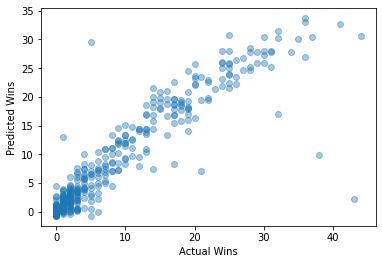

Train score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesPlayed: 0.8825142907744953
Test score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesPlayed: 0.8499327599873236 



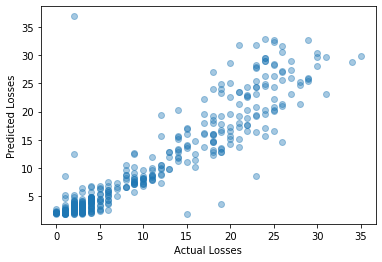

Train score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesPlayed: 0.8226843301617142
Test score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesPlayed: 0.8683397315100871 



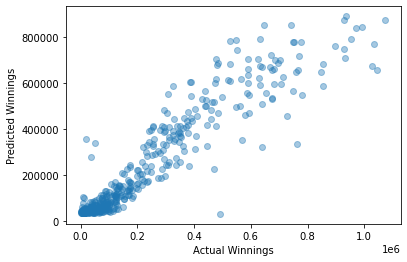

Train score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesPlayed: 0.12022626119441626
Test score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesPlayed: 0.11060832568970558 



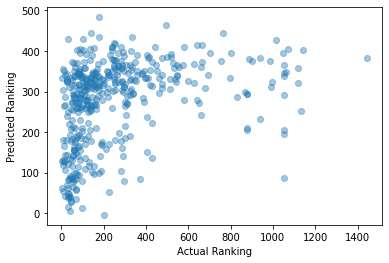

Train score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesWon: 0.1891564117457888
Test score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesWon: 0.2214703745390797 



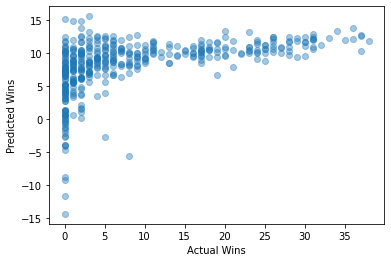

Train score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesWon: 0.17911520897069633
Test score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesWon: 0.173732057952238 



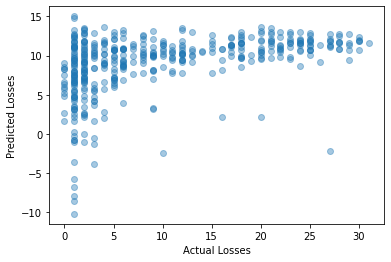

Train score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesWon: 0.21048336490267114
Test score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesWon: 0.1469553144021506 



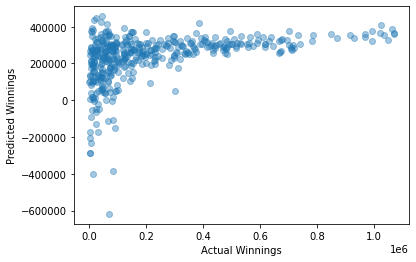

Train score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesWon: 0.053992947483163634
Test score for predicting Winnings from FirstServeReturnPointsWon and ServiceGamesWon: 0.09906174800970546 



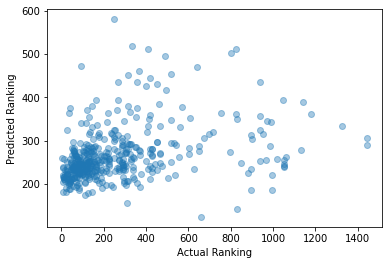

Train score for predicting Winnings from FirstServeReturnPointsWon and TotalPointsWon: 0.21645740528355173
Test score for predicting Winnings from FirstServeReturnPointsWon and TotalPointsWon: 0.1966698813715675 



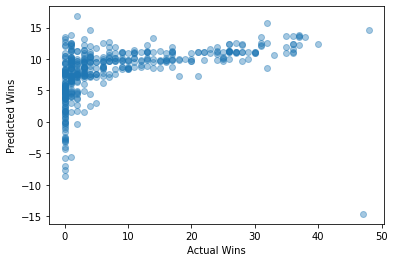

Train score for predicting Winnings from FirstServeReturnPointsWon and TotalPointsWon: 0.16997362970479502
Test score for predicting Winnings from FirstServeReturnPointsWon and TotalPointsWon: 0.22900880725468742 



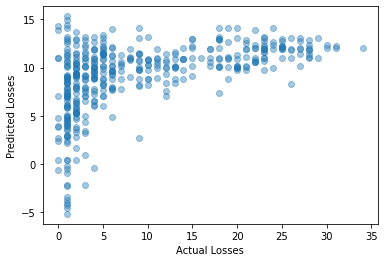

Train score for predicting Winnings from FirstServeReturnPointsWon and TotalPointsWon: 0.20573949094294242
Test score for predicting Winnings from FirstServeReturnPointsWon and TotalPointsWon: 0.2219378755724195 



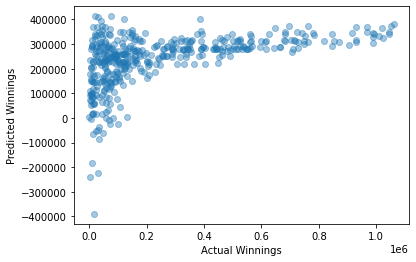

Train score for predicting Winnings from FirstServeReturnPointsWon and TotalPointsWon: 0.08206994132746115
Test score for predicting Winnings from FirstServeReturnPointsWon and TotalPointsWon: 0.06000178289241587 



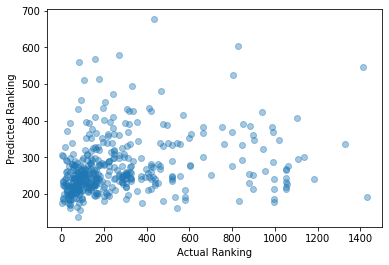

Train score for predicting Winnings from FirstServeReturnPointsWon and TotalServicePointsWon: 0.20536406000679475
Test score for predicting Winnings from FirstServeReturnPointsWon and TotalServicePointsWon: 0.23505225249953632 



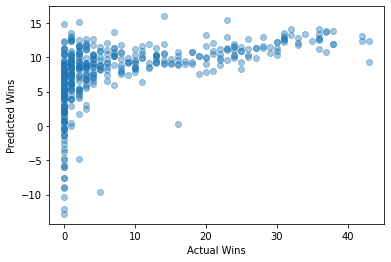

Train score for predicting Winnings from FirstServeReturnPointsWon and TotalServicePointsWon: 0.1874800673208746
Test score for predicting Winnings from FirstServeReturnPointsWon and TotalServicePointsWon: 0.17920724604925897 



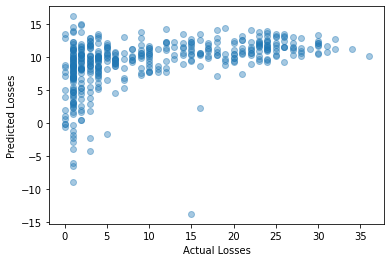

Train score for predicting Winnings from FirstServeReturnPointsWon and TotalServicePointsWon: 0.21234304426383033
Test score for predicting Winnings from FirstServeReturnPointsWon and TotalServicePointsWon: 0.21882660882501437 



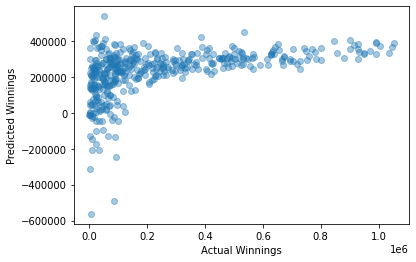

Train score for predicting Winnings from FirstServeReturnPointsWon and TotalServicePointsWon: 0.09348983177520721
Test score for predicting Winnings from FirstServeReturnPointsWon and TotalServicePointsWon: 0.005262354938485259 



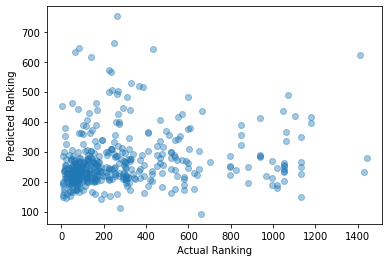

Train score for predicting Winnings from SecondServePointsWon and FirstServe: 0.07709623877186733
Test score for predicting Winnings from SecondServePointsWon and FirstServe: 0.0632235935079527 



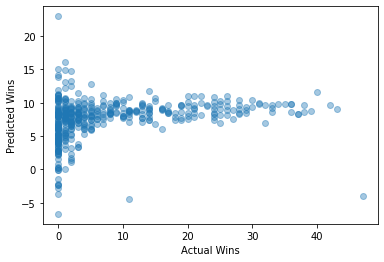

Train score for predicting Winnings from SecondServePointsWon and FirstServe: 0.06209708235480371
Test score for predicting Winnings from SecondServePointsWon and FirstServe: 0.06657812682829178 



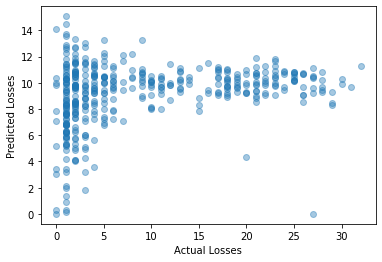

Train score for predicting Winnings from SecondServePointsWon and FirstServe: 0.08337170641520397
Test score for predicting Winnings from SecondServePointsWon and FirstServe: 0.062420082004734034 



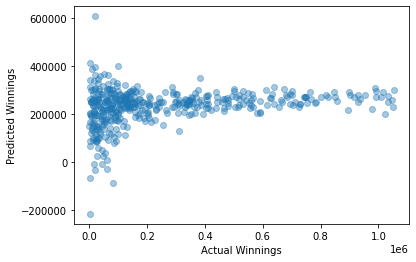

Train score for predicting Winnings from SecondServePointsWon and FirstServe: 0.03373444850314977
Test score for predicting Winnings from SecondServePointsWon and FirstServe: 0.03559485092144277 



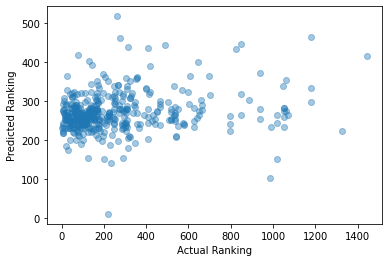

Train score for predicting Winnings from SecondServePointsWon and FirstServePointsWon: 0.14223057662314023
Test score for predicting Winnings from SecondServePointsWon and FirstServePointsWon: 0.18280248232324522 



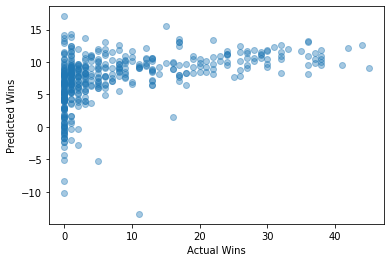

Train score for predicting Winnings from SecondServePointsWon and FirstServePointsWon: 0.1492203364822816
Test score for predicting Winnings from SecondServePointsWon and FirstServePointsWon: 0.07945248840284724 



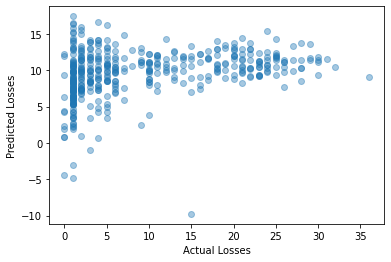

Train score for predicting Winnings from SecondServePointsWon and FirstServePointsWon: 0.15814827944220877
Test score for predicting Winnings from SecondServePointsWon and FirstServePointsWon: 0.168352151286576 



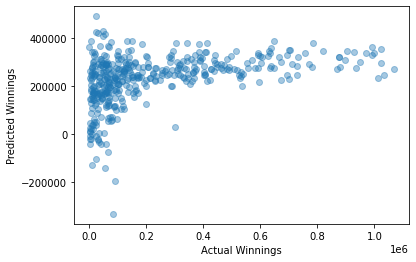

Train score for predicting Winnings from SecondServePointsWon and FirstServePointsWon: 0.039112827404994555
Test score for predicting Winnings from SecondServePointsWon and FirstServePointsWon: 0.04964218211522875 



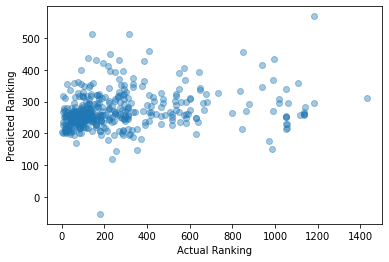

Train score for predicting Winnings from SecondServePointsWon and FirstServeReturnPointsWon: 0.12737775226596793
Test score for predicting Winnings from SecondServePointsWon and FirstServeReturnPointsWon: 0.11916670299368669 



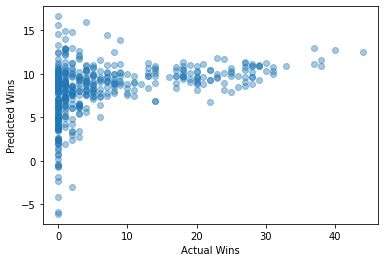

Train score for predicting Winnings from SecondServePointsWon and FirstServeReturnPointsWon: 0.11702806698515944
Test score for predicting Winnings from SecondServePointsWon and FirstServeReturnPointsWon: 0.102654978850371 



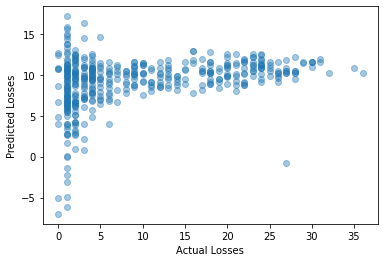

Train score for predicting Winnings from SecondServePointsWon and FirstServeReturnPointsWon: 0.1278522974811196
Test score for predicting Winnings from SecondServePointsWon and FirstServeReturnPointsWon: 0.11856075178534509 



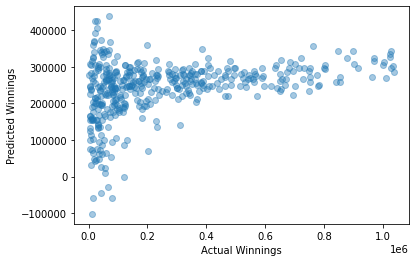

Train score for predicting Winnings from SecondServePointsWon and FirstServeReturnPointsWon: 0.06406616369859996
Test score for predicting Winnings from SecondServePointsWon and FirstServeReturnPointsWon: 0.0429641656499683 



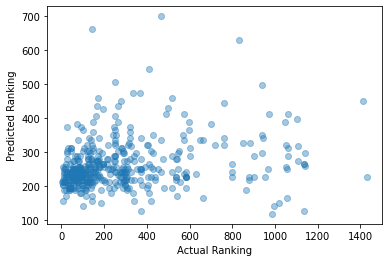

Train score for predicting Winnings from SecondServePointsWon and SecondServeReturnPointsWon: 0.09894601613375031
Test score for predicting Winnings from SecondServePointsWon and SecondServeReturnPointsWon: 0.10065791288182746 



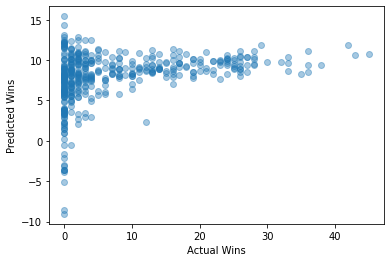

Train score for predicting Winnings from SecondServePointsWon and SecondServeReturnPointsWon: 0.09146835618092886
Test score for predicting Winnings from SecondServePointsWon and SecondServeReturnPointsWon: 0.06581364700385162 



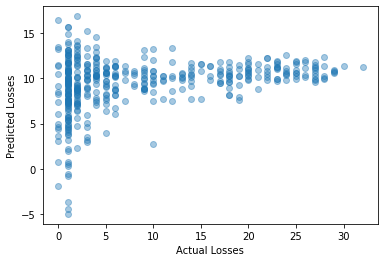

Train score for predicting Winnings from SecondServePointsWon and SecondServeReturnPointsWon: 0.10147737160835613
Test score for predicting Winnings from SecondServePointsWon and SecondServeReturnPointsWon: 0.11141264644682691 



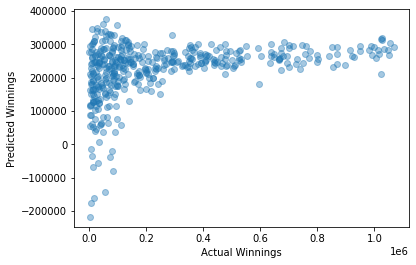

Train score for predicting Winnings from SecondServePointsWon and SecondServeReturnPointsWon: 0.0525008075868918
Test score for predicting Winnings from SecondServePointsWon and SecondServeReturnPointsWon: 0.05106982703931673 



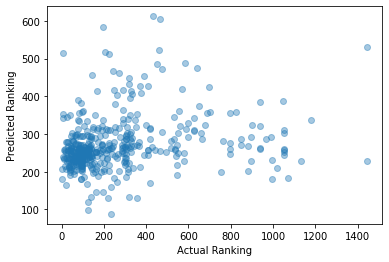

Train score for predicting Winnings from SecondServePointsWon and Aces: 0.6874062816979672
Test score for predicting Winnings from SecondServePointsWon and Aces: 0.6687149783276555 



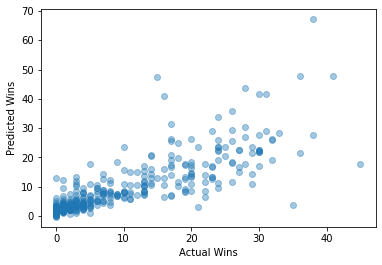

Train score for predicting Winnings from SecondServePointsWon and Aces: 0.5749412544370984
Test score for predicting Winnings from SecondServePointsWon and Aces: 0.6448265739149441 



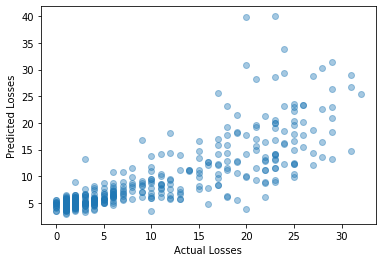

Train score for predicting Winnings from SecondServePointsWon and Aces: 0.6342346959708702
Test score for predicting Winnings from SecondServePointsWon and Aces: 0.6671224523346881 



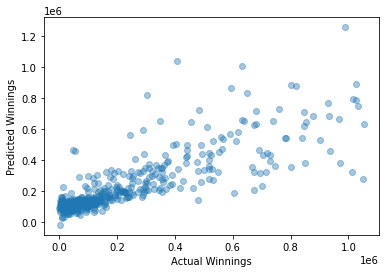

Train score for predicting Winnings from SecondServePointsWon and Aces: 0.09907681266914925
Test score for predicting Winnings from SecondServePointsWon and Aces: 0.05979256138993805 



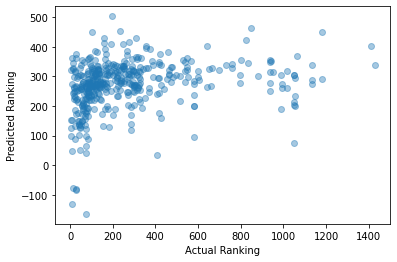

Train score for predicting Winnings from SecondServePointsWon and BreakPointsConverted: 0.07661878727310134
Test score for predicting Winnings from SecondServePointsWon and BreakPointsConverted: 0.07296505073789972 



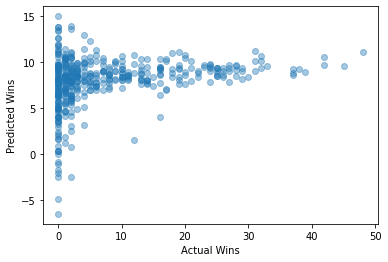

Train score for predicting Winnings from SecondServePointsWon and BreakPointsConverted: 0.07297769157587819
Test score for predicting Winnings from SecondServePointsWon and BreakPointsConverted: 0.03724648779276585 



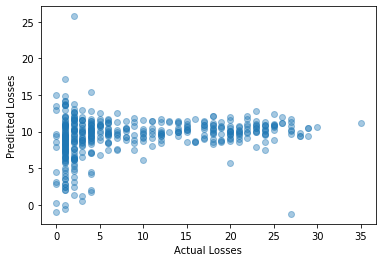

Train score for predicting Winnings from SecondServePointsWon and BreakPointsConverted: 0.08861034718196303
Test score for predicting Winnings from SecondServePointsWon and BreakPointsConverted: 0.0628668216913646 



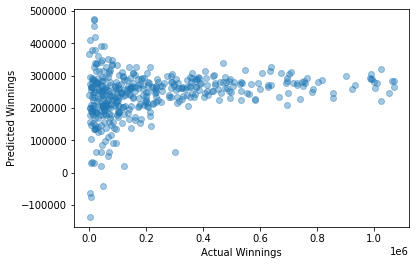

Train score for predicting Winnings from SecondServePointsWon and BreakPointsConverted: 0.03937115657396628
Test score for predicting Winnings from SecondServePointsWon and BreakPointsConverted: 0.010015846978129626 



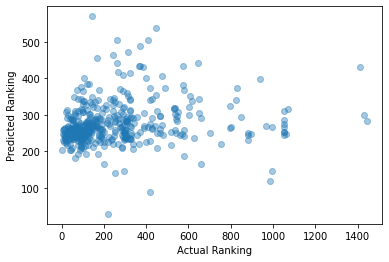

Train score for predicting Winnings from SecondServePointsWon and BreakPointsFaced: 0.7874613369973351
Test score for predicting Winnings from SecondServePointsWon and BreakPointsFaced: 0.7663424390149361 



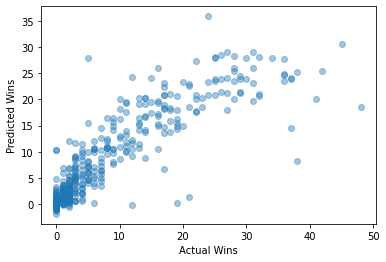

Train score for predicting Winnings from SecondServePointsWon and BreakPointsFaced: 0.8818246139966791
Test score for predicting Winnings from SecondServePointsWon and BreakPointsFaced: 0.915563762718448 



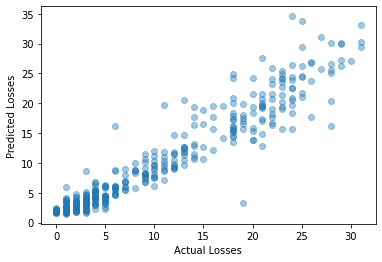

Train score for predicting Winnings from SecondServePointsWon and BreakPointsFaced: 0.772173961566019
Test score for predicting Winnings from SecondServePointsWon and BreakPointsFaced: 0.7657028416130913 



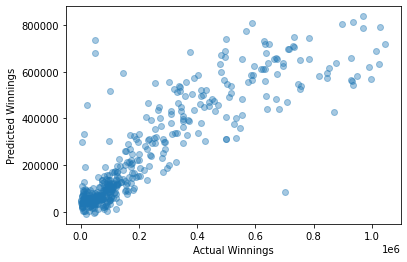

Train score for predicting Winnings from SecondServePointsWon and BreakPointsFaced: 0.10429361647058288
Test score for predicting Winnings from SecondServePointsWon and BreakPointsFaced: 0.1398083568088494 



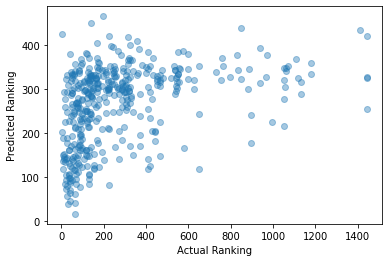

Train score for predicting Winnings from SecondServePointsWon and BreakPointsOpportunities: 0.8543858905117228
Test score for predicting Winnings from SecondServePointsWon and BreakPointsOpportunities: 0.8488848186386944 



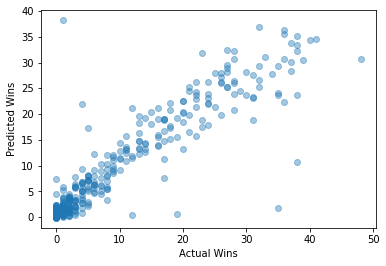

Train score for predicting Winnings from SecondServePointsWon and BreakPointsOpportunities: 0.8298390413638909
Test score for predicting Winnings from SecondServePointsWon and BreakPointsOpportunities: 0.8160479804788868 



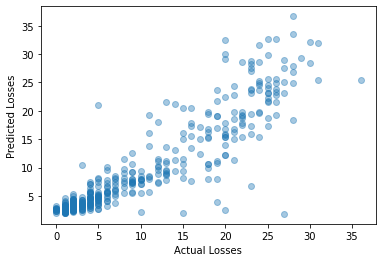

Train score for predicting Winnings from SecondServePointsWon and BreakPointsOpportunities: 0.8147377674197187
Test score for predicting Winnings from SecondServePointsWon and BreakPointsOpportunities: 0.8006663491266734 



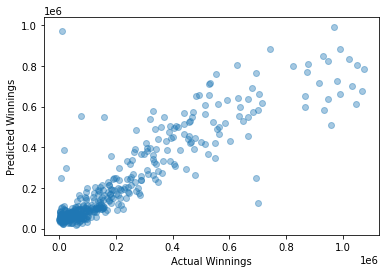

Train score for predicting Winnings from SecondServePointsWon and BreakPointsOpportunities: 0.11834081110505124
Test score for predicting Winnings from SecondServePointsWon and BreakPointsOpportunities: 0.12660171546995302 



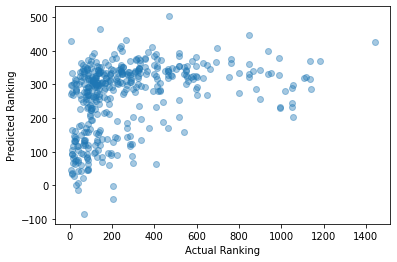

Train score for predicting Winnings from SecondServePointsWon and BreakPointsSaved: 0.10007794687853755
Test score for predicting Winnings from SecondServePointsWon and BreakPointsSaved: 0.10552919495389855 



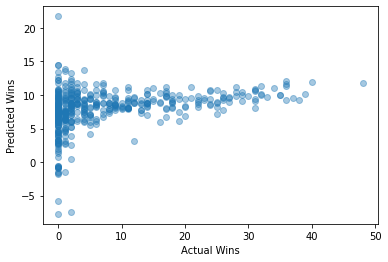

Train score for predicting Winnings from SecondServePointsWon and BreakPointsSaved: 0.0952232448307786
Test score for predicting Winnings from SecondServePointsWon and BreakPointsSaved: 0.07741497209303583 



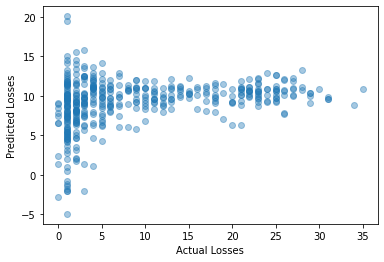

Train score for predicting Winnings from SecondServePointsWon and BreakPointsSaved: 0.1093675553745199
Test score for predicting Winnings from SecondServePointsWon and BreakPointsSaved: 0.1033967038631729 



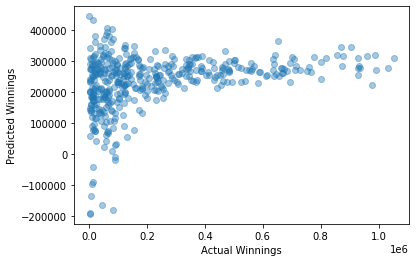

Train score for predicting Winnings from SecondServePointsWon and BreakPointsSaved: 0.03612346718850179
Test score for predicting Winnings from SecondServePointsWon and BreakPointsSaved: 0.03799866702074606 



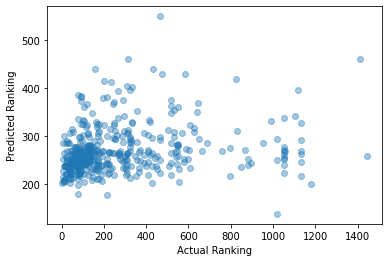

Train score for predicting Winnings from SecondServePointsWon and DoubleFaults: 0.7206923566966511
Test score for predicting Winnings from SecondServePointsWon and DoubleFaults: 0.7293598197692157 



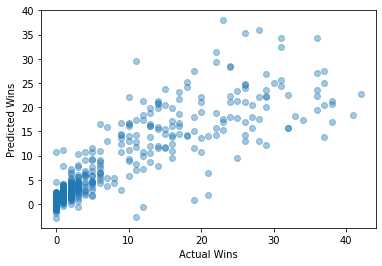

Train score for predicting Winnings from SecondServePointsWon and DoubleFaults: 0.7793253913836966
Test score for predicting Winnings from SecondServePointsWon and DoubleFaults: 0.7799449123435447 



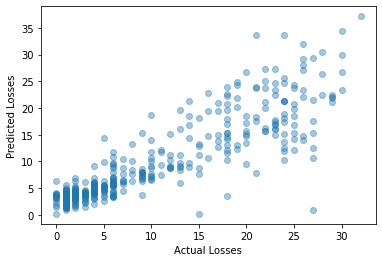

Train score for predicting Winnings from SecondServePointsWon and DoubleFaults: 0.7247285285609886
Test score for predicting Winnings from SecondServePointsWon and DoubleFaults: 0.7738735520026303 



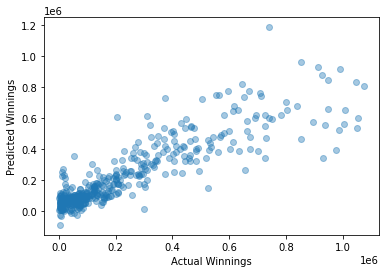

Train score for predicting Winnings from SecondServePointsWon and DoubleFaults: 0.10829152093771677
Test score for predicting Winnings from SecondServePointsWon and DoubleFaults: 0.09099613411985996 



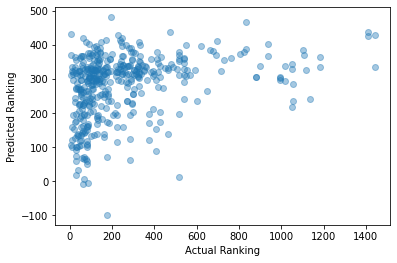

Train score for predicting Winnings from SecondServePointsWon and ReturnGamesPlayed: 0.8412013432224773
Test score for predicting Winnings from SecondServePointsWon and ReturnGamesPlayed: 0.9188780614961758 



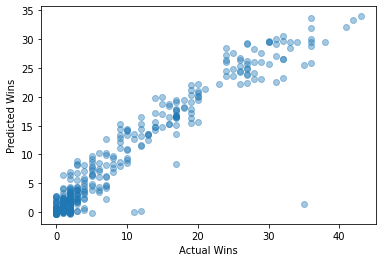

Train score for predicting Winnings from SecondServePointsWon and ReturnGamesPlayed: 0.8810321492157471
Test score for predicting Winnings from SecondServePointsWon and ReturnGamesPlayed: 0.8694798967293238 



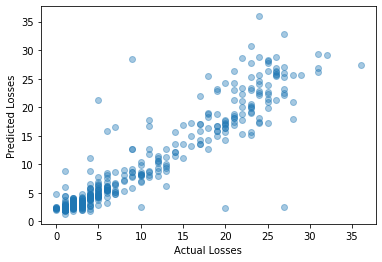

Train score for predicting Winnings from SecondServePointsWon and ReturnGamesPlayed: 0.8331187031092976
Test score for predicting Winnings from SecondServePointsWon and ReturnGamesPlayed: 0.8323130878471837 



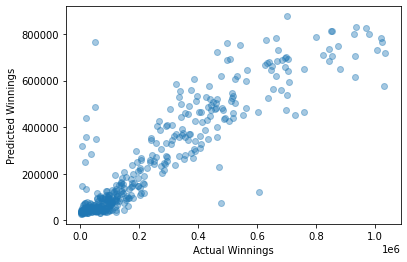

Train score for predicting Winnings from SecondServePointsWon and ReturnGamesPlayed: 0.11187263393033808
Test score for predicting Winnings from SecondServePointsWon and ReturnGamesPlayed: 0.13339821262745133 



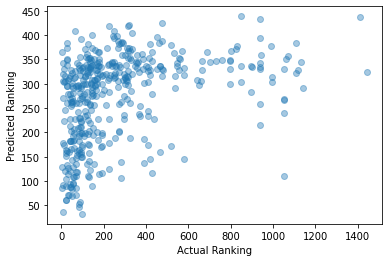

Train score for predicting Winnings from SecondServePointsWon and ReturnGamesWon: 0.1525582137731134
Test score for predicting Winnings from SecondServePointsWon and ReturnGamesWon: 0.11076409342804228 



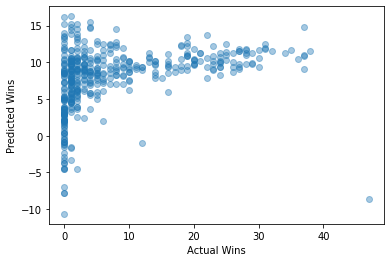

Train score for predicting Winnings from SecondServePointsWon and ReturnGamesWon: 0.11335423330560901
Test score for predicting Winnings from SecondServePointsWon and ReturnGamesWon: 0.14198451918310628 



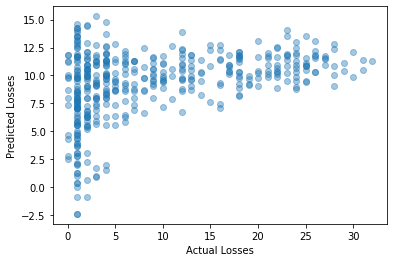

Train score for predicting Winnings from SecondServePointsWon and ReturnGamesWon: 0.14772275427906867
Test score for predicting Winnings from SecondServePointsWon and ReturnGamesWon: 0.12202805599132248 



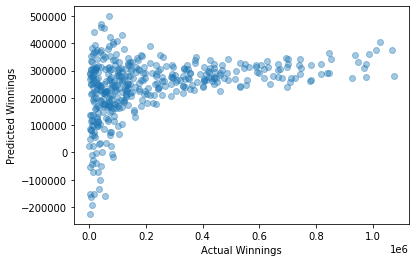

Train score for predicting Winnings from SecondServePointsWon and ReturnGamesWon: 0.06573437528002268
Test score for predicting Winnings from SecondServePointsWon and ReturnGamesWon: 0.05541841908503131 



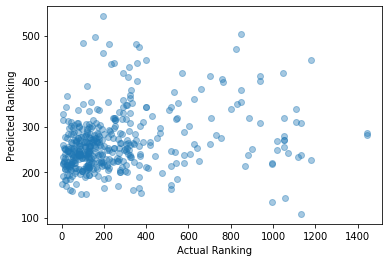

Train score for predicting Winnings from SecondServePointsWon and ReturnPointsWon: 0.14481489309222395
Test score for predicting Winnings from SecondServePointsWon and ReturnPointsWon: 0.10655308327520241 



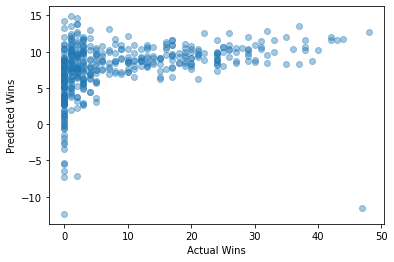

Train score for predicting Winnings from SecondServePointsWon and ReturnPointsWon: 0.10728623679060569
Test score for predicting Winnings from SecondServePointsWon and ReturnPointsWon: 0.1396964476003123 



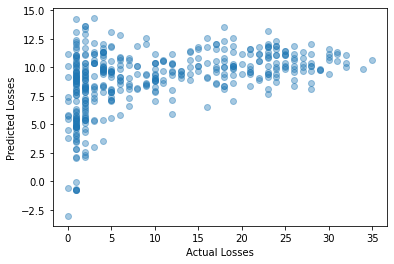

Train score for predicting Winnings from SecondServePointsWon and ReturnPointsWon: 0.14061245507994602
Test score for predicting Winnings from SecondServePointsWon and ReturnPointsWon: 0.13049138702096863 



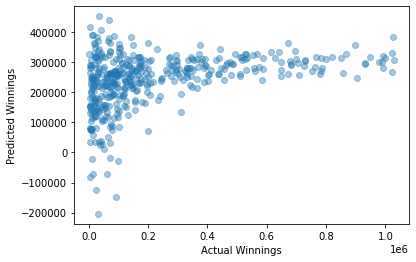

Train score for predicting Winnings from SecondServePointsWon and ReturnPointsWon: 0.06445516819895047
Test score for predicting Winnings from SecondServePointsWon and ReturnPointsWon: 0.07594447088996348 



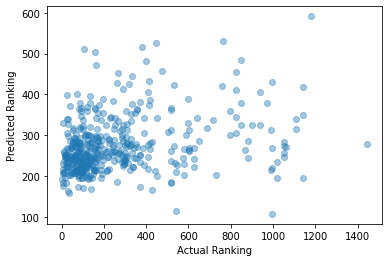

Train score for predicting Winnings from SecondServePointsWon and ServiceGamesPlayed: 0.8829977799423494
Test score for predicting Winnings from SecondServePointsWon and ServiceGamesPlayed: 0.8029351421206342 



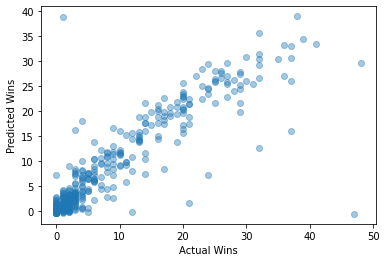

Train score for predicting Winnings from SecondServePointsWon and ServiceGamesPlayed: 0.87419612719123
Test score for predicting Winnings from SecondServePointsWon and ServiceGamesPlayed: 0.8781523404716938 



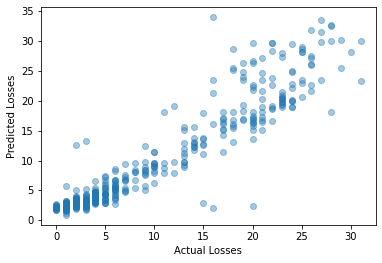

Train score for predicting Winnings from SecondServePointsWon and ServiceGamesPlayed: 0.8343887145657941
Test score for predicting Winnings from SecondServePointsWon and ServiceGamesPlayed: 0.8291845382172066 



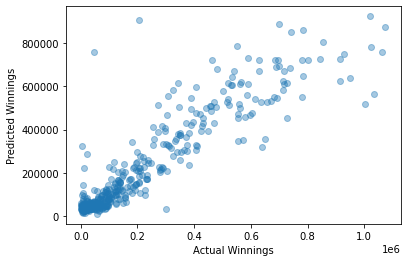

Train score for predicting Winnings from SecondServePointsWon and ServiceGamesPlayed: 0.13390412444393207
Test score for predicting Winnings from SecondServePointsWon and ServiceGamesPlayed: 0.0704399170508403 



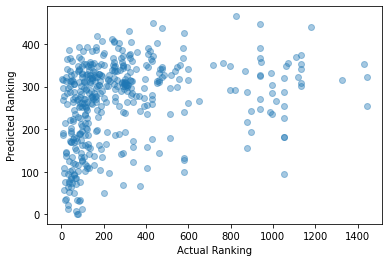

Train score for predicting Winnings from SecondServePointsWon and ServiceGamesWon: 0.1617065883832831
Test score for predicting Winnings from SecondServePointsWon and ServiceGamesWon: 0.09880815460422165 



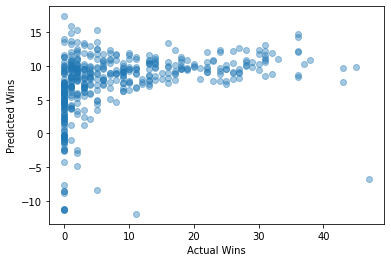

Train score for predicting Winnings from SecondServePointsWon and ServiceGamesWon: 0.12253725412242522
Test score for predicting Winnings from SecondServePointsWon and ServiceGamesWon: 0.17164175234927748 



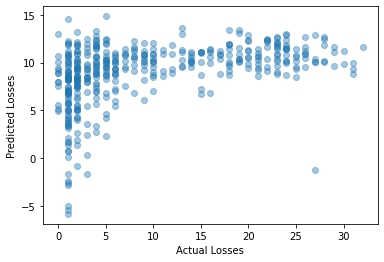

Train score for predicting Winnings from SecondServePointsWon and ServiceGamesWon: 0.15990776474531876
Test score for predicting Winnings from SecondServePointsWon and ServiceGamesWon: 0.15012149426703958 



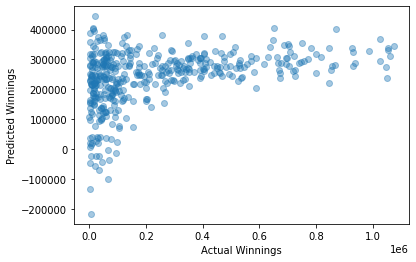

Train score for predicting Winnings from SecondServePointsWon and ServiceGamesWon: 0.05163175630779427
Test score for predicting Winnings from SecondServePointsWon and ServiceGamesWon: 0.01941782632133182 



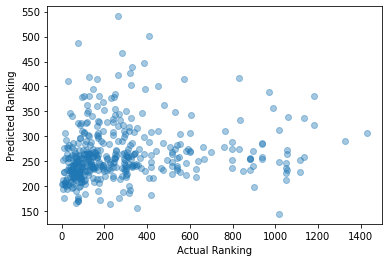

Train score for predicting Winnings from SecondServePointsWon and TotalPointsWon: 0.20499541372368368
Test score for predicting Winnings from SecondServePointsWon and TotalPointsWon: 0.23125908883510338 



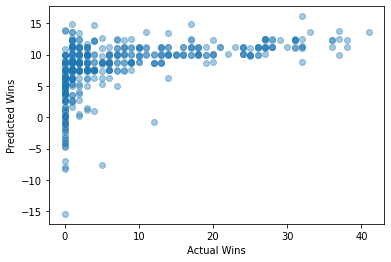

Train score for predicting Winnings from SecondServePointsWon and TotalPointsWon: 0.18558170630834495
Test score for predicting Winnings from SecondServePointsWon and TotalPointsWon: 0.16277366610438893 



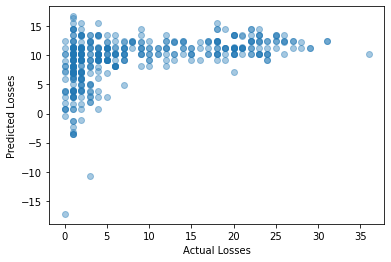

Train score for predicting Winnings from SecondServePointsWon and TotalPointsWon: 0.20215360215014666
Test score for predicting Winnings from SecondServePointsWon and TotalPointsWon: 0.23698694732896708 



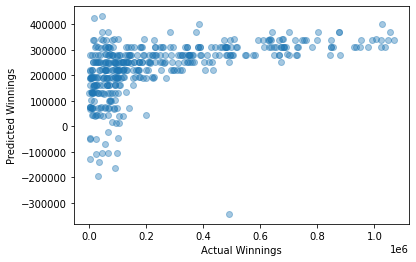

Train score for predicting Winnings from SecondServePointsWon and TotalPointsWon: 0.08158421436257624
Test score for predicting Winnings from SecondServePointsWon and TotalPointsWon: 0.05215134772140195 



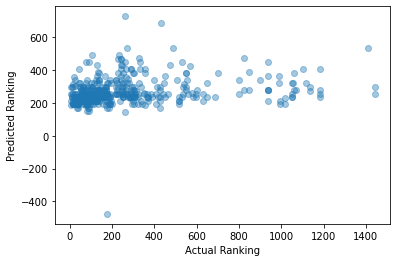

Train score for predicting Winnings from SecondServePointsWon and TotalServicePointsWon: 0.16518827625979537
Test score for predicting Winnings from SecondServePointsWon and TotalServicePointsWon: 0.13563194180019966 



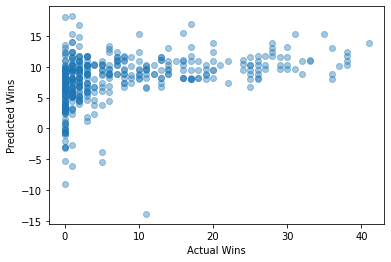

Train score for predicting Winnings from SecondServePointsWon and TotalServicePointsWon: 0.1325154030678677
Test score for predicting Winnings from SecondServePointsWon and TotalServicePointsWon: 0.15511530863166212 



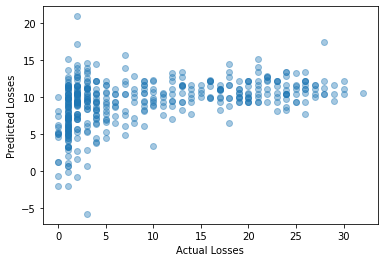

Train score for predicting Winnings from SecondServePointsWon and TotalServicePointsWon: 0.17346801891132124
Test score for predicting Winnings from SecondServePointsWon and TotalServicePointsWon: 0.13313002471087743 



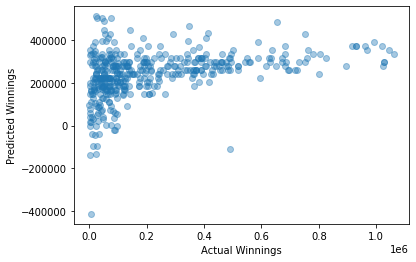

Train score for predicting Winnings from SecondServePointsWon and TotalServicePointsWon: 0.04390918521311871
Test score for predicting Winnings from SecondServePointsWon and TotalServicePointsWon: 0.04937275122630724 



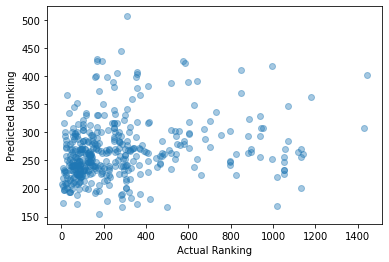

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServe: 0.044987781430716356
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServe: 0.03099835257504102 



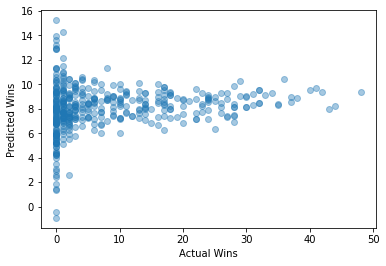

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServe: 0.03829259037905597
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServe: 0.03177593986746752 



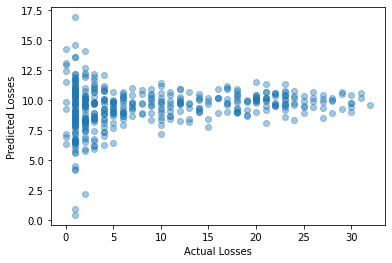

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServe: 0.044617803502585485
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServe: 0.03575865892599894 



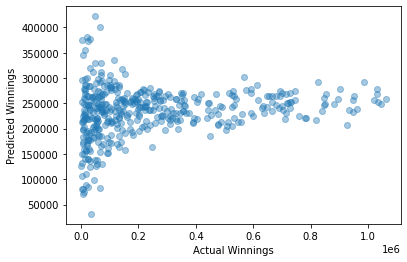

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServe: 0.025367846958858853
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServe: 0.04204981886582737 



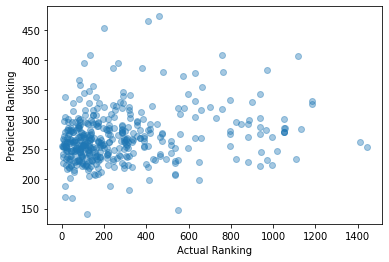

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServePointsWon: 0.16211059855816468
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServePointsWon: 0.1727438250469263 



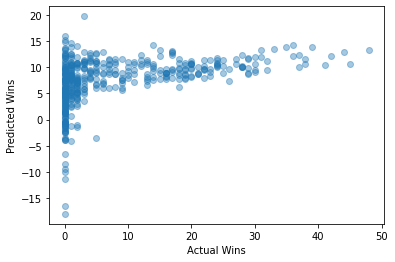

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServePointsWon: 0.14450365794324727
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServePointsWon: 0.13931215423625187 



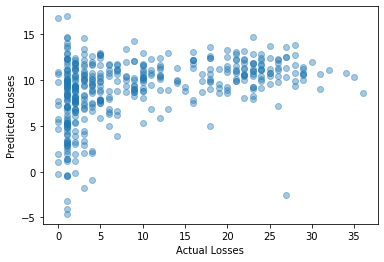

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServePointsWon: 0.1653518011512214
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServePointsWon: 0.18236602910004251 



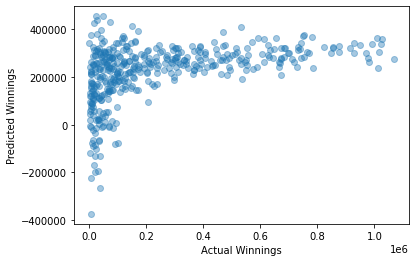

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServePointsWon: 0.043546230043911005
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServePointsWon: 0.059987791440561766 



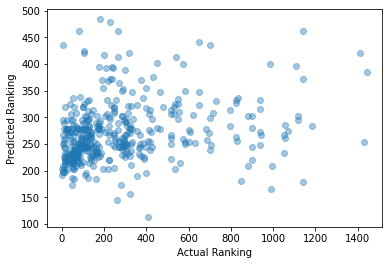

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServeReturnPointsWon: 0.08189546168743389
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServeReturnPointsWon: 0.0739728153496012 



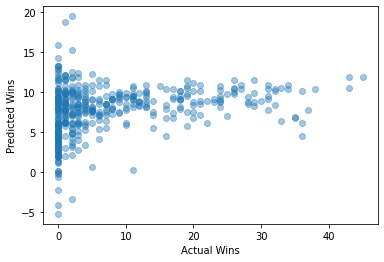

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServeReturnPointsWon: 0.07873991546743508
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServeReturnPointsWon: 0.05078832757754281 



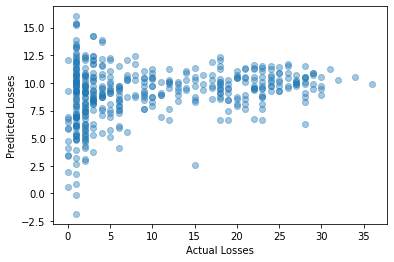

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServeReturnPointsWon: 0.0736045707986569
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServeReturnPointsWon: 0.07986976292762249 



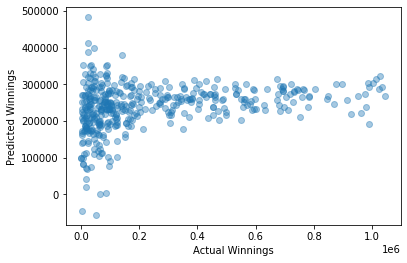

Train score for predicting Winnings from SecondServeReturnPointsWon and FirstServeReturnPointsWon: 0.05368376655017537
Test score for predicting Winnings from SecondServeReturnPointsWon and FirstServeReturnPointsWon: 0.011496921607863198 



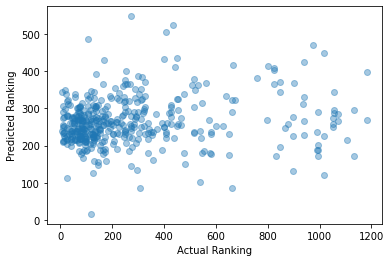

Train score for predicting Winnings from SecondServeReturnPointsWon and SecondServePointsWon: 0.09049221062600332
Test score for predicting Winnings from SecondServeReturnPointsWon and SecondServePointsWon: 0.12448122168308862 



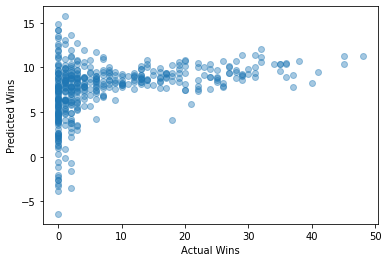

Train score for predicting Winnings from SecondServeReturnPointsWon and SecondServePointsWon: 0.08566105538469082
Test score for predicting Winnings from SecondServeReturnPointsWon and SecondServePointsWon: 0.0947728781036472 



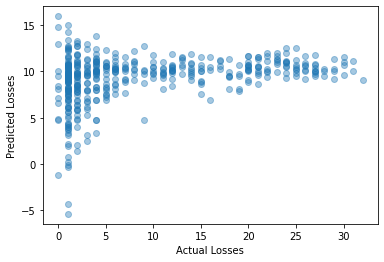

Train score for predicting Winnings from SecondServeReturnPointsWon and SecondServePointsWon: 0.10715427444605408
Test score for predicting Winnings from SecondServeReturnPointsWon and SecondServePointsWon: 0.11060824636695221 



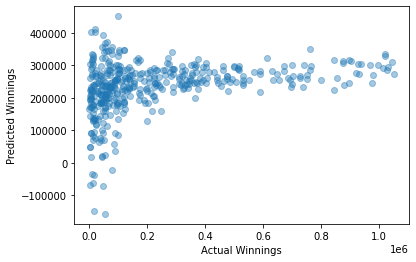

Train score for predicting Winnings from SecondServeReturnPointsWon and SecondServePointsWon: 0.05738462108198895
Test score for predicting Winnings from SecondServeReturnPointsWon and SecondServePointsWon: 0.03303884052748385 



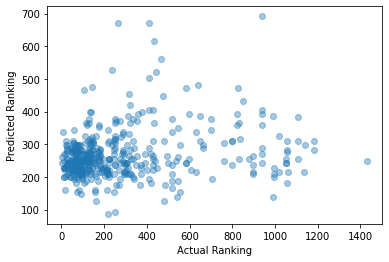

Train score for predicting Winnings from SecondServeReturnPointsWon and Aces: 0.6886481944850099
Test score for predicting Winnings from SecondServeReturnPointsWon and Aces: 0.7113885495628312 



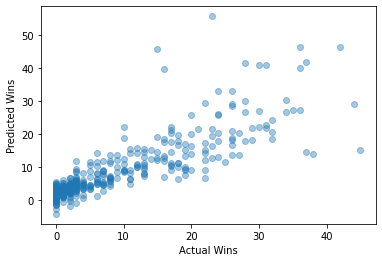

Train score for predicting Winnings from SecondServeReturnPointsWon and Aces: 0.6059601690056611
Test score for predicting Winnings from SecondServeReturnPointsWon and Aces: 0.5935462877544568 



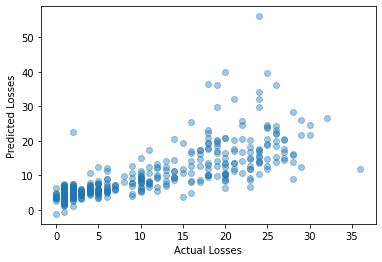

Train score for predicting Winnings from SecondServeReturnPointsWon and Aces: 0.6490814016101465
Test score for predicting Winnings from SecondServeReturnPointsWon and Aces: 0.6618848695626711 



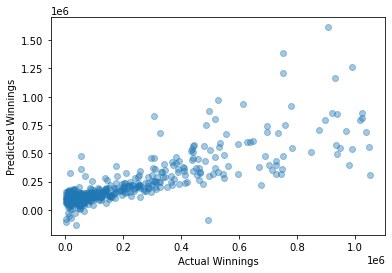

Train score for predicting Winnings from SecondServeReturnPointsWon and Aces: 0.10762673989849547
Test score for predicting Winnings from SecondServeReturnPointsWon and Aces: 0.04945504847378679 



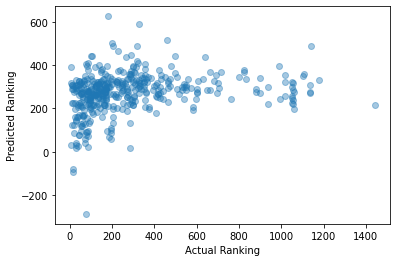

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsConverted: 0.04392392444114446
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsConverted: 0.01739611252011608 



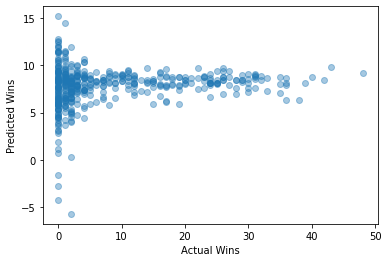

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsConverted: 0.03586980480475388
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsConverted: 0.022787452388982943 



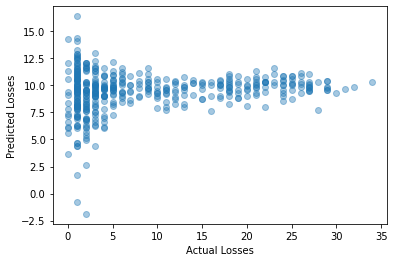

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsConverted: 0.046488179065876545
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsConverted: 0.01643741229041773 



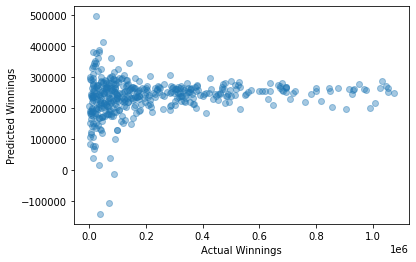

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsConverted: 0.03217143121160437
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsConverted: 0.0015833453182736434 



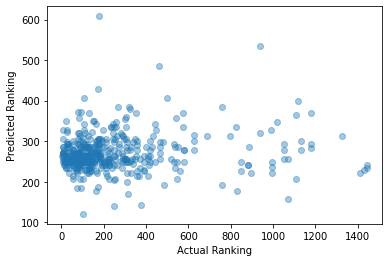

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsFaced: 0.7635871653628923
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsFaced: 0.8291857374973706 



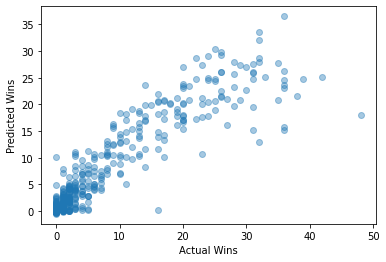

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsFaced: 0.8944880044833313
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsFaced: 0.881231010984993 



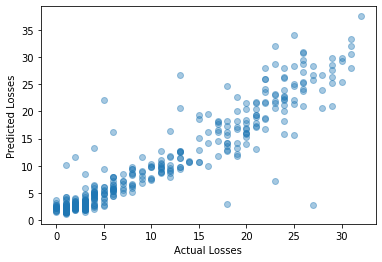

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsFaced: 0.761292564313685
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsFaced: 0.786709563599027 



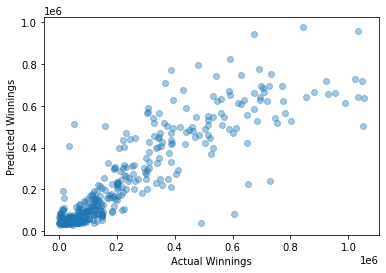

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsFaced: 0.1101395368711614
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsFaced: 0.11364133799963516 



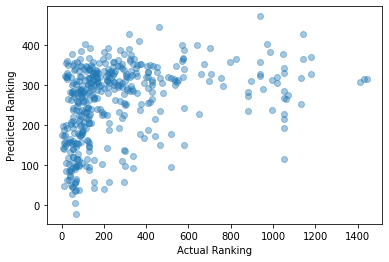

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsOpportunities: 0.8390351436288134
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsOpportunities: 0.8973831214797571 



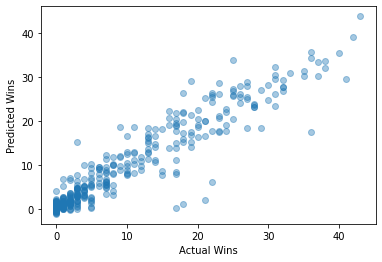

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsOpportunities: 0.8206427174668092
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsOpportunities: 0.8534285247189983 



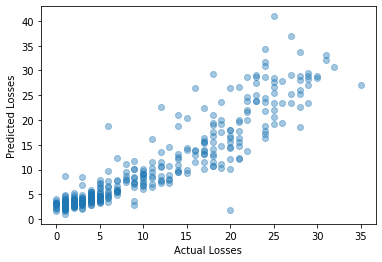

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsOpportunities: 0.8067942022092544
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsOpportunities: 0.8258835227996213 



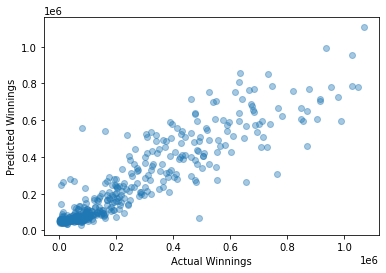

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsOpportunities: 0.11484742960885963
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsOpportunities: 0.12709412996405678 



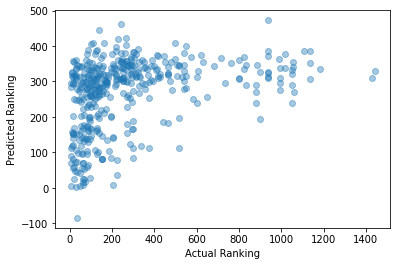

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsSaved: 0.10212893024889369
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsSaved: 0.06771559026471408 



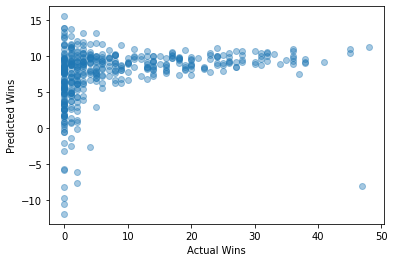

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsSaved: 0.08527143925781
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsSaved: 0.09602801632824287 



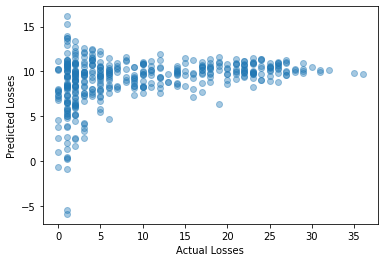

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsSaved: 0.1046428211955367
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsSaved: 0.07672281811256998 



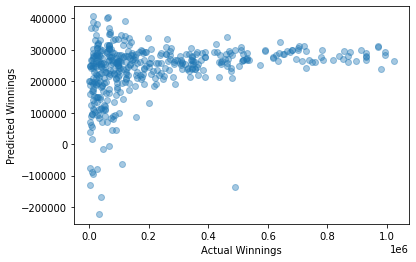

Train score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsSaved: 0.03317558712601909
Test score for predicting Winnings from SecondServeReturnPointsWon and BreakPointsSaved: 0.04738229124451754 



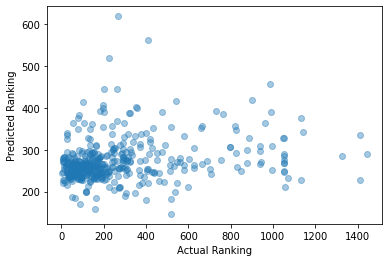

Train score for predicting Winnings from SecondServeReturnPointsWon and DoubleFaults: 0.7222525810848939
Test score for predicting Winnings from SecondServeReturnPointsWon and DoubleFaults: 0.7075238859997259 



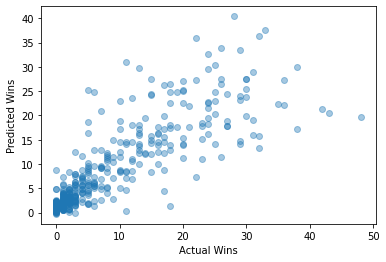

Train score for predicting Winnings from SecondServeReturnPointsWon and DoubleFaults: 0.7683945878343023
Test score for predicting Winnings from SecondServeReturnPointsWon and DoubleFaults: 0.8027014920804373 



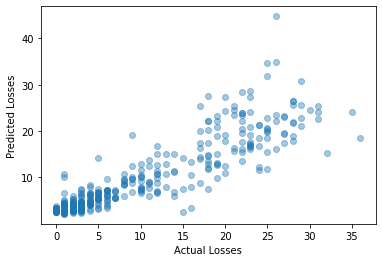

Train score for predicting Winnings from SecondServeReturnPointsWon and DoubleFaults: 0.730081021513284
Test score for predicting Winnings from SecondServeReturnPointsWon and DoubleFaults: 0.7361292967048763 



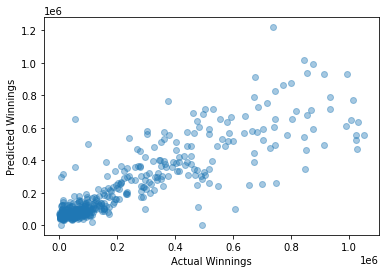

Train score for predicting Winnings from SecondServeReturnPointsWon and DoubleFaults: 0.10706390944000786
Test score for predicting Winnings from SecondServeReturnPointsWon and DoubleFaults: 0.09080208758705077 



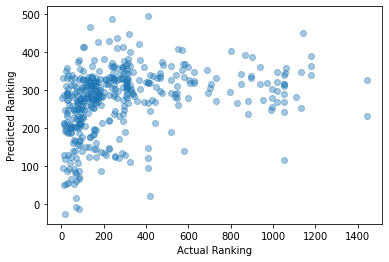

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesPlayed: 0.8642043940381736
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesPlayed: 0.8549948343895306 



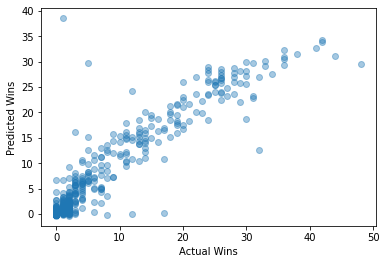

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesPlayed: 0.8750095678207713
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesPlayed: 0.8857221301655509 



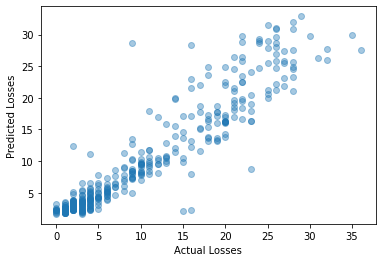

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesPlayed: 0.8286593059803709
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesPlayed: 0.8451620734975298 



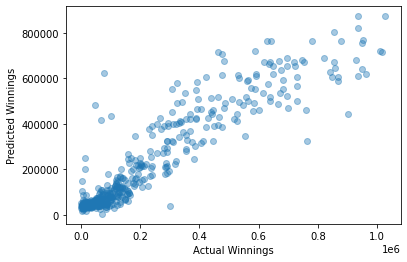

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesPlayed: 0.1151654922885138
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesPlayed: 0.11752995164844648 



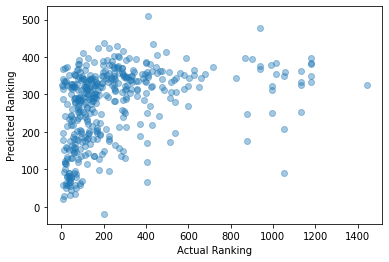

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesWon: 0.07970714230064446
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesWon: 0.1030742285625561 



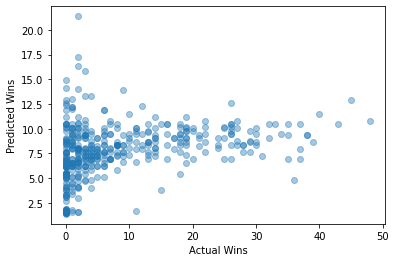

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesWon: 0.07531261080875606
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesWon: 0.05305792554838373 



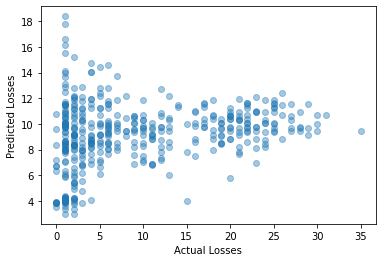

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesWon: 0.076965849020875
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesWon: 0.07661307369287584 



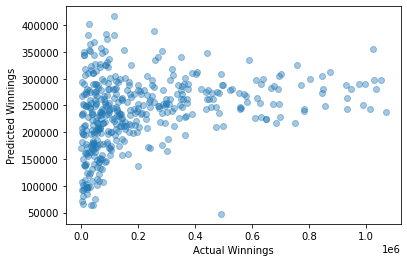

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesWon: 0.03853425267402011
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnGamesWon: 0.03968199514608062 



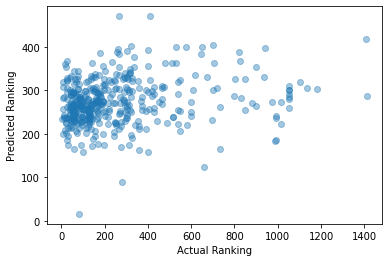

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnPointsWon: 0.07293232445080089
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnPointsWon: 0.09931082002795577 



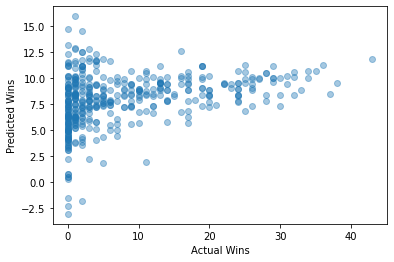

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnPointsWon: 0.0749396473206334
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnPointsWon: 0.05607281493692473 



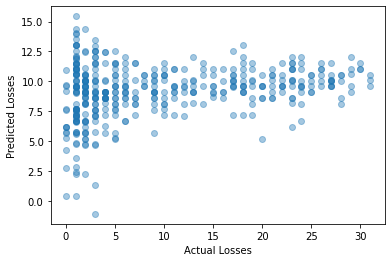

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnPointsWon: 0.07093562490437033
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnPointsWon: 0.08201802527300539 



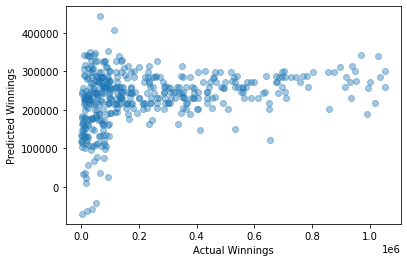

Train score for predicting Winnings from SecondServeReturnPointsWon and ReturnPointsWon: 0.04871394238325466
Test score for predicting Winnings from SecondServeReturnPointsWon and ReturnPointsWon: 0.016368013631778755 



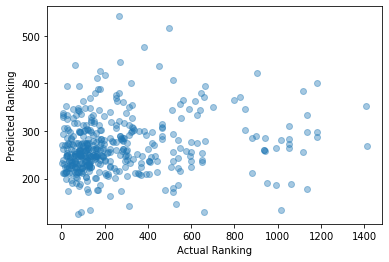

Train score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesPlayed: 0.8697148652676725
Test score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesPlayed: 0.8418085794973578 



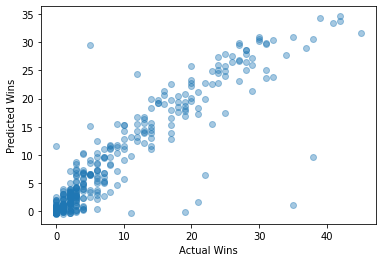

Train score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesPlayed: 0.883818521326064
Test score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesPlayed: 0.8447805121670836 



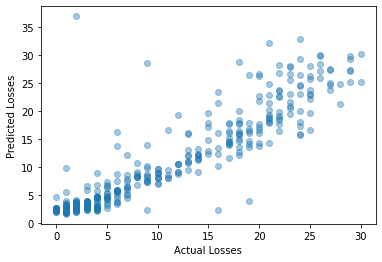

Train score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesPlayed: 0.8384634125965427
Test score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesPlayed: 0.8195003979677091 



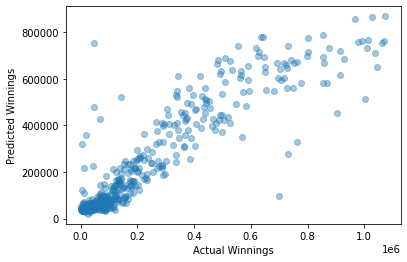

Train score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesPlayed: 0.11300965717919265
Test score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesPlayed: 0.13332715692968367 



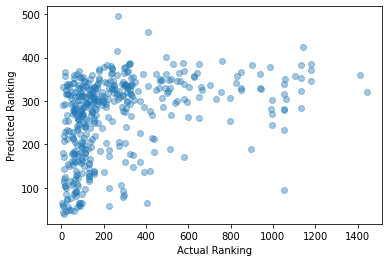

Train score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesWon: 0.16627129085203607
Test score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesWon: 0.18787704843929912 



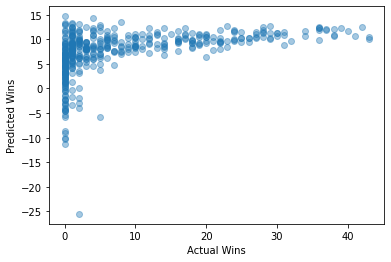

Train score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesWon: 0.1537070131866337
Test score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesWon: 0.15475795015087324 



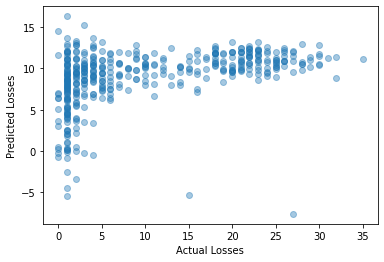

Train score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesWon: 0.17327891302356135
Test score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesWon: 0.21223231260249842 



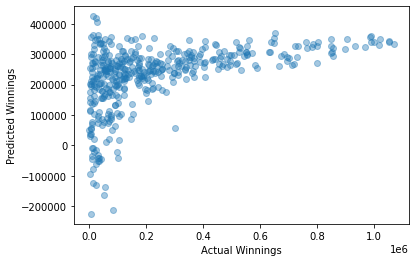

Train score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesWon: 0.05659723035729325
Test score for predicting Winnings from SecondServeReturnPointsWon and ServiceGamesWon: 0.06699432093471402 



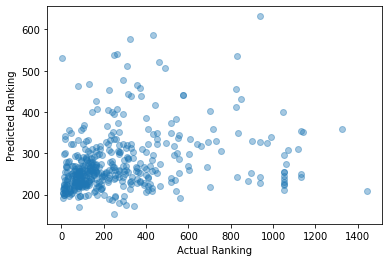

Train score for predicting Winnings from SecondServeReturnPointsWon and TotalPointsWon: 0.20101108424207825
Test score for predicting Winnings from SecondServeReturnPointsWon and TotalPointsWon: 0.236159852955785 



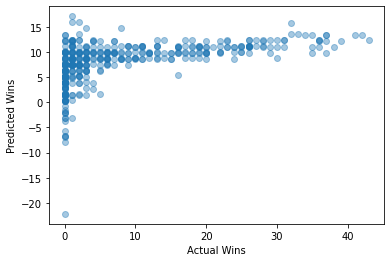

Train score for predicting Winnings from SecondServeReturnPointsWon and TotalPointsWon: 0.19025986165125844
Test score for predicting Winnings from SecondServeReturnPointsWon and TotalPointsWon: 0.16457146670376255 



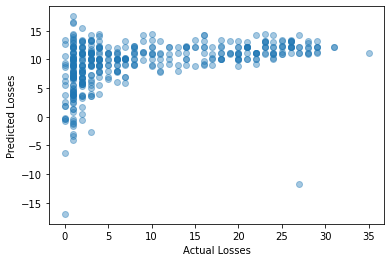

Train score for predicting Winnings from SecondServeReturnPointsWon and TotalPointsWon: 0.20630983347310716
Test score for predicting Winnings from SecondServeReturnPointsWon and TotalPointsWon: 0.23200721319739867 



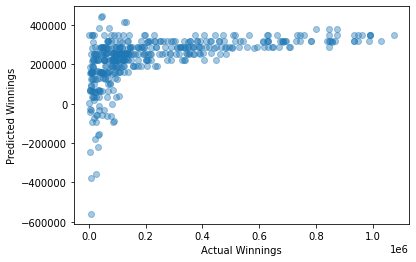

Train score for predicting Winnings from SecondServeReturnPointsWon and TotalPointsWon: 0.05865465513717927
Test score for predicting Winnings from SecondServeReturnPointsWon and TotalPointsWon: 0.11521911696453091 



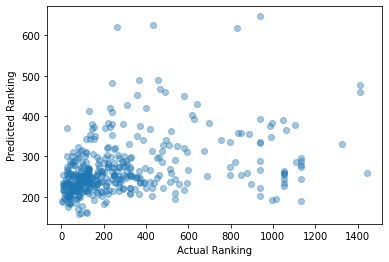

Train score for predicting Winnings from SecondServeReturnPointsWon and TotalServicePointsWon: 0.21303507881272843
Test score for predicting Winnings from SecondServeReturnPointsWon and TotalServicePointsWon: 0.09648362827405021 



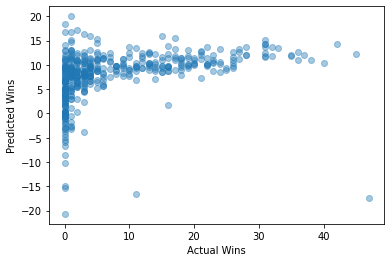

Train score for predicting Winnings from SecondServeReturnPointsWon and TotalServicePointsWon: 0.18092494945340756
Test score for predicting Winnings from SecondServeReturnPointsWon and TotalServicePointsWon: 0.11451062994860683 



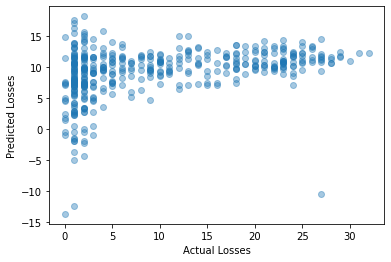

Train score for predicting Winnings from SecondServeReturnPointsWon and TotalServicePointsWon: 0.1999478738334155
Test score for predicting Winnings from SecondServeReturnPointsWon and TotalServicePointsWon: 0.1897382966590132 



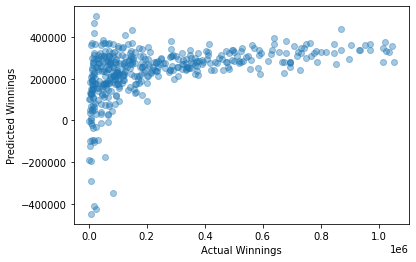

Train score for predicting Winnings from SecondServeReturnPointsWon and TotalServicePointsWon: 0.05681850430935609
Test score for predicting Winnings from SecondServeReturnPointsWon and TotalServicePointsWon: 0.08489993241531213 



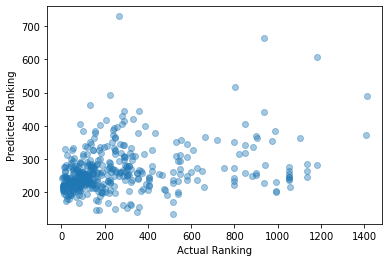

Train score for predicting Winnings from Aces and FirstServe: 0.6842224813525252
Test score for predicting Winnings from Aces and FirstServe: 0.6709178700290929 



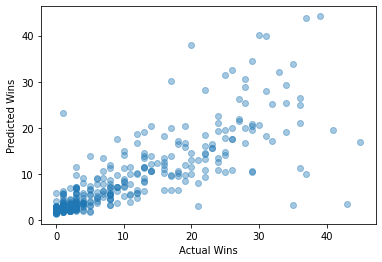

Train score for predicting Winnings from Aces and FirstServe: 0.6117850337180344
Test score for predicting Winnings from Aces and FirstServe: 0.5277825077375629 



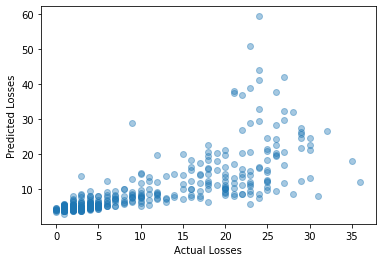

Train score for predicting Winnings from Aces and FirstServe: 0.6299209063793079
Test score for predicting Winnings from Aces and FirstServe: 0.6589335252639283 



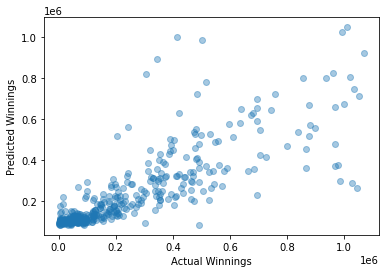

Train score for predicting Winnings from Aces and FirstServe: 0.07333136215176639
Test score for predicting Winnings from Aces and FirstServe: 0.09991314761363357 



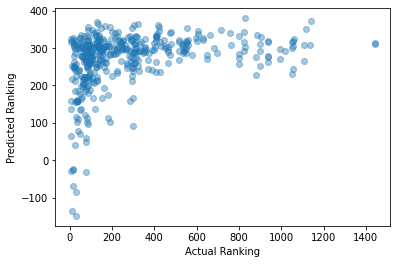

Train score for predicting Winnings from Aces and FirstServePointsWon: 0.683702859384826
Test score for predicting Winnings from Aces and FirstServePointsWon: 0.6749397915537322 



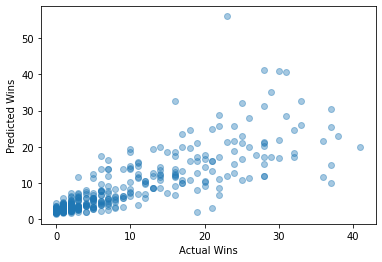

Train score for predicting Winnings from Aces and FirstServePointsWon: 0.596439221726188
Test score for predicting Winnings from Aces and FirstServePointsWon: 0.5763098534478516 



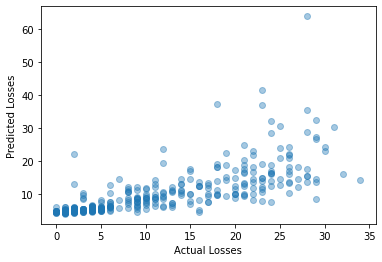

Train score for predicting Winnings from Aces and FirstServePointsWon: 0.6215020211336899
Test score for predicting Winnings from Aces and FirstServePointsWon: 0.6822322486226465 



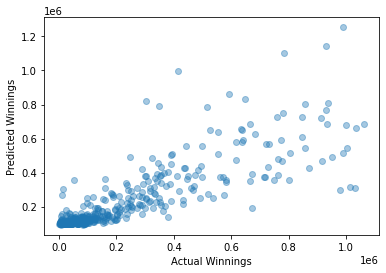

Train score for predicting Winnings from Aces and FirstServePointsWon: 0.06905404870527265
Test score for predicting Winnings from Aces and FirstServePointsWon: 0.10433274251494007 



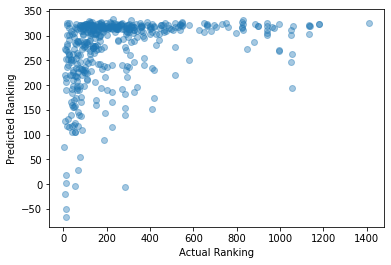

Train score for predicting Winnings from Aces and FirstServeReturnPointsWon: 0.7000654551260806
Test score for predicting Winnings from Aces and FirstServeReturnPointsWon: 0.7044007900746336 



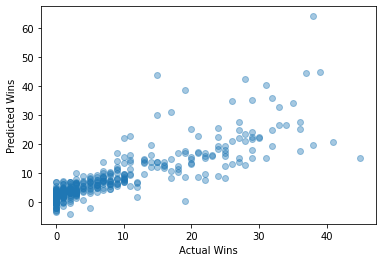

Train score for predicting Winnings from Aces and FirstServeReturnPointsWon: 0.6093419768007399
Test score for predicting Winnings from Aces and FirstServeReturnPointsWon: 0.6087574624969967 



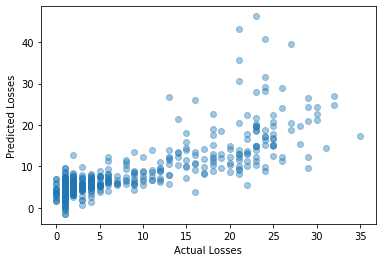

Train score for predicting Winnings from Aces and FirstServeReturnPointsWon: 0.653592838255237
Test score for predicting Winnings from Aces and FirstServeReturnPointsWon: 0.6536558935910947 



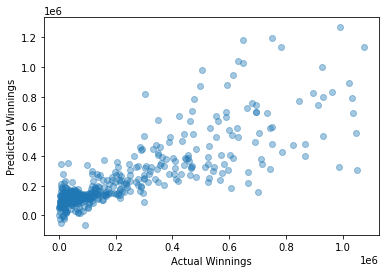

Train score for predicting Winnings from Aces and FirstServeReturnPointsWon: 0.09940021526632825
Test score for predicting Winnings from Aces and FirstServeReturnPointsWon: 0.08640021550324373 



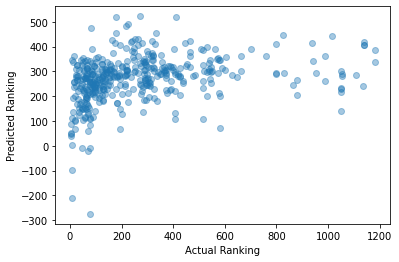

Train score for predicting Winnings from Aces and SecondServePointsWon: 0.7004038376034104
Test score for predicting Winnings from Aces and SecondServePointsWon: 0.6363741884937244 



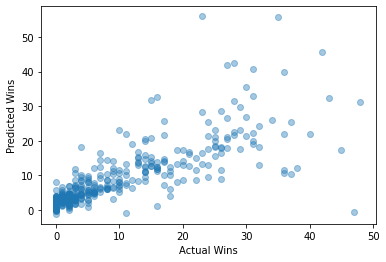

Train score for predicting Winnings from Aces and SecondServePointsWon: 0.5904885592185122
Test score for predicting Winnings from Aces and SecondServePointsWon: 0.6000801924347208 



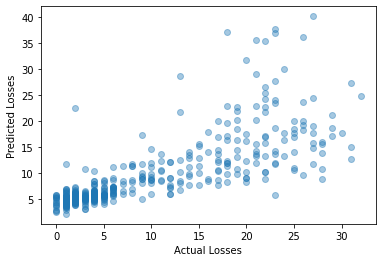

Train score for predicting Winnings from Aces and SecondServePointsWon: 0.6483621062469975
Test score for predicting Winnings from Aces and SecondServePointsWon: 0.6258206747579109 



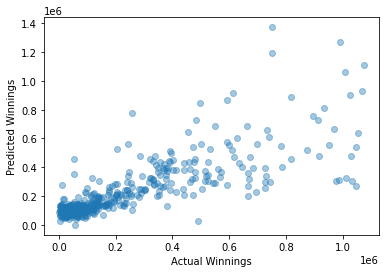

Train score for predicting Winnings from Aces and SecondServePointsWon: 0.08643812512623905
Test score for predicting Winnings from Aces and SecondServePointsWon: 0.09811949845530454 



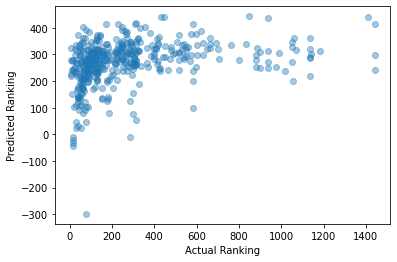

Train score for predicting Winnings from Aces and SecondServeReturnPointsWon: 0.6770386687908426
Test score for predicting Winnings from Aces and SecondServeReturnPointsWon: 0.7448453985194274 



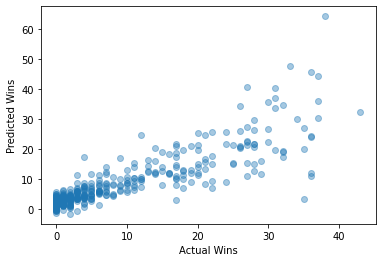

Train score for predicting Winnings from Aces and SecondServeReturnPointsWon: 0.6088054653216171
Test score for predicting Winnings from Aces and SecondServeReturnPointsWon: 0.5821899512229898 



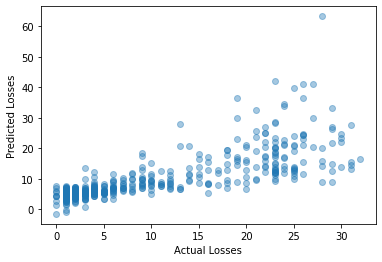

Train score for predicting Winnings from Aces and SecondServeReturnPointsWon: 0.6343542263173412
Test score for predicting Winnings from Aces and SecondServeReturnPointsWon: 0.697080744434734 



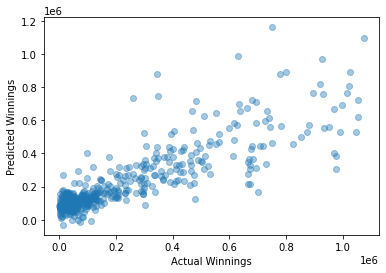

Train score for predicting Winnings from Aces and SecondServeReturnPointsWon: 0.08907365459539072
Test score for predicting Winnings from Aces and SecondServeReturnPointsWon: 0.10768548681201351 



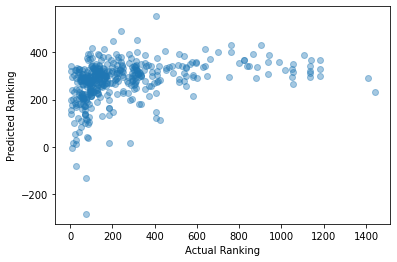

Train score for predicting Winnings from Aces and BreakPointsConverted: 0.6824711587088099
Test score for predicting Winnings from Aces and BreakPointsConverted: 0.685484479330003 



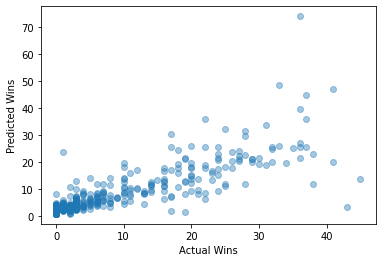

Train score for predicting Winnings from Aces and BreakPointsConverted: 0.5914221995315627
Test score for predicting Winnings from Aces and BreakPointsConverted: 0.5919418661859117 



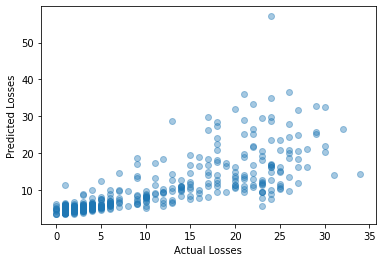

Train score for predicting Winnings from Aces and BreakPointsConverted: 0.6464730663413563
Test score for predicting Winnings from Aces and BreakPointsConverted: 0.6175484286217352 



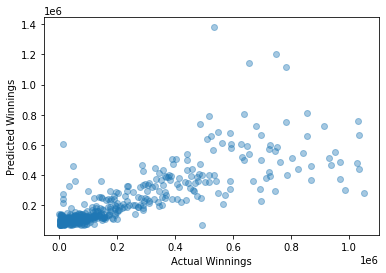

Train score for predicting Winnings from Aces and BreakPointsConverted: 0.07635522899251379
Test score for predicting Winnings from Aces and BreakPointsConverted: 0.08429176037381603 



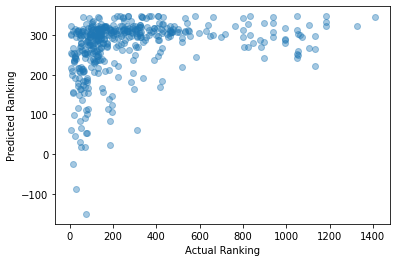

Train score for predicting Winnings from Aces and BreakPointsFaced: 0.8506882706569902
Test score for predicting Winnings from Aces and BreakPointsFaced: 0.7957727468164018 



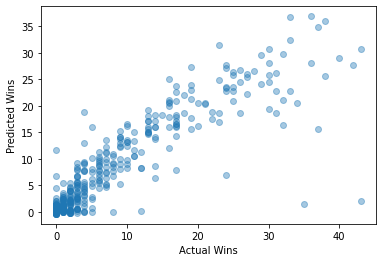

Train score for predicting Winnings from Aces and BreakPointsFaced: 0.8883669698919887
Test score for predicting Winnings from Aces and BreakPointsFaced: 0.9200751178409657 



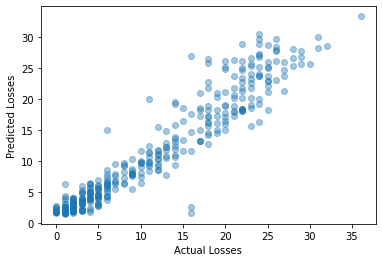

Train score for predicting Winnings from Aces and BreakPointsFaced: 0.8073728230368672
Test score for predicting Winnings from Aces and BreakPointsFaced: 0.8174990884039466 



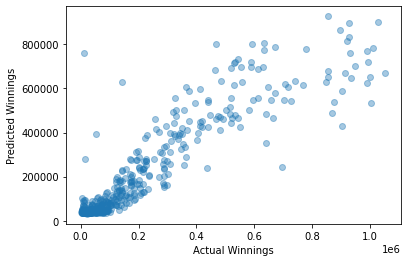

Train score for predicting Winnings from Aces and BreakPointsFaced: 0.10497644738289003
Test score for predicting Winnings from Aces and BreakPointsFaced: 0.1062714096947821 



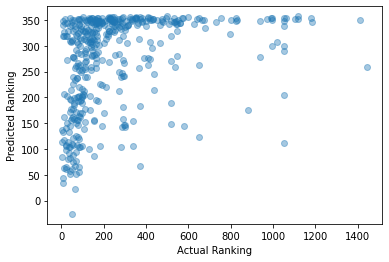

Train score for predicting Winnings from Aces and BreakPointsOpportunities: 0.8781819847299458
Test score for predicting Winnings from Aces and BreakPointsOpportunities: 0.8814781143025933 



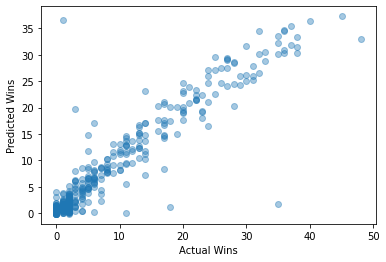

Train score for predicting Winnings from Aces and BreakPointsOpportunities: 0.8341346680510874
Test score for predicting Winnings from Aces and BreakPointsOpportunities: 0.8340341792530409 



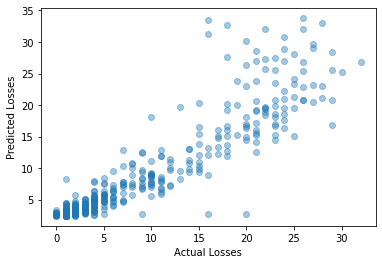

Train score for predicting Winnings from Aces and BreakPointsOpportunities: 0.837364063086835
Test score for predicting Winnings from Aces and BreakPointsOpportunities: 0.8160647125779875 



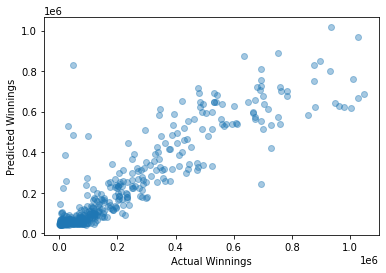

Train score for predicting Winnings from Aces and BreakPointsOpportunities: 0.10824872447149048
Test score for predicting Winnings from Aces and BreakPointsOpportunities: 0.12564171098265386 



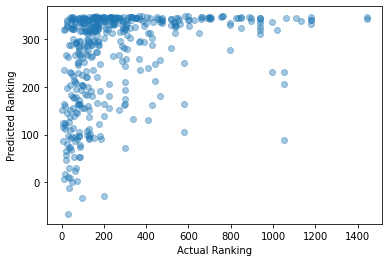

Train score for predicting Winnings from Aces and BreakPointsSaved: 0.675773195701008
Test score for predicting Winnings from Aces and BreakPointsSaved: 0.6953470229360799 



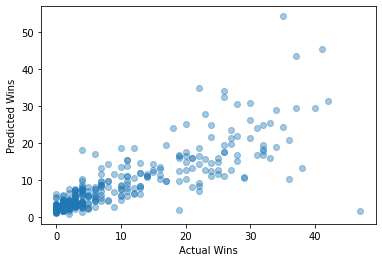

Train score for predicting Winnings from Aces and BreakPointsSaved: 0.5929325202911935
Test score for predicting Winnings from Aces and BreakPointsSaved: 0.5857828648078585 



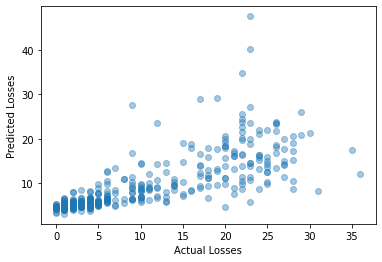

Train score for predicting Winnings from Aces and BreakPointsSaved: 0.6137364036518312
Test score for predicting Winnings from Aces and BreakPointsSaved: 0.7125743485020972 



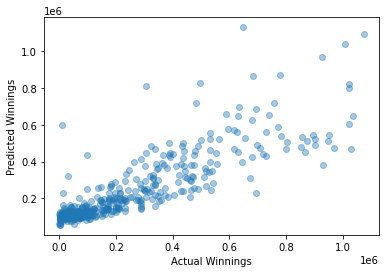

Train score for predicting Winnings from Aces and BreakPointsSaved: 0.07713026203422979
Test score for predicting Winnings from Aces and BreakPointsSaved: 0.0561333106287536 



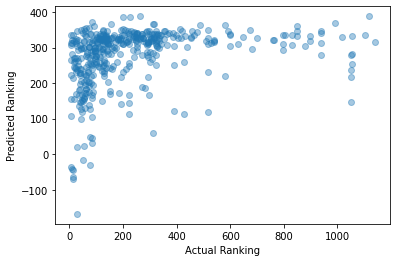

Train score for predicting Winnings from Aces and DoubleFaults: 0.7532251290390655
Test score for predicting Winnings from Aces and DoubleFaults: 0.8218573654181772 



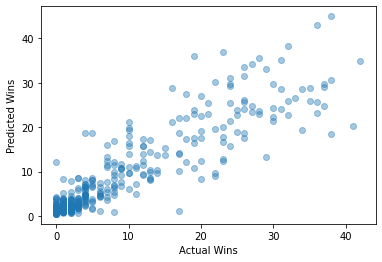

Train score for predicting Winnings from Aces and DoubleFaults: 0.7829136745547063
Test score for predicting Winnings from Aces and DoubleFaults: 0.7873985793762112 



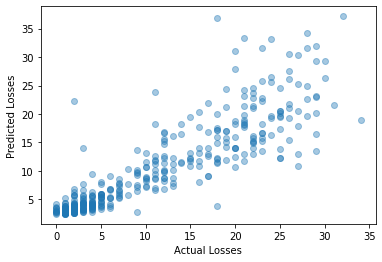

Train score for predicting Winnings from Aces and DoubleFaults: 0.7690706960293777
Test score for predicting Winnings from Aces and DoubleFaults: 0.7321897389923245 



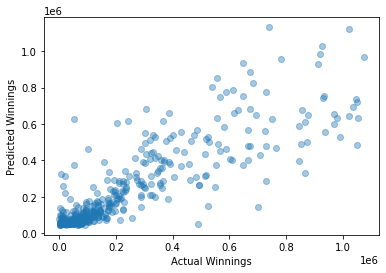

Train score for predicting Winnings from Aces and DoubleFaults: 0.08823719458000755
Test score for predicting Winnings from Aces and DoubleFaults: 0.11812604036360541 



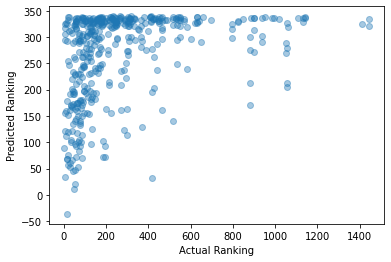

Train score for predicting Winnings from Aces and ReturnGamesPlayed: 0.8473172315831902
Test score for predicting Winnings from Aces and ReturnGamesPlayed: 0.9087011942195782 



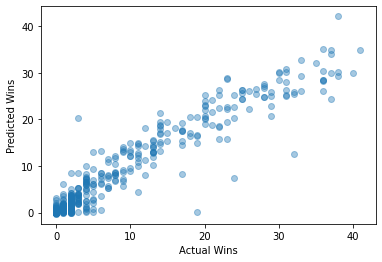

Train score for predicting Winnings from Aces and ReturnGamesPlayed: 0.8775677857095715
Test score for predicting Winnings from Aces and ReturnGamesPlayed: 0.899235170962986 



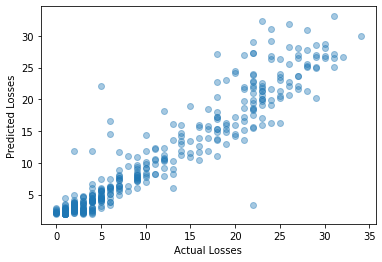

Train score for predicting Winnings from Aces and ReturnGamesPlayed: 0.8271115152049926
Test score for predicting Winnings from Aces and ReturnGamesPlayed: 0.8530221449329424 



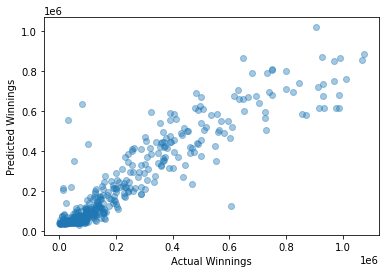

Train score for predicting Winnings from Aces and ReturnGamesPlayed: 0.12387646341237644
Test score for predicting Winnings from Aces and ReturnGamesPlayed: 0.07185219579483659 



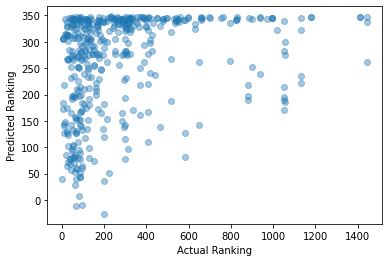

Train score for predicting Winnings from Aces and ReturnGamesWon: 0.7137006115869857
Test score for predicting Winnings from Aces and ReturnGamesWon: 0.7115304858713749 



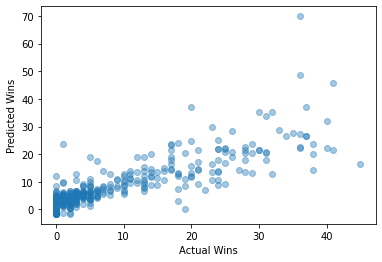

Train score for predicting Winnings from Aces and ReturnGamesWon: 0.6187554112670441
Test score for predicting Winnings from Aces and ReturnGamesWon: 0.6040949323009397 



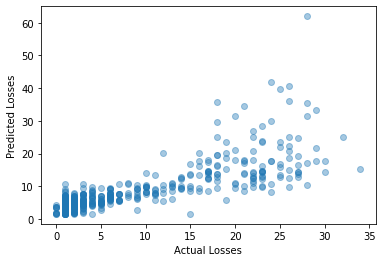

Train score for predicting Winnings from Aces and ReturnGamesWon: 0.662573023702905
Test score for predicting Winnings from Aces and ReturnGamesWon: 0.6750134999245989 



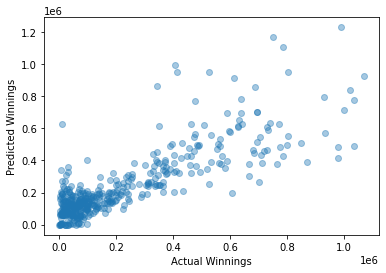

Train score for predicting Winnings from Aces and ReturnGamesWon: 0.11633818721568401
Test score for predicting Winnings from Aces and ReturnGamesWon: 0.05502433177626853 



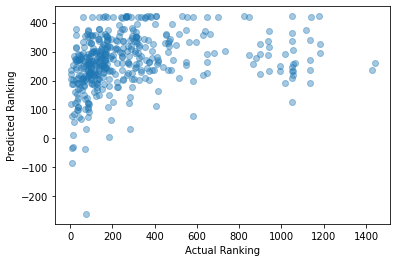

Train score for predicting Winnings from Aces and ReturnPointsWon: 0.7252136933898546
Test score for predicting Winnings from Aces and ReturnPointsWon: 0.6485687949934149 



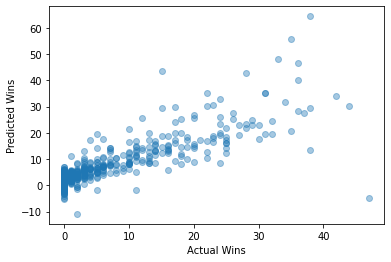

Train score for predicting Winnings from Aces and ReturnPointsWon: 0.5998602801848895
Test score for predicting Winnings from Aces and ReturnPointsWon: 0.6653282487868717 



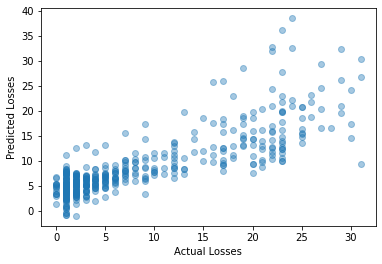

Train score for predicting Winnings from Aces and ReturnPointsWon: 0.6842893130881871
Test score for predicting Winnings from Aces and ReturnPointsWon: 0.5872823795139466 



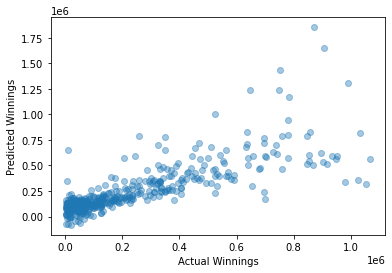

Train score for predicting Winnings from Aces and ReturnPointsWon: 0.10465485813545405
Test score for predicting Winnings from Aces and ReturnPointsWon: 0.10235895266210981 



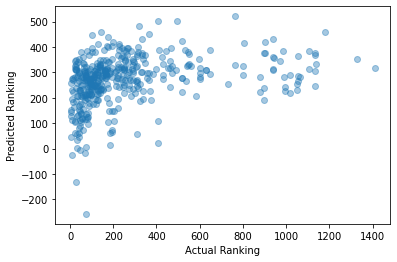

Train score for predicting Winnings from Aces and ServiceGamesPlayed: 0.8685821958069727
Test score for predicting Winnings from Aces and ServiceGamesPlayed: 0.854787281432738 



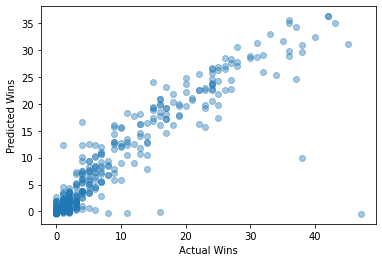

Train score for predicting Winnings from Aces and ServiceGamesPlayed: 0.8739994796452504
Test score for predicting Winnings from Aces and ServiceGamesPlayed: 0.9036193438272806 



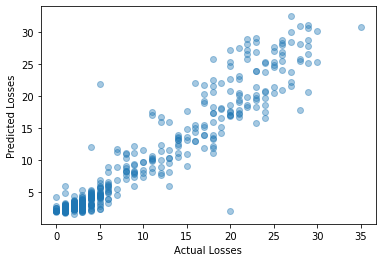

Train score for predicting Winnings from Aces and ServiceGamesPlayed: 0.8192552246933932
Test score for predicting Winnings from Aces and ServiceGamesPlayed: 0.870818245583947 



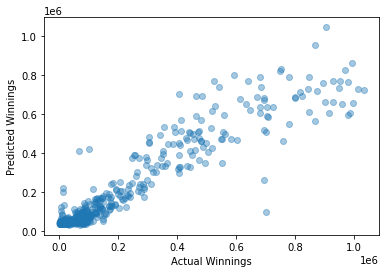

Train score for predicting Winnings from Aces and ServiceGamesPlayed: 0.11134471938442947
Test score for predicting Winnings from Aces and ServiceGamesPlayed: 0.10702710667879956 



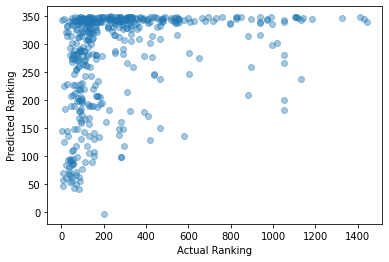

Train score for predicting Winnings from Aces and ServiceGamesWon: 0.6805149945195901
Test score for predicting Winnings from Aces and ServiceGamesWon: 0.6836708465000283 



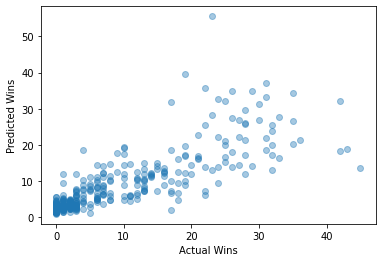

Train score for predicting Winnings from Aces and ServiceGamesWon: 0.5895723782487583
Test score for predicting Winnings from Aces and ServiceGamesWon: 0.5974120153593594 



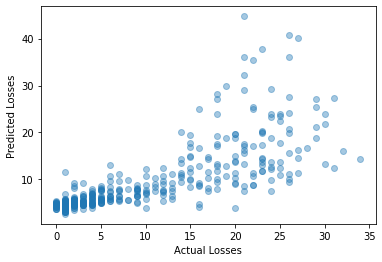

Train score for predicting Winnings from Aces and ServiceGamesWon: 0.6188063840636331
Test score for predicting Winnings from Aces and ServiceGamesWon: 0.7049376210764011 



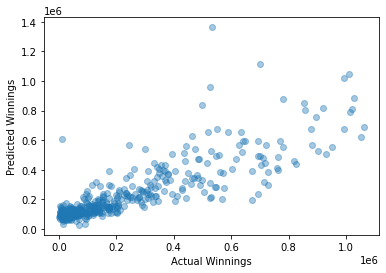

Train score for predicting Winnings from Aces and ServiceGamesWon: 0.09354171314570381
Test score for predicting Winnings from Aces and ServiceGamesWon: 0.050828054228019275 



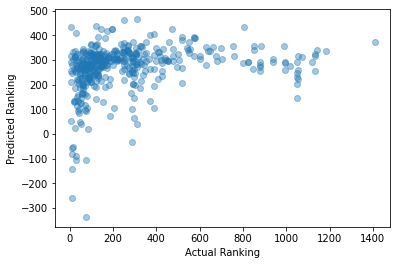

Train score for predicting Winnings from Aces and TotalPointsWon: 0.6862885023385139
Test score for predicting Winnings from Aces and TotalPointsWon: 0.7230479817583386 



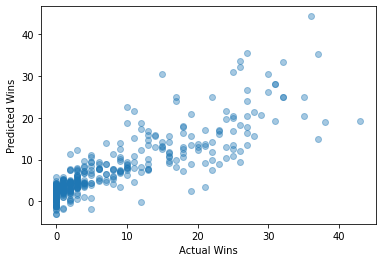

Train score for predicting Winnings from Aces and TotalPointsWon: 0.6130660467650993
Test score for predicting Winnings from Aces and TotalPointsWon: 0.5714842551493224 



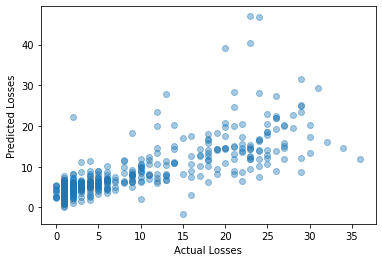

Train score for predicting Winnings from Aces and TotalPointsWon: 0.642677280041511
Test score for predicting Winnings from Aces and TotalPointsWon: 0.6867390101842428 



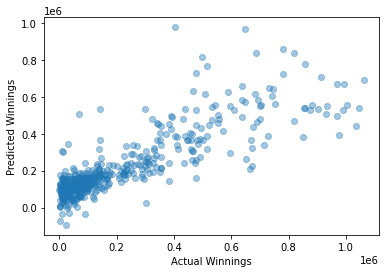

Train score for predicting Winnings from Aces and TotalPointsWon: 0.10505427443226512
Test score for predicting Winnings from Aces and TotalPointsWon: 0.10647643116710415 



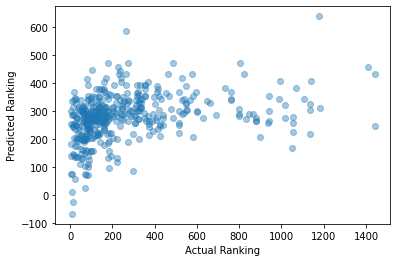

Train score for predicting Winnings from Aces and TotalServicePointsWon: 0.6676724938593528
Test score for predicting Winnings from Aces and TotalServicePointsWon: 0.7204108090694664 



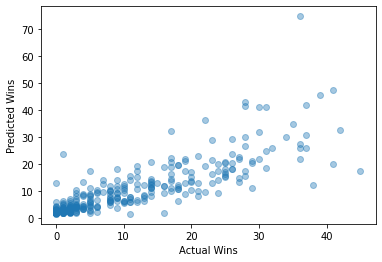

Train score for predicting Winnings from Aces and TotalServicePointsWon: 0.5807858250025926
Test score for predicting Winnings from Aces and TotalServicePointsWon: 0.621006962430207 



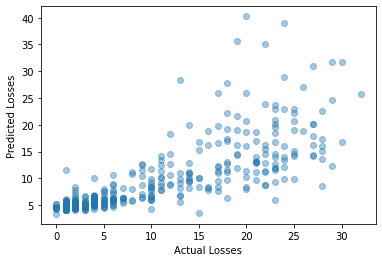

Train score for predicting Winnings from Aces and TotalServicePointsWon: 0.6451253460822206
Test score for predicting Winnings from Aces and TotalServicePointsWon: 0.6179668071902369 



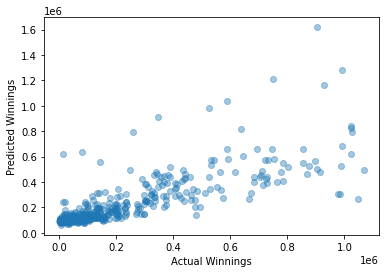

Train score for predicting Winnings from Aces and TotalServicePointsWon: 0.08016138969277542
Test score for predicting Winnings from Aces and TotalServicePointsWon: 0.09673406921728422 



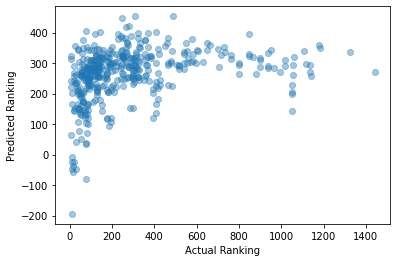

Train score for predicting Winnings from BreakPointsConverted and FirstServe: 0.013947172782085682
Test score for predicting Winnings from BreakPointsConverted and FirstServe: -0.0030186427384713 



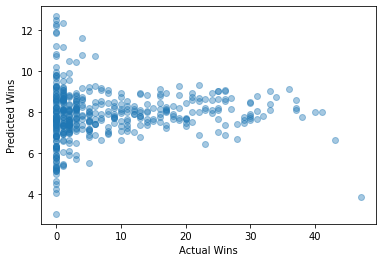

Train score for predicting Winnings from BreakPointsConverted and FirstServe: 0.0059695049551079515
Test score for predicting Winnings from BreakPointsConverted and FirstServe: 0.0048574962229051 



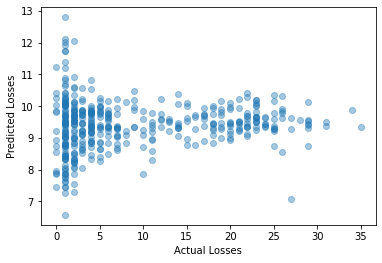

Train score for predicting Winnings from BreakPointsConverted and FirstServe: 0.012612502419008909
Test score for predicting Winnings from BreakPointsConverted and FirstServe: -0.0034814817226807016 



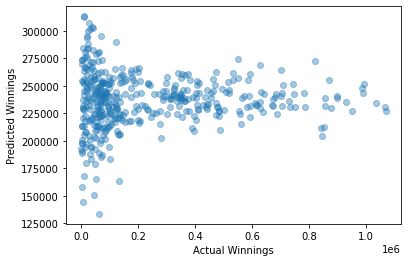

Train score for predicting Winnings from BreakPointsConverted and FirstServe: 0.01107887782694661
Test score for predicting Winnings from BreakPointsConverted and FirstServe: -0.007553154910138193 



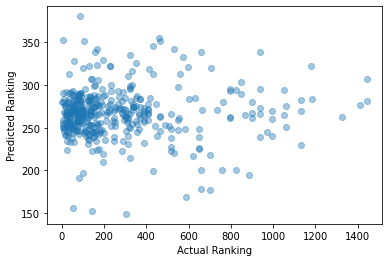

Train score for predicting Winnings from BreakPointsConverted and FirstServePointsWon: 0.13359442103112817
Test score for predicting Winnings from BreakPointsConverted and FirstServePointsWon: 0.14091663655368503 



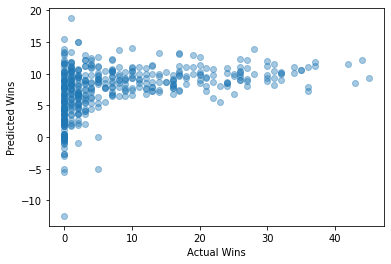

Train score for predicting Winnings from BreakPointsConverted and FirstServePointsWon: 0.11449017357848945
Test score for predicting Winnings from BreakPointsConverted and FirstServePointsWon: 0.11557111841562263 



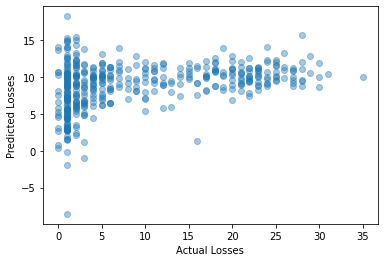

Train score for predicting Winnings from BreakPointsConverted and FirstServePointsWon: 0.13732194676869292
Test score for predicting Winnings from BreakPointsConverted and FirstServePointsWon: 0.13463569628307837 



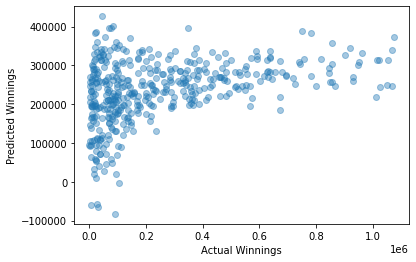

Train score for predicting Winnings from BreakPointsConverted and FirstServePointsWon: 0.02435149055291241
Test score for predicting Winnings from BreakPointsConverted and FirstServePointsWon: 0.028277794930332112 



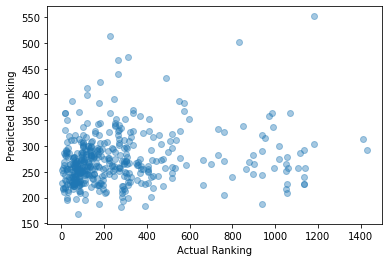

Train score for predicting Winnings from BreakPointsConverted and FirstServeReturnPointsWon: 0.0566102881091225
Test score for predicting Winnings from BreakPointsConverted and FirstServeReturnPointsWon: 0.08868534038672937 



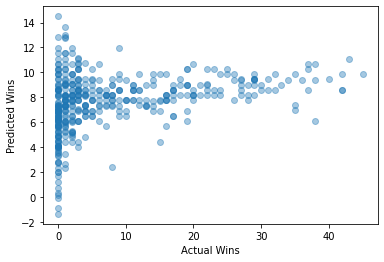

Train score for predicting Winnings from BreakPointsConverted and FirstServeReturnPointsWon: 0.05546488094900204
Test score for predicting Winnings from BreakPointsConverted and FirstServeReturnPointsWon: 0.0697411965335425 



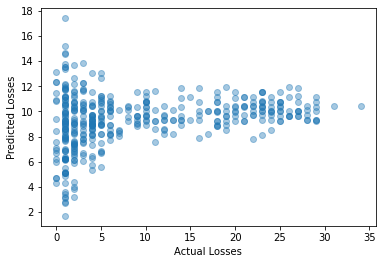

Train score for predicting Winnings from BreakPointsConverted and FirstServeReturnPointsWon: 0.06331023589341955
Test score for predicting Winnings from BreakPointsConverted and FirstServeReturnPointsWon: 0.04194665462292446 



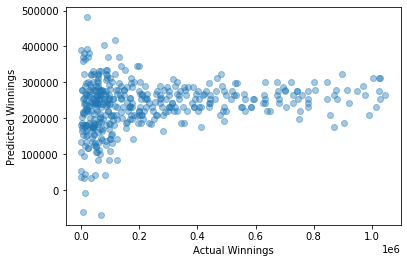

Train score for predicting Winnings from BreakPointsConverted and FirstServeReturnPointsWon: 0.035207751982981095
Test score for predicting Winnings from BreakPointsConverted and FirstServeReturnPointsWon: 0.0206439536631966 



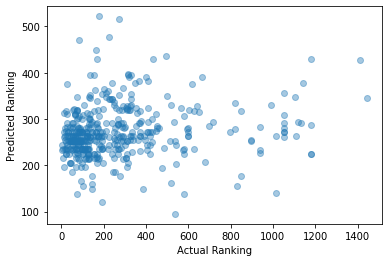

Train score for predicting Winnings from BreakPointsConverted and SecondServePointsWon: 0.0683764805161633
Test score for predicting Winnings from BreakPointsConverted and SecondServePointsWon: 0.0867617021735294 



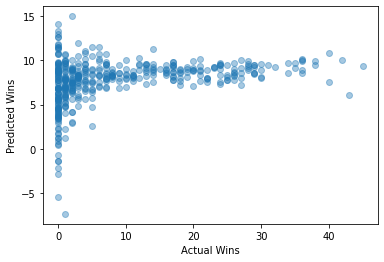

Train score for predicting Winnings from BreakPointsConverted and SecondServePointsWon: 0.07662347441492834
Test score for predicting Winnings from BreakPointsConverted and SecondServePointsWon: 0.029863468589994335 



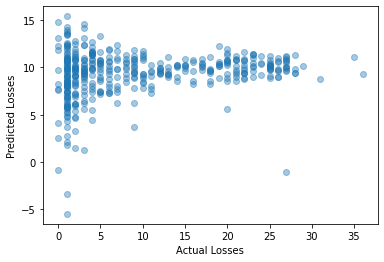

Train score for predicting Winnings from BreakPointsConverted and SecondServePointsWon: 0.09670682376262552
Test score for predicting Winnings from BreakPointsConverted and SecondServePointsWon: 0.03729407715629829 



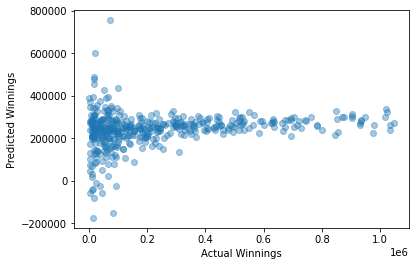

Train score for predicting Winnings from BreakPointsConverted and SecondServePointsWon: 0.035221206892901646
Test score for predicting Winnings from BreakPointsConverted and SecondServePointsWon: 0.03224145420325342 



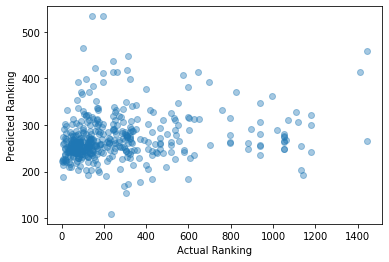

Train score for predicting Winnings from BreakPointsConverted and SecondServeReturnPointsWon: 0.03402029916507454
Test score for predicting Winnings from BreakPointsConverted and SecondServeReturnPointsWon: 0.04947343019752958 



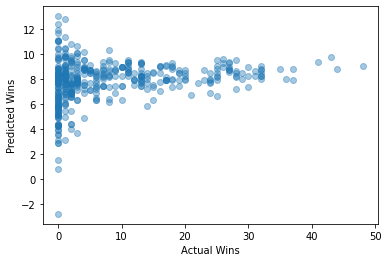

Train score for predicting Winnings from BreakPointsConverted and SecondServeReturnPointsWon: 0.03588709987664673
Test score for predicting Winnings from BreakPointsConverted and SecondServeReturnPointsWon: 0.02871617272082594 



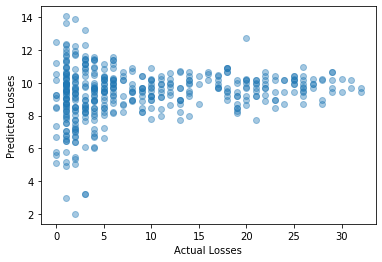

Train score for predicting Winnings from BreakPointsConverted and SecondServeReturnPointsWon: 0.0437398879048958
Test score for predicting Winnings from BreakPointsConverted and SecondServeReturnPointsWon: 0.022107431005400024 



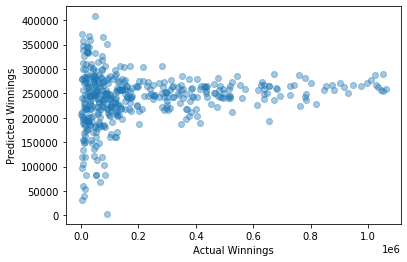

Train score for predicting Winnings from BreakPointsConverted and SecondServeReturnPointsWon: 0.03239839665654265
Test score for predicting Winnings from BreakPointsConverted and SecondServeReturnPointsWon: 0.003274792870884946 



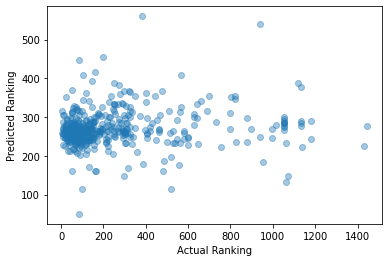

Train score for predicting Winnings from BreakPointsConverted and Aces: 0.6731068378502535
Test score for predicting Winnings from BreakPointsConverted and Aces: 0.7085038930607284 



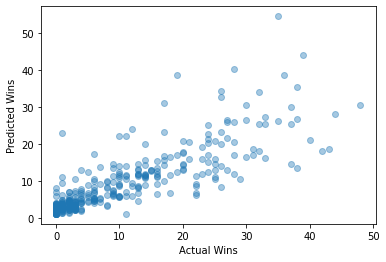

Train score for predicting Winnings from BreakPointsConverted and Aces: 0.6025843617041651
Test score for predicting Winnings from BreakPointsConverted and Aces: 0.5587813706240268 



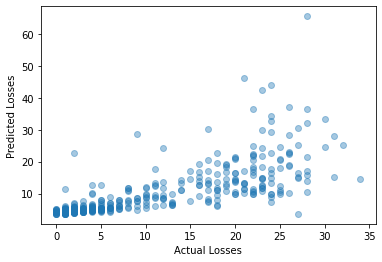

Train score for predicting Winnings from BreakPointsConverted and Aces: 0.6440613774794332
Test score for predicting Winnings from BreakPointsConverted and Aces: 0.6234089458466616 



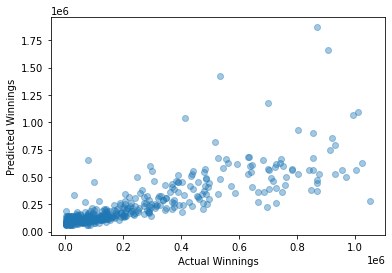

Train score for predicting Winnings from BreakPointsConverted and Aces: 0.08619754660819223
Test score for predicting Winnings from BreakPointsConverted and Aces: 0.05370695802434067 



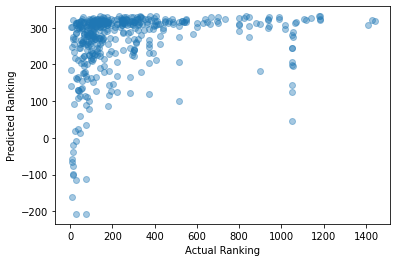

Train score for predicting Winnings from BreakPointsConverted and BreakPointsFaced: 0.7712009148905838
Test score for predicting Winnings from BreakPointsConverted and BreakPointsFaced: 0.8128028217943899 



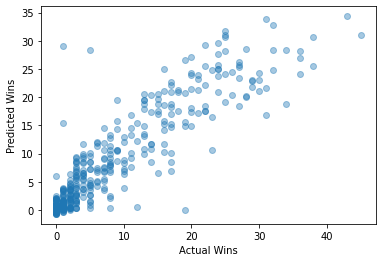

Train score for predicting Winnings from BreakPointsConverted and BreakPointsFaced: 0.8897023762171002
Test score for predicting Winnings from BreakPointsConverted and BreakPointsFaced: 0.8931077403073713 



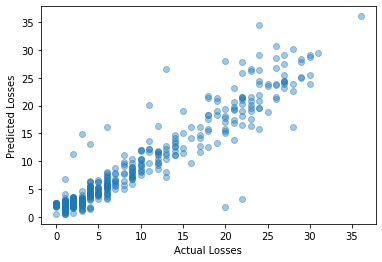

Train score for predicting Winnings from BreakPointsConverted and BreakPointsFaced: 0.7668313148689103
Test score for predicting Winnings from BreakPointsConverted and BreakPointsFaced: 0.7688353400289327 



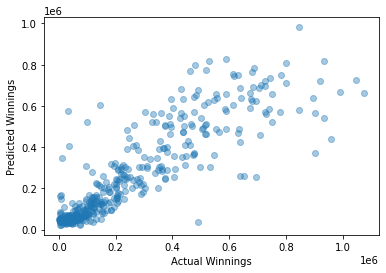

Train score for predicting Winnings from BreakPointsConverted and BreakPointsFaced: 0.10685954027608169
Test score for predicting Winnings from BreakPointsConverted and BreakPointsFaced: 0.09398894316709128 



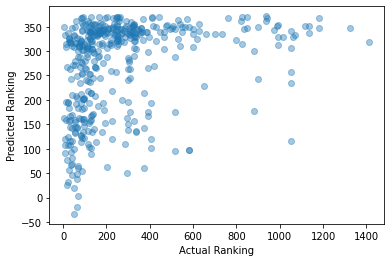

Train score for predicting Winnings from BreakPointsConverted and BreakPointsOpportunities: 0.8397973310483435
Test score for predicting Winnings from BreakPointsConverted and BreakPointsOpportunities: 0.8981035536164381 



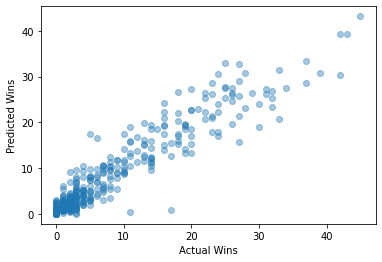

Train score for predicting Winnings from BreakPointsConverted and BreakPointsOpportunities: 0.8251435710031255
Test score for predicting Winnings from BreakPointsConverted and BreakPointsOpportunities: 0.8323463360183364 



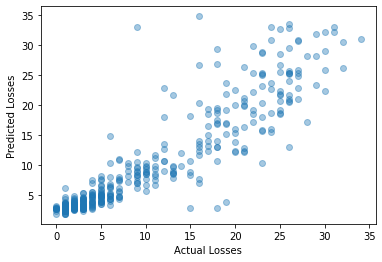

Train score for predicting Winnings from BreakPointsConverted and BreakPointsOpportunities: 0.8001345704398553
Test score for predicting Winnings from BreakPointsConverted and BreakPointsOpportunities: 0.8450203735229669 



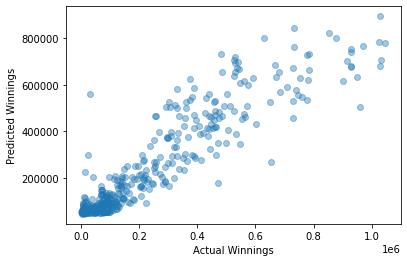

Train score for predicting Winnings from BreakPointsConverted and BreakPointsOpportunities: 0.10877164754323589
Test score for predicting Winnings from BreakPointsConverted and BreakPointsOpportunities: 0.11951371748111805 



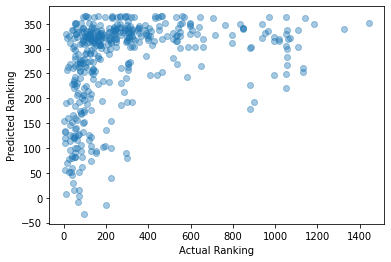

Train score for predicting Winnings from BreakPointsConverted and BreakPointsSaved: 0.07972609637109862
Test score for predicting Winnings from BreakPointsConverted and BreakPointsSaved: 0.039829116209751714 



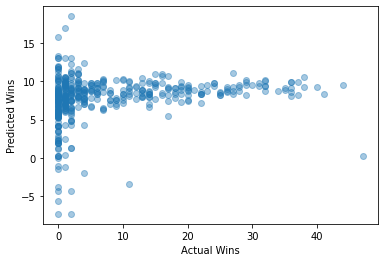

Train score for predicting Winnings from BreakPointsConverted and BreakPointsSaved: 0.0625281333535822
Test score for predicting Winnings from BreakPointsConverted and BreakPointsSaved: 0.07182467008115367 



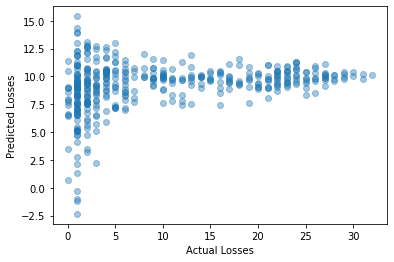

Train score for predicting Winnings from BreakPointsConverted and BreakPointsSaved: 0.06679165904532691
Test score for predicting Winnings from BreakPointsConverted and BreakPointsSaved: 0.09032806925948832 



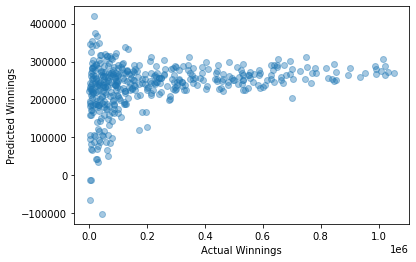

Train score for predicting Winnings from BreakPointsConverted and BreakPointsSaved: 0.017967535393776157
Test score for predicting Winnings from BreakPointsConverted and BreakPointsSaved: 0.014822053980967366 



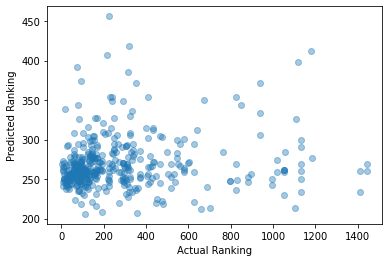

Train score for predicting Winnings from BreakPointsConverted and DoubleFaults: 0.7180090202836846
Test score for predicting Winnings from BreakPointsConverted and DoubleFaults: 0.7185530063630523 



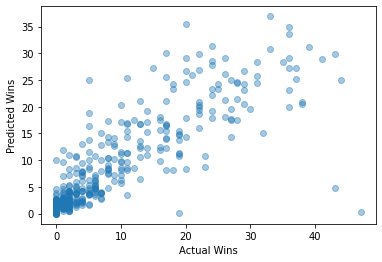

Train score for predicting Winnings from BreakPointsConverted and DoubleFaults: 0.7849619979713076
Test score for predicting Winnings from BreakPointsConverted and DoubleFaults: 0.7567123936761897 



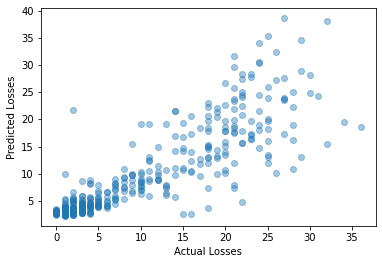

Train score for predicting Winnings from BreakPointsConverted and DoubleFaults: 0.7267680430356448
Test score for predicting Winnings from BreakPointsConverted and DoubleFaults: 0.7402239049802972 



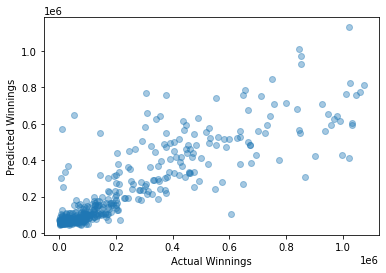

Train score for predicting Winnings from BreakPointsConverted and DoubleFaults: 0.10030763056562542
Test score for predicting Winnings from BreakPointsConverted and DoubleFaults: 0.07313754205669665 



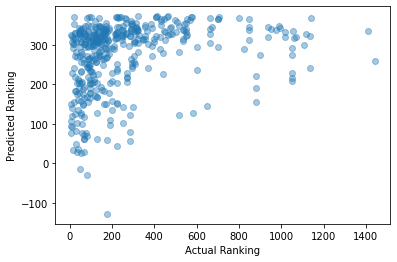

Train score for predicting Winnings from BreakPointsConverted and ReturnGamesPlayed: 0.8707742944954435
Test score for predicting Winnings from BreakPointsConverted and ReturnGamesPlayed: 0.837124796903181 



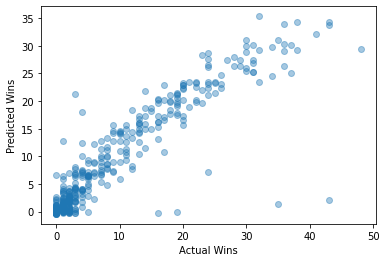

Train score for predicting Winnings from BreakPointsConverted and ReturnGamesPlayed: 0.8796053895912332
Test score for predicting Winnings from BreakPointsConverted and ReturnGamesPlayed: 0.87136611788008 



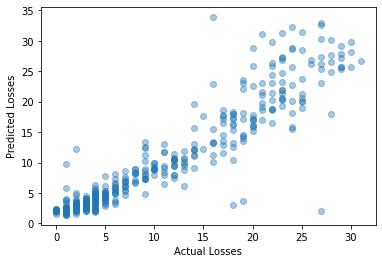

Train score for predicting Winnings from BreakPointsConverted and ReturnGamesPlayed: 0.8325789275673757
Test score for predicting Winnings from BreakPointsConverted and ReturnGamesPlayed: 0.8334052810866 



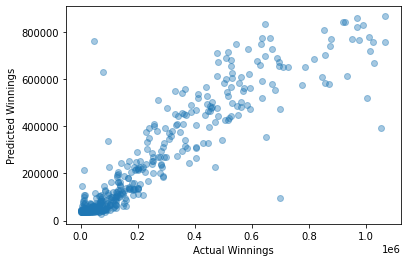

Train score for predicting Winnings from BreakPointsConverted and ReturnGamesPlayed: 0.11919119255874067
Test score for predicting Winnings from BreakPointsConverted and ReturnGamesPlayed: 0.082166183405321 



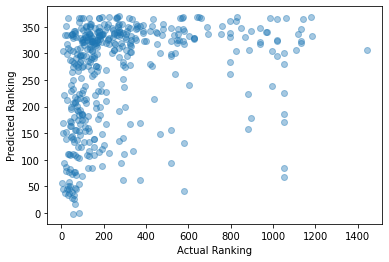

Train score for predicting Winnings from BreakPointsConverted and ReturnGamesWon: 0.0857146317145665
Test score for predicting Winnings from BreakPointsConverted and ReturnGamesWon: 0.1259335957635831 



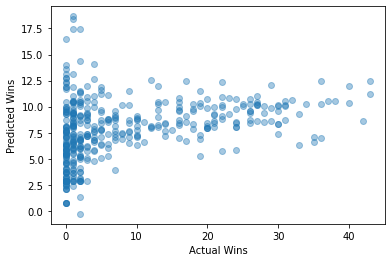

Train score for predicting Winnings from BreakPointsConverted and ReturnGamesWon: 0.08124070739642164
Test score for predicting Winnings from BreakPointsConverted and ReturnGamesWon: 0.07654184409645681 



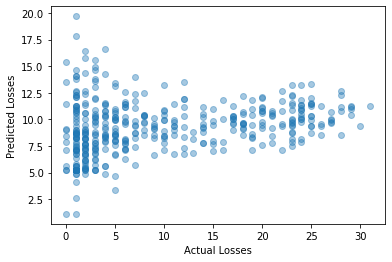

Train score for predicting Winnings from BreakPointsConverted and ReturnGamesWon: 0.08838948717141937
Test score for predicting Winnings from BreakPointsConverted and ReturnGamesWon: 0.0860950833505969 



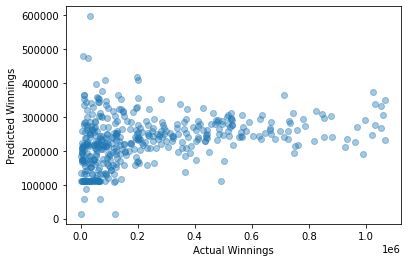

Train score for predicting Winnings from BreakPointsConverted and ReturnGamesWon: 0.042547445267030026
Test score for predicting Winnings from BreakPointsConverted and ReturnGamesWon: 0.031905609633827936 



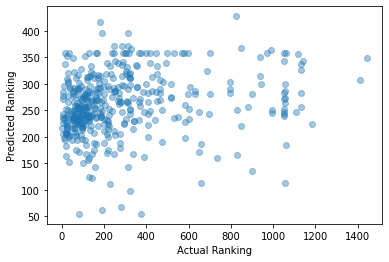

Train score for predicting Winnings from BreakPointsConverted and ReturnPointsWon: 0.08554900639308594
Test score for predicting Winnings from BreakPointsConverted and ReturnPointsWon: 0.06093798808717432 



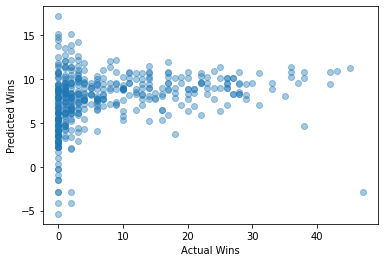

Train score for predicting Winnings from BreakPointsConverted and ReturnPointsWon: 0.06842162813362229
Test score for predicting Winnings from BreakPointsConverted and ReturnPointsWon: 0.08280718078806903 



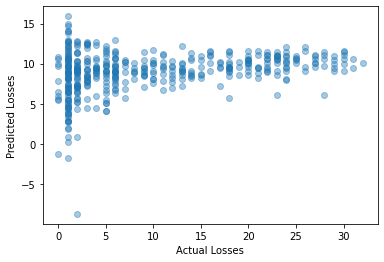

Train score for predicting Winnings from BreakPointsConverted and ReturnPointsWon: 0.07351083678614512
Test score for predicting Winnings from BreakPointsConverted and ReturnPointsWon: 0.06348865224295919 



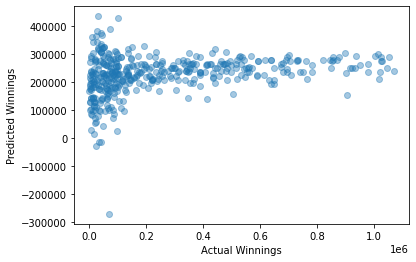

Train score for predicting Winnings from BreakPointsConverted and ReturnPointsWon: 0.03422003487672998
Test score for predicting Winnings from BreakPointsConverted and ReturnPointsWon: 0.05850331587869584 



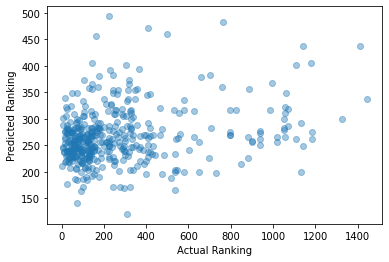

Train score for predicting Winnings from BreakPointsConverted and ServiceGamesPlayed: 0.8550337644915398
Test score for predicting Winnings from BreakPointsConverted and ServiceGamesPlayed: 0.8881477768087631 



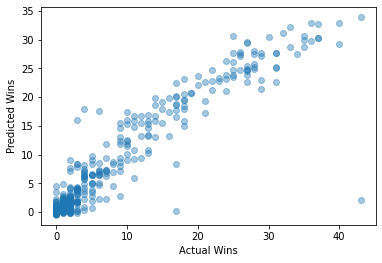

Train score for predicting Winnings from BreakPointsConverted and ServiceGamesPlayed: 0.8673757766873337
Test score for predicting Winnings from BreakPointsConverted and ServiceGamesPlayed: 0.8959752066076553 



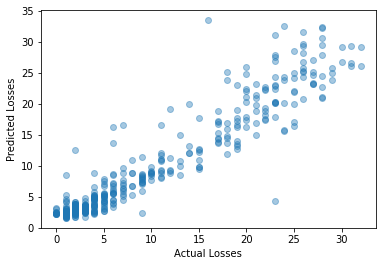

Train score for predicting Winnings from BreakPointsConverted and ServiceGamesPlayed: 0.8443832916108005
Test score for predicting Winnings from BreakPointsConverted and ServiceGamesPlayed: 0.7958930048416394 



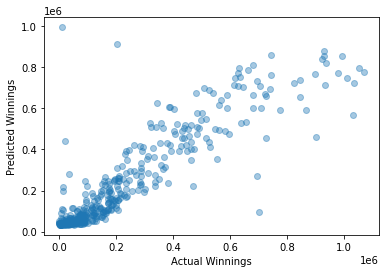

Train score for predicting Winnings from BreakPointsConverted and ServiceGamesPlayed: 0.10932632951184584
Test score for predicting Winnings from BreakPointsConverted and ServiceGamesPlayed: 0.11307470197974778 



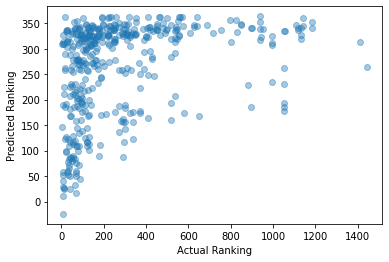

Train score for predicting Winnings from BreakPointsConverted and ServiceGamesWon: 0.15061247185057114
Test score for predicting Winnings from BreakPointsConverted and ServiceGamesWon: 0.1681601143272976 



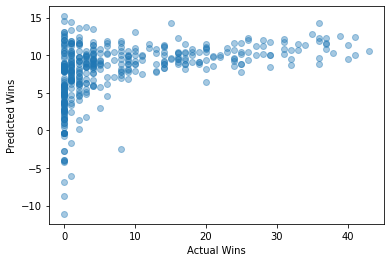

Train score for predicting Winnings from BreakPointsConverted and ServiceGamesWon: 0.13458138251896912
Test score for predicting Winnings from BreakPointsConverted and ServiceGamesWon: 0.15694183423570718 



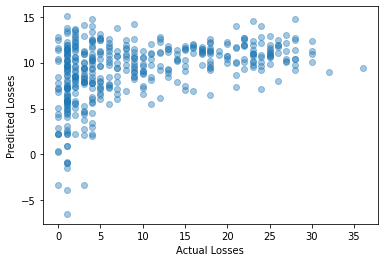

Train score for predicting Winnings from BreakPointsConverted and ServiceGamesWon: 0.1646772441414721
Test score for predicting Winnings from BreakPointsConverted and ServiceGamesWon: 0.15766872299664925 



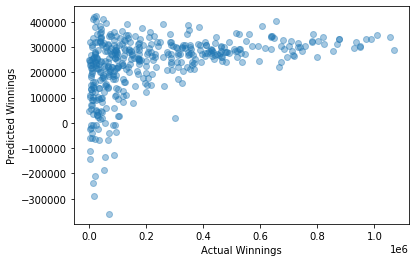

Train score for predicting Winnings from BreakPointsConverted and ServiceGamesWon: 0.04572909758802679
Test score for predicting Winnings from BreakPointsConverted and ServiceGamesWon: 0.03202466755304956 



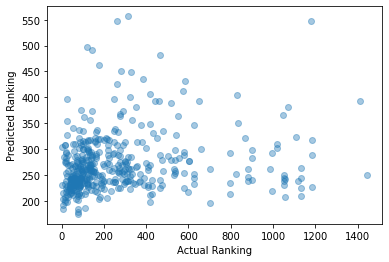

Train score for predicting Winnings from BreakPointsConverted and TotalPointsWon: 0.2118470203000976
Test score for predicting Winnings from BreakPointsConverted and TotalPointsWon: 0.21490999171248767 



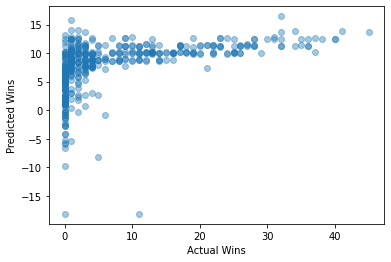

Train score for predicting Winnings from BreakPointsConverted and TotalPointsWon: 0.1775494368419278
Test score for predicting Winnings from BreakPointsConverted and TotalPointsWon: 0.21080841455519417 



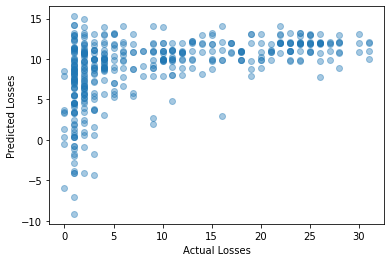

Train score for predicting Winnings from BreakPointsConverted and TotalPointsWon: 0.21931434302717154
Test score for predicting Winnings from BreakPointsConverted and TotalPointsWon: 0.1941097324498947 



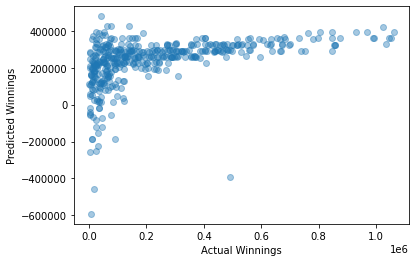

Train score for predicting Winnings from BreakPointsConverted and TotalPointsWon: 0.06705457189180442
Test score for predicting Winnings from BreakPointsConverted and TotalPointsWon: 0.09003634110121207 



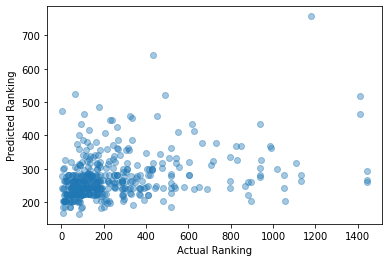

Train score for predicting Winnings from BreakPointsConverted and TotalServicePointsWon: 0.17135322146088017
Test score for predicting Winnings from BreakPointsConverted and TotalServicePointsWon: 0.1487446132522814 



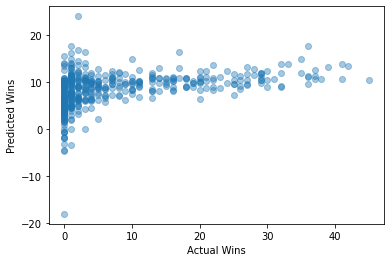

Train score for predicting Winnings from BreakPointsConverted and TotalServicePointsWon: 0.14040958793498615
Test score for predicting Winnings from BreakPointsConverted and TotalServicePointsWon: 0.14624963415981695 



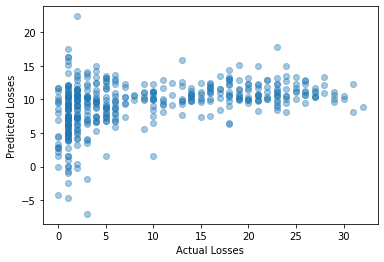

Train score for predicting Winnings from BreakPointsConverted and TotalServicePointsWon: 0.18129285248903426
Test score for predicting Winnings from BreakPointsConverted and TotalServicePointsWon: 0.13908040944907052 



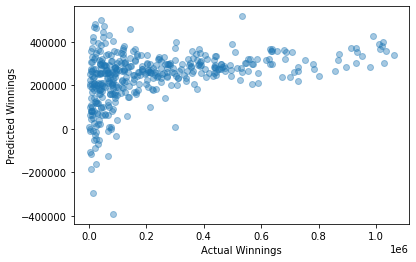

Train score for predicting Winnings from BreakPointsConverted and TotalServicePointsWon: 0.05089839988581446
Test score for predicting Winnings from BreakPointsConverted and TotalServicePointsWon: 0.02750790095079103 



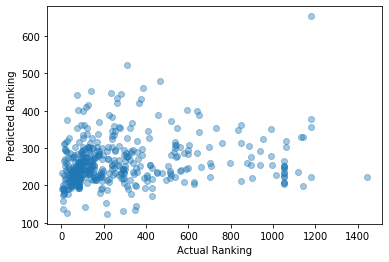

Train score for predicting Winnings from BreakPointsFaced and FirstServe: 0.7918473358998955
Test score for predicting Winnings from BreakPointsFaced and FirstServe: 0.7472525683536377 



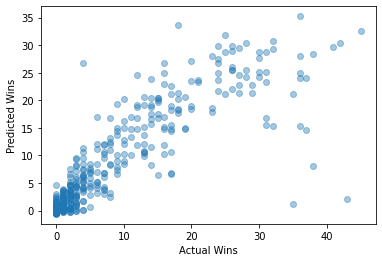

Train score for predicting Winnings from BreakPointsFaced and FirstServe: 0.898138202043712
Test score for predicting Winnings from BreakPointsFaced and FirstServe: 0.866246249981849 



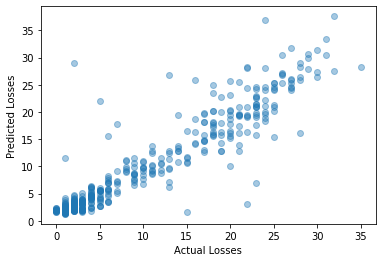

Train score for predicting Winnings from BreakPointsFaced and FirstServe: 0.7741534922801594
Test score for predicting Winnings from BreakPointsFaced and FirstServe: 0.7480973631059034 



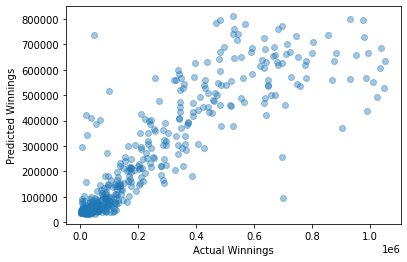

Train score for predicting Winnings from BreakPointsFaced and FirstServe: 0.10456510138377084
Test score for predicting Winnings from BreakPointsFaced and FirstServe: 0.10291440329251499 



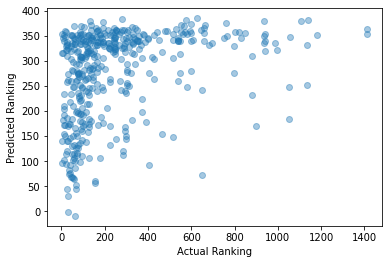

Train score for predicting Winnings from BreakPointsFaced and FirstServePointsWon: 0.7751047622856126
Test score for predicting Winnings from BreakPointsFaced and FirstServePointsWon: 0.8273850869481011 



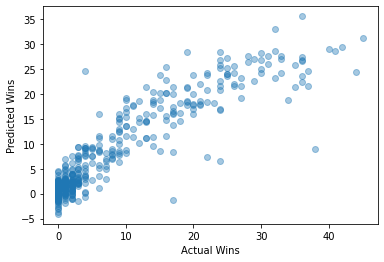

Train score for predicting Winnings from BreakPointsFaced and FirstServePointsWon: 0.8924265416361374
Test score for predicting Winnings from BreakPointsFaced and FirstServePointsWon: 0.8906569276544802 



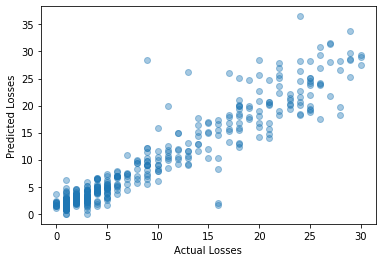

Train score for predicting Winnings from BreakPointsFaced and FirstServePointsWon: 0.7630854269233974
Test score for predicting Winnings from BreakPointsFaced and FirstServePointsWon: 0.825066311761452 



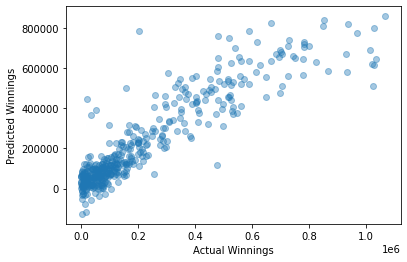

Train score for predicting Winnings from BreakPointsFaced and FirstServePointsWon: 0.10756471150795421
Test score for predicting Winnings from BreakPointsFaced and FirstServePointsWon: 0.0987797315553771 



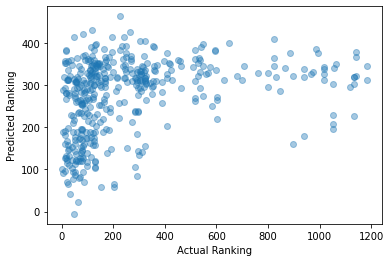

Train score for predicting Winnings from BreakPointsFaced and FirstServeReturnPointsWon: 0.7698435031586252
Test score for predicting Winnings from BreakPointsFaced and FirstServeReturnPointsWon: 0.8128306399922192 



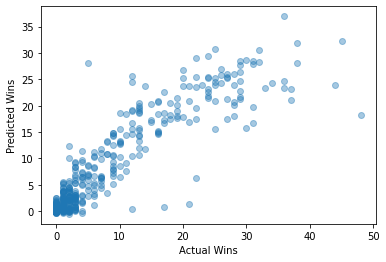

Train score for predicting Winnings from BreakPointsFaced and FirstServeReturnPointsWon: 0.895612256451241
Test score for predicting Winnings from BreakPointsFaced and FirstServeReturnPointsWon: 0.8774711770634611 



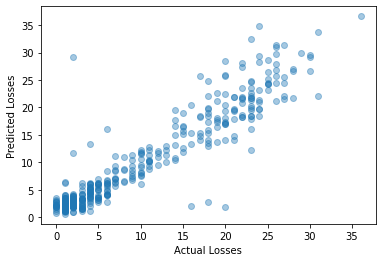

Train score for predicting Winnings from BreakPointsFaced and FirstServeReturnPointsWon: 0.7694758943371627
Test score for predicting Winnings from BreakPointsFaced and FirstServeReturnPointsWon: 0.7625258418005378 



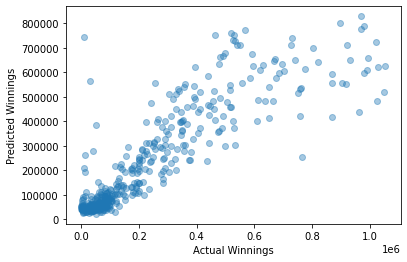

Train score for predicting Winnings from BreakPointsFaced and FirstServeReturnPointsWon: 0.10257179109489134
Test score for predicting Winnings from BreakPointsFaced and FirstServeReturnPointsWon: 0.13414022771365375 



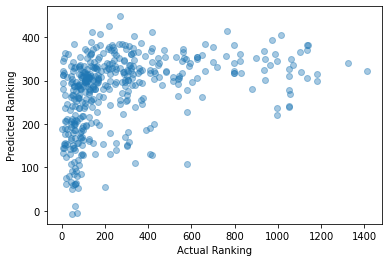

Train score for predicting Winnings from BreakPointsFaced and SecondServePointsWon: 0.7790807163016167
Test score for predicting Winnings from BreakPointsFaced and SecondServePointsWon: 0.7908171546908868 



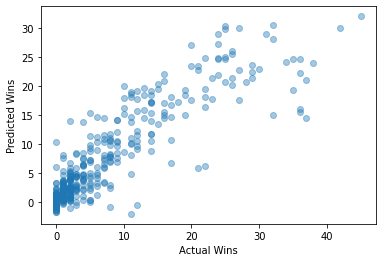

Train score for predicting Winnings from BreakPointsFaced and SecondServePointsWon: 0.8866529543406043
Test score for predicting Winnings from BreakPointsFaced and SecondServePointsWon: 0.8992751152048835 



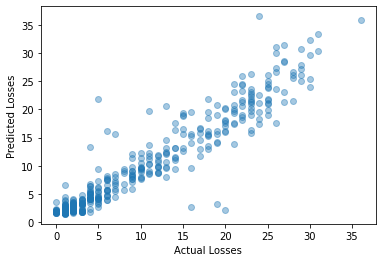

Train score for predicting Winnings from BreakPointsFaced and SecondServePointsWon: 0.7645664165356768
Test score for predicting Winnings from BreakPointsFaced and SecondServePointsWon: 0.7878324326845406 



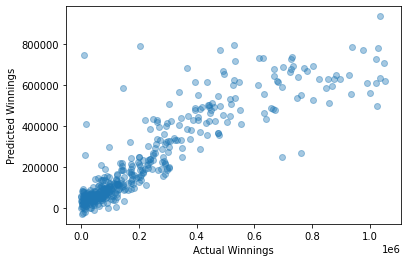

Train score for predicting Winnings from BreakPointsFaced and SecondServePointsWon: 0.11852273480282326
Test score for predicting Winnings from BreakPointsFaced and SecondServePointsWon: 0.0979955211804122 



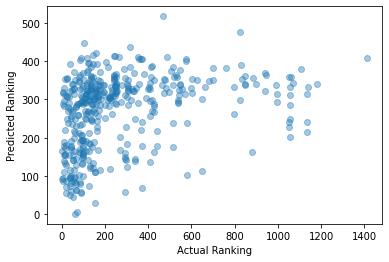

Train score for predicting Winnings from BreakPointsFaced and SecondServeReturnPointsWon: 0.7659924373088773
Test score for predicting Winnings from BreakPointsFaced and SecondServeReturnPointsWon: 0.822993374459845 



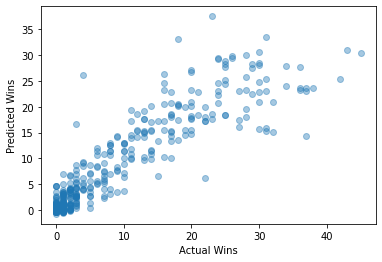

Train score for predicting Winnings from BreakPointsFaced and SecondServeReturnPointsWon: 0.8936320427984461
Test score for predicting Winnings from BreakPointsFaced and SecondServeReturnPointsWon: 0.8821263380796388 



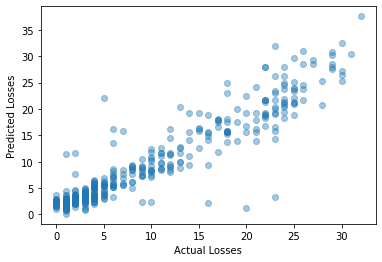

Train score for predicting Winnings from BreakPointsFaced and SecondServeReturnPointsWon: 0.7694724060594971
Test score for predicting Winnings from BreakPointsFaced and SecondServeReturnPointsWon: 0.7603615117661222 



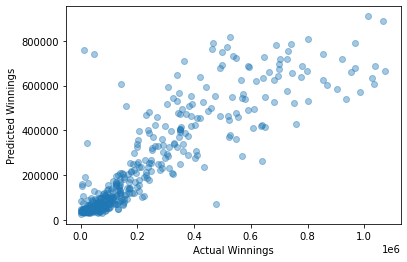

Train score for predicting Winnings from BreakPointsFaced and SecondServeReturnPointsWon: 0.1058998381107279
Test score for predicting Winnings from BreakPointsFaced and SecondServeReturnPointsWon: 0.11372386013847746 



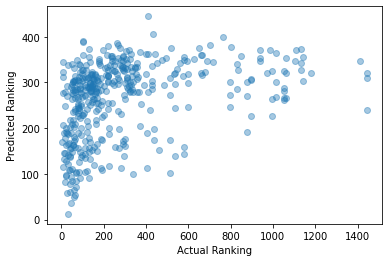

Train score for predicting Winnings from BreakPointsFaced and Aces: 0.8465555097420744
Test score for predicting Winnings from BreakPointsFaced and Aces: 0.8093088627344064 



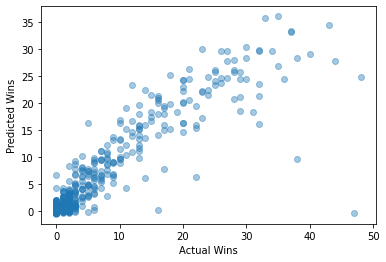

Train score for predicting Winnings from BreakPointsFaced and Aces: 0.8851994637672127
Test score for predicting Winnings from BreakPointsFaced and Aces: 0.9299875323540916 



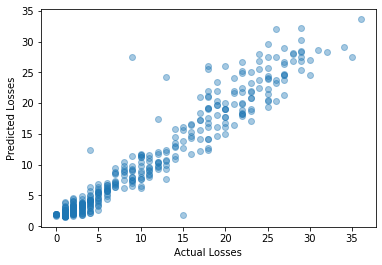

Train score for predicting Winnings from BreakPointsFaced and Aces: 0.8044355525342308
Test score for predicting Winnings from BreakPointsFaced and Aces: 0.82694342099661 



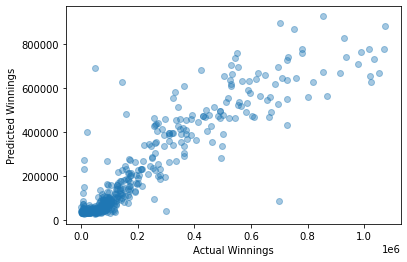

Train score for predicting Winnings from BreakPointsFaced and Aces: 0.11442690934682233
Test score for predicting Winnings from BreakPointsFaced and Aces: 0.07739399111427636 



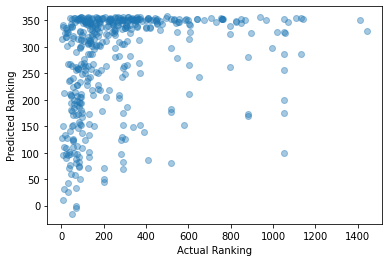

Train score for predicting Winnings from BreakPointsFaced and BreakPointsConverted: 0.7850145651359641
Test score for predicting Winnings from BreakPointsFaced and BreakPointsConverted: 0.7646381080242324 



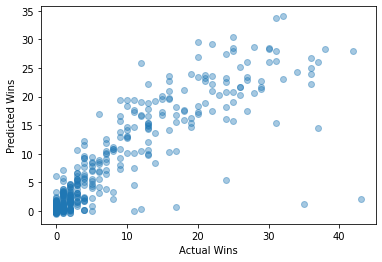

Train score for predicting Winnings from BreakPointsFaced and BreakPointsConverted: 0.8836326663028717
Test score for predicting Winnings from BreakPointsFaced and BreakPointsConverted: 0.9094075772743689 



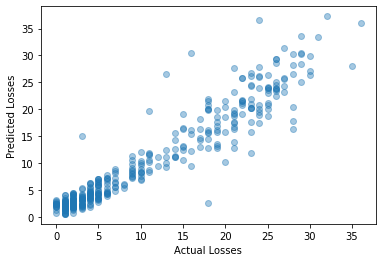

Train score for predicting Winnings from BreakPointsFaced and BreakPointsConverted: 0.7576636190858872
Test score for predicting Winnings from BreakPointsFaced and BreakPointsConverted: 0.795997169969441 



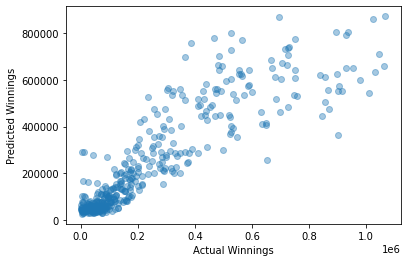

Train score for predicting Winnings from BreakPointsFaced and BreakPointsConverted: 0.10763003199713372
Test score for predicting Winnings from BreakPointsFaced and BreakPointsConverted: 0.09310338309918875 



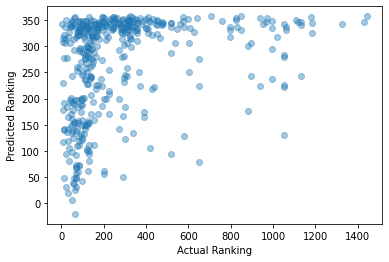

Train score for predicting Winnings from BreakPointsFaced and BreakPointsOpportunities: 0.8698883664925671
Test score for predicting Winnings from BreakPointsFaced and BreakPointsOpportunities: 0.8213972604718729 



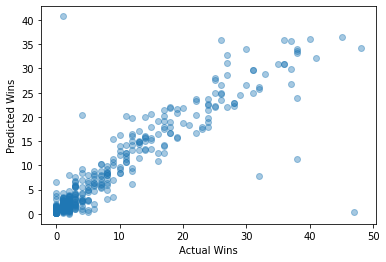

Train score for predicting Winnings from BreakPointsFaced and BreakPointsOpportunities: 0.8789925139127759
Test score for predicting Winnings from BreakPointsFaced and BreakPointsOpportunities: 0.9266844763231916 



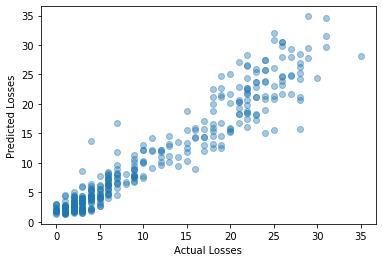

Train score for predicting Winnings from BreakPointsFaced and BreakPointsOpportunities: 0.8041608075426815
Test score for predicting Winnings from BreakPointsFaced and BreakPointsOpportunities: 0.8295140910131575 



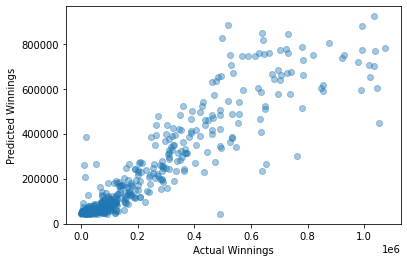

Train score for predicting Winnings from BreakPointsFaced and BreakPointsOpportunities: 0.11586915786667074
Test score for predicting Winnings from BreakPointsFaced and BreakPointsOpportunities: 0.10066386479783385 



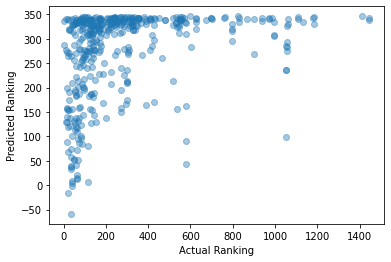

Train score for predicting Winnings from BreakPointsFaced and BreakPointsSaved: 0.7694932046940096
Test score for predicting Winnings from BreakPointsFaced and BreakPointsSaved: 0.8172175382373082 



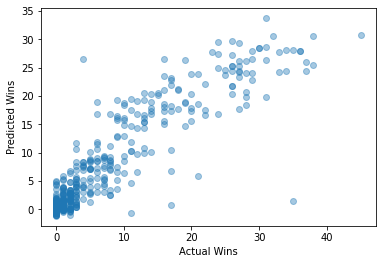

Train score for predicting Winnings from BreakPointsFaced and BreakPointsSaved: 0.8863085274670727
Test score for predicting Winnings from BreakPointsFaced and BreakPointsSaved: 0.8994846194214438 



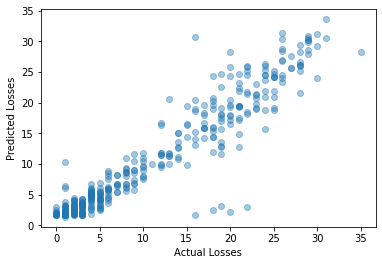

Train score for predicting Winnings from BreakPointsFaced and BreakPointsSaved: 0.7693324558113246
Test score for predicting Winnings from BreakPointsFaced and BreakPointsSaved: 0.7627352926248903 



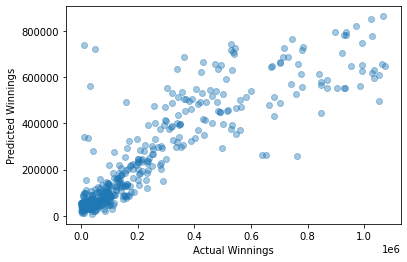

Train score for predicting Winnings from BreakPointsFaced and BreakPointsSaved: 0.10810148683468235
Test score for predicting Winnings from BreakPointsFaced and BreakPointsSaved: 0.09418372048943979 



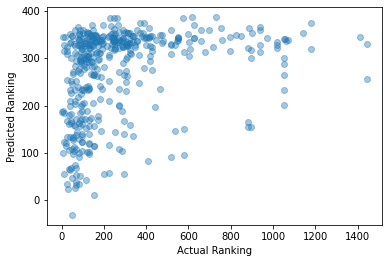

Train score for predicting Winnings from BreakPointsFaced and DoubleFaults: 0.8034579821667509
Test score for predicting Winnings from BreakPointsFaced and DoubleFaults: 0.7512819620722286 



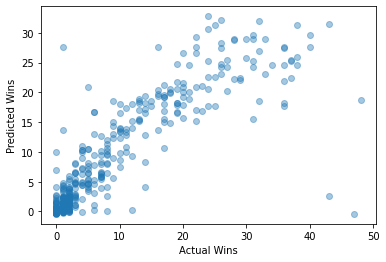

Train score for predicting Winnings from BreakPointsFaced and DoubleFaults: 0.9000569135515032
Test score for predicting Winnings from BreakPointsFaced and DoubleFaults: 0.8646663488324435 



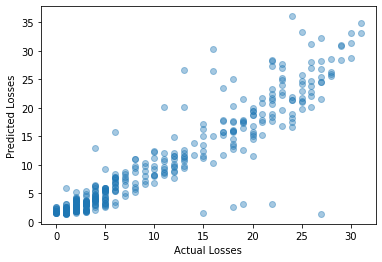

Train score for predicting Winnings from BreakPointsFaced and DoubleFaults: 0.7755470841516191
Test score for predicting Winnings from BreakPointsFaced and DoubleFaults: 0.8085647496042447 



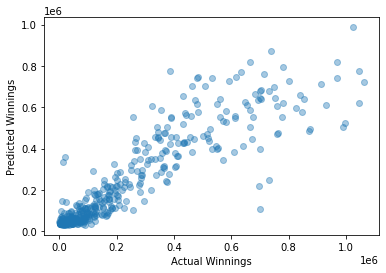

Train score for predicting Winnings from BreakPointsFaced and DoubleFaults: 0.11193691983049847
Test score for predicting Winnings from BreakPointsFaced and DoubleFaults: 0.08120198367498699 



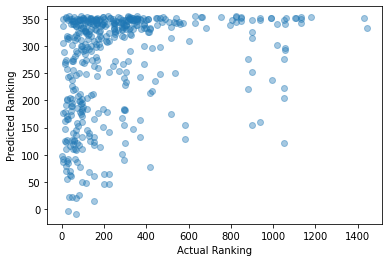

Train score for predicting Winnings from BreakPointsFaced and ReturnGamesPlayed: 0.8607260555497191
Test score for predicting Winnings from BreakPointsFaced and ReturnGamesPlayed: 0.8867558439905917 



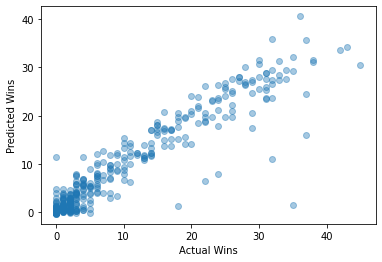

Train score for predicting Winnings from BreakPointsFaced and ReturnGamesPlayed: 0.8948435849487977
Test score for predicting Winnings from BreakPointsFaced and ReturnGamesPlayed: 0.9012209116106821 



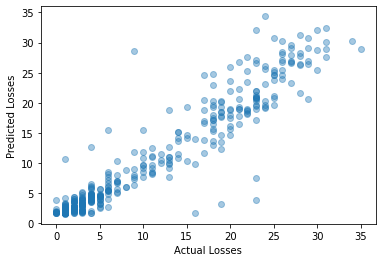

Train score for predicting Winnings from BreakPointsFaced and ReturnGamesPlayed: 0.8276905788843139
Test score for predicting Winnings from BreakPointsFaced and ReturnGamesPlayed: 0.8569958996856242 



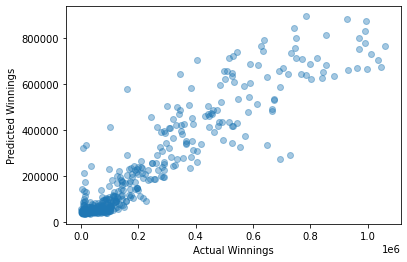

Train score for predicting Winnings from BreakPointsFaced and ReturnGamesPlayed: 0.10489491023934361
Test score for predicting Winnings from BreakPointsFaced and ReturnGamesPlayed: 0.12141464507353329 



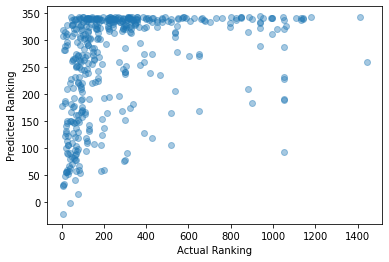

Train score for predicting Winnings from BreakPointsFaced and ReturnGamesWon: 0.7862263688058138
Test score for predicting Winnings from BreakPointsFaced and ReturnGamesWon: 0.7638603135828606 



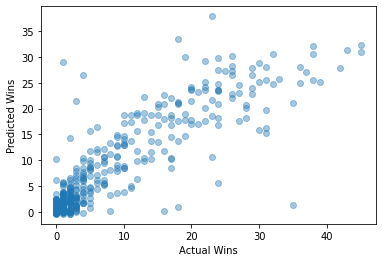

Train score for predicting Winnings from BreakPointsFaced and ReturnGamesWon: 0.9034714635340761
Test score for predicting Winnings from BreakPointsFaced and ReturnGamesWon: 0.8610381735404053 



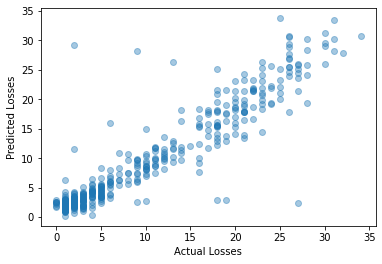

Train score for predicting Winnings from BreakPointsFaced and ReturnGamesWon: 0.7620382561870418
Test score for predicting Winnings from BreakPointsFaced and ReturnGamesWon: 0.7826662576371354 



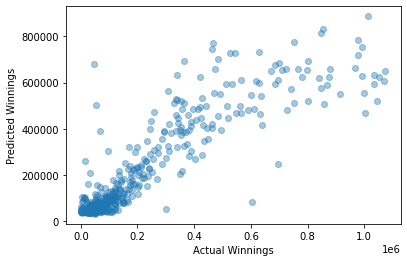

Train score for predicting Winnings from BreakPointsFaced and ReturnGamesWon: 0.10937335321270636
Test score for predicting Winnings from BreakPointsFaced and ReturnGamesWon: 0.11727951694318672 



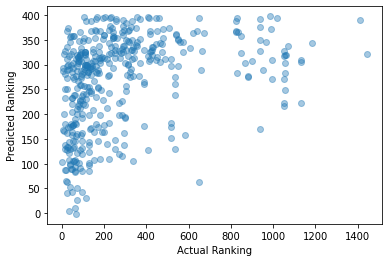

Train score for predicting Winnings from BreakPointsFaced and ReturnPointsWon: 0.7720088230259579
Test score for predicting Winnings from BreakPointsFaced and ReturnPointsWon: 0.8046004812696562 



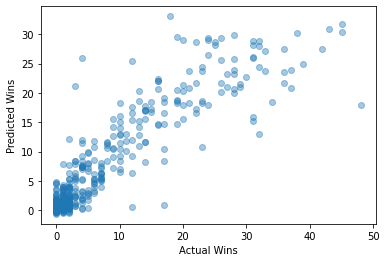

Train score for predicting Winnings from BreakPointsFaced and ReturnPointsWon: 0.8944463172757279
Test score for predicting Winnings from BreakPointsFaced and ReturnPointsWon: 0.8860643793907399 



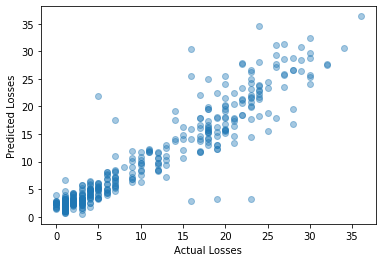

Train score for predicting Winnings from BreakPointsFaced and ReturnPointsWon: 0.7636997578278593
Test score for predicting Winnings from BreakPointsFaced and ReturnPointsWon: 0.7803326453716786 



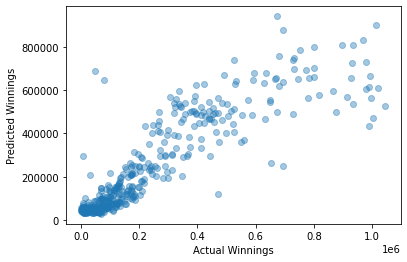

Train score for predicting Winnings from BreakPointsFaced and ReturnPointsWon: 0.12792703294529595
Test score for predicting Winnings from BreakPointsFaced and ReturnPointsWon: 0.07046619968169732 



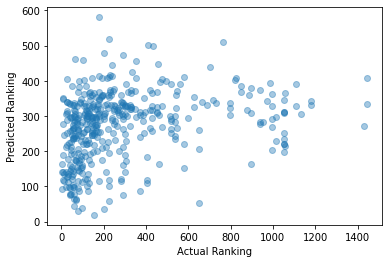

Train score for predicting Winnings from BreakPointsFaced and ServiceGamesPlayed: 0.8669226868337163
Test score for predicting Winnings from BreakPointsFaced and ServiceGamesPlayed: 0.8785169424570703 



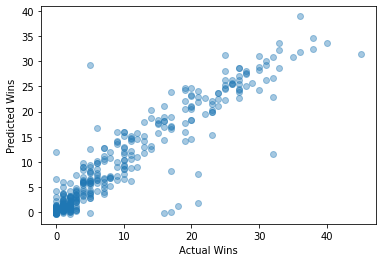

Train score for predicting Winnings from BreakPointsFaced and ServiceGamesPlayed: 0.8886103265118004
Test score for predicting Winnings from BreakPointsFaced and ServiceGamesPlayed: 0.918177700309253 



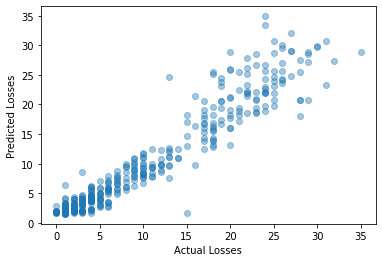

Train score for predicting Winnings from BreakPointsFaced and ServiceGamesPlayed: 0.8297471104497699
Test score for predicting Winnings from BreakPointsFaced and ServiceGamesPlayed: 0.8513304055794692 



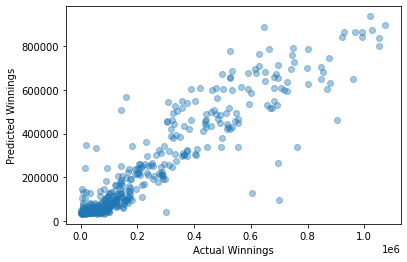

Train score for predicting Winnings from BreakPointsFaced and ServiceGamesPlayed: 0.10993670330743666
Test score for predicting Winnings from BreakPointsFaced and ServiceGamesPlayed: 0.10642680098539958 



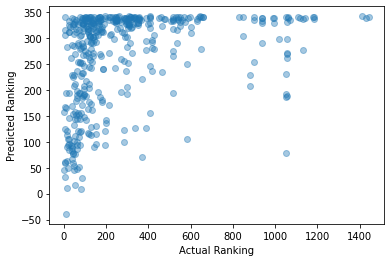

Train score for predicting Winnings from BreakPointsFaced and ServiceGamesWon: 0.792851653344224
Test score for predicting Winnings from BreakPointsFaced and ServiceGamesWon: 0.7662283949165152 



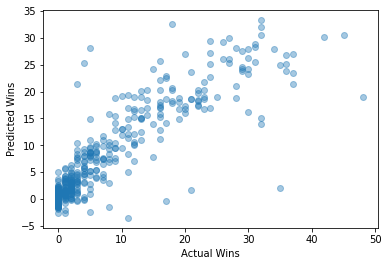

Train score for predicting Winnings from BreakPointsFaced and ServiceGamesWon: 0.8894152164150744
Test score for predicting Winnings from BreakPointsFaced and ServiceGamesWon: 0.8965346691351848 



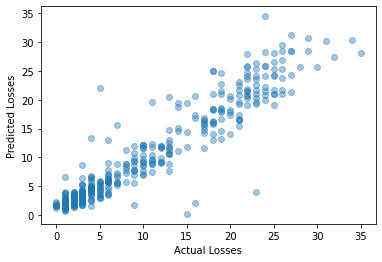

Train score for predicting Winnings from BreakPointsFaced and ServiceGamesWon: 0.7759172839902209
Test score for predicting Winnings from BreakPointsFaced and ServiceGamesWon: 0.774666815309217 



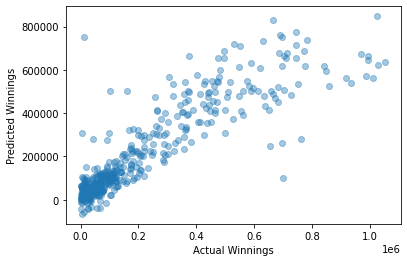

Train score for predicting Winnings from BreakPointsFaced and ServiceGamesWon: 0.11445570037875319
Test score for predicting Winnings from BreakPointsFaced and ServiceGamesWon: 0.10409938755557147 



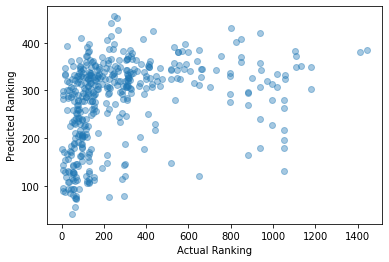

Train score for predicting Winnings from BreakPointsFaced and TotalPointsWon: 0.7874770004589248
Test score for predicting Winnings from BreakPointsFaced and TotalPointsWon: 0.7651100266637509 



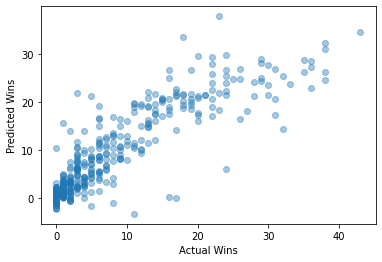

Train score for predicting Winnings from BreakPointsFaced and TotalPointsWon: 0.8855623279791969
Test score for predicting Winnings from BreakPointsFaced and TotalPointsWon: 0.9025942836213123 



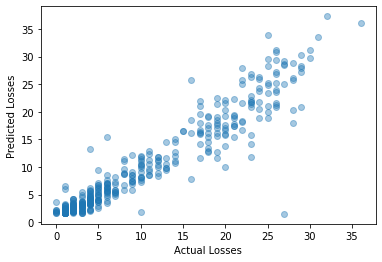

Train score for predicting Winnings from BreakPointsFaced and TotalPointsWon: 0.7565200589816945
Test score for predicting Winnings from BreakPointsFaced and TotalPointsWon: 0.8181848416000457 



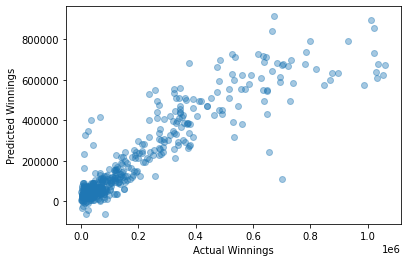

Train score for predicting Winnings from BreakPointsFaced and TotalPointsWon: 0.11595956375790127
Test score for predicting Winnings from BreakPointsFaced and TotalPointsWon: 0.1383130431201034 



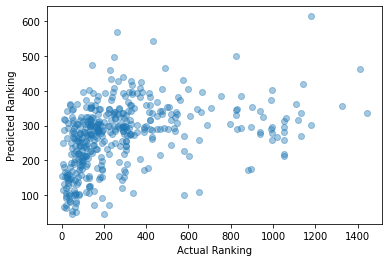

Train score for predicting Winnings from BreakPointsFaced and TotalServicePointsWon: 0.7715870642691083
Test score for predicting Winnings from BreakPointsFaced and TotalServicePointsWon: 0.8353923317077042 



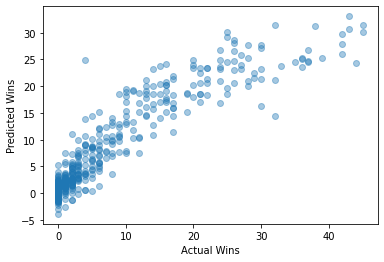

Train score for predicting Winnings from BreakPointsFaced and TotalServicePointsWon: 0.8899469161963213
Test score for predicting Winnings from BreakPointsFaced and TotalServicePointsWon: 0.8948639405531222 



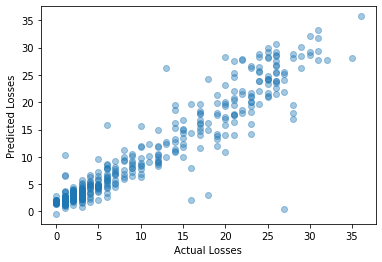

Train score for predicting Winnings from BreakPointsFaced and TotalServicePointsWon: 0.7851044546367787
Test score for predicting Winnings from BreakPointsFaced and TotalServicePointsWon: 0.7580867896023646 



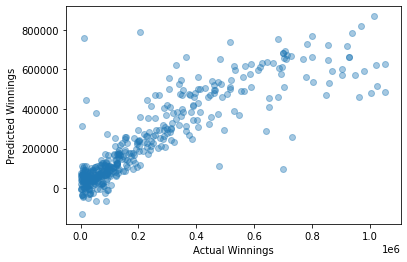

Train score for predicting Winnings from BreakPointsFaced and TotalServicePointsWon: 0.11474842266374574
Test score for predicting Winnings from BreakPointsFaced and TotalServicePointsWon: 0.1058025736015672 



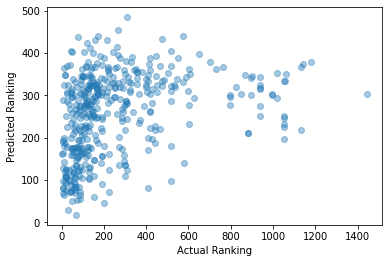

Train score for predicting Winnings from BreakPointsOpportunities and FirstServe: 0.8368180263813734
Test score for predicting Winnings from BreakPointsOpportunities and FirstServe: 0.9044758610032717 



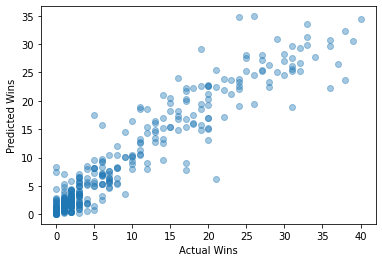

Train score for predicting Winnings from BreakPointsOpportunities and FirstServe: 0.8268366701422074
Test score for predicting Winnings from BreakPointsOpportunities and FirstServe: 0.8265948746844498 



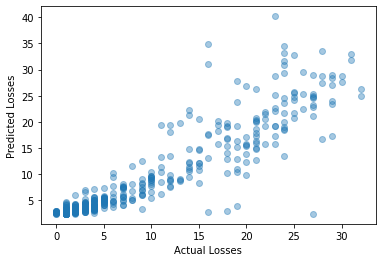

Train score for predicting Winnings from BreakPointsOpportunities and FirstServe: 0.8066980004960557
Test score for predicting Winnings from BreakPointsOpportunities and FirstServe: 0.8239710533553208 



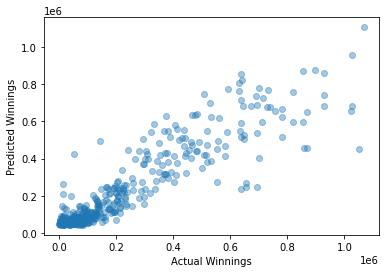

Train score for predicting Winnings from BreakPointsOpportunities and FirstServe: 0.10680333419317978
Test score for predicting Winnings from BreakPointsOpportunities and FirstServe: 0.12854832350226209 



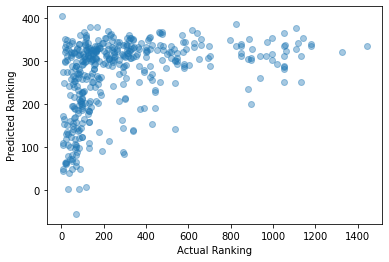

Train score for predicting Winnings from BreakPointsOpportunities and FirstServePointsWon: 0.8654490239098919
Test score for predicting Winnings from BreakPointsOpportunities and FirstServePointsWon: 0.8276709072599724 



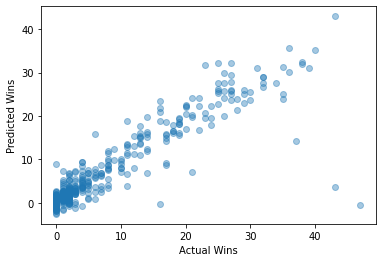

Train score for predicting Winnings from BreakPointsOpportunities and FirstServePointsWon: 0.8197560297254041
Test score for predicting Winnings from BreakPointsOpportunities and FirstServePointsWon: 0.8542073012534646 



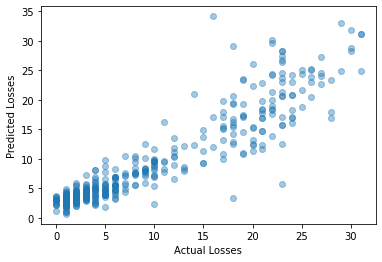

Train score for predicting Winnings from BreakPointsOpportunities and FirstServePointsWon: 0.8036087639978481
Test score for predicting Winnings from BreakPointsOpportunities and FirstServePointsWon: 0.8488334380186097 



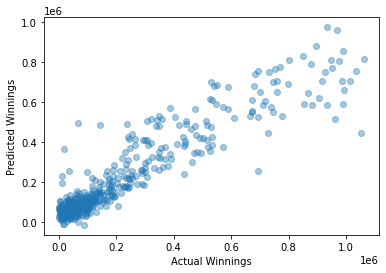

Train score for predicting Winnings from BreakPointsOpportunities and FirstServePointsWon: 0.11417111290094627
Test score for predicting Winnings from BreakPointsOpportunities and FirstServePointsWon: 0.10933615945148267 



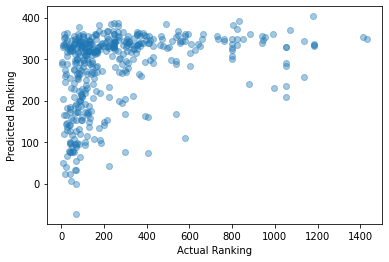

Train score for predicting Winnings from BreakPointsOpportunities and FirstServeReturnPointsWon: 0.8423489697709277
Test score for predicting Winnings from BreakPointsOpportunities and FirstServeReturnPointsWon: 0.8823475349053364 



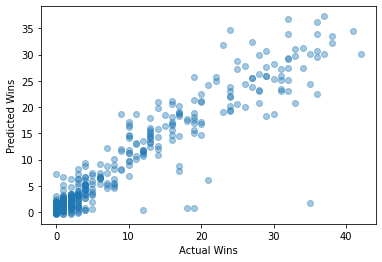

Train score for predicting Winnings from BreakPointsOpportunities and FirstServeReturnPointsWon: 0.8335391779000223
Test score for predicting Winnings from BreakPointsOpportunities and FirstServeReturnPointsWon: 0.8133883222056326 



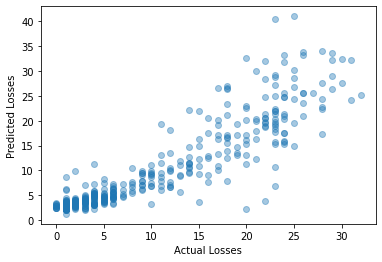

Train score for predicting Winnings from BreakPointsOpportunities and FirstServeReturnPointsWon: 0.8139805980764406
Test score for predicting Winnings from BreakPointsOpportunities and FirstServeReturnPointsWon: 0.8077878842618671 



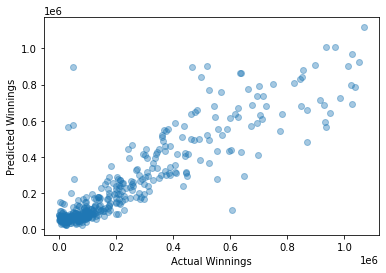

Train score for predicting Winnings from BreakPointsOpportunities and FirstServeReturnPointsWon: 0.12143894752038198
Test score for predicting Winnings from BreakPointsOpportunities and FirstServeReturnPointsWon: 0.0913746129978138 



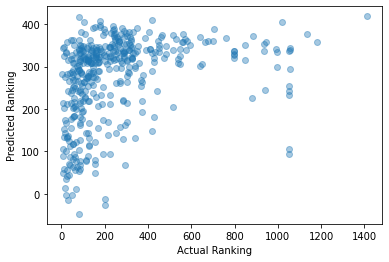

Train score for predicting Winnings from BreakPointsOpportunities and SecondServePointsWon: 0.8651512716993413
Test score for predicting Winnings from BreakPointsOpportunities and SecondServePointsWon: 0.819520149546492 



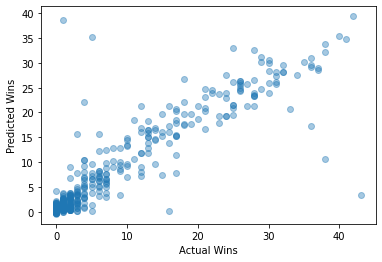

Train score for predicting Winnings from BreakPointsOpportunities and SecondServePointsWon: 0.8390452773428035
Test score for predicting Winnings from BreakPointsOpportunities and SecondServePointsWon: 0.7867772734955419 



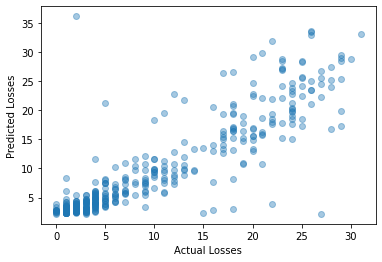

Train score for predicting Winnings from BreakPointsOpportunities and SecondServePointsWon: 0.8106268768087921
Test score for predicting Winnings from BreakPointsOpportunities and SecondServePointsWon: 0.8142727266935652 



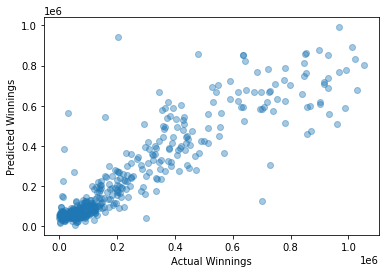

Train score for predicting Winnings from BreakPointsOpportunities and SecondServePointsWon: 0.12203398133939469
Test score for predicting Winnings from BreakPointsOpportunities and SecondServePointsWon: 0.11400054764526502 



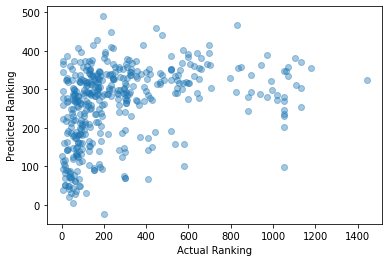

Train score for predicting Winnings from BreakPointsOpportunities and SecondServeReturnPointsWon: 0.8558603140910054
Test score for predicting Winnings from BreakPointsOpportunities and SecondServeReturnPointsWon: 0.8477150976006794 



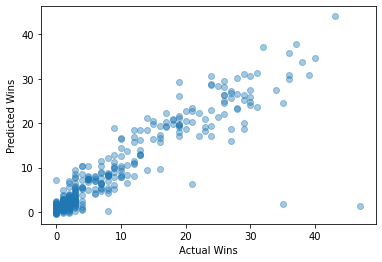

Train score for predicting Winnings from BreakPointsOpportunities and SecondServeReturnPointsWon: 0.8270613552898669
Test score for predicting Winnings from BreakPointsOpportunities and SecondServeReturnPointsWon: 0.833490075218912 



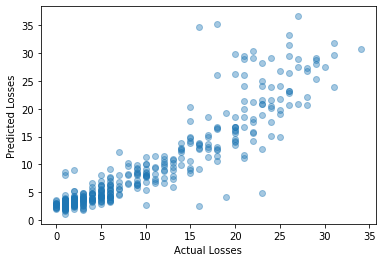

Train score for predicting Winnings from BreakPointsOpportunities and SecondServeReturnPointsWon: 0.8083300455665974
Test score for predicting Winnings from BreakPointsOpportunities and SecondServeReturnPointsWon: 0.8193163840931741 



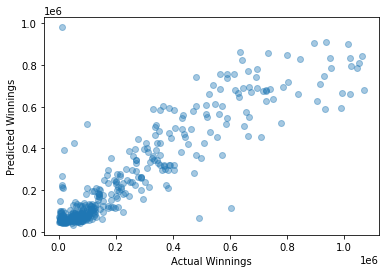

Train score for predicting Winnings from BreakPointsOpportunities and SecondServeReturnPointsWon: 0.11709266909358995
Test score for predicting Winnings from BreakPointsOpportunities and SecondServeReturnPointsWon: 0.12081314736329107 



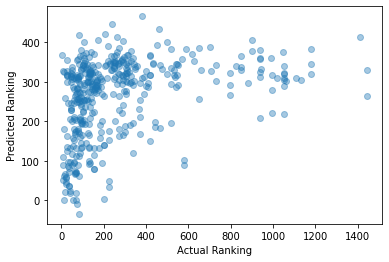

Train score for predicting Winnings from BreakPointsOpportunities and Aces: 0.8641350955801977
Test score for predicting Winnings from BreakPointsOpportunities and Aces: 0.9319113807597729 



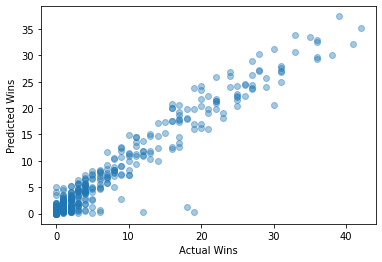

Train score for predicting Winnings from BreakPointsOpportunities and Aces: 0.8252975114623964
Test score for predicting Winnings from BreakPointsOpportunities and Aces: 0.86045649159724 



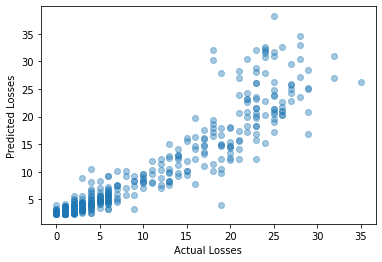

Train score for predicting Winnings from BreakPointsOpportunities and Aces: 0.8294571957848135
Test score for predicting Winnings from BreakPointsOpportunities and Aces: 0.8429553523132272 



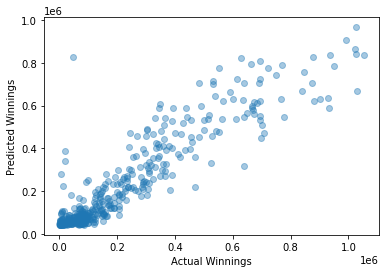

Train score for predicting Winnings from BreakPointsOpportunities and Aces: 0.10254799272594173
Test score for predicting Winnings from BreakPointsOpportunities and Aces: 0.14072448784970726 



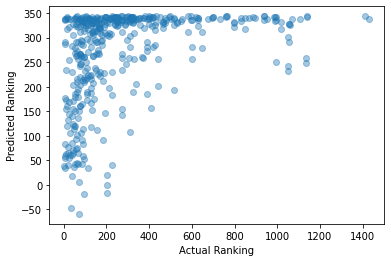

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsConverted: 0.8574185148379763
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsConverted: 0.8364103102939727 



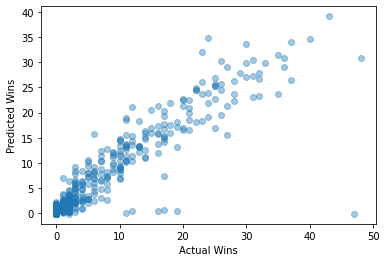

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsConverted: 0.8289101935956833
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsConverted: 0.8211469306957088 



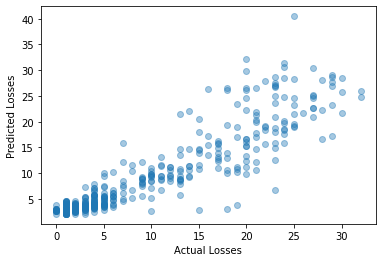

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsConverted: 0.816769717204452
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsConverted: 0.7932312783234675 



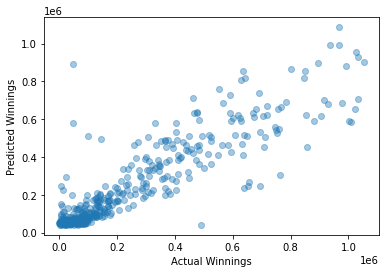

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsConverted: 0.10707631483780634
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsConverted: 0.12292482667716886 



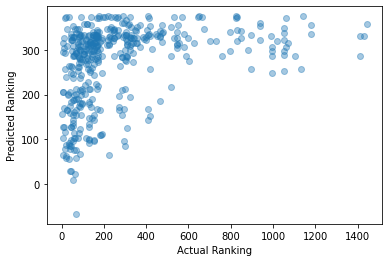

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsFaced: 0.8419504729099122
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsFaced: 0.9032095063949094 



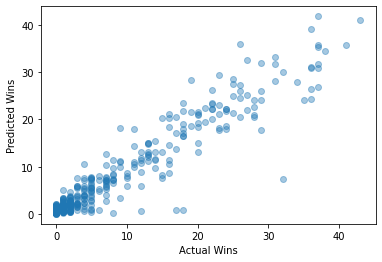

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsFaced: 0.8915894391662098
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsFaced: 0.8900394707462465 



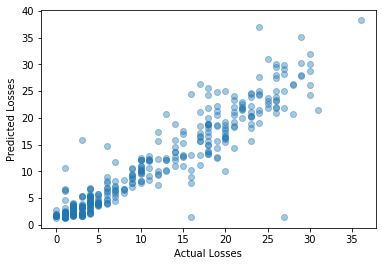

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsFaced: 0.8134285736052915
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsFaced: 0.8008116262177254 



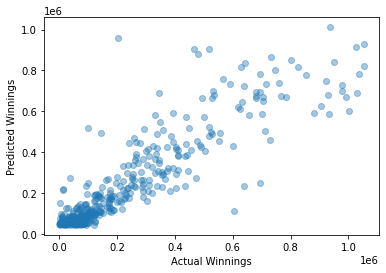

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsFaced: 0.1230518792438976
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsFaced: 0.06380408756204592 



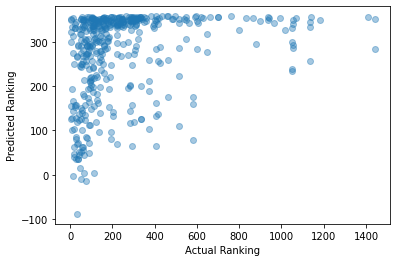

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsSaved: 0.8392005994398097
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsSaved: 0.8905850144484131 



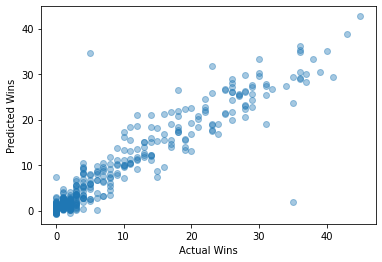

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsSaved: 0.8311424985994365
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsSaved: 0.8159976893375609 



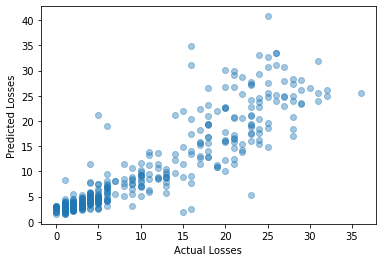

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsSaved: 0.8092274122744902
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsSaved: 0.821255006998749 



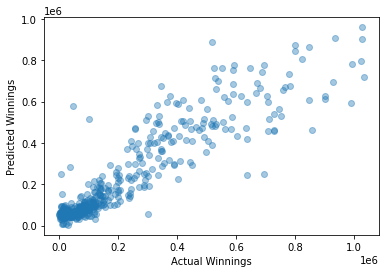

Train score for predicting Winnings from BreakPointsOpportunities and BreakPointsSaved: 0.10947864848841748
Test score for predicting Winnings from BreakPointsOpportunities and BreakPointsSaved: 0.11777204747112469 



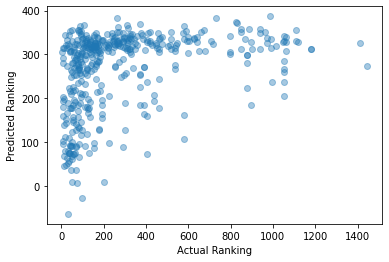

Train score for predicting Winnings from BreakPointsOpportunities and DoubleFaults: 0.8529473374887198
Test score for predicting Winnings from BreakPointsOpportunities and DoubleFaults: 0.854395076440192 



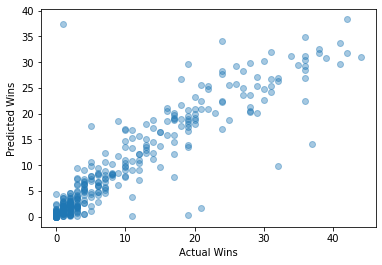

Train score for predicting Winnings from BreakPointsOpportunities and DoubleFaults: 0.8435429414807836
Test score for predicting Winnings from BreakPointsOpportunities and DoubleFaults: 0.8509117609252903 



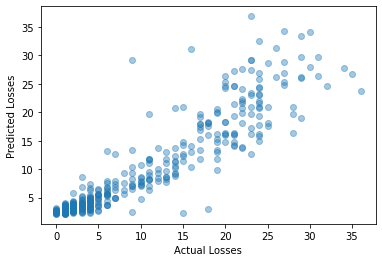

Train score for predicting Winnings from BreakPointsOpportunities and DoubleFaults: 0.8217077405555571
Test score for predicting Winnings from BreakPointsOpportunities and DoubleFaults: 0.8062082667605991 



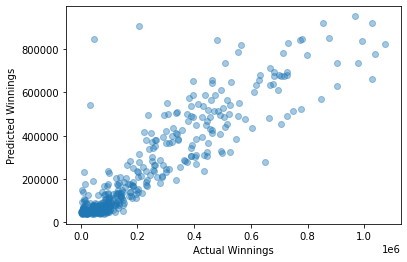

Train score for predicting Winnings from BreakPointsOpportunities and DoubleFaults: 0.11351255029275875
Test score for predicting Winnings from BreakPointsOpportunities and DoubleFaults: 0.10529914396721507 



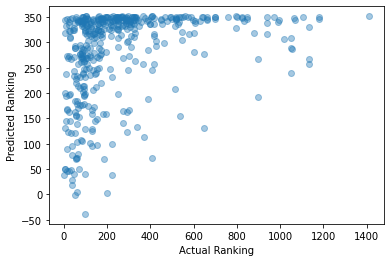

Train score for predicting Winnings from BreakPointsOpportunities and ReturnGamesPlayed: 0.8543437594972925
Test score for predicting Winnings from BreakPointsOpportunities and ReturnGamesPlayed: 0.8976167170670539 



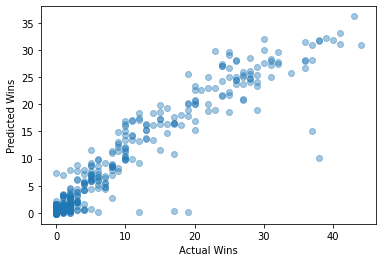

Train score for predicting Winnings from BreakPointsOpportunities and ReturnGamesPlayed: 0.8797925463357703
Test score for predicting Winnings from BreakPointsOpportunities and ReturnGamesPlayed: 0.8739706684525617 



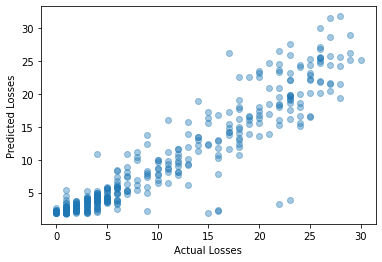

Train score for predicting Winnings from BreakPointsOpportunities and ReturnGamesPlayed: 0.8364191814442298
Test score for predicting Winnings from BreakPointsOpportunities and ReturnGamesPlayed: 0.8261052448130088 



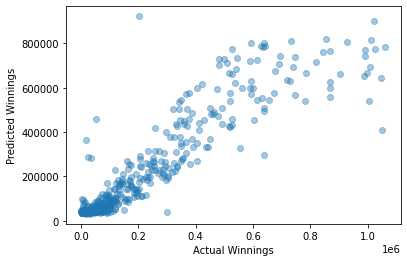

Train score for predicting Winnings from BreakPointsOpportunities and ReturnGamesPlayed: 0.11660168163153249
Test score for predicting Winnings from BreakPointsOpportunities and ReturnGamesPlayed: 0.0937623784975774 



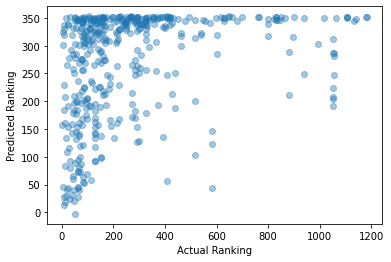

Train score for predicting Winnings from BreakPointsOpportunities and ReturnGamesWon: 0.8695780952931991
Test score for predicting Winnings from BreakPointsOpportunities and ReturnGamesWon: 0.8119295093094806 



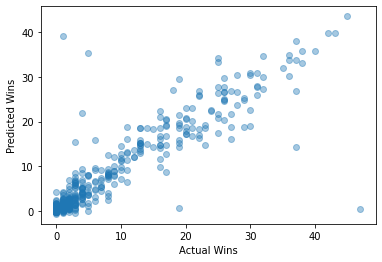

Train score for predicting Winnings from BreakPointsOpportunities and ReturnGamesWon: 0.828771584645319
Test score for predicting Winnings from BreakPointsOpportunities and ReturnGamesWon: 0.8349125304536977 



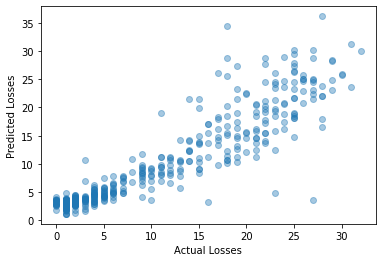

Train score for predicting Winnings from BreakPointsOpportunities and ReturnGamesWon: 0.8038723370556988
Test score for predicting Winnings from BreakPointsOpportunities and ReturnGamesWon: 0.8384386424774384 



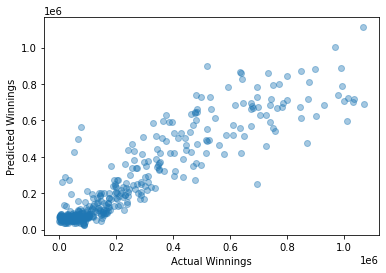

Train score for predicting Winnings from BreakPointsOpportunities and ReturnGamesWon: 0.122211916519394
Test score for predicting Winnings from BreakPointsOpportunities and ReturnGamesWon: 0.09664817586053298 



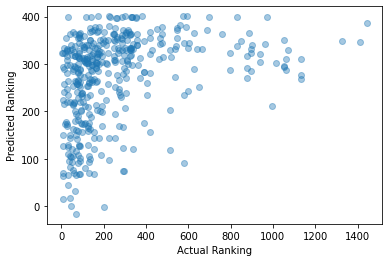

Train score for predicting Winnings from BreakPointsOpportunities and ReturnPointsWon: 0.8584458407498166
Test score for predicting Winnings from BreakPointsOpportunities and ReturnPointsWon: 0.8440471483019902 



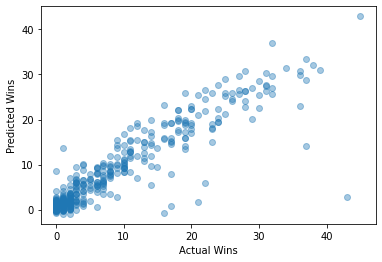

Train score for predicting Winnings from BreakPointsOpportunities and ReturnPointsWon: 0.8208284988558848
Test score for predicting Winnings from BreakPointsOpportunities and ReturnPointsWon: 0.8584521579770609 



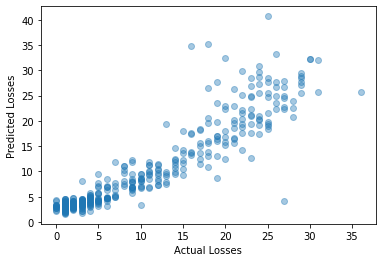

Train score for predicting Winnings from BreakPointsOpportunities and ReturnPointsWon: 0.8109833938676447
Test score for predicting Winnings from BreakPointsOpportunities and ReturnPointsWon: 0.8184553322539385 



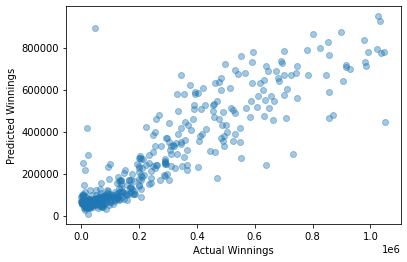

Train score for predicting Winnings from BreakPointsOpportunities and ReturnPointsWon: 0.11883397205785007
Test score for predicting Winnings from BreakPointsOpportunities and ReturnPointsWon: 0.11617320942066944 



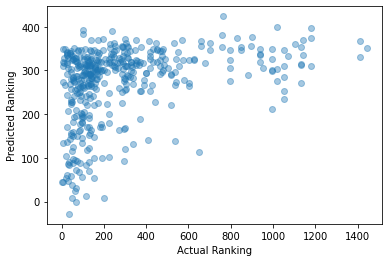

Train score for predicting Winnings from BreakPointsOpportunities and ServiceGamesPlayed: 0.8571988244301937
Test score for predicting Winnings from BreakPointsOpportunities and ServiceGamesPlayed: 0.9051471621647607 



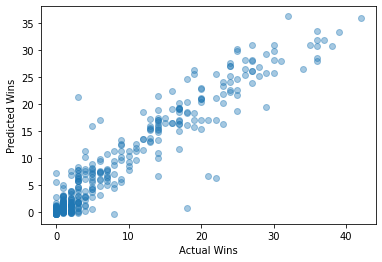

Train score for predicting Winnings from BreakPointsOpportunities and ServiceGamesPlayed: 0.8691295247985538
Test score for predicting Winnings from BreakPointsOpportunities and ServiceGamesPlayed: 0.8926641288500295 



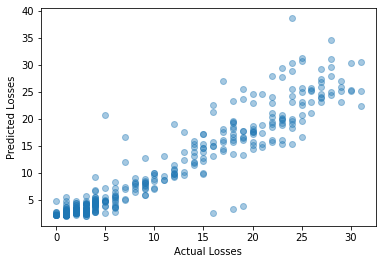

Train score for predicting Winnings from BreakPointsOpportunities and ServiceGamesPlayed: 0.83072046436593
Test score for predicting Winnings from BreakPointsOpportunities and ServiceGamesPlayed: 0.8416165049433459 



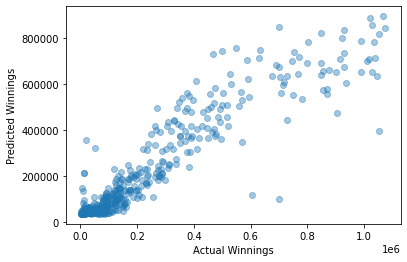

Train score for predicting Winnings from BreakPointsOpportunities and ServiceGamesPlayed: 0.10507100036649364
Test score for predicting Winnings from BreakPointsOpportunities and ServiceGamesPlayed: 0.13102800545425708 



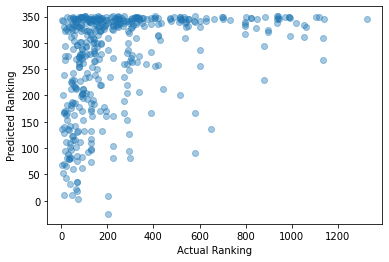

Train score for predicting Winnings from BreakPointsOpportunities and ServiceGamesWon: 0.8509202874099445
Test score for predicting Winnings from BreakPointsOpportunities and ServiceGamesWon: 0.8653313419287738 



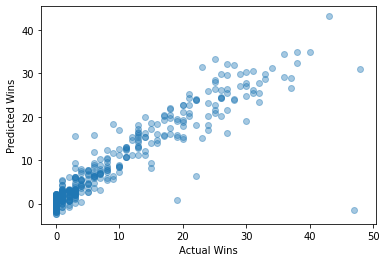

Train score for predicting Winnings from BreakPointsOpportunities and ServiceGamesWon: 0.8281754861771858
Test score for predicting Winnings from BreakPointsOpportunities and ServiceGamesWon: 0.8264464967518954 



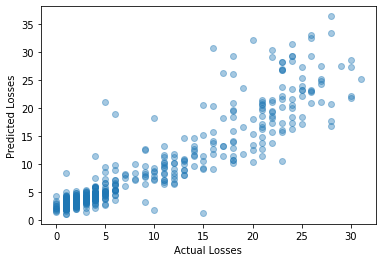

Train score for predicting Winnings from BreakPointsOpportunities and ServiceGamesWon: 0.8069609947286976
Test score for predicting Winnings from BreakPointsOpportunities and ServiceGamesWon: 0.8348284864531482 



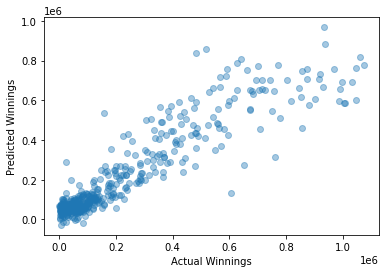

Train score for predicting Winnings from BreakPointsOpportunities and ServiceGamesWon: 0.12074168835599897
Test score for predicting Winnings from BreakPointsOpportunities and ServiceGamesWon: 0.0992228949610221 



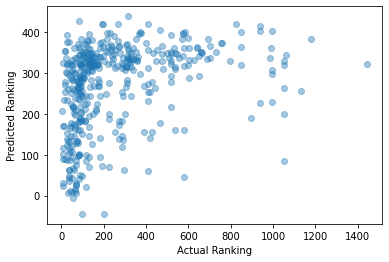

Train score for predicting Winnings from BreakPointsOpportunities and TotalPointsWon: 0.8749340296980628
Test score for predicting Winnings from BreakPointsOpportunities and TotalPointsWon: 0.7853147442694888 



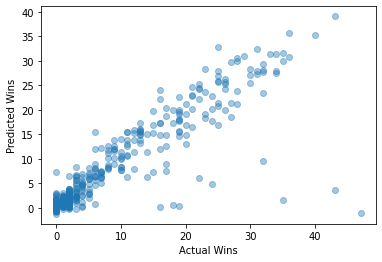

Train score for predicting Winnings from BreakPointsOpportunities and TotalPointsWon: 0.8251383145614721
Test score for predicting Winnings from BreakPointsOpportunities and TotalPointsWon: 0.8327339450098198 



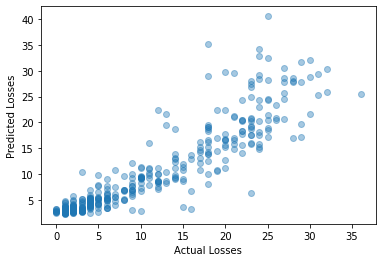

Train score for predicting Winnings from BreakPointsOpportunities and TotalPointsWon: 0.807290386199058
Test score for predicting Winnings from BreakPointsOpportunities and TotalPointsWon: 0.8223750217416006 



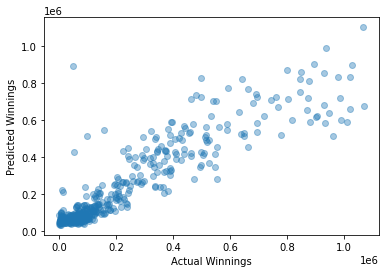

Train score for predicting Winnings from BreakPointsOpportunities and TotalPointsWon: 0.11441402034497883
Test score for predicting Winnings from BreakPointsOpportunities and TotalPointsWon: 0.13825994952196474 



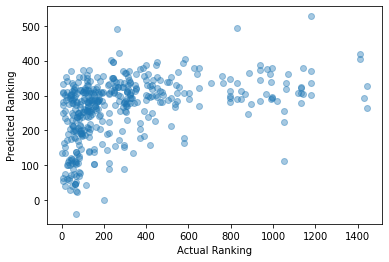

Train score for predicting Winnings from BreakPointsOpportunities and TotalServicePointsWon: 0.8546121860989293
Test score for predicting Winnings from BreakPointsOpportunities and TotalServicePointsWon: 0.8569150891364737 



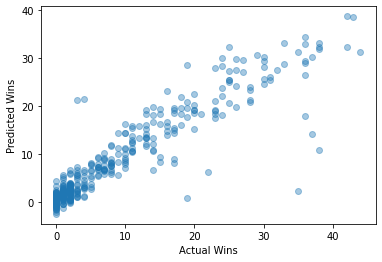

Train score for predicting Winnings from BreakPointsOpportunities and TotalServicePointsWon: 0.8223853532977896
Test score for predicting Winnings from BreakPointsOpportunities and TotalServicePointsWon: 0.8411912934658187 



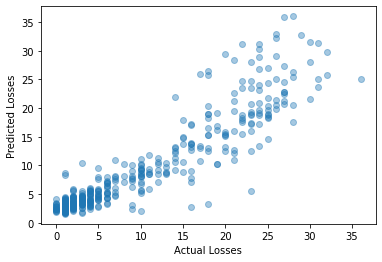

Train score for predicting Winnings from BreakPointsOpportunities and TotalServicePointsWon: 0.8037799576398398
Test score for predicting Winnings from BreakPointsOpportunities and TotalServicePointsWon: 0.8461654772700307 



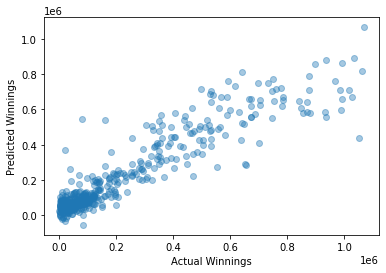

Train score for predicting Winnings from BreakPointsOpportunities and TotalServicePointsWon: 0.12114855298630711
Test score for predicting Winnings from BreakPointsOpportunities and TotalServicePointsWon: 0.11249076712068962 



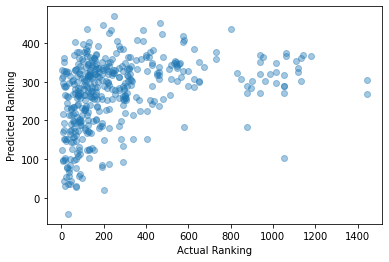

Train score for predicting Winnings from BreakPointsSaved and FirstServe: 0.06394004203058956
Test score for predicting Winnings from BreakPointsSaved and FirstServe: 0.06756807965867972 



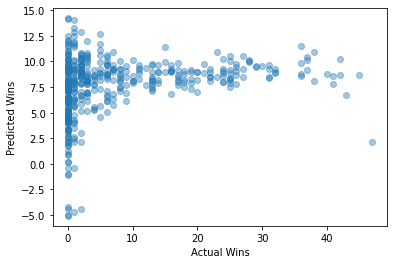

Train score for predicting Winnings from BreakPointsSaved and FirstServe: 0.06427484880039791
Test score for predicting Winnings from BreakPointsSaved and FirstServe: 0.05374715166802502 



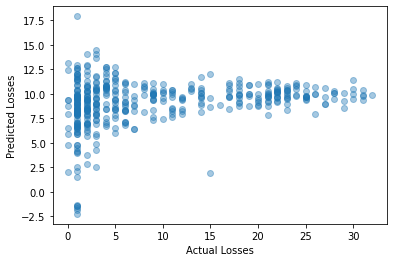

Train score for predicting Winnings from BreakPointsSaved and FirstServe: 0.07885990610782267
Test score for predicting Winnings from BreakPointsSaved and FirstServe: 0.02711985309021603 



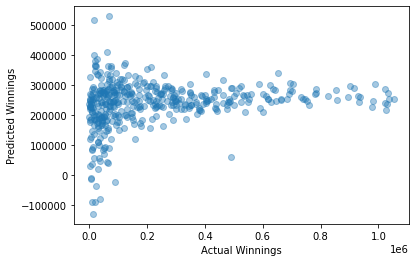

Train score for predicting Winnings from BreakPointsSaved and FirstServe: 0.0252096784368524
Test score for predicting Winnings from BreakPointsSaved and FirstServe: -0.012985374014077733 



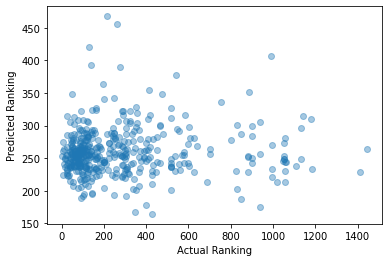

Train score for predicting Winnings from BreakPointsSaved and FirstServePointsWon: 0.14447266961694405
Test score for predicting Winnings from BreakPointsSaved and FirstServePointsWon: 0.12910434555876704 



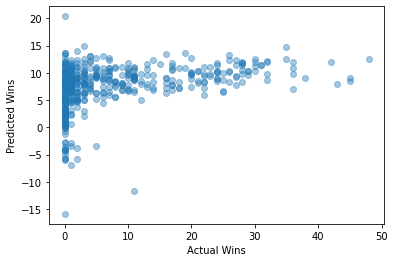

Train score for predicting Winnings from BreakPointsSaved and FirstServePointsWon: 0.121728147852884
Test score for predicting Winnings from BreakPointsSaved and FirstServePointsWon: 0.12655855413199346 



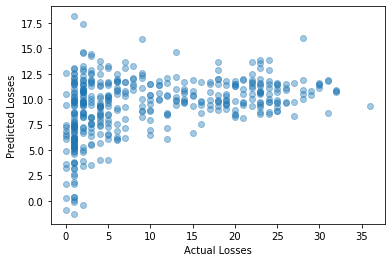

Train score for predicting Winnings from BreakPointsSaved and FirstServePointsWon: 0.13663010840891276
Test score for predicting Winnings from BreakPointsSaved and FirstServePointsWon: 0.1705882090331895 



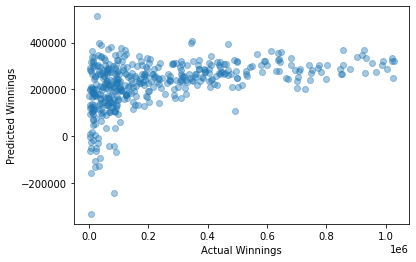

Train score for predicting Winnings from BreakPointsSaved and FirstServePointsWon: 0.02631156815557045
Test score for predicting Winnings from BreakPointsSaved and FirstServePointsWon: 0.019664119215307085 



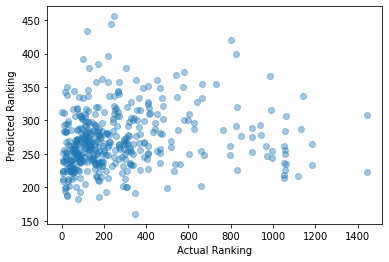

Train score for predicting Winnings from BreakPointsSaved and FirstServeReturnPointsWon: 0.11802256005375
Test score for predicting Winnings from BreakPointsSaved and FirstServeReturnPointsWon: 0.12885036547900652 



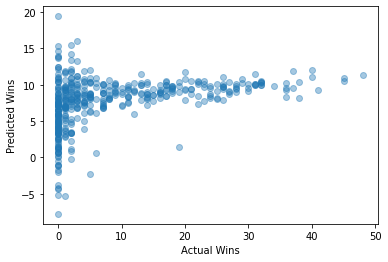

Train score for predicting Winnings from BreakPointsSaved and FirstServeReturnPointsWon: 0.11418002725301424
Test score for predicting Winnings from BreakPointsSaved and FirstServeReturnPointsWon: 0.11406461585780259 



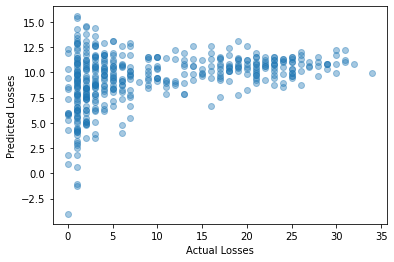

Train score for predicting Winnings from BreakPointsSaved and FirstServeReturnPointsWon: 0.11793824973621081
Test score for predicting Winnings from BreakPointsSaved and FirstServeReturnPointsWon: 0.11874388013402326 



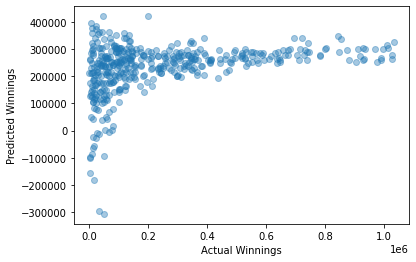

Train score for predicting Winnings from BreakPointsSaved and FirstServeReturnPointsWon: 0.041740034548773626
Test score for predicting Winnings from BreakPointsSaved and FirstServeReturnPointsWon: 0.05263656899061697 



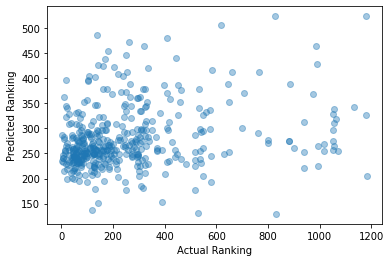

Train score for predicting Winnings from BreakPointsSaved and SecondServePointsWon: 0.10979603971445595
Test score for predicting Winnings from BreakPointsSaved and SecondServePointsWon: 0.02611797565724483 



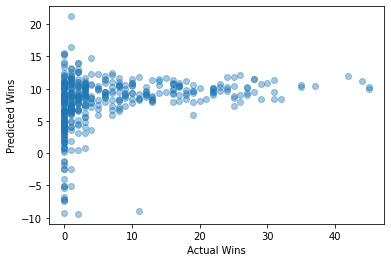

Train score for predicting Winnings from BreakPointsSaved and SecondServePointsWon: 0.09529193201004305
Test score for predicting Winnings from BreakPointsSaved and SecondServePointsWon: 0.08112440044428837 



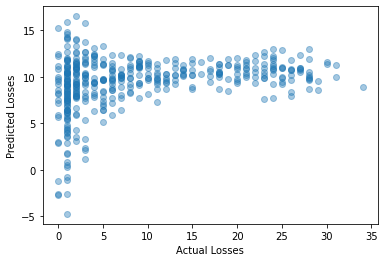

Train score for predicting Winnings from BreakPointsSaved and SecondServePointsWon: 0.10668842196029536
Test score for predicting Winnings from BreakPointsSaved and SecondServePointsWon: 0.11516983845437334 



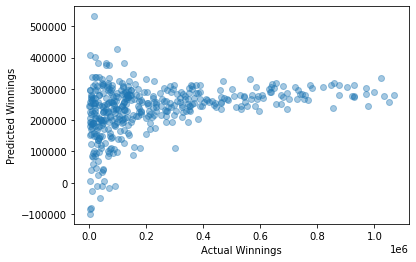

Train score for predicting Winnings from BreakPointsSaved and SecondServePointsWon: 0.04472873954937939
Test score for predicting Winnings from BreakPointsSaved and SecondServePointsWon: 0.012441466585003114 



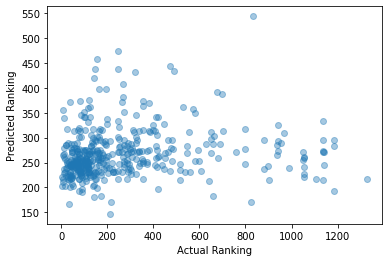

Train score for predicting Winnings from BreakPointsSaved and SecondServeReturnPointsWon: 0.09458514791425165
Test score for predicting Winnings from BreakPointsSaved and SecondServeReturnPointsWon: 0.08468965689192187 



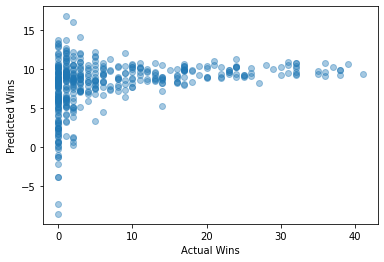

Train score for predicting Winnings from BreakPointsSaved and SecondServeReturnPointsWon: 0.08597001683376038
Test score for predicting Winnings from BreakPointsSaved and SecondServeReturnPointsWon: 0.09639526599276982 



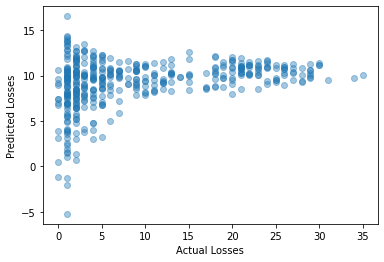

Train score for predicting Winnings from BreakPointsSaved and SecondServeReturnPointsWon: 0.08955014055321964
Test score for predicting Winnings from BreakPointsSaved and SecondServeReturnPointsWon: 0.11477116330925985 



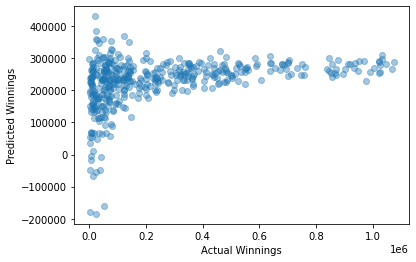

Train score for predicting Winnings from BreakPointsSaved and SecondServeReturnPointsWon: 0.038008782000813146
Test score for predicting Winnings from BreakPointsSaved and SecondServeReturnPointsWon: 0.03535089751681264 



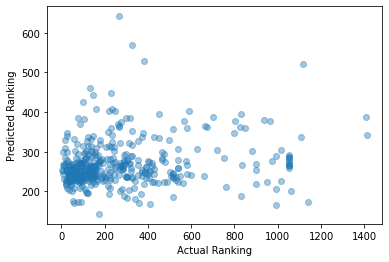

Train score for predicting Winnings from BreakPointsSaved and Aces: 0.6771770020555214
Test score for predicting Winnings from BreakPointsSaved and Aces: 0.6933002399901423 



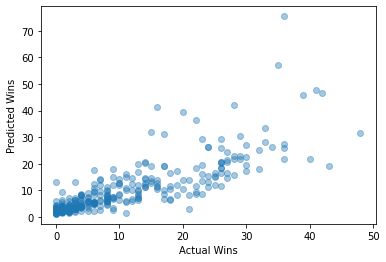

Train score for predicting Winnings from BreakPointsSaved and Aces: 0.5980269666070905
Test score for predicting Winnings from BreakPointsSaved and Aces: 0.5673988835372843 



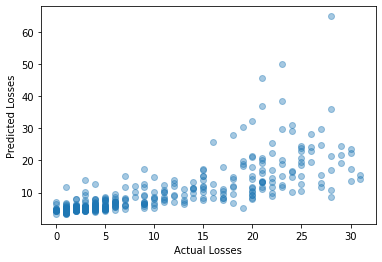

Train score for predicting Winnings from BreakPointsSaved and Aces: 0.6517744557398185
Test score for predicting Winnings from BreakPointsSaved and Aces: 0.5946403819331538 



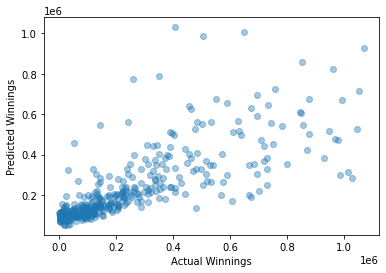

Train score for predicting Winnings from BreakPointsSaved and Aces: 0.07089348118713812
Test score for predicting Winnings from BreakPointsSaved and Aces: 0.10594706473544113 



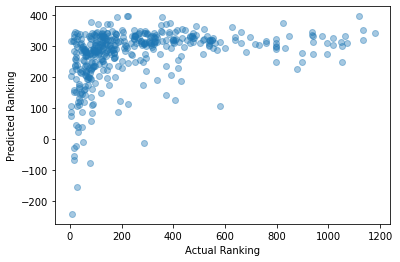

Train score for predicting Winnings from BreakPointsSaved and BreakPointsConverted: 0.07529198502555912
Test score for predicting Winnings from BreakPointsSaved and BreakPointsConverted: 0.0482073818794001 



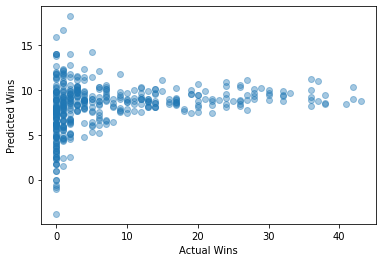

Train score for predicting Winnings from BreakPointsSaved and BreakPointsConverted: 0.06335140765920799
Test score for predicting Winnings from BreakPointsSaved and BreakPointsConverted: 0.07097708341243658 



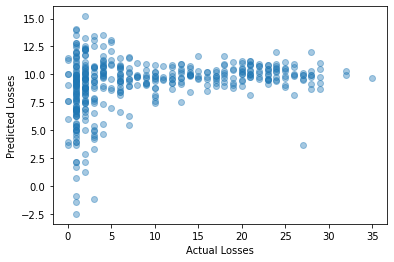

Train score for predicting Winnings from BreakPointsSaved and BreakPointsConverted: 0.06699678477305415
Test score for predicting Winnings from BreakPointsSaved and BreakPointsConverted: 0.09168537997671444 



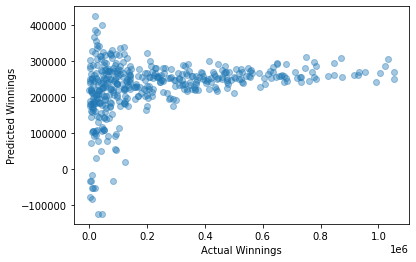

Train score for predicting Winnings from BreakPointsSaved and BreakPointsConverted: 0.010657072781203978
Test score for predicting Winnings from BreakPointsSaved and BreakPointsConverted: 0.029964839766530638 



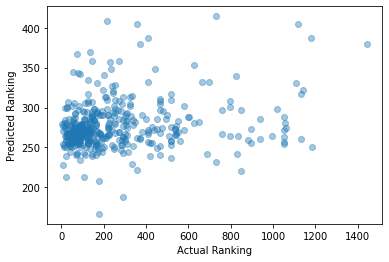

Train score for predicting Winnings from BreakPointsSaved and BreakPointsFaced: 0.7726203209355256
Test score for predicting Winnings from BreakPointsSaved and BreakPointsFaced: 0.8026709115117633 



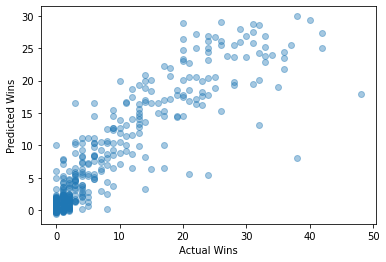

Train score for predicting Winnings from BreakPointsSaved and BreakPointsFaced: 0.8770137923489212
Test score for predicting Winnings from BreakPointsSaved and BreakPointsFaced: 0.927302775352435 



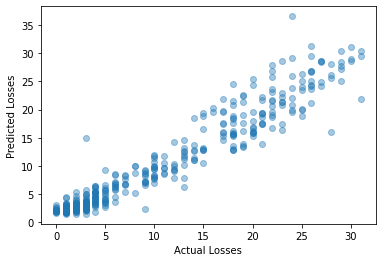

Train score for predicting Winnings from BreakPointsSaved and BreakPointsFaced: 0.7686965336091506
Test score for predicting Winnings from BreakPointsSaved and BreakPointsFaced: 0.7646948947096281 



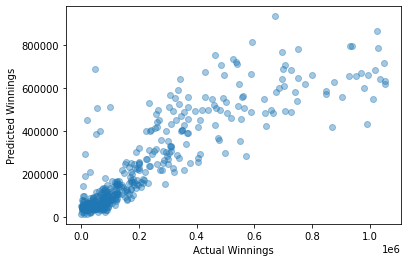

Train score for predicting Winnings from BreakPointsSaved and BreakPointsFaced: 0.09624915842916992
Test score for predicting Winnings from BreakPointsSaved and BreakPointsFaced: 0.12322236430411593 



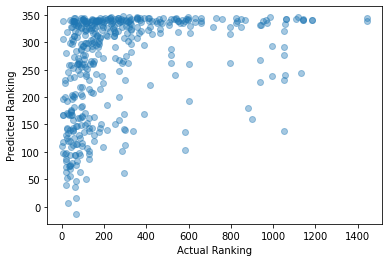

Train score for predicting Winnings from BreakPointsSaved and BreakPointsOpportunities: 0.8690545639922548
Test score for predicting Winnings from BreakPointsSaved and BreakPointsOpportunities: 0.8141441665291048 



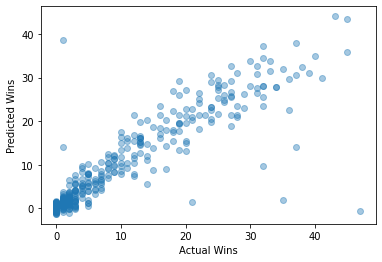

Train score for predicting Winnings from BreakPointsSaved and BreakPointsOpportunities: 0.8297425933237674
Test score for predicting Winnings from BreakPointsSaved and BreakPointsOpportunities: 0.819505708479616 



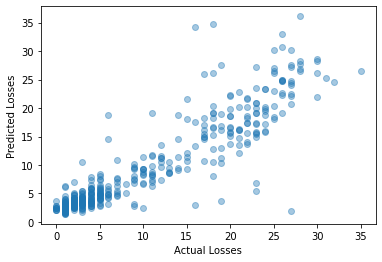

Train score for predicting Winnings from BreakPointsSaved and BreakPointsOpportunities: 0.8118788620439678
Test score for predicting Winnings from BreakPointsSaved and BreakPointsOpportunities: 0.8122547052733377 



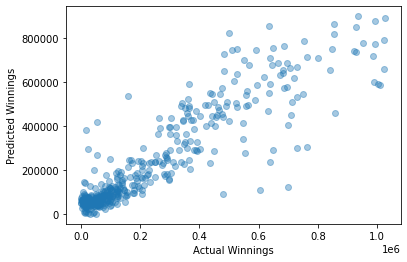

Train score for predicting Winnings from BreakPointsSaved and BreakPointsOpportunities: 0.10854689995025035
Test score for predicting Winnings from BreakPointsSaved and BreakPointsOpportunities: 0.10386822069778567 



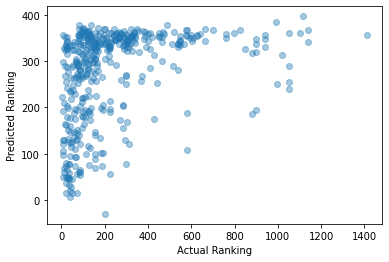

Train score for predicting Winnings from BreakPointsSaved and DoubleFaults: 0.7274065372355634
Test score for predicting Winnings from BreakPointsSaved and DoubleFaults: 0.685554310084154 



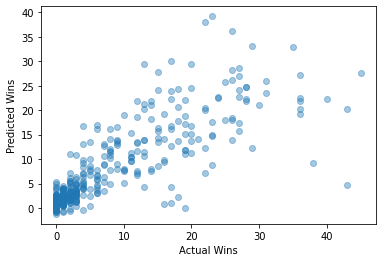

Train score for predicting Winnings from BreakPointsSaved and DoubleFaults: 0.7849112788452868
Test score for predicting Winnings from BreakPointsSaved and DoubleFaults: 0.7572798062139483 



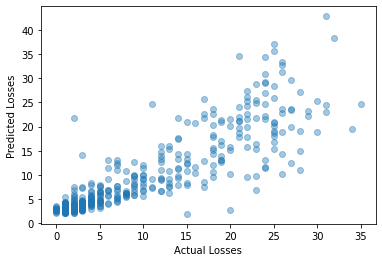

Train score for predicting Winnings from BreakPointsSaved and DoubleFaults: 0.7431125352456166
Test score for predicting Winnings from BreakPointsSaved and DoubleFaults: 0.6908447330529264 



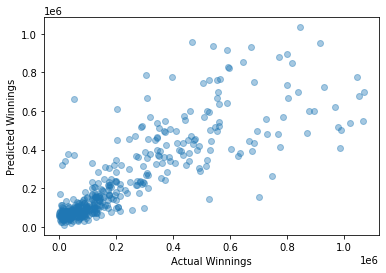

Train score for predicting Winnings from BreakPointsSaved and DoubleFaults: 0.09147348936698674
Test score for predicting Winnings from BreakPointsSaved and DoubleFaults: 0.10637902334030214 



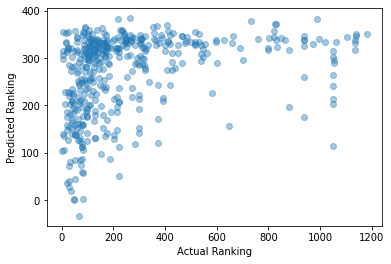

Train score for predicting Winnings from BreakPointsSaved and ReturnGamesPlayed: 0.8464992995192694
Test score for predicting Winnings from BreakPointsSaved and ReturnGamesPlayed: 0.9078484283911276 



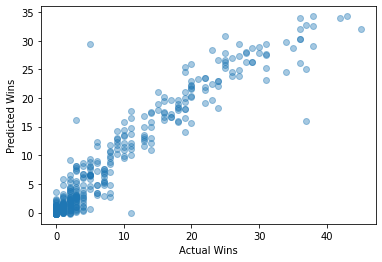

Train score for predicting Winnings from BreakPointsSaved and ReturnGamesPlayed: 0.884818944642483
Test score for predicting Winnings from BreakPointsSaved and ReturnGamesPlayed: 0.857723515016372 



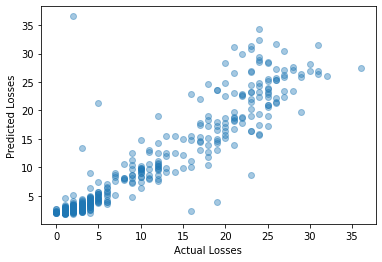

Train score for predicting Winnings from BreakPointsSaved and ReturnGamesPlayed: 0.8269641034569795
Test score for predicting Winnings from BreakPointsSaved and ReturnGamesPlayed: 0.8490205166548981 



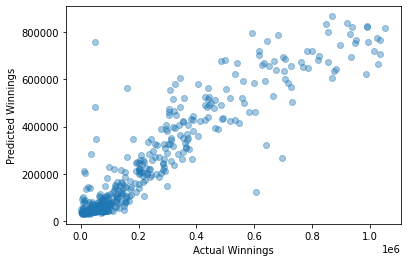

Train score for predicting Winnings from BreakPointsSaved and ReturnGamesPlayed: 0.11523458435367662
Test score for predicting Winnings from BreakPointsSaved and ReturnGamesPlayed: 0.09507097415040555 



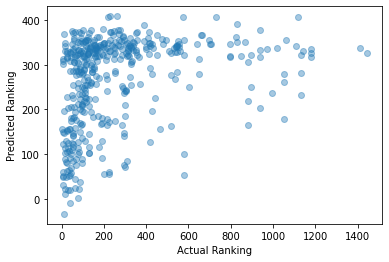

Train score for predicting Winnings from BreakPointsSaved and ReturnGamesWon: 0.15597030933195477
Test score for predicting Winnings from BreakPointsSaved and ReturnGamesWon: 0.09916096451588641 



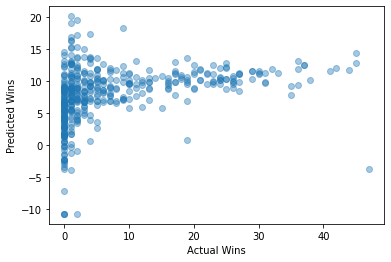

Train score for predicting Winnings from BreakPointsSaved and ReturnGamesWon: 0.12850389414086238
Test score for predicting Winnings from BreakPointsSaved and ReturnGamesWon: 0.0961922832191282 



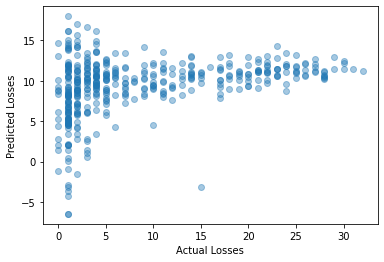

Train score for predicting Winnings from BreakPointsSaved and ReturnGamesWon: 0.1330055734389085
Test score for predicting Winnings from BreakPointsSaved and ReturnGamesWon: 0.15362636299799548 



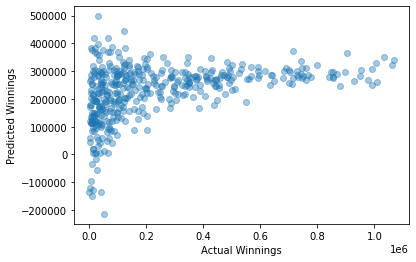

Train score for predicting Winnings from BreakPointsSaved and ReturnGamesWon: 0.05195865127411759
Test score for predicting Winnings from BreakPointsSaved and ReturnGamesWon: 0.03801324730601863 



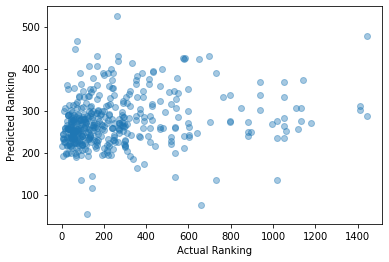

Train score for predicting Winnings from BreakPointsSaved and ReturnPointsWon: 0.12294355973969118
Test score for predicting Winnings from BreakPointsSaved and ReturnPointsWon: 0.16391083510712445 



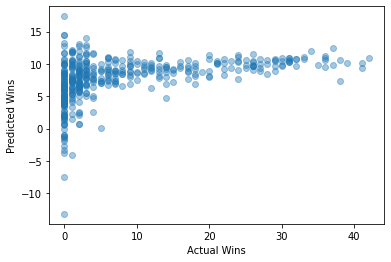

Train score for predicting Winnings from BreakPointsSaved and ReturnPointsWon: 0.12526401623959926
Test score for predicting Winnings from BreakPointsSaved and ReturnPointsWon: 0.12184638844105533 



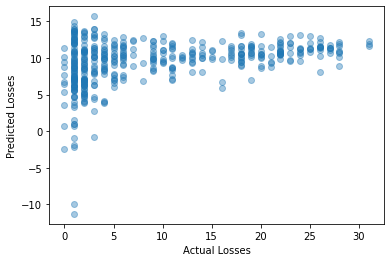

Train score for predicting Winnings from BreakPointsSaved and ReturnPointsWon: 0.13553138968634626
Test score for predicting Winnings from BreakPointsSaved and ReturnPointsWon: 0.12568713762532002 



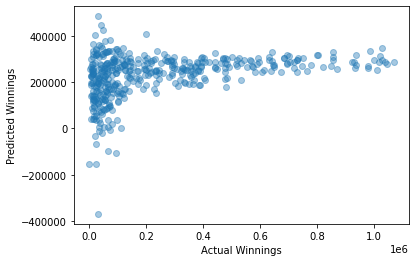

Train score for predicting Winnings from BreakPointsSaved and ReturnPointsWon: 0.04391931377150582
Test score for predicting Winnings from BreakPointsSaved and ReturnPointsWon: 0.06832929601443127 



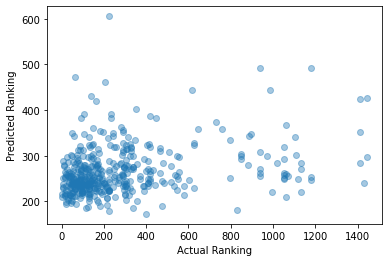

Train score for predicting Winnings from BreakPointsSaved and ServiceGamesPlayed: 0.8655468144151144
Test score for predicting Winnings from BreakPointsSaved and ServiceGamesPlayed: 0.8519377037124509 



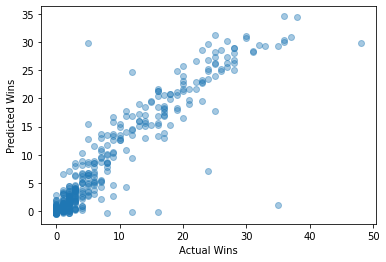

Train score for predicting Winnings from BreakPointsSaved and ServiceGamesPlayed: 0.8684246391550109
Test score for predicting Winnings from BreakPointsSaved and ServiceGamesPlayed: 0.8928523562968307 



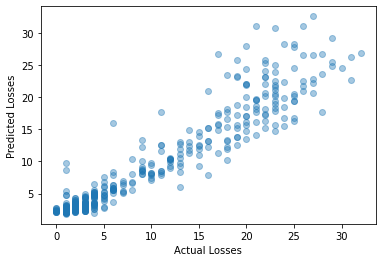

Train score for predicting Winnings from BreakPointsSaved and ServiceGamesPlayed: 0.8414461404198423
Test score for predicting Winnings from BreakPointsSaved and ServiceGamesPlayed: 0.8123832368748606 



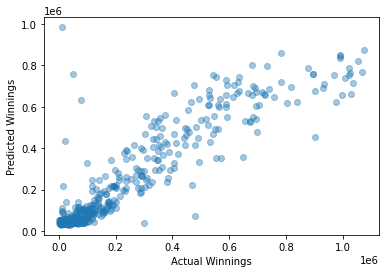

Train score for predicting Winnings from BreakPointsSaved and ServiceGamesPlayed: 0.10625835998838316
Test score for predicting Winnings from BreakPointsSaved and ServiceGamesPlayed: 0.11428721507997253 



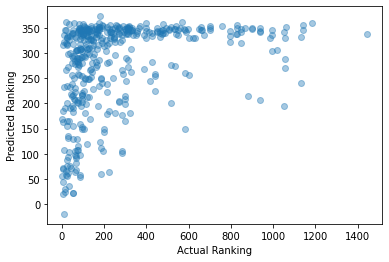

Train score for predicting Winnings from BreakPointsSaved and ServiceGamesWon: 0.15313734328579254
Test score for predicting Winnings from BreakPointsSaved and ServiceGamesWon: 0.14667600315395635 



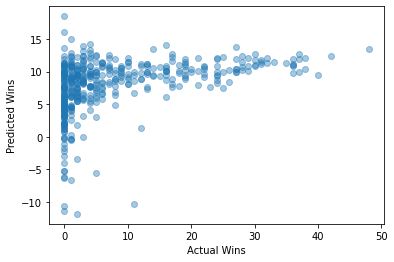

Train score for predicting Winnings from BreakPointsSaved and ServiceGamesWon: 0.14439634492161668
Test score for predicting Winnings from BreakPointsSaved and ServiceGamesWon: 0.12305848334542126 



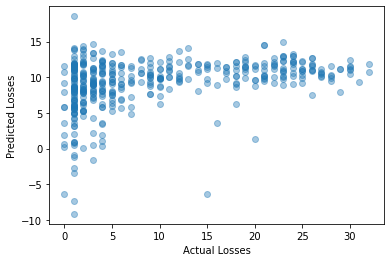

Train score for predicting Winnings from BreakPointsSaved and ServiceGamesWon: 0.1617290676322829
Test score for predicting Winnings from BreakPointsSaved and ServiceGamesWon: 0.15237119368252494 



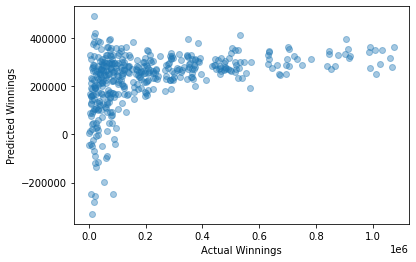

Train score for predicting Winnings from BreakPointsSaved and ServiceGamesWon: 0.03932966359664347
Test score for predicting Winnings from BreakPointsSaved and ServiceGamesWon: 0.03729997893224413 



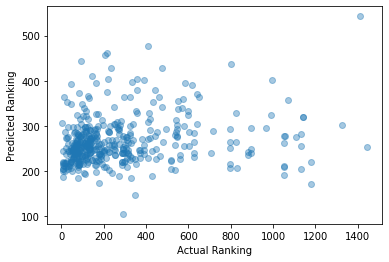

Train score for predicting Winnings from BreakPointsSaved and TotalPointsWon: 0.2002438488158359
Test score for predicting Winnings from BreakPointsSaved and TotalPointsWon: 0.24300306734999066 



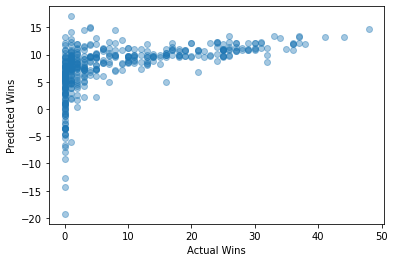

Train score for predicting Winnings from BreakPointsSaved and TotalPointsWon: 0.1881430363903669
Test score for predicting Winnings from BreakPointsSaved and TotalPointsWon: 0.18041856897758424 



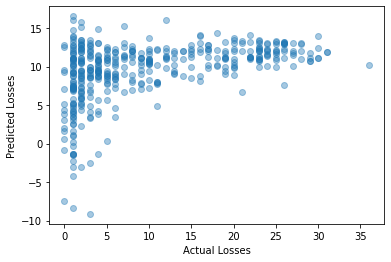

Train score for predicting Winnings from BreakPointsSaved and TotalPointsWon: 0.2240111306280883
Test score for predicting Winnings from BreakPointsSaved and TotalPointsWon: 0.18255690620917642 



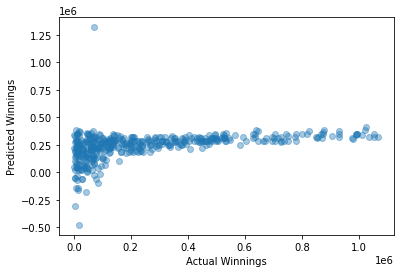

Train score for predicting Winnings from BreakPointsSaved and TotalPointsWon: 0.07825203129438985
Test score for predicting Winnings from BreakPointsSaved and TotalPointsWon: 0.05227192336240394 



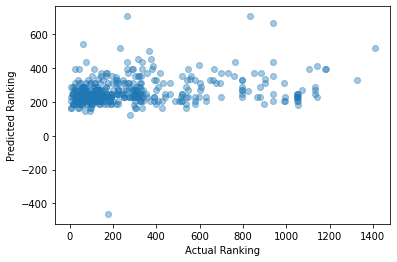

Train score for predicting Winnings from BreakPointsSaved and TotalServicePointsWon: 0.15730989632450798
Test score for predicting Winnings from BreakPointsSaved and TotalServicePointsWon: 0.18351904180402245 



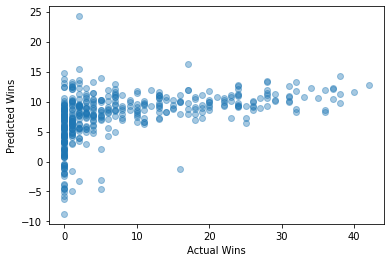

Train score for predicting Winnings from BreakPointsSaved and TotalServicePointsWon: 0.14091830790485205
Test score for predicting Winnings from BreakPointsSaved and TotalServicePointsWon: 0.15051726481850058 



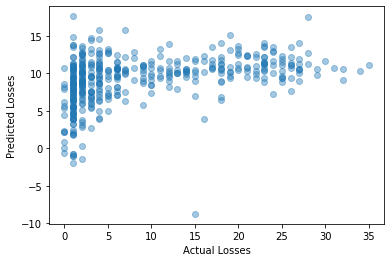

Train score for predicting Winnings from BreakPointsSaved and TotalServicePointsWon: 0.17119819066753628
Test score for predicting Winnings from BreakPointsSaved and TotalServicePointsWon: 0.16980382142056671 



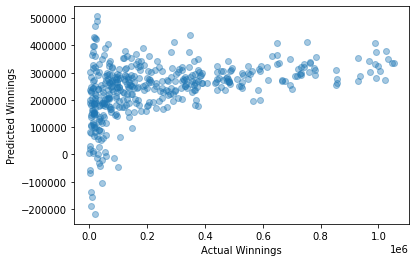

Train score for predicting Winnings from BreakPointsSaved and TotalServicePointsWon: 0.05021707657872776
Test score for predicting Winnings from BreakPointsSaved and TotalServicePointsWon: 0.02184026718195997 



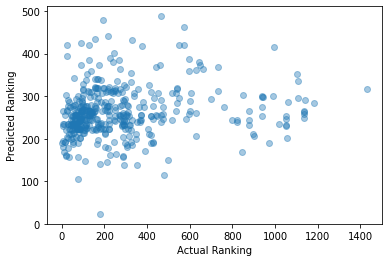

Train score for predicting Winnings from DoubleFaults and FirstServe: 0.7432496678749393
Test score for predicting Winnings from DoubleFaults and FirstServe: 0.6649645896851462 



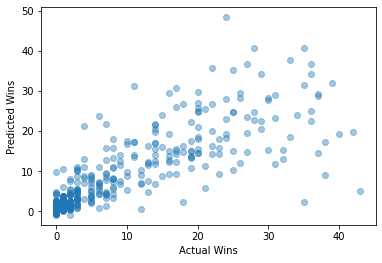

Train score for predicting Winnings from DoubleFaults and FirstServe: 0.7867624457535433
Test score for predicting Winnings from DoubleFaults and FirstServe: 0.7617319535905325 



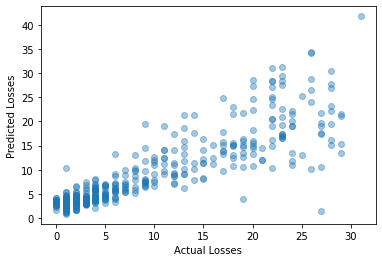

Train score for predicting Winnings from DoubleFaults and FirstServe: 0.7310050054092383
Test score for predicting Winnings from DoubleFaults and FirstServe: 0.7445224873066533 



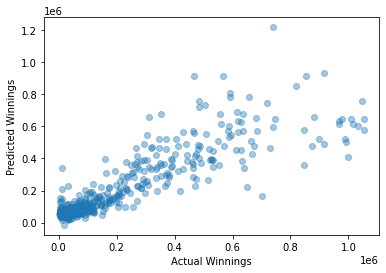

Train score for predicting Winnings from DoubleFaults and FirstServe: 0.09476631401439593
Test score for predicting Winnings from DoubleFaults and FirstServe: 0.10483921059223211 



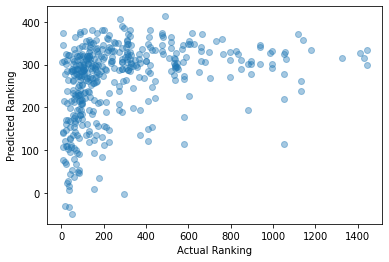

Train score for predicting Winnings from DoubleFaults and FirstServePointsWon: 0.7231460130643839
Test score for predicting Winnings from DoubleFaults and FirstServePointsWon: 0.7106569427587455 



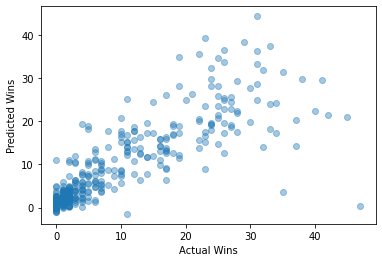

Train score for predicting Winnings from DoubleFaults and FirstServePointsWon: 0.7722873446181381
Test score for predicting Winnings from DoubleFaults and FirstServePointsWon: 0.7925825754546965 



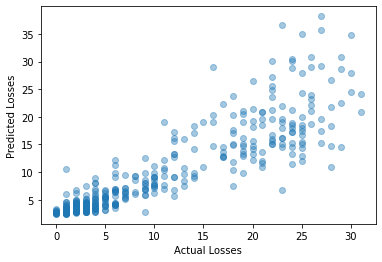

Train score for predicting Winnings from DoubleFaults and FirstServePointsWon: 0.7499152846008734
Test score for predicting Winnings from DoubleFaults and FirstServePointsWon: 0.6859544381982401 



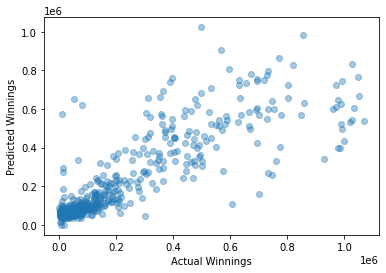

Train score for predicting Winnings from DoubleFaults and FirstServePointsWon: 0.09699281613778243
Test score for predicting Winnings from DoubleFaults and FirstServePointsWon: 0.08900639641388353 



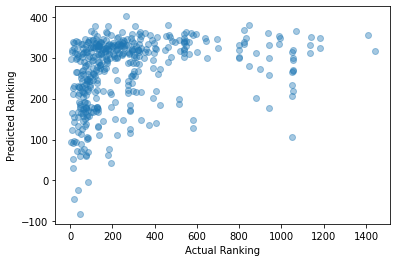

Train score for predicting Winnings from DoubleFaults and FirstServeReturnPointsWon: 0.7318669593553591
Test score for predicting Winnings from DoubleFaults and FirstServeReturnPointsWon: 0.6890892031499736 



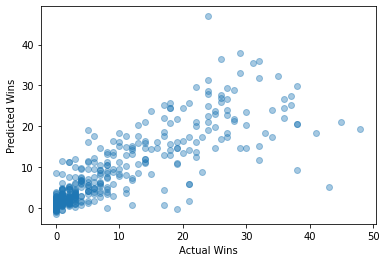

Train score for predicting Winnings from DoubleFaults and FirstServeReturnPointsWon: 0.7866369362373699
Test score for predicting Winnings from DoubleFaults and FirstServeReturnPointsWon: 0.7487788889325262 



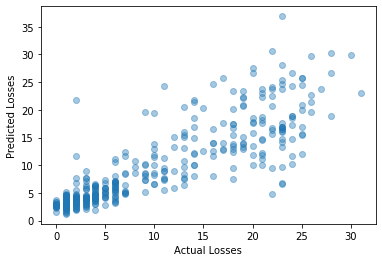

Train score for predicting Winnings from DoubleFaults and FirstServeReturnPointsWon: 0.7322309196849413
Test score for predicting Winnings from DoubleFaults and FirstServeReturnPointsWon: 0.7291737400710063 



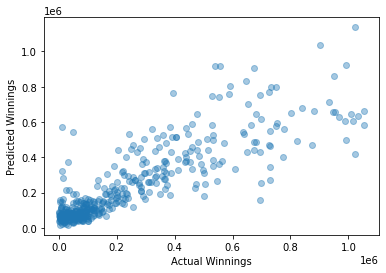

Train score for predicting Winnings from DoubleFaults and FirstServeReturnPointsWon: 0.1024255673067913
Test score for predicting Winnings from DoubleFaults and FirstServeReturnPointsWon: 0.11306603806356508 



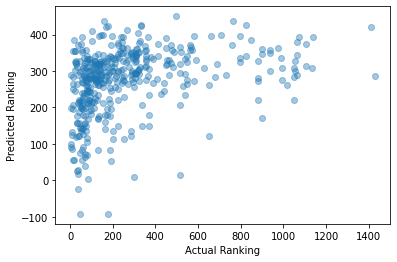

Train score for predicting Winnings from DoubleFaults and SecondServePointsWon: 0.7402141308364086
Test score for predicting Winnings from DoubleFaults and SecondServePointsWon: 0.6747146654967751 



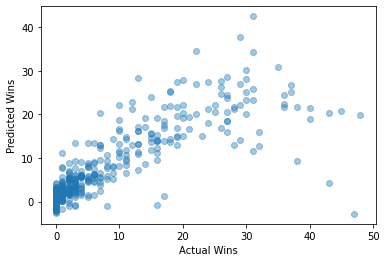

Train score for predicting Winnings from DoubleFaults and SecondServePointsWon: 0.7834683029227542
Test score for predicting Winnings from DoubleFaults and SecondServePointsWon: 0.7670175737523937 



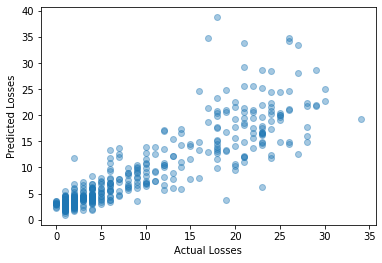

Train score for predicting Winnings from DoubleFaults and SecondServePointsWon: 0.7265383308672231
Test score for predicting Winnings from DoubleFaults and SecondServePointsWon: 0.7604959231629187 



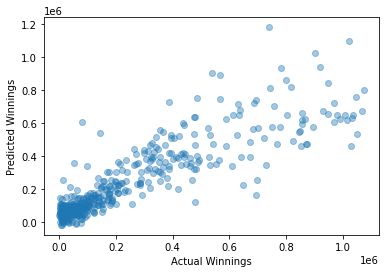

Train score for predicting Winnings from DoubleFaults and SecondServePointsWon: 0.10139369978276713
Test score for predicting Winnings from DoubleFaults and SecondServePointsWon: 0.1203533458111451 



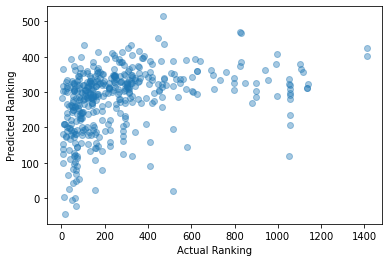

Train score for predicting Winnings from DoubleFaults and SecondServeReturnPointsWon: 0.7057185118561629
Test score for predicting Winnings from DoubleFaults and SecondServeReturnPointsWon: 0.7630736373805971 



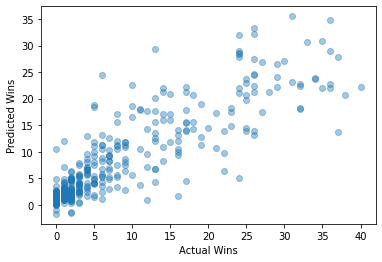

Train score for predicting Winnings from DoubleFaults and SecondServeReturnPointsWon: 0.7771836114457954
Test score for predicting Winnings from DoubleFaults and SecondServeReturnPointsWon: 0.7798827986013935 



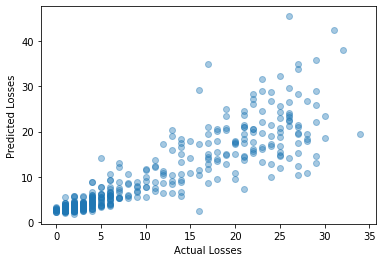

Train score for predicting Winnings from DoubleFaults and SecondServeReturnPointsWon: 0.7343190914582564
Test score for predicting Winnings from DoubleFaults and SecondServeReturnPointsWon: 0.7223838634940025 



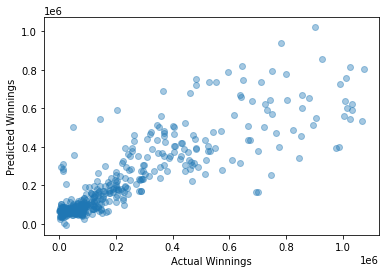

Train score for predicting Winnings from DoubleFaults and SecondServeReturnPointsWon: 0.10369135678165321
Test score for predicting Winnings from DoubleFaults and SecondServeReturnPointsWon: 0.10486047325949432 



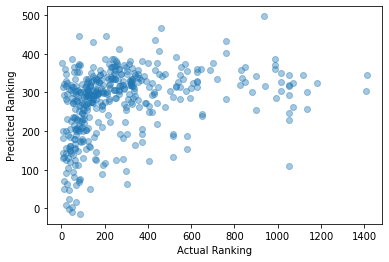

Train score for predicting Winnings from DoubleFaults and Aces: 0.7632068032753185
Test score for predicting Winnings from DoubleFaults and Aces: 0.7863043812163513 



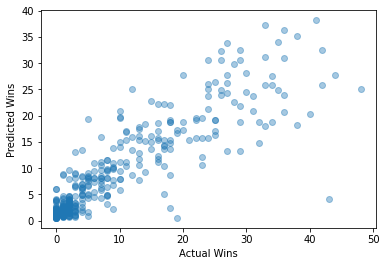

Train score for predicting Winnings from DoubleFaults and Aces: 0.7882704949929935
Test score for predicting Winnings from DoubleFaults and Aces: 0.7705822962160622 



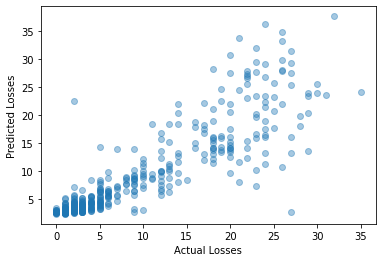

Train score for predicting Winnings from DoubleFaults and Aces: 0.7615355582183023
Test score for predicting Winnings from DoubleFaults and Aces: 0.7527278810544578 



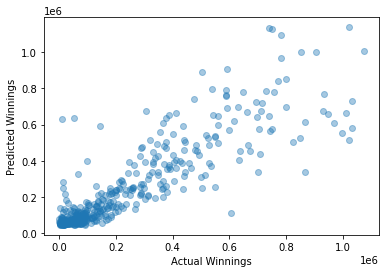

Train score for predicting Winnings from DoubleFaults and Aces: 0.09633937601642739
Test score for predicting Winnings from DoubleFaults and Aces: 0.09350533503098157 



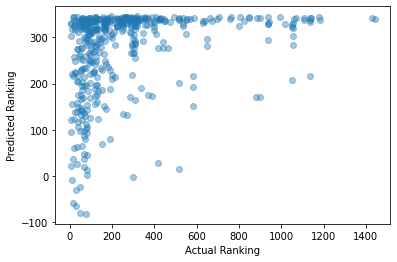

Train score for predicting Winnings from DoubleFaults and BreakPointsConverted: 0.7345527981800977
Test score for predicting Winnings from DoubleFaults and BreakPointsConverted: 0.6727870679353245 



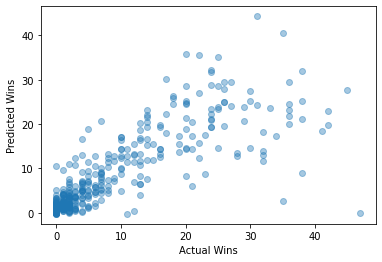

Train score for predicting Winnings from DoubleFaults and BreakPointsConverted: 0.7809717722412832
Test score for predicting Winnings from DoubleFaults and BreakPointsConverted: 0.7666688278674069 



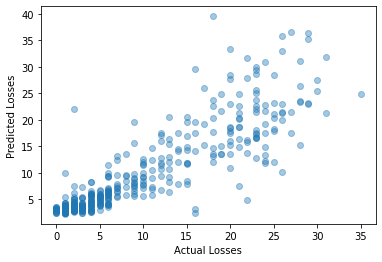

Train score for predicting Winnings from DoubleFaults and BreakPointsConverted: 0.7197007858347984
Test score for predicting Winnings from DoubleFaults and BreakPointsConverted: 0.760309702695822 



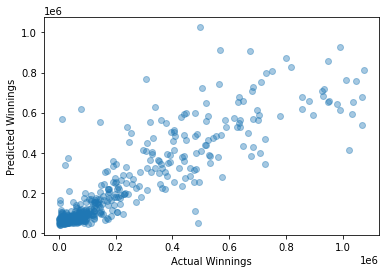

Train score for predicting Winnings from DoubleFaults and BreakPointsConverted: 0.08709025580376262
Test score for predicting Winnings from DoubleFaults and BreakPointsConverted: 0.11609572541568991 



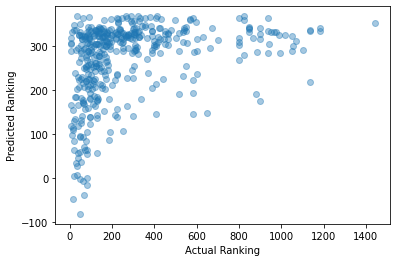

Train score for predicting Winnings from DoubleFaults and BreakPointsFaced: 0.7896696638287333
Test score for predicting Winnings from DoubleFaults and BreakPointsFaced: 0.7859630367269007 



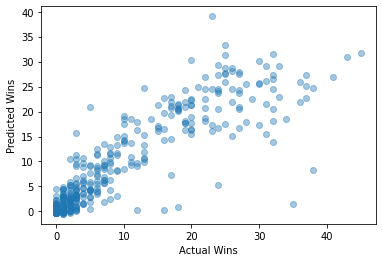

Train score for predicting Winnings from DoubleFaults and BreakPointsFaced: 0.8894857788589275
Test score for predicting Winnings from DoubleFaults and BreakPointsFaced: 0.8963899818942581 



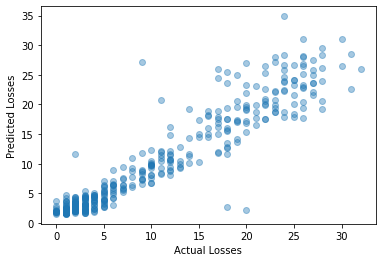

Train score for predicting Winnings from DoubleFaults and BreakPointsFaced: 0.7690123129029333
Test score for predicting Winnings from DoubleFaults and BreakPointsFaced: 0.8159140974103373 



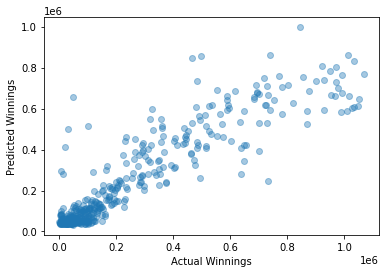

Train score for predicting Winnings from DoubleFaults and BreakPointsFaced: 0.10289525744073802
Test score for predicting Winnings from DoubleFaults and BreakPointsFaced: 0.10809322023876056 



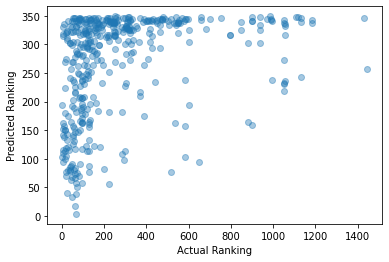

Train score for predicting Winnings from DoubleFaults and BreakPointsOpportunities: 0.8763391299454243
Test score for predicting Winnings from DoubleFaults and BreakPointsOpportunities: 0.7798326240173183 



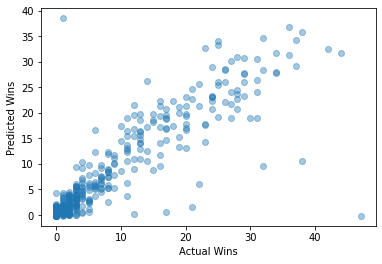

Train score for predicting Winnings from DoubleFaults and BreakPointsOpportunities: 0.8475405542563197
Test score for predicting Winnings from DoubleFaults and BreakPointsOpportunities: 0.8374866252066866 



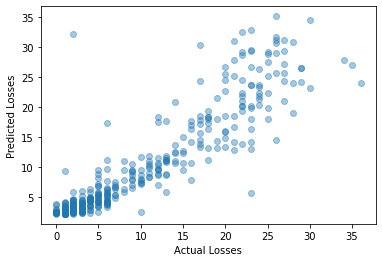

Train score for predicting Winnings from DoubleFaults and BreakPointsOpportunities: 0.8151433672356654
Test score for predicting Winnings from DoubleFaults and BreakPointsOpportunities: 0.8312128664943315 



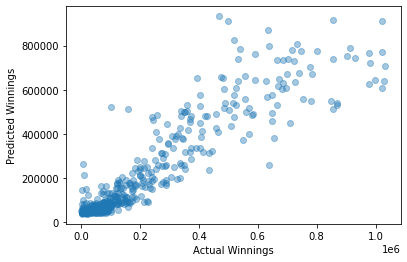

Train score for predicting Winnings from DoubleFaults and BreakPointsOpportunities: 0.11722727500525008
Test score for predicting Winnings from DoubleFaults and BreakPointsOpportunities: 0.09632325119478247 



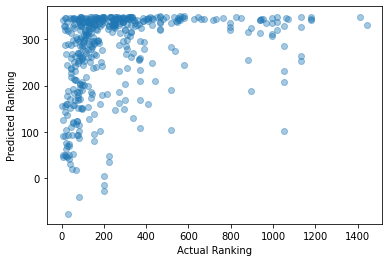

Train score for predicting Winnings from DoubleFaults and BreakPointsSaved: 0.7273626028069816
Test score for predicting Winnings from DoubleFaults and BreakPointsSaved: 0.6953448828738458 



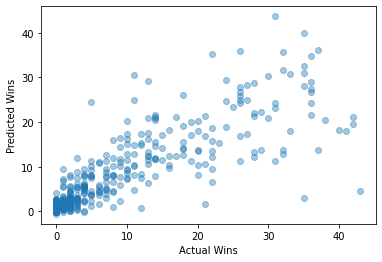

Train score for predicting Winnings from DoubleFaults and BreakPointsSaved: 0.7787267879925721
Test score for predicting Winnings from DoubleFaults and BreakPointsSaved: 0.7757344463287318 



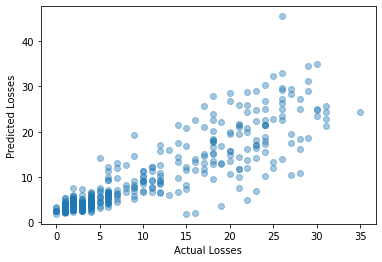

Train score for predicting Winnings from DoubleFaults and BreakPointsSaved: 0.7283428506011331
Test score for predicting Winnings from DoubleFaults and BreakPointsSaved: 0.7415301172624449 



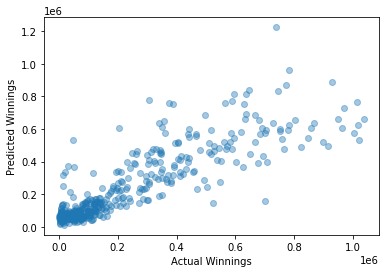

Train score for predicting Winnings from DoubleFaults and BreakPointsSaved: 0.09052328596953763
Test score for predicting Winnings from DoubleFaults and BreakPointsSaved: 0.09953855883391516 



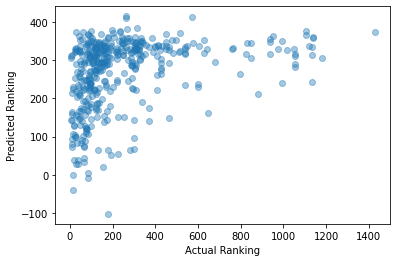

Train score for predicting Winnings from DoubleFaults and ReturnGamesPlayed: 0.8640190091539148
Test score for predicting Winnings from DoubleFaults and ReturnGamesPlayed: 0.8596327233248536 



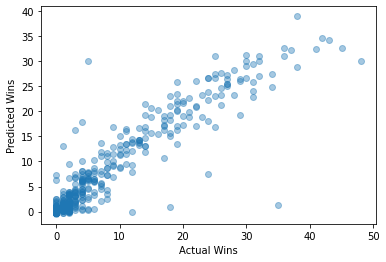

Train score for predicting Winnings from DoubleFaults and ReturnGamesPlayed: 0.8867265004384843
Test score for predicting Winnings from DoubleFaults and ReturnGamesPlayed: 0.8514319342024934 



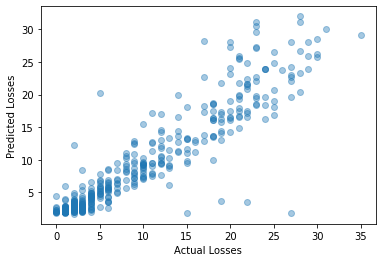

Train score for predicting Winnings from DoubleFaults and ReturnGamesPlayed: 0.825892195514112
Test score for predicting Winnings from DoubleFaults and ReturnGamesPlayed: 0.8540421378018203 



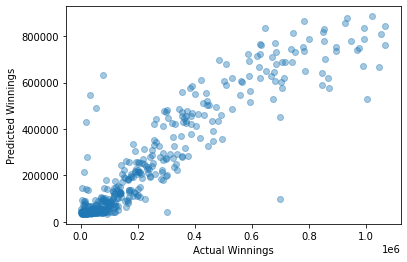

Train score for predicting Winnings from DoubleFaults and ReturnGamesPlayed: 0.11447383871128702
Test score for predicting Winnings from DoubleFaults and ReturnGamesPlayed: 0.08633545379567464 



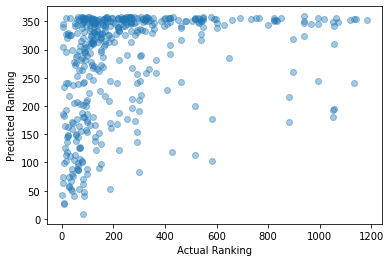

Train score for predicting Winnings from DoubleFaults and ReturnGamesWon: 0.7138795390738562
Test score for predicting Winnings from DoubleFaults and ReturnGamesWon: 0.7430913389175771 



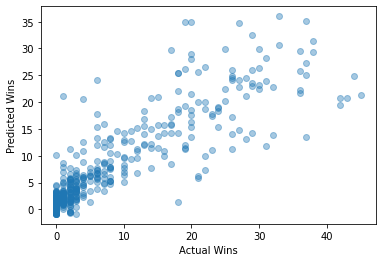

Train score for predicting Winnings from DoubleFaults and ReturnGamesWon: 0.7831677555533227
Test score for predicting Winnings from DoubleFaults and ReturnGamesWon: 0.7629380165750556 



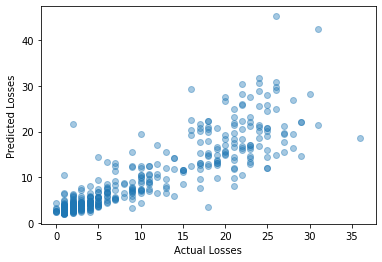

Train score for predicting Winnings from DoubleFaults and ReturnGamesWon: 0.7343866248416098
Test score for predicting Winnings from DoubleFaults and ReturnGamesWon: 0.7259818262371571 



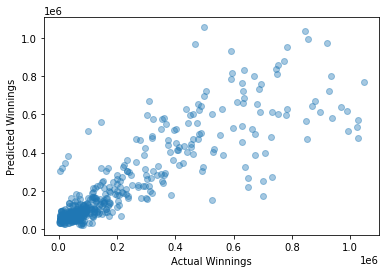

Train score for predicting Winnings from DoubleFaults and ReturnGamesWon: 0.1179828766350076
Test score for predicting Winnings from DoubleFaults and ReturnGamesWon: 0.06690651629341349 



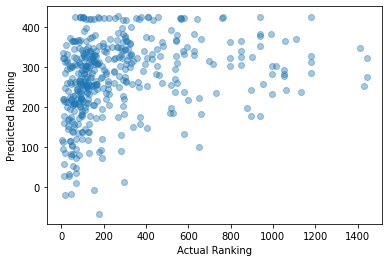

Train score for predicting Winnings from DoubleFaults and ReturnPointsWon: 0.736001059946805
Test score for predicting Winnings from DoubleFaults and ReturnPointsWon: 0.6729133384969841 



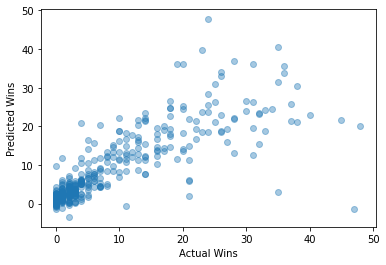

Train score for predicting Winnings from DoubleFaults and ReturnPointsWon: 0.7703261624067397
Test score for predicting Winnings from DoubleFaults and ReturnPointsWon: 0.8005256555029847 



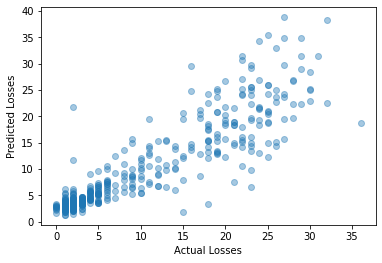

Train score for predicting Winnings from DoubleFaults and ReturnPointsWon: 0.7309117356663354
Test score for predicting Winnings from DoubleFaults and ReturnPointsWon: 0.7358457915323702 



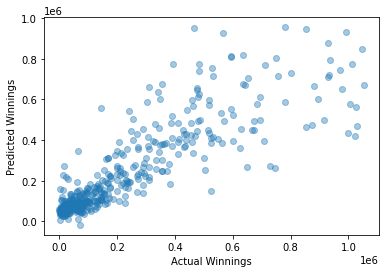

Train score for predicting Winnings from DoubleFaults and ReturnPointsWon: 0.10771676889682913
Test score for predicting Winnings from DoubleFaults and ReturnPointsWon: 0.10591806184512242 



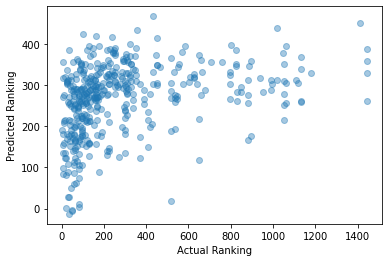

Train score for predicting Winnings from DoubleFaults and ServiceGamesPlayed: 0.8638292198327919
Test score for predicting Winnings from DoubleFaults and ServiceGamesPlayed: 0.866438149460941 



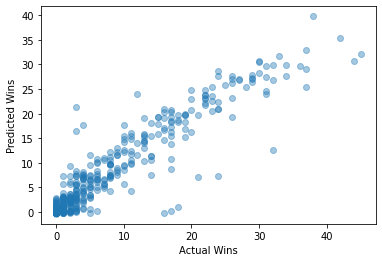

Train score for predicting Winnings from DoubleFaults and ServiceGamesPlayed: 0.881695299611852
Test score for predicting Winnings from DoubleFaults and ServiceGamesPlayed: 0.8577995422181178 



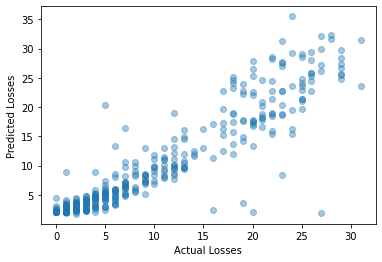

Train score for predicting Winnings from DoubleFaults and ServiceGamesPlayed: 0.8387518567497917
Test score for predicting Winnings from DoubleFaults and ServiceGamesPlayed: 0.8200302276658793 



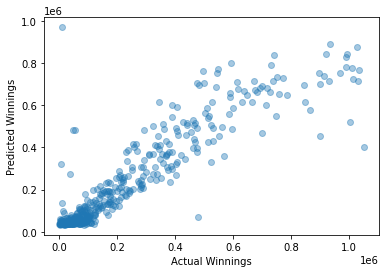

Train score for predicting Winnings from DoubleFaults and ServiceGamesPlayed: 0.10394403590944257
Test score for predicting Winnings from DoubleFaults and ServiceGamesPlayed: 0.12300033630484786 



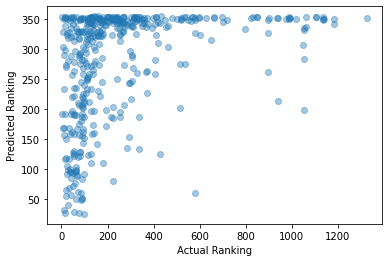

Train score for predicting Winnings from DoubleFaults and ServiceGamesWon: 0.7121866874200359
Test score for predicting Winnings from DoubleFaults and ServiceGamesWon: 0.7585453840906009 



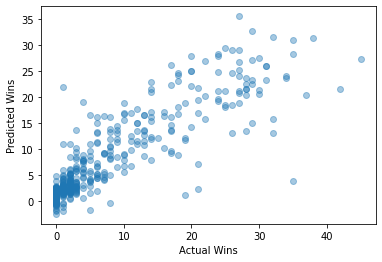

Train score for predicting Winnings from DoubleFaults and ServiceGamesWon: 0.7889387584608564
Test score for predicting Winnings from DoubleFaults and ServiceGamesWon: 0.7493209170650343 



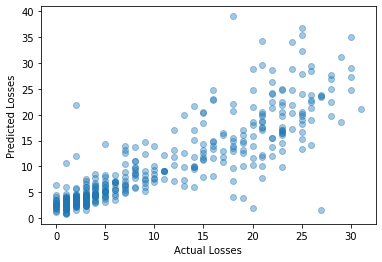

Train score for predicting Winnings from DoubleFaults and ServiceGamesWon: 0.7390715472475862
Test score for predicting Winnings from DoubleFaults and ServiceGamesWon: 0.725873218611138 



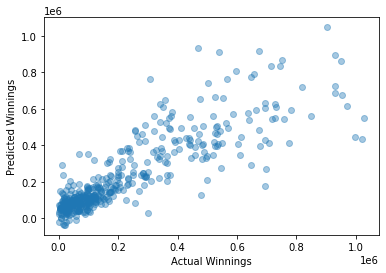

Train score for predicting Winnings from DoubleFaults and ServiceGamesWon: 0.09641606556180647
Test score for predicting Winnings from DoubleFaults and ServiceGamesWon: 0.11258747142663572 



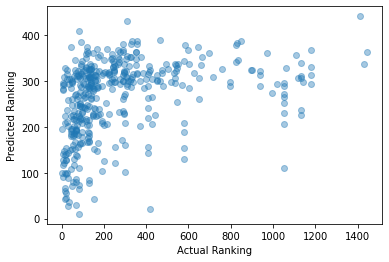

Train score for predicting Winnings from DoubleFaults and TotalPointsWon: 0.737786111182213
Test score for predicting Winnings from DoubleFaults and TotalPointsWon: 0.6947475157498134 



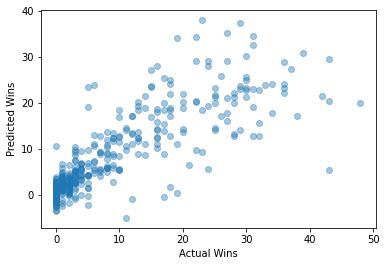

Train score for predicting Winnings from DoubleFaults and TotalPointsWon: 0.7675679472578446
Test score for predicting Winnings from DoubleFaults and TotalPointsWon: 0.8094709203168439 



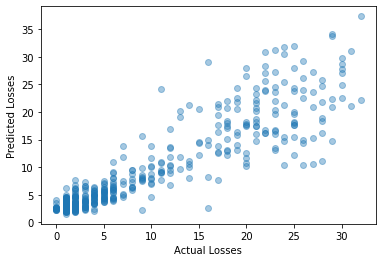

Train score for predicting Winnings from DoubleFaults and TotalPointsWon: 0.7366983078531502
Test score for predicting Winnings from DoubleFaults and TotalPointsWon: 0.7429032877972916 



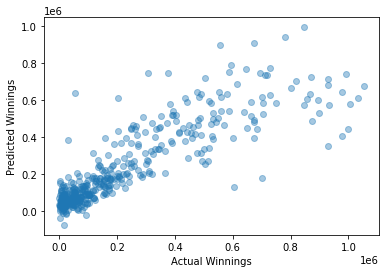

Train score for predicting Winnings from DoubleFaults and TotalPointsWon: 0.12646091183264008
Test score for predicting Winnings from DoubleFaults and TotalPointsWon: 0.0854086371821775 



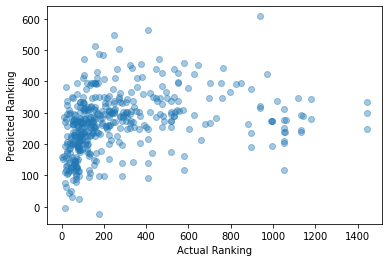

Train score for predicting Winnings from DoubleFaults and TotalServicePointsWon: 0.7100667523411843
Test score for predicting Winnings from DoubleFaults and TotalServicePointsWon: 0.7652684251570272 



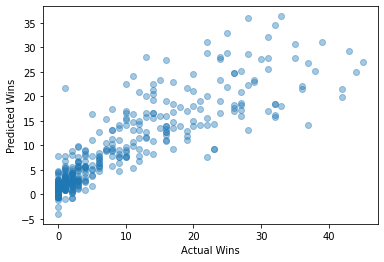

Train score for predicting Winnings from DoubleFaults and TotalServicePointsWon: 0.7913411524660282
Test score for predicting Winnings from DoubleFaults and TotalServicePointsWon: 0.7420370844765558 



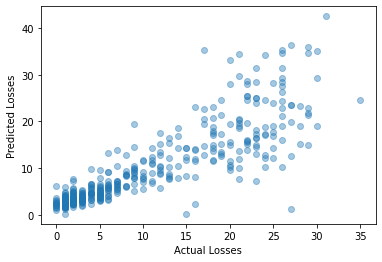

Train score for predicting Winnings from DoubleFaults and TotalServicePointsWon: 0.7392729010265143
Test score for predicting Winnings from DoubleFaults and TotalServicePointsWon: 0.732701662437902 



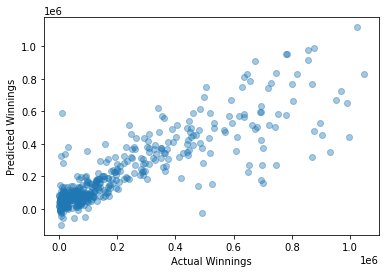

Train score for predicting Winnings from DoubleFaults and TotalServicePointsWon: 0.10007573994640917
Test score for predicting Winnings from DoubleFaults and TotalServicePointsWon: 0.11178483671918105 



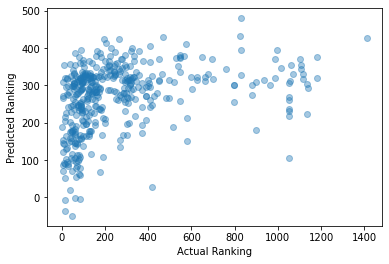

Train score for predicting Winnings from ReturnGamesPlayed and FirstServe: 0.8443130211683674
Test score for predicting Winnings from ReturnGamesPlayed and FirstServe: 0.9156164037095178 



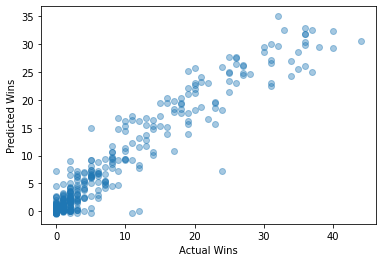

Train score for predicting Winnings from ReturnGamesPlayed and FirstServe: 0.8901529830690855
Test score for predicting Winnings from ReturnGamesPlayed and FirstServe: 0.8422390333019496 



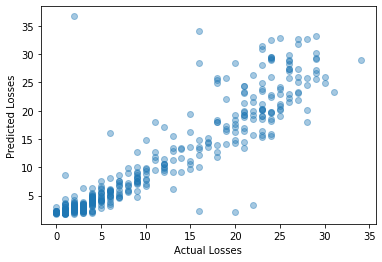

Train score for predicting Winnings from ReturnGamesPlayed and FirstServe: 0.8462007458905608
Test score for predicting Winnings from ReturnGamesPlayed and FirstServe: 0.7932122805430455 



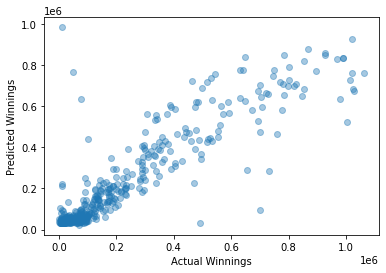

Train score for predicting Winnings from ReturnGamesPlayed and FirstServe: 0.10902515932287617
Test score for predicting Winnings from ReturnGamesPlayed and FirstServe: 0.1205019871664923 



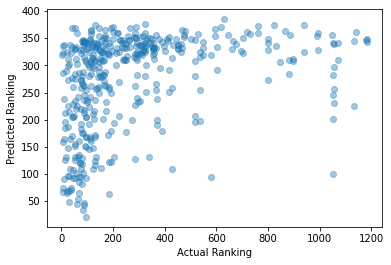

Train score for predicting Winnings from ReturnGamesPlayed and FirstServePointsWon: 0.8747370068064515
Test score for predicting Winnings from ReturnGamesPlayed and FirstServePointsWon: 0.8224934628902935 



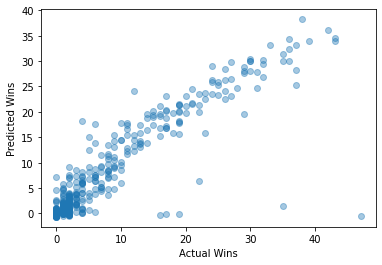

Train score for predicting Winnings from ReturnGamesPlayed and FirstServePointsWon: 0.880433817804483
Test score for predicting Winnings from ReturnGamesPlayed and FirstServePointsWon: 0.8706374574598057 



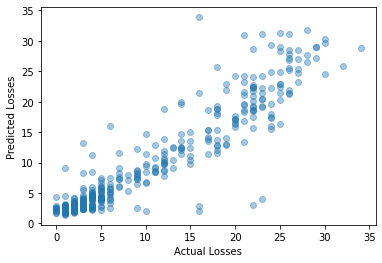

Train score for predicting Winnings from ReturnGamesPlayed and FirstServePointsWon: 0.8358124274571643
Test score for predicting Winnings from ReturnGamesPlayed and FirstServePointsWon: 0.8242178822186759 



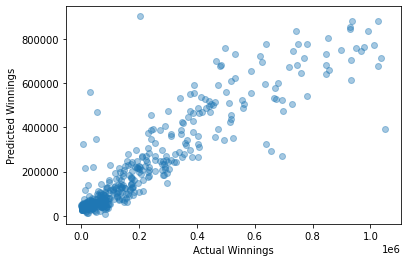

Train score for predicting Winnings from ReturnGamesPlayed and FirstServePointsWon: 0.10829110000877062
Test score for predicting Winnings from ReturnGamesPlayed and FirstServePointsWon: 0.11333764337166674 



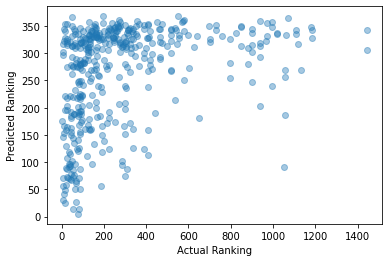

Train score for predicting Winnings from ReturnGamesPlayed and FirstServeReturnPointsWon: 0.8591545366947814
Test score for predicting Winnings from ReturnGamesPlayed and FirstServeReturnPointsWon: 0.8718087483785468 



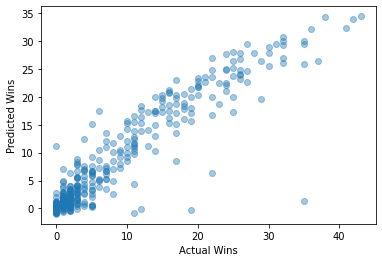

Train score for predicting Winnings from ReturnGamesPlayed and FirstServeReturnPointsWon: 0.874241778773237
Test score for predicting Winnings from ReturnGamesPlayed and FirstServeReturnPointsWon: 0.887726607232918 



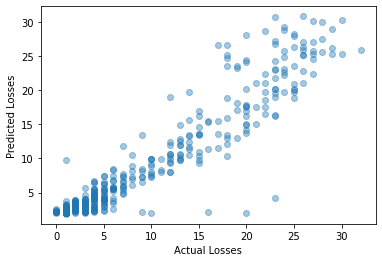

Train score for predicting Winnings from ReturnGamesPlayed and FirstServeReturnPointsWon: 0.836838494475111
Test score for predicting Winnings from ReturnGamesPlayed and FirstServeReturnPointsWon: 0.8206673475423438 



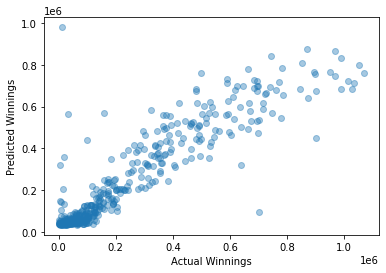

Train score for predicting Winnings from ReturnGamesPlayed and FirstServeReturnPointsWon: 0.11137340512293026
Test score for predicting Winnings from ReturnGamesPlayed and FirstServeReturnPointsWon: 0.13849086512307185 



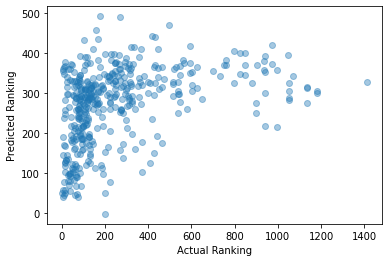

Train score for predicting Winnings from ReturnGamesPlayed and SecondServePointsWon: 0.8646274446493794
Test score for predicting Winnings from ReturnGamesPlayed and SecondServePointsWon: 0.8522897629759657 



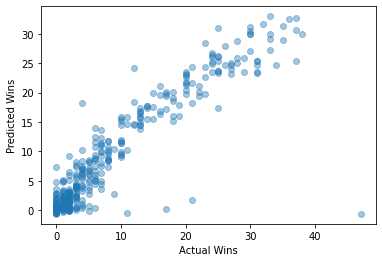

Train score for predicting Winnings from ReturnGamesPlayed and SecondServePointsWon: 0.8820617697938107
Test score for predicting Winnings from ReturnGamesPlayed and SecondServePointsWon: 0.8661333134974778 



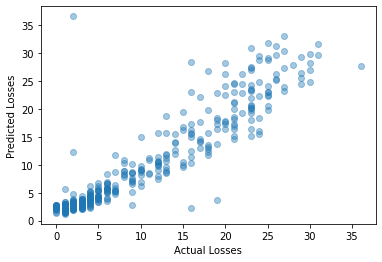

Train score for predicting Winnings from ReturnGamesPlayed and SecondServePointsWon: 0.826106789248719
Test score for predicting Winnings from ReturnGamesPlayed and SecondServePointsWon: 0.8530462380501764 



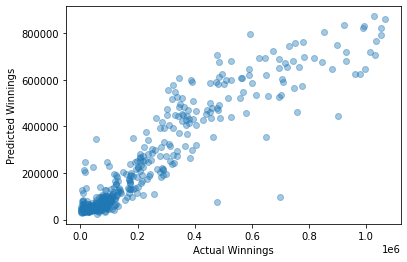

Train score for predicting Winnings from ReturnGamesPlayed and SecondServePointsWon: 0.11998009381180208
Test score for predicting Winnings from ReturnGamesPlayed and SecondServePointsWon: 0.10876778771899465 



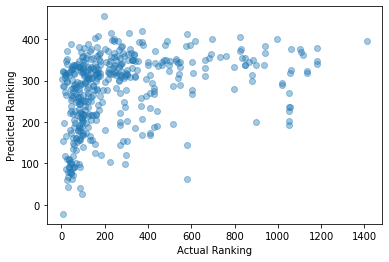

Train score for predicting Winnings from ReturnGamesPlayed and SecondServeReturnPointsWon: 0.8534766132742833
Test score for predicting Winnings from ReturnGamesPlayed and SecondServeReturnPointsWon: 0.8825392445518365 



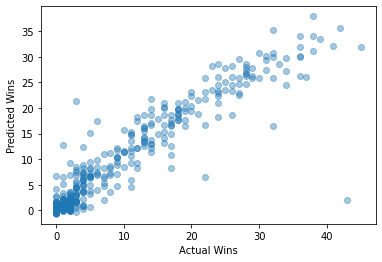

Train score for predicting Winnings from ReturnGamesPlayed and SecondServeReturnPointsWon: 0.8699670611908974
Test score for predicting Winnings from ReturnGamesPlayed and SecondServeReturnPointsWon: 0.8986908555283769 



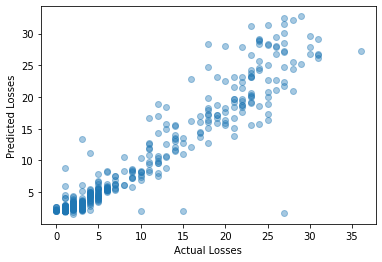

Train score for predicting Winnings from ReturnGamesPlayed and SecondServeReturnPointsWon: 0.83616023302043
Test score for predicting Winnings from ReturnGamesPlayed and SecondServeReturnPointsWon: 0.8223063730199242 



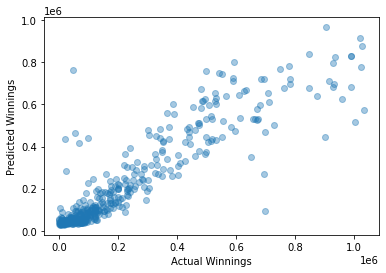

Train score for predicting Winnings from ReturnGamesPlayed and SecondServeReturnPointsWon: 0.11815355080420697
Test score for predicting Winnings from ReturnGamesPlayed and SecondServeReturnPointsWon: 0.11760788174932835 



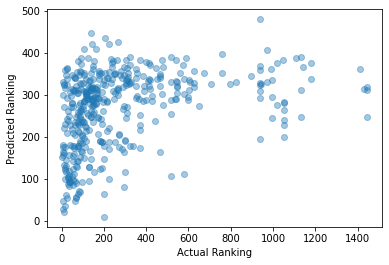

Train score for predicting Winnings from ReturnGamesPlayed and Aces: 0.8736096283086644
Test score for predicting Winnings from ReturnGamesPlayed and Aces: 0.8329446604676928 



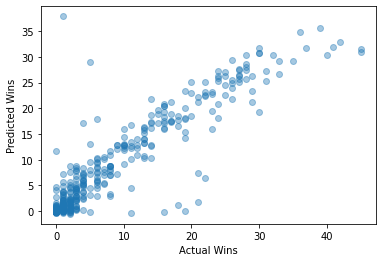

Train score for predicting Winnings from ReturnGamesPlayed and Aces: 0.8948382106187792
Test score for predicting Winnings from ReturnGamesPlayed and Aces: 0.8511658713833821 



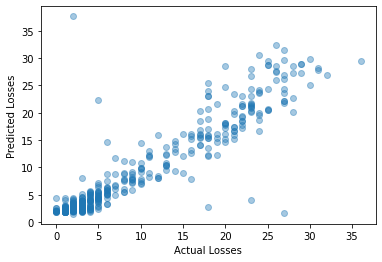

Train score for predicting Winnings from ReturnGamesPlayed and Aces: 0.8220143093993288
Test score for predicting Winnings from ReturnGamesPlayed and Aces: 0.863696649109566 



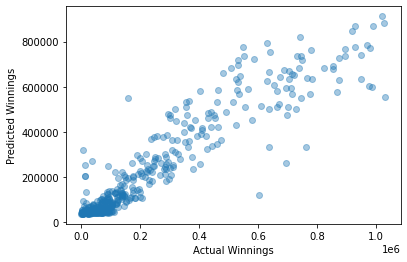

Train score for predicting Winnings from ReturnGamesPlayed and Aces: 0.10657852011089565
Test score for predicting Winnings from ReturnGamesPlayed and Aces: 0.11982637317772549 



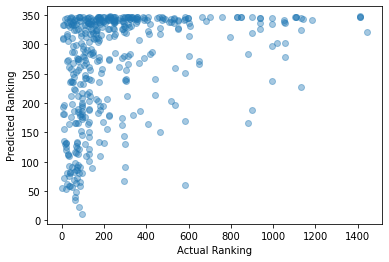

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsConverted: 0.8500133418039969
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsConverted: 0.8986915293785932 



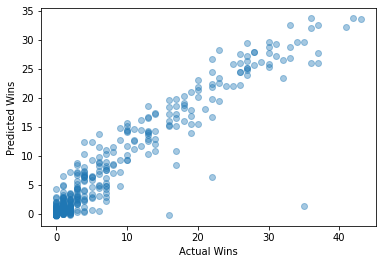

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsConverted: 0.8878833806924717
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsConverted: 0.847023476842912 



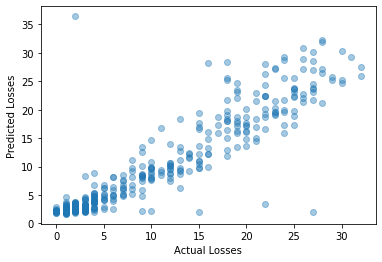

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsConverted: 0.8340834949194071
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsConverted: 0.8270756263012323 



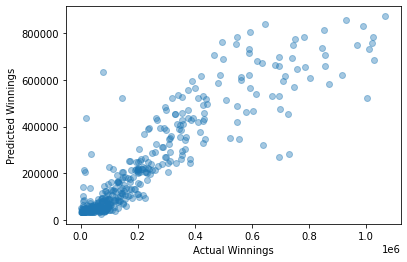

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsConverted: 0.09913279269815045
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsConverted: 0.13754467573254325 



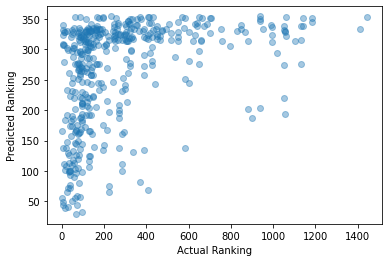

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsFaced: 0.855663989169016
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsFaced: 0.9075231079099538 



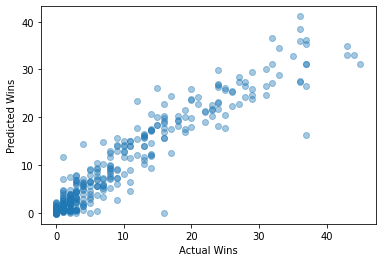

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsFaced: 0.882991397071086
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsFaced: 0.9327738778045163 



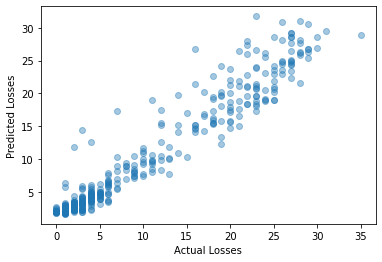

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsFaced: 0.8264931049749551
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsFaced: 0.8658462181812963 



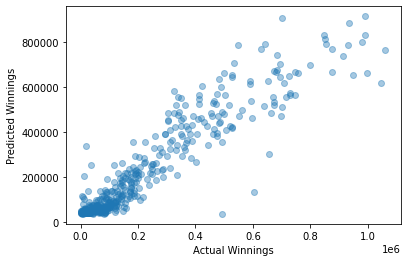

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsFaced: 0.10998788287189953
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsFaced: 0.10728355870553907 



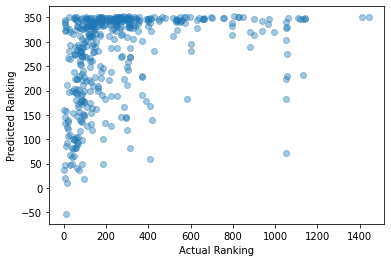

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsOpportunities: 0.862076064788753
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsOpportunities: 0.8780986305993611 



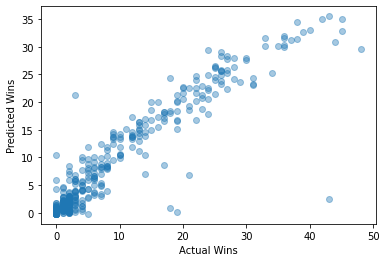

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsOpportunities: 0.8846914226145003
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsOpportunities: 0.8550166448666854 



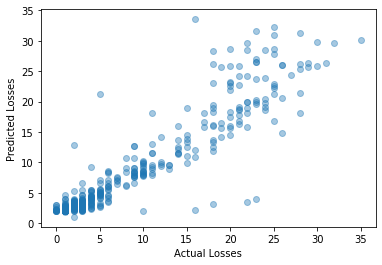

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsOpportunities: 0.8346339915967483
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsOpportunities: 0.8306424055123277 



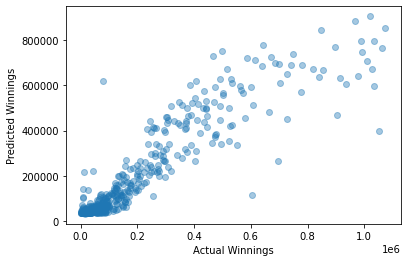

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsOpportunities: 0.11381046502622116
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsOpportunities: 0.10743039679752797 



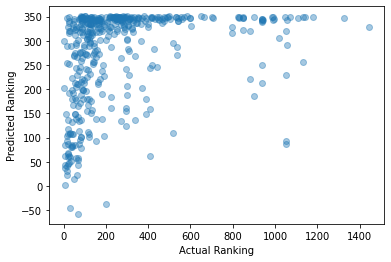

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsSaved: 0.8530560974427653
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsSaved: 0.8885670199903543 



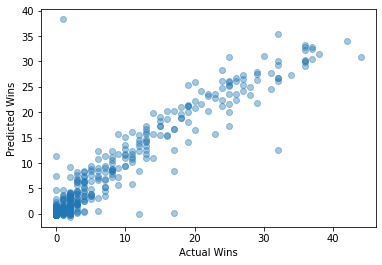

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsSaved: 0.875491694068541
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsSaved: 0.8841568484472871 



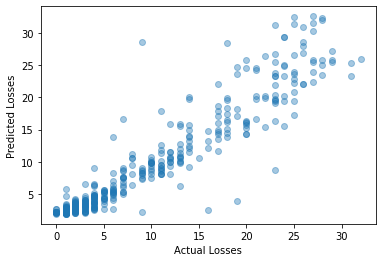

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsSaved: 0.8282152704435881
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsSaved: 0.8465906125449336 



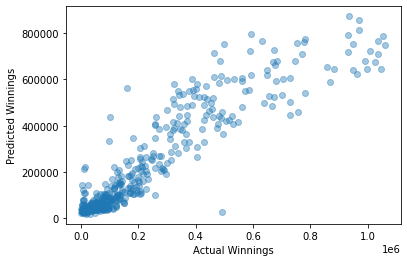

Train score for predicting Winnings from ReturnGamesPlayed and BreakPointsSaved: 0.11224913468170694
Test score for predicting Winnings from ReturnGamesPlayed and BreakPointsSaved: 0.10612036102245703 



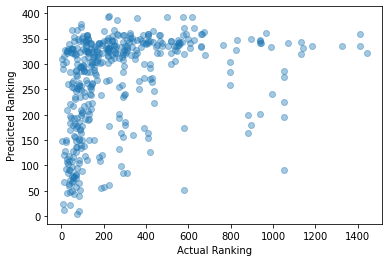

Train score for predicting Winnings from ReturnGamesPlayed and DoubleFaults: 0.8506864633184524
Test score for predicting Winnings from ReturnGamesPlayed and DoubleFaults: 0.9014325006771963 



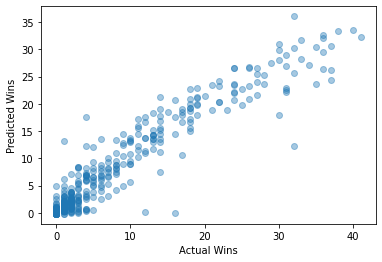

Train score for predicting Winnings from ReturnGamesPlayed and DoubleFaults: 0.8765354790390566
Test score for predicting Winnings from ReturnGamesPlayed and DoubleFaults: 0.8867202183949189 



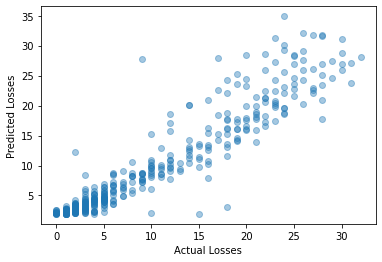

Train score for predicting Winnings from ReturnGamesPlayed and DoubleFaults: 0.8215866524864504
Test score for predicting Winnings from ReturnGamesPlayed and DoubleFaults: 0.8645313061621949 



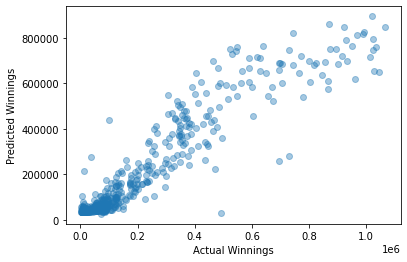

Train score for predicting Winnings from ReturnGamesPlayed and DoubleFaults: 0.1079294935184063
Test score for predicting Winnings from ReturnGamesPlayed and DoubleFaults: 0.11566910934689945 



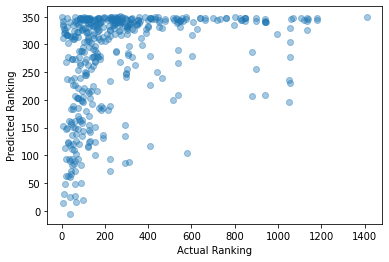

Train score for predicting Winnings from ReturnGamesPlayed and ReturnGamesWon: 0.8718740083504233
Test score for predicting Winnings from ReturnGamesPlayed and ReturnGamesWon: 0.8325492204681315 



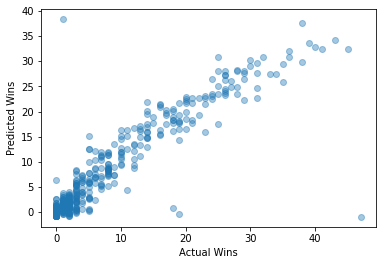

Train score for predicting Winnings from ReturnGamesPlayed and ReturnGamesWon: 0.8825665437151183
Test score for predicting Winnings from ReturnGamesPlayed and ReturnGamesWon: 0.8621889473046146 



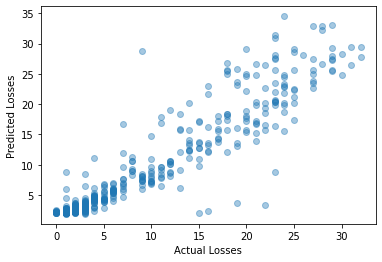

Train score for predicting Winnings from ReturnGamesPlayed and ReturnGamesWon: 0.8223097916931231
Test score for predicting Winnings from ReturnGamesPlayed and ReturnGamesWon: 0.8597968246215444 



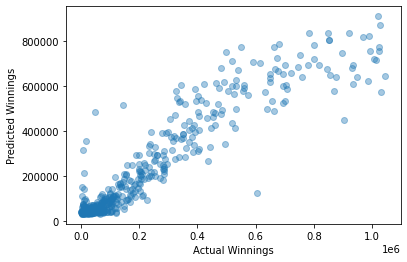

Train score for predicting Winnings from ReturnGamesPlayed and ReturnGamesWon: 0.12406396092865157
Test score for predicting Winnings from ReturnGamesPlayed and ReturnGamesWon: 0.10119720997648873 



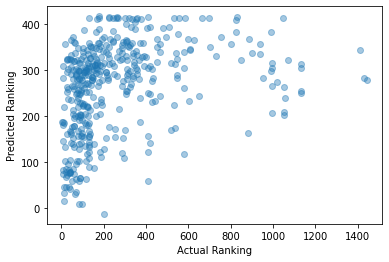

Train score for predicting Winnings from ReturnGamesPlayed and ReturnPointsWon: 0.8804927858672703
Test score for predicting Winnings from ReturnGamesPlayed and ReturnPointsWon: 0.8025848313368238 



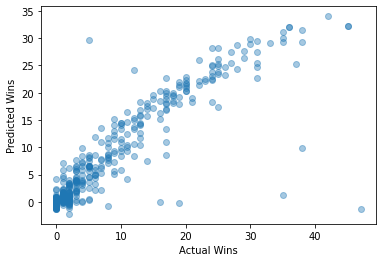

Train score for predicting Winnings from ReturnGamesPlayed and ReturnPointsWon: 0.8870831329951461
Test score for predicting Winnings from ReturnGamesPlayed and ReturnPointsWon: 0.8509292283248558 



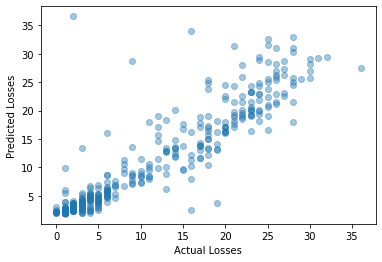

Train score for predicting Winnings from ReturnGamesPlayed and ReturnPointsWon: 0.8371469332555308
Test score for predicting Winnings from ReturnGamesPlayed and ReturnPointsWon: 0.8210598158465396 



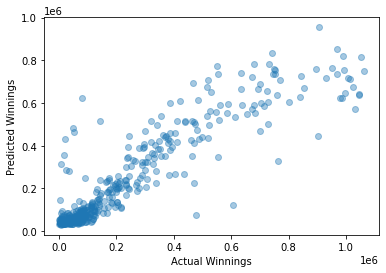

Train score for predicting Winnings from ReturnGamesPlayed and ReturnPointsWon: 0.11039191190811837
Test score for predicting Winnings from ReturnGamesPlayed and ReturnPointsWon: 0.14339624707518217 



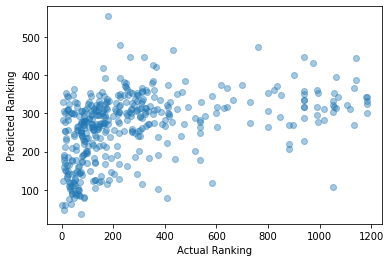

Train score for predicting Winnings from ReturnGamesPlayed and ServiceGamesPlayed: 0.8445986064257466
Test score for predicting Winnings from ReturnGamesPlayed and ServiceGamesPlayed: 0.92630039899541 



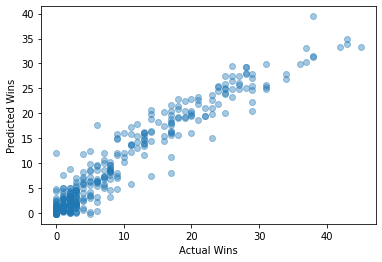

Train score for predicting Winnings from ReturnGamesPlayed and ServiceGamesPlayed: 0.8731906489153665
Test score for predicting Winnings from ReturnGamesPlayed and ServiceGamesPlayed: 0.9148380154521588 



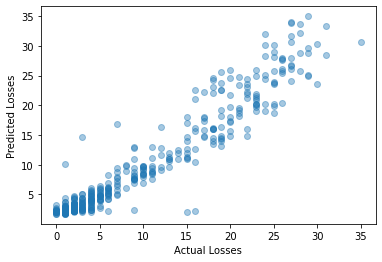

Train score for predicting Winnings from ReturnGamesPlayed and ServiceGamesPlayed: 0.829969733800481
Test score for predicting Winnings from ReturnGamesPlayed and ServiceGamesPlayed: 0.8418289482443586 



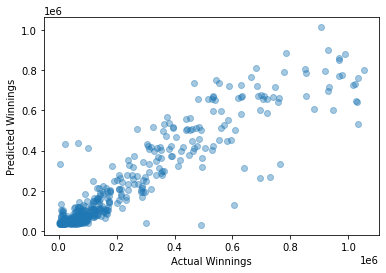

Train score for predicting Winnings from ReturnGamesPlayed and ServiceGamesPlayed: 0.11418922898639894
Test score for predicting Winnings from ReturnGamesPlayed and ServiceGamesPlayed: 0.09819346100659343 



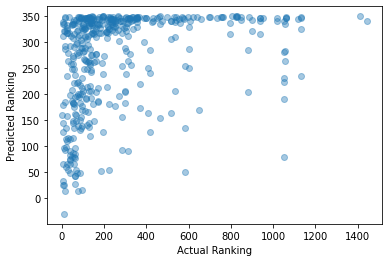

Train score for predicting Winnings from ReturnGamesPlayed and ServiceGamesWon: 0.8578367136548048
Test score for predicting Winnings from ReturnGamesPlayed and ServiceGamesWon: 0.8742893841361807 



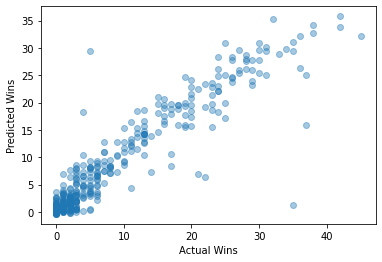

Train score for predicting Winnings from ReturnGamesPlayed and ServiceGamesWon: 0.8699540510864571
Test score for predicting Winnings from ReturnGamesPlayed and ServiceGamesWon: 0.9020244325096828 



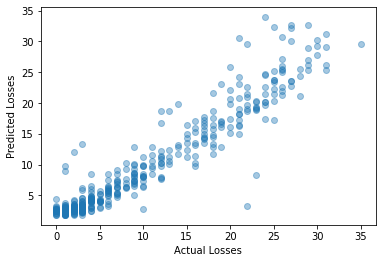

Train score for predicting Winnings from ReturnGamesPlayed and ServiceGamesWon: 0.8396448080511798
Test score for predicting Winnings from ReturnGamesPlayed and ServiceGamesWon: 0.81264192439633 



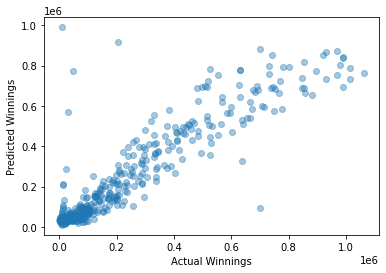

Train score for predicting Winnings from ReturnGamesPlayed and ServiceGamesWon: 0.12332618759706238
Test score for predicting Winnings from ReturnGamesPlayed and ServiceGamesWon: 0.08449266787046883 



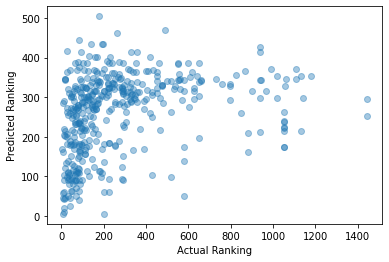

Train score for predicting Winnings from ReturnGamesPlayed and TotalPointsWon: 0.8379672541440882
Test score for predicting Winnings from ReturnGamesPlayed and TotalPointsWon: 0.9299534064458355 



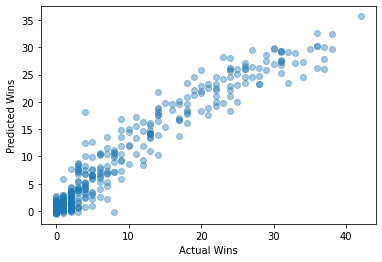

Train score for predicting Winnings from ReturnGamesPlayed and TotalPointsWon: 0.8741514730835412
Test score for predicting Winnings from ReturnGamesPlayed and TotalPointsWon: 0.8923554900554959 



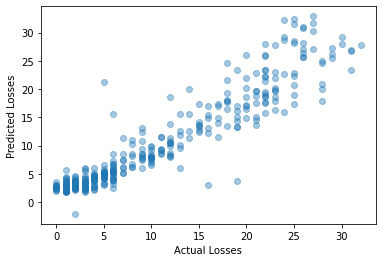

Train score for predicting Winnings from ReturnGamesPlayed and TotalPointsWon: 0.8246750513657624
Test score for predicting Winnings from ReturnGamesPlayed and TotalPointsWon: 0.8547274110075432 



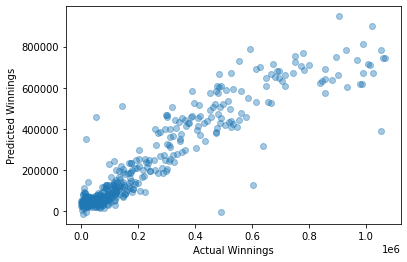

Train score for predicting Winnings from ReturnGamesPlayed and TotalPointsWon: 0.1167369001404942
Test score for predicting Winnings from ReturnGamesPlayed and TotalPointsWon: 0.15427012371673077 



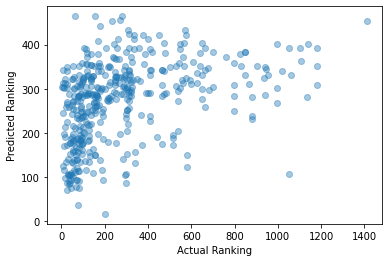

Train score for predicting Winnings from ReturnGamesPlayed and TotalServicePointsWon: 0.8899828682961074
Test score for predicting Winnings from ReturnGamesPlayed and TotalServicePointsWon: 0.7732819713092802 



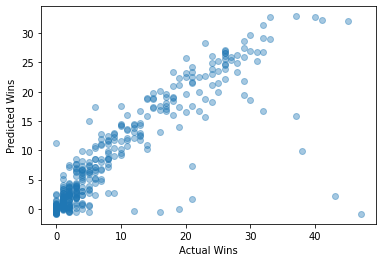

Train score for predicting Winnings from ReturnGamesPlayed and TotalServicePointsWon: 0.8737701604033262
Test score for predicting Winnings from ReturnGamesPlayed and TotalServicePointsWon: 0.8943115985415346 



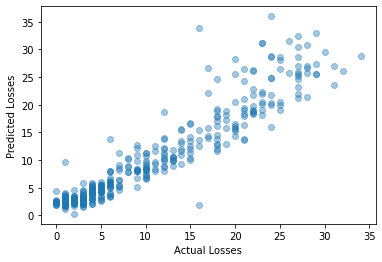

Train score for predicting Winnings from ReturnGamesPlayed and TotalServicePointsWon: 0.8297191881319488
Test score for predicting Winnings from ReturnGamesPlayed and TotalServicePointsWon: 0.8399816025589583 



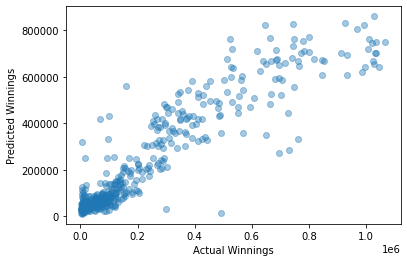

Train score for predicting Winnings from ReturnGamesPlayed and TotalServicePointsWon: 0.11539928228293062
Test score for predicting Winnings from ReturnGamesPlayed and TotalServicePointsWon: 0.11043361147037334 



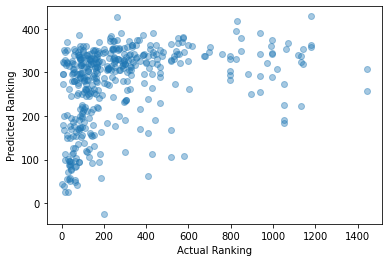

Train score for predicting Winnings from ReturnGamesWon and FirstServe: 0.09336151568544493
Test score for predicting Winnings from ReturnGamesWon and FirstServe: 0.07601307820584347 



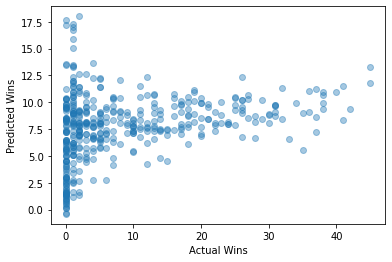

Train score for predicting Winnings from ReturnGamesWon and FirstServe: 0.08360732867236009
Test score for predicting Winnings from ReturnGamesWon and FirstServe: 0.03802384712856921 



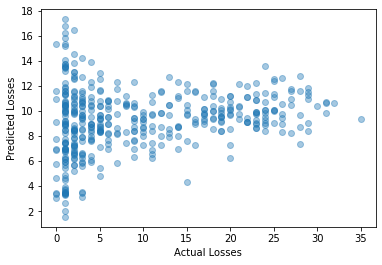

Train score for predicting Winnings from ReturnGamesWon and FirstServe: 0.0850826778665782
Test score for predicting Winnings from ReturnGamesWon and FirstServe: 0.07017321953480626 



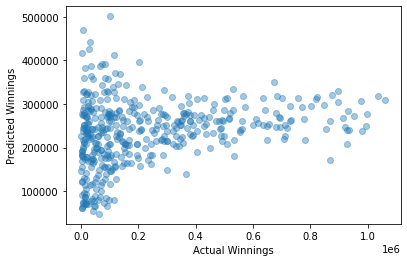

Train score for predicting Winnings from ReturnGamesWon and FirstServe: 0.04610149441742917
Test score for predicting Winnings from ReturnGamesWon and FirstServe: 0.028055788678255422 



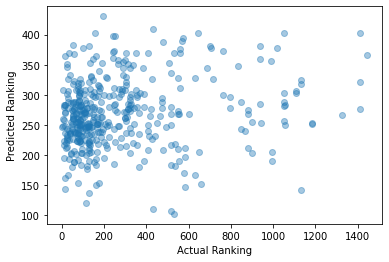

Train score for predicting Winnings from ReturnGamesWon and FirstServePointsWon: 0.2101947164446406
Test score for predicting Winnings from ReturnGamesWon and FirstServePointsWon: 0.22486752459976977 



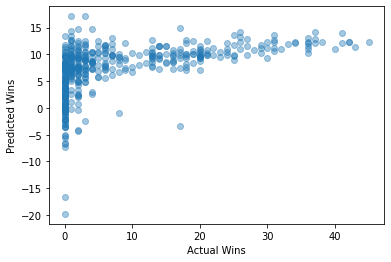

Train score for predicting Winnings from ReturnGamesWon and FirstServePointsWon: 0.18110961747409537
Test score for predicting Winnings from ReturnGamesWon and FirstServePointsWon: 0.1776844120479092 



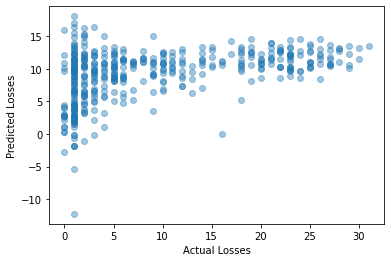

Train score for predicting Winnings from ReturnGamesWon and FirstServePointsWon: 0.20909110577142642
Test score for predicting Winnings from ReturnGamesWon and FirstServePointsWon: 0.20898233563951452 



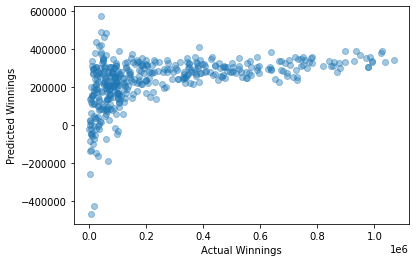

Train score for predicting Winnings from ReturnGamesWon and FirstServePointsWon: 0.062155732533047625
Test score for predicting Winnings from ReturnGamesWon and FirstServePointsWon: 0.05176825582230615 



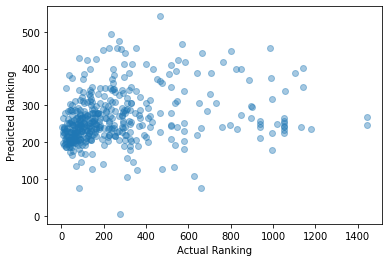

Train score for predicting Winnings from ReturnGamesWon and FirstServeReturnPointsWon: 0.09944655802182745
Test score for predicting Winnings from ReturnGamesWon and FirstServeReturnPointsWon: 0.055971347950019124 



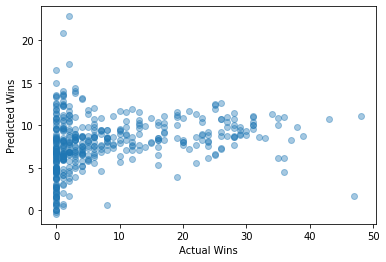

Train score for predicting Winnings from ReturnGamesWon and FirstServeReturnPointsWon: 0.07927545186923901
Test score for predicting Winnings from ReturnGamesWon and FirstServeReturnPointsWon: 0.052539611296775424 



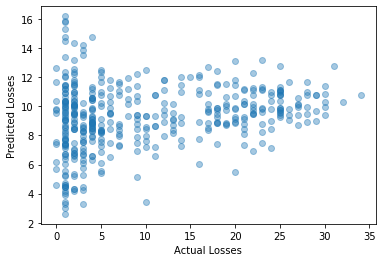

Train score for predicting Winnings from ReturnGamesWon and FirstServeReturnPointsWon: 0.08537669995756714
Test score for predicting Winnings from ReturnGamesWon and FirstServeReturnPointsWon: 0.06124581393977124 



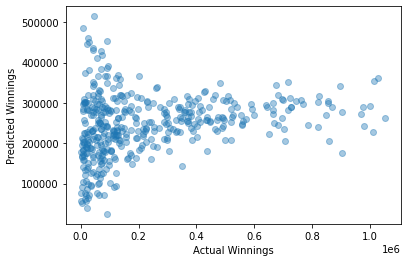

Train score for predicting Winnings from ReturnGamesWon and FirstServeReturnPointsWon: 0.03477975733735805
Test score for predicting Winnings from ReturnGamesWon and FirstServeReturnPointsWon: 0.038778615540307704 



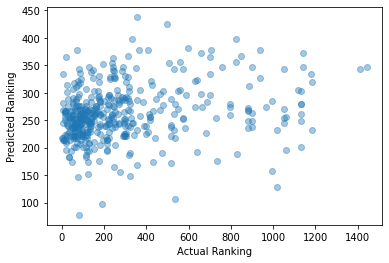

Train score for predicting Winnings from ReturnGamesWon and SecondServePointsWon: 0.14666851945696546
Test score for predicting Winnings from ReturnGamesWon and SecondServePointsWon: 0.13204688327098513 



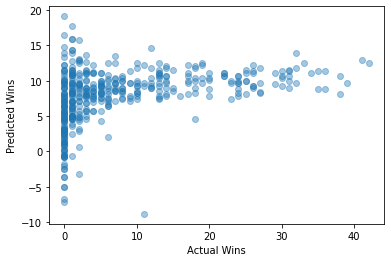

Train score for predicting Winnings from ReturnGamesWon and SecondServePointsWon: 0.13655748391062417
Test score for predicting Winnings from ReturnGamesWon and SecondServePointsWon: 0.058288423810998524 



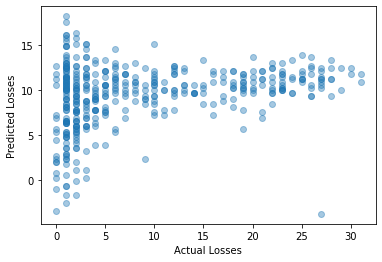

Train score for predicting Winnings from ReturnGamesWon and SecondServePointsWon: 0.13938968293740583
Test score for predicting Winnings from ReturnGamesWon and SecondServePointsWon: 0.1516766789594025 



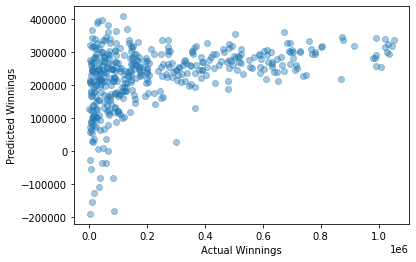

Train score for predicting Winnings from ReturnGamesWon and SecondServePointsWon: 0.06708943193489925
Test score for predicting Winnings from ReturnGamesWon and SecondServePointsWon: 0.04591015467644899 



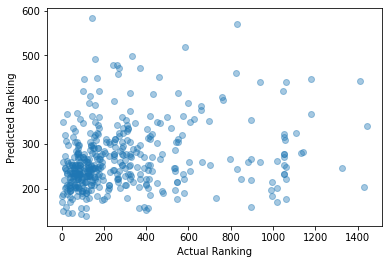

Train score for predicting Winnings from ReturnGamesWon and SecondServeReturnPointsWon: 0.0968926391502054
Test score for predicting Winnings from ReturnGamesWon and SecondServeReturnPointsWon: 0.05421621665075538 



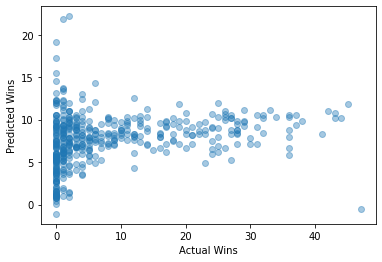

Train score for predicting Winnings from ReturnGamesWon and SecondServeReturnPointsWon: 0.08034682391255822
Test score for predicting Winnings from ReturnGamesWon and SecondServeReturnPointsWon: 0.03673254395588854 



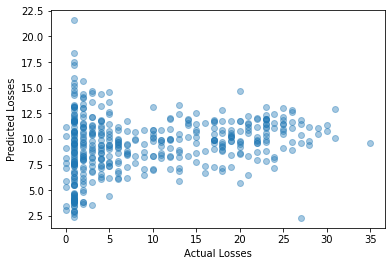

Train score for predicting Winnings from ReturnGamesWon and SecondServeReturnPointsWon: 0.07832934426752125
Test score for predicting Winnings from ReturnGamesWon and SecondServeReturnPointsWon: 0.08284211231204008 



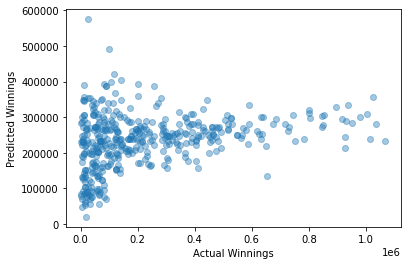

Train score for predicting Winnings from ReturnGamesWon and SecondServeReturnPointsWon: 0.03912926901957314
Test score for predicting Winnings from ReturnGamesWon and SecondServeReturnPointsWon: 0.03892292421354693 



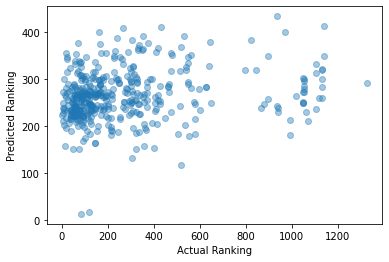

Train score for predicting Winnings from ReturnGamesWon and Aces: 0.7091437444579082
Test score for predicting Winnings from ReturnGamesWon and Aces: 0.7223843847235547 



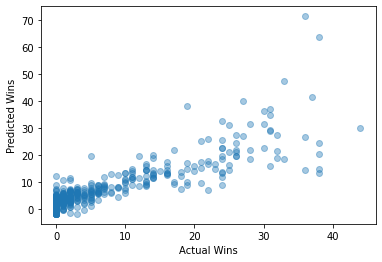

Train score for predicting Winnings from ReturnGamesWon and Aces: 0.6362999920283248
Test score for predicting Winnings from ReturnGamesWon and Aces: 0.5387475728964415 



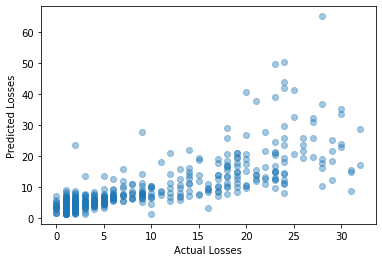

Train score for predicting Winnings from ReturnGamesWon and Aces: 0.660712003088108
Test score for predicting Winnings from ReturnGamesWon and Aces: 0.6791976176283723 



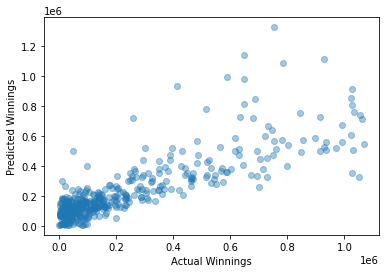

Train score for predicting Winnings from ReturnGamesWon and Aces: 0.09698492357370903
Test score for predicting Winnings from ReturnGamesWon and Aces: 0.11119095652819233 



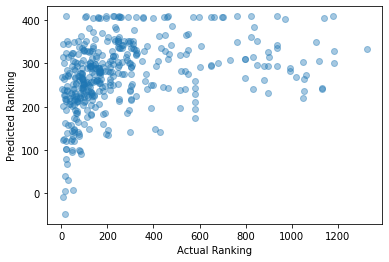

Train score for predicting Winnings from ReturnGamesWon and BreakPointsConverted: 0.09984367348245882
Test score for predicting Winnings from ReturnGamesWon and BreakPointsConverted: 0.08885007056099814 



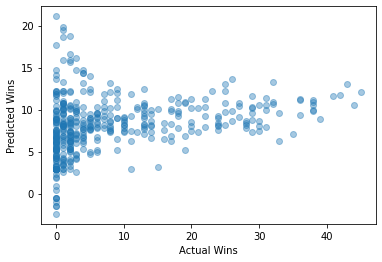

Train score for predicting Winnings from ReturnGamesWon and BreakPointsConverted: 0.08305846176349672
Test score for predicting Winnings from ReturnGamesWon and BreakPointsConverted: 0.06888798644752792 



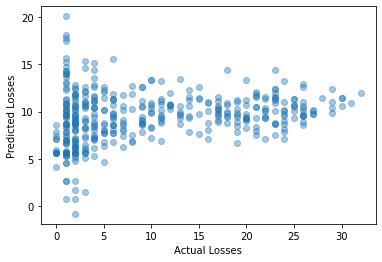

Train score for predicting Winnings from ReturnGamesWon and BreakPointsConverted: 0.08331655459651877
Test score for predicting Winnings from ReturnGamesWon and BreakPointsConverted: 0.10211639384632565 



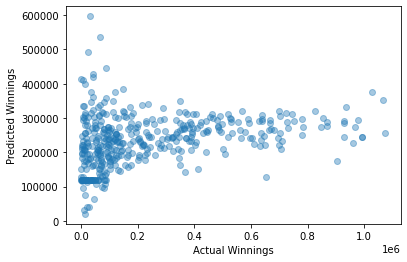

Train score for predicting Winnings from ReturnGamesWon and BreakPointsConverted: 0.05211764082888327
Test score for predicting Winnings from ReturnGamesWon and BreakPointsConverted: 0.00162371884487722 



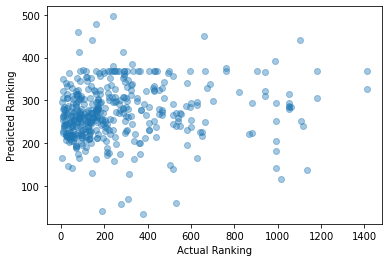

Train score for predicting Winnings from ReturnGamesWon and BreakPointsFaced: 0.7652056712402573
Test score for predicting Winnings from ReturnGamesWon and BreakPointsFaced: 0.8270090581251062 



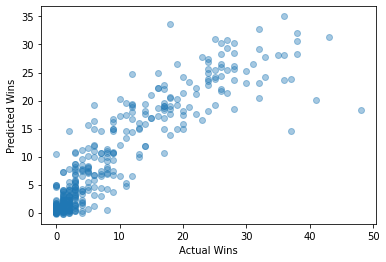

Train score for predicting Winnings from ReturnGamesWon and BreakPointsFaced: 0.9008070785385491
Test score for predicting Winnings from ReturnGamesWon and BreakPointsFaced: 0.8680705307595151 



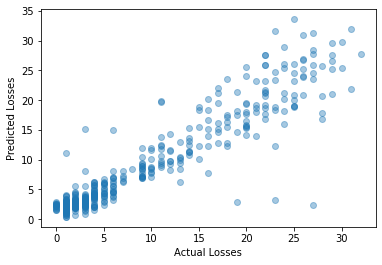

Train score for predicting Winnings from ReturnGamesWon and BreakPointsFaced: 0.7587273830078949
Test score for predicting Winnings from ReturnGamesWon and BreakPointsFaced: 0.7981446622375837 



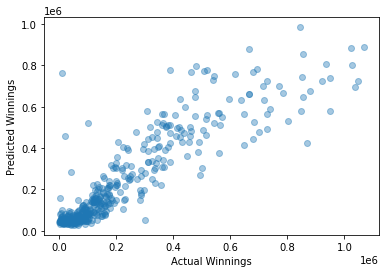

Train score for predicting Winnings from ReturnGamesWon and BreakPointsFaced: 0.10105751918617546
Test score for predicting Winnings from ReturnGamesWon and BreakPointsFaced: 0.13826624365614537 



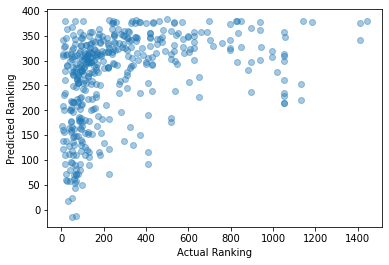

Train score for predicting Winnings from ReturnGamesWon and BreakPointsOpportunities: 0.8506538280855858
Test score for predicting Winnings from ReturnGamesWon and BreakPointsOpportunities: 0.8670630315772188 



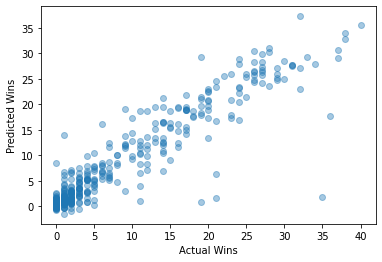

Train score for predicting Winnings from ReturnGamesWon and BreakPointsOpportunities: 0.8336828730634739
Test score for predicting Winnings from ReturnGamesWon and BreakPointsOpportunities: 0.8221543971993925 



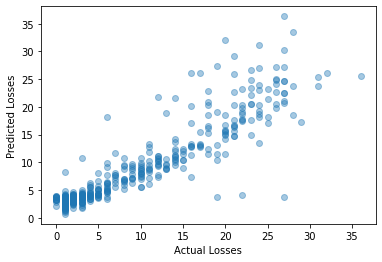

Train score for predicting Winnings from ReturnGamesWon and BreakPointsOpportunities: 0.800770195384483
Test score for predicting Winnings from ReturnGamesWon and BreakPointsOpportunities: 0.8553336454618415 



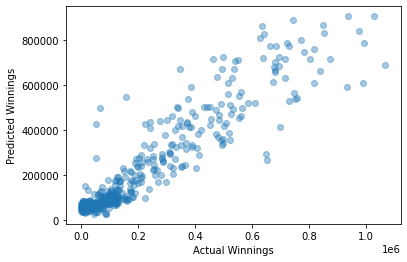

Train score for predicting Winnings from ReturnGamesWon and BreakPointsOpportunities: 0.1215601717187349
Test score for predicting Winnings from ReturnGamesWon and BreakPointsOpportunities: 0.10261836039041372 



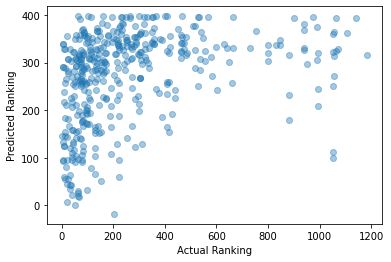

Train score for predicting Winnings from ReturnGamesWon and BreakPointsSaved: 0.1453660406204793
Test score for predicting Winnings from ReturnGamesWon and BreakPointsSaved: 0.13515828232641036 



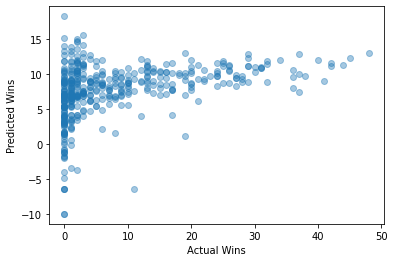

Train score for predicting Winnings from ReturnGamesWon and BreakPointsSaved: 0.12766677208446808
Test score for predicting Winnings from ReturnGamesWon and BreakPointsSaved: 0.11451808903387739 



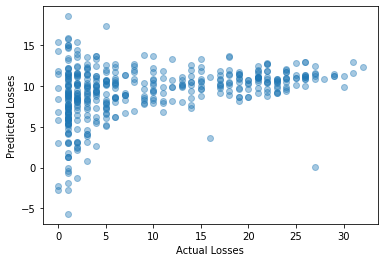

Train score for predicting Winnings from ReturnGamesWon and BreakPointsSaved: 0.1262267411164365
Test score for predicting Winnings from ReturnGamesWon and BreakPointsSaved: 0.17587454156590876 



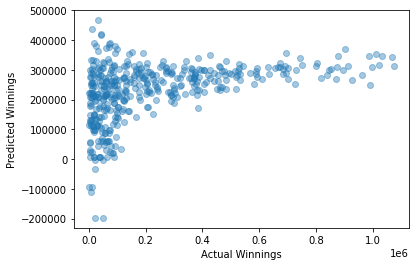

Train score for predicting Winnings from ReturnGamesWon and BreakPointsSaved: 0.049220753603337
Test score for predicting Winnings from ReturnGamesWon and BreakPointsSaved: 0.047342119098799706 



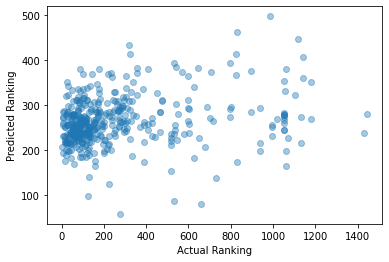

Train score for predicting Winnings from ReturnGamesWon and DoubleFaults: 0.722585074416283
Test score for predicting Winnings from ReturnGamesWon and DoubleFaults: 0.7144620544615966 



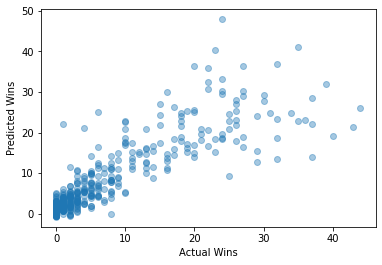

Train score for predicting Winnings from ReturnGamesWon and DoubleFaults: 0.7712795412355534
Test score for predicting Winnings from ReturnGamesWon and DoubleFaults: 0.7971331588486694 



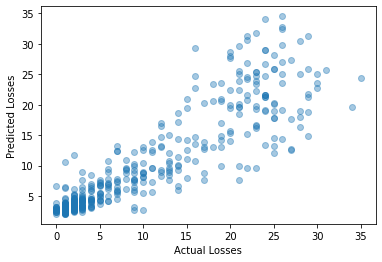

Train score for predicting Winnings from ReturnGamesWon and DoubleFaults: 0.7201095155731112
Test score for predicting Winnings from ReturnGamesWon and DoubleFaults: 0.7645569491778815 



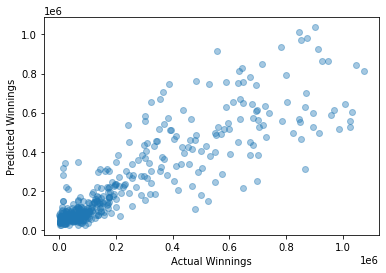

Train score for predicting Winnings from ReturnGamesWon and DoubleFaults: 0.10267843720441018
Test score for predicting Winnings from ReturnGamesWon and DoubleFaults: 0.11397563727130278 



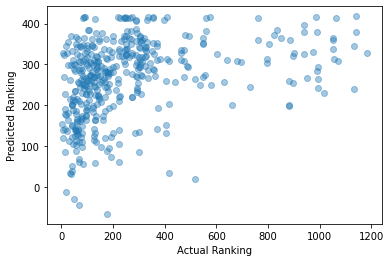

Train score for predicting Winnings from ReturnGamesWon and ReturnGamesPlayed: 0.8800340910583498
Test score for predicting Winnings from ReturnGamesWon and ReturnGamesPlayed: 0.812315696868638 



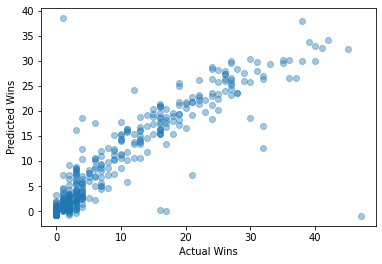

Train score for predicting Winnings from ReturnGamesWon and ReturnGamesPlayed: 0.8713275745943374
Test score for predicting Winnings from ReturnGamesWon and ReturnGamesPlayed: 0.8963315344417104 



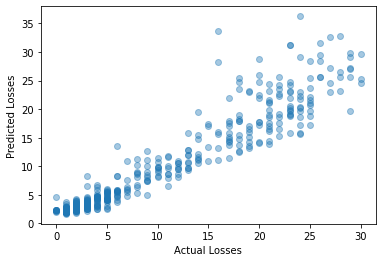

Train score for predicting Winnings from ReturnGamesWon and ReturnGamesPlayed: 0.8241466391788299
Test score for predicting Winnings from ReturnGamesWon and ReturnGamesPlayed: 0.8584768833131731 



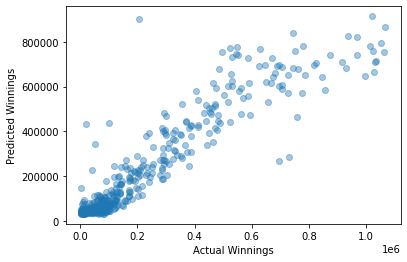

Train score for predicting Winnings from ReturnGamesWon and ReturnGamesPlayed: 0.12489244578189729
Test score for predicting Winnings from ReturnGamesWon and ReturnGamesPlayed: 0.09861217535940192 



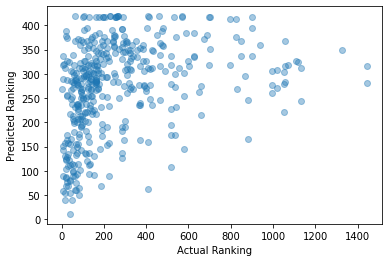

Train score for predicting Winnings from ReturnGamesWon and ReturnPointsWon: 0.08356868605407153
Test score for predicting Winnings from ReturnGamesWon and ReturnPointsWon: 0.08894370403091278 



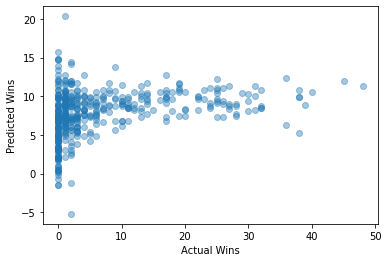

Train score for predicting Winnings from ReturnGamesWon and ReturnPointsWon: 0.06368515771554017
Test score for predicting Winnings from ReturnGamesWon and ReturnPointsWon: 0.10167649654256905 



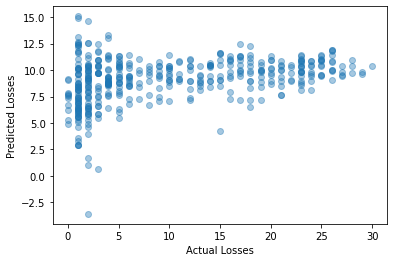

Train score for predicting Winnings from ReturnGamesWon and ReturnPointsWon: 0.06601649640292928
Test score for predicting Winnings from ReturnGamesWon and ReturnPointsWon: 0.12496883642256174 



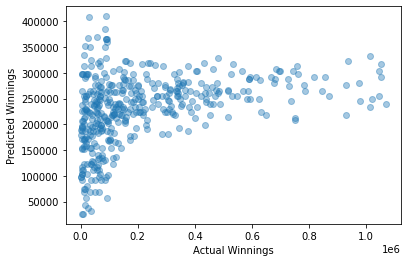

Train score for predicting Winnings from ReturnGamesWon and ReturnPointsWon: 0.04114836713678516
Test score for predicting Winnings from ReturnGamesWon and ReturnPointsWon: 0.04287297880682994 



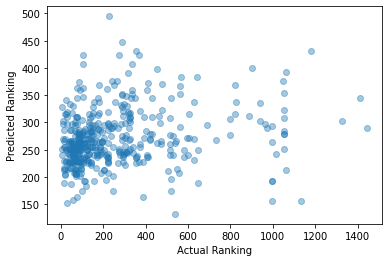

Train score for predicting Winnings from ReturnGamesWon and ServiceGamesPlayed: 0.8667639059735337
Test score for predicting Winnings from ReturnGamesWon and ServiceGamesPlayed: 0.8542397981203214 



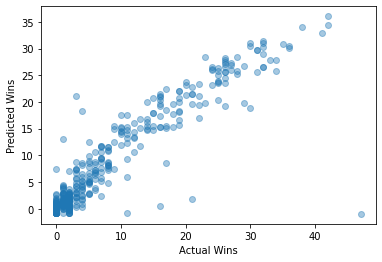

Train score for predicting Winnings from ReturnGamesWon and ServiceGamesPlayed: 0.8760851563417346
Test score for predicting Winnings from ReturnGamesWon and ServiceGamesPlayed: 0.8693648513409551 



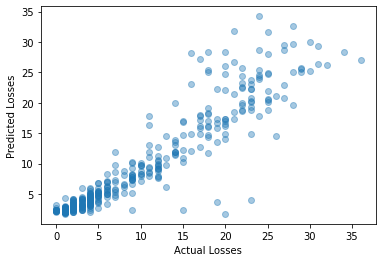

Train score for predicting Winnings from ReturnGamesWon and ServiceGamesPlayed: 0.8236248718739505
Test score for predicting Winnings from ReturnGamesWon and ServiceGamesPlayed: 0.8651343264107273 



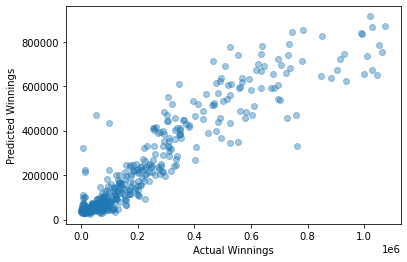

Train score for predicting Winnings from ReturnGamesWon and ServiceGamesPlayed: 0.1262497214841336
Test score for predicting Winnings from ReturnGamesWon and ServiceGamesPlayed: 0.09551422827591627 



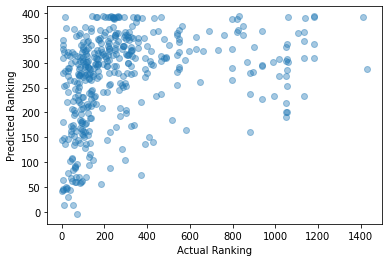

Train score for predicting Winnings from ReturnGamesWon and ServiceGamesWon: 0.21040060519103
Test score for predicting Winnings from ReturnGamesWon and ServiceGamesWon: 0.24389973571795795 



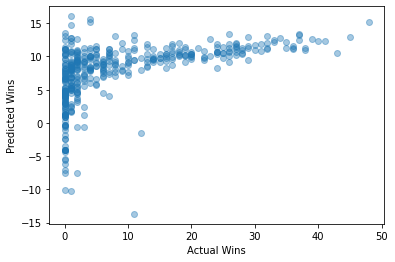

Train score for predicting Winnings from ReturnGamesWon and ServiceGamesWon: 0.1852753249478687
Test score for predicting Winnings from ReturnGamesWon and ServiceGamesWon: 0.20663838190108907 



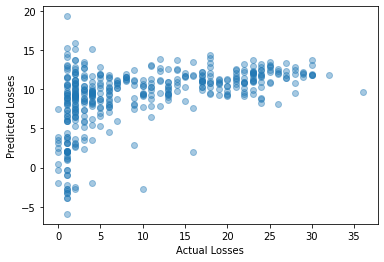

Train score for predicting Winnings from ReturnGamesWon and ServiceGamesWon: 0.21365148386237764
Test score for predicting Winnings from ReturnGamesWon and ServiceGamesWon: 0.23922758710520398 



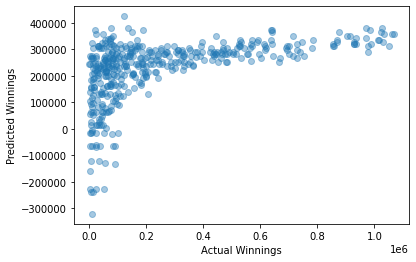

Train score for predicting Winnings from ReturnGamesWon and ServiceGamesWon: 0.07214526489688022
Test score for predicting Winnings from ReturnGamesWon and ServiceGamesWon: 0.07152964670523498 



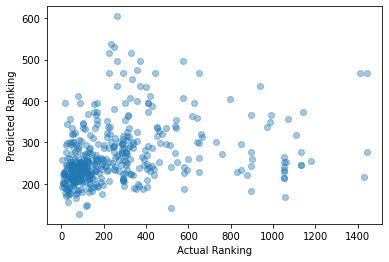

Train score for predicting Winnings from ReturnGamesWon and TotalPointsWon: 0.21766338097631133
Test score for predicting Winnings from ReturnGamesWon and TotalPointsWon: 0.19566497735612165 



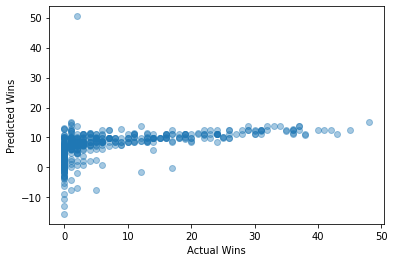

Train score for predicting Winnings from ReturnGamesWon and TotalPointsWon: 0.20651308021033432
Test score for predicting Winnings from ReturnGamesWon and TotalPointsWon: 0.11197160290048613 



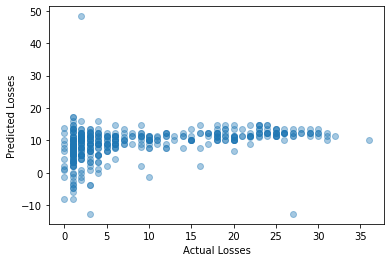

Train score for predicting Winnings from ReturnGamesWon and TotalPointsWon: 0.20095260005048943
Test score for predicting Winnings from ReturnGamesWon and TotalPointsWon: 0.2533380789350501 



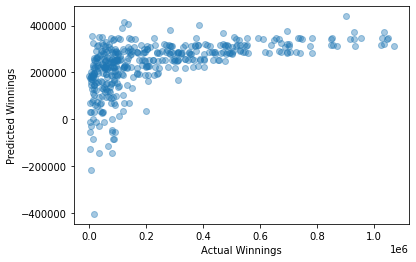

Train score for predicting Winnings from ReturnGamesWon and TotalPointsWon: 0.05734232088219348
Test score for predicting Winnings from ReturnGamesWon and TotalPointsWon: 0.11783682777928396 



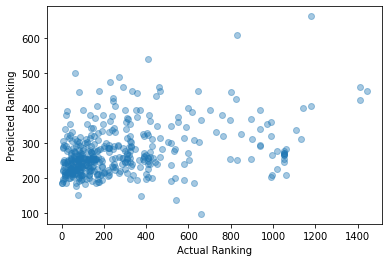

Train score for predicting Winnings from ReturnGamesWon and TotalServicePointsWon: 0.23244945539999207
Test score for predicting Winnings from ReturnGamesWon and TotalServicePointsWon: 0.2456218542851374 



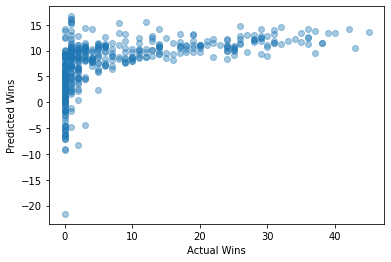

Train score for predicting Winnings from ReturnGamesWon and TotalServicePointsWon: 0.19473408698549968
Test score for predicting Winnings from ReturnGamesWon and TotalServicePointsWon: 0.2148610922027686 



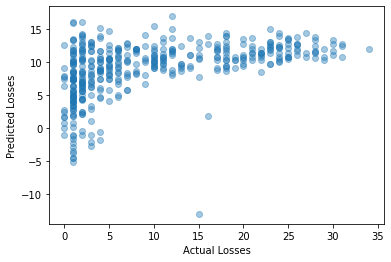

Train score for predicting Winnings from ReturnGamesWon and TotalServicePointsWon: 0.23752175566895148
Test score for predicting Winnings from ReturnGamesWon and TotalServicePointsWon: 0.230151786395423 



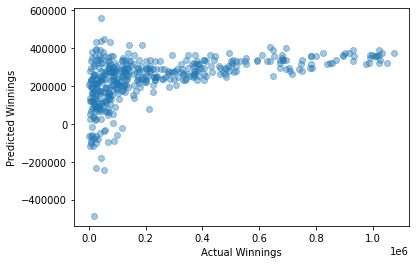

Train score for predicting Winnings from ReturnGamesWon and TotalServicePointsWon: 0.07897716230197627
Test score for predicting Winnings from ReturnGamesWon and TotalServicePointsWon: 0.06637367159467233 



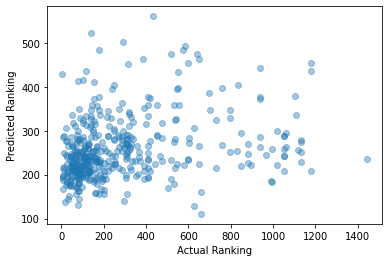

Train score for predicting Winnings from ReturnPointsWon and FirstServe: 0.07510743679864551
Test score for predicting Winnings from ReturnPointsWon and FirstServe: 0.09994316339502085 



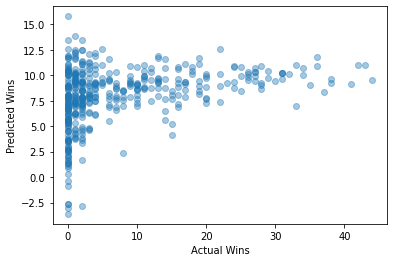

Train score for predicting Winnings from ReturnPointsWon and FirstServe: 0.0785402443034855
Test score for predicting Winnings from ReturnPointsWon and FirstServe: 0.048387540988409805 



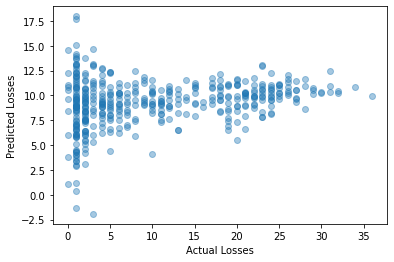

Train score for predicting Winnings from ReturnPointsWon and FirstServe: 0.0830841665907589
Test score for predicting Winnings from ReturnPointsWon and FirstServe: 0.047739109404927094 



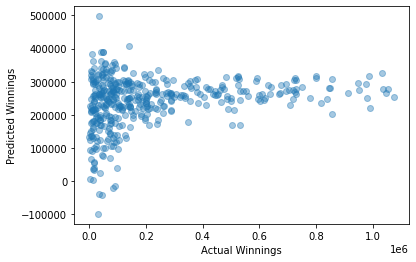

Train score for predicting Winnings from ReturnPointsWon and FirstServe: 0.04703059045172697
Test score for predicting Winnings from ReturnPointsWon and FirstServe: 0.03682180758037357 



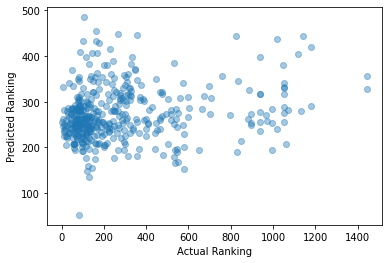

Train score for predicting Winnings from ReturnPointsWon and FirstServePointsWon: 0.21885416961534876
Test score for predicting Winnings from ReturnPointsWon and FirstServePointsWon: 0.16974514343215663 



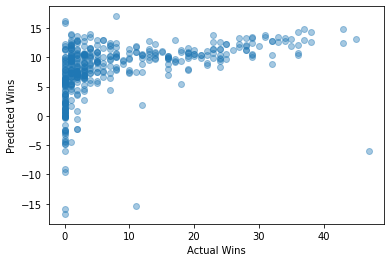

Train score for predicting Winnings from ReturnPointsWon and FirstServePointsWon: 0.17054333453753168
Test score for predicting Winnings from ReturnPointsWon and FirstServePointsWon: 0.20455311139756893 



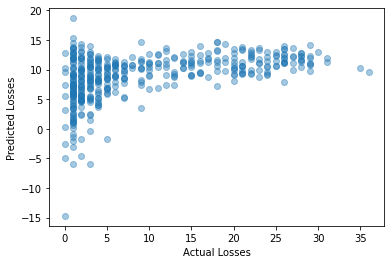

Train score for predicting Winnings from ReturnPointsWon and FirstServePointsWon: 0.19912515346964266
Test score for predicting Winnings from ReturnPointsWon and FirstServePointsWon: 0.2210505578968108 



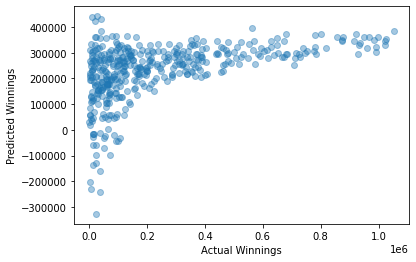

Train score for predicting Winnings from ReturnPointsWon and FirstServePointsWon: 0.07328414790048754
Test score for predicting Winnings from ReturnPointsWon and FirstServePointsWon: 0.029739702723232786 



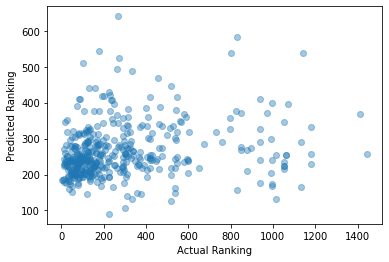

Train score for predicting Winnings from ReturnPointsWon and FirstServeReturnPointsWon: 0.07963941284093323
Test score for predicting Winnings from ReturnPointsWon and FirstServeReturnPointsWon: 0.07886649666898071 



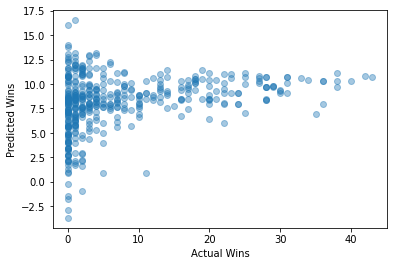

Train score for predicting Winnings from ReturnPointsWon and FirstServeReturnPointsWon: 0.07795818005456756
Test score for predicting Winnings from ReturnPointsWon and FirstServeReturnPointsWon: 0.05229341482744698 



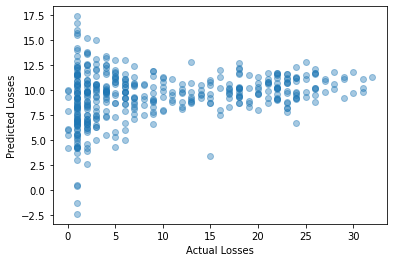

Train score for predicting Winnings from ReturnPointsWon and FirstServeReturnPointsWon: 0.07353161746961301
Test score for predicting Winnings from ReturnPointsWon and FirstServeReturnPointsWon: 0.07607499028384579 



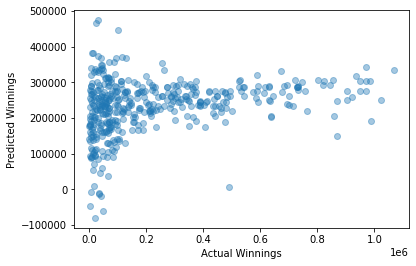

Train score for predicting Winnings from ReturnPointsWon and FirstServeReturnPointsWon: 0.050135735332466846
Test score for predicting Winnings from ReturnPointsWon and FirstServeReturnPointsWon: 0.008382889477950295 



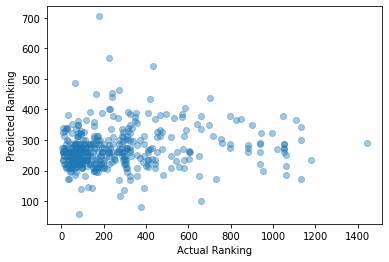

Train score for predicting Winnings from ReturnPointsWon and SecondServePointsWon: 0.13087731743684894
Test score for predicting Winnings from ReturnPointsWon and SecondServePointsWon: 0.15413238681968533 



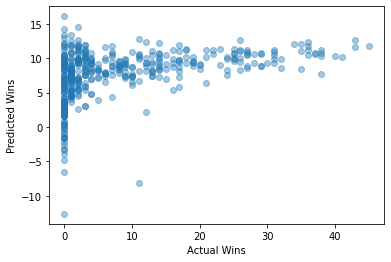

Train score for predicting Winnings from ReturnPointsWon and SecondServePointsWon: 0.11397786762815122
Test score for predicting Winnings from ReturnPointsWon and SecondServePointsWon: 0.13723664353379306 



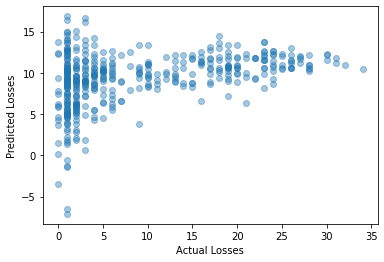

Train score for predicting Winnings from ReturnPointsWon and SecondServePointsWon: 0.1327455086975876
Test score for predicting Winnings from ReturnPointsWon and SecondServePointsWon: 0.1596125558030841 



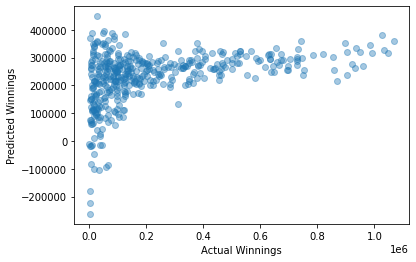

Train score for predicting Winnings from ReturnPointsWon and SecondServePointsWon: 0.07269506145183924
Test score for predicting Winnings from ReturnPointsWon and SecondServePointsWon: 0.04799333939657624 



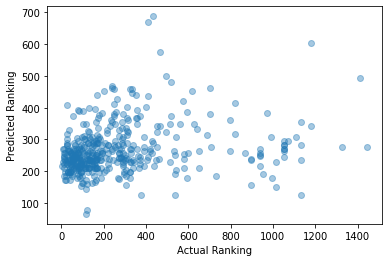

Train score for predicting Winnings from ReturnPointsWon and SecondServeReturnPointsWon: 0.07948161267276599
Test score for predicting Winnings from ReturnPointsWon and SecondServeReturnPointsWon: 0.07173735184568975 



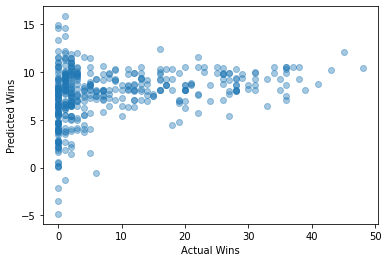

Train score for predicting Winnings from ReturnPointsWon and SecondServeReturnPointsWon: 0.07535358597005704
Test score for predicting Winnings from ReturnPointsWon and SecondServeReturnPointsWon: 0.053662943158992116 



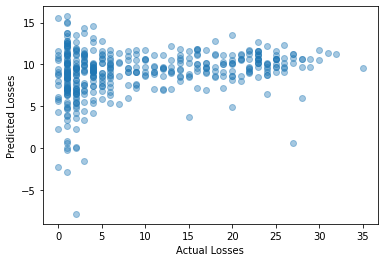

Train score for predicting Winnings from ReturnPointsWon and SecondServeReturnPointsWon: 0.07065673159540897
Test score for predicting Winnings from ReturnPointsWon and SecondServeReturnPointsWon: 0.08237203690684358 



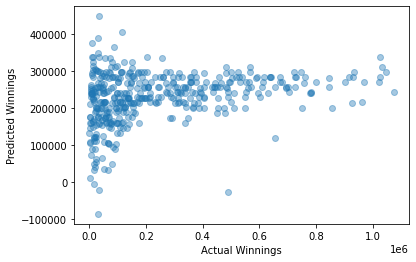

Train score for predicting Winnings from ReturnPointsWon and SecondServeReturnPointsWon: 0.04454436095862513
Test score for predicting Winnings from ReturnPointsWon and SecondServeReturnPointsWon: 0.020985037051753808 



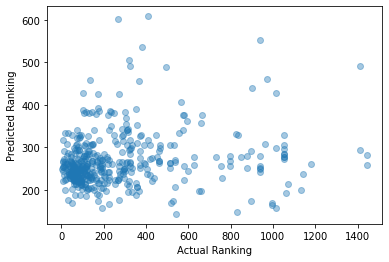

Train score for predicting Winnings from ReturnPointsWon and Aces: 0.6935078957866752
Test score for predicting Winnings from ReturnPointsWon and Aces: 0.7436512189098083 



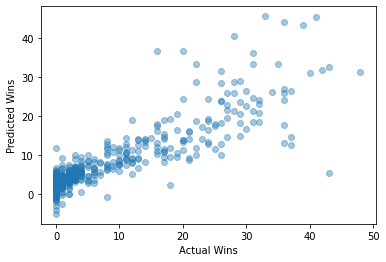

Train score for predicting Winnings from ReturnPointsWon and Aces: 0.6204073660422106
Test score for predicting Winnings from ReturnPointsWon and Aces: 0.6008094494492812 



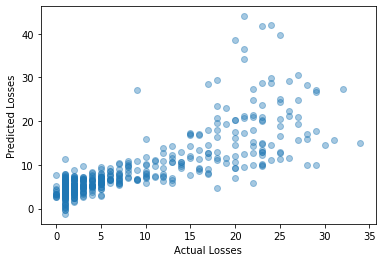

Train score for predicting Winnings from ReturnPointsWon and Aces: 0.6687565801376776
Test score for predicting Winnings from ReturnPointsWon and Aces: 0.648194480298525 



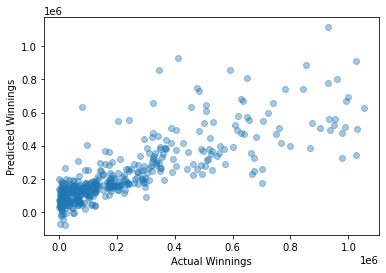

Train score for predicting Winnings from ReturnPointsWon and Aces: 0.10108331231950396
Test score for predicting Winnings from ReturnPointsWon and Aces: 0.11612825430779461 



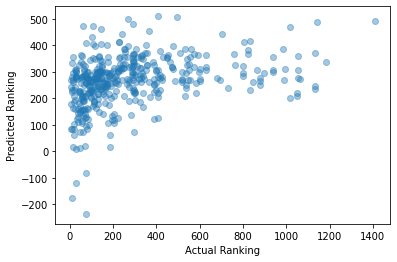

Train score for predicting Winnings from ReturnPointsWon and BreakPointsConverted: 0.08565180717355392
Test score for predicting Winnings from ReturnPointsWon and BreakPointsConverted: 0.06285552264656935 



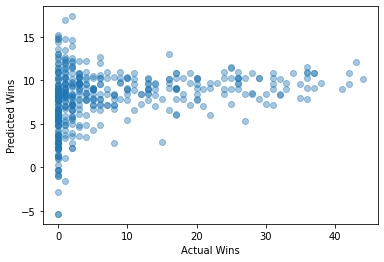

Train score for predicting Winnings from ReturnPointsWon and BreakPointsConverted: 0.07313874654145713
Test score for predicting Winnings from ReturnPointsWon and BreakPointsConverted: 0.038710552014386 



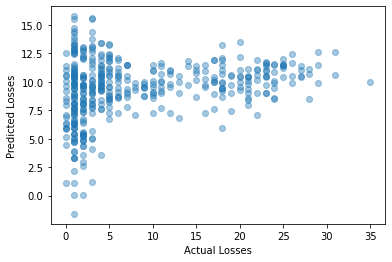

Train score for predicting Winnings from ReturnPointsWon and BreakPointsConverted: 0.0744084929733021
Test score for predicting Winnings from ReturnPointsWon and BreakPointsConverted: 0.07439096497688746 



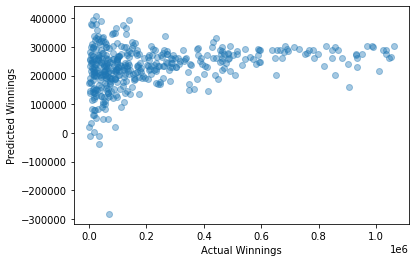

Train score for predicting Winnings from ReturnPointsWon and BreakPointsConverted: 0.03239814064877189
Test score for predicting Winnings from ReturnPointsWon and BreakPointsConverted: 0.05735273772864746 



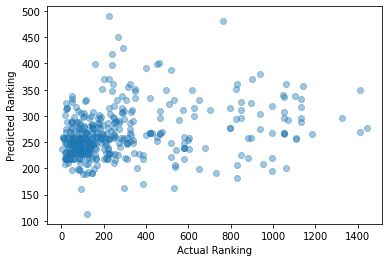

Train score for predicting Winnings from ReturnPointsWon and BreakPointsFaced: 0.7748880770298743
Test score for predicting Winnings from ReturnPointsWon and BreakPointsFaced: 0.7977185072660115 



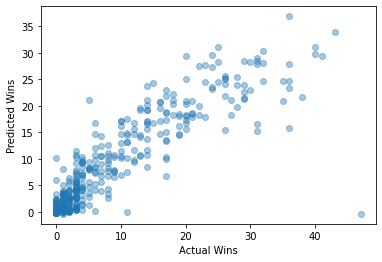

Train score for predicting Winnings from ReturnPointsWon and BreakPointsFaced: 0.8994856914964733
Test score for predicting Winnings from ReturnPointsWon and BreakPointsFaced: 0.8704899109785083 



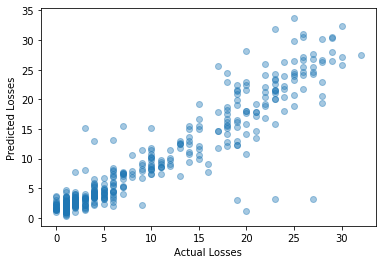

Train score for predicting Winnings from ReturnPointsWon and BreakPointsFaced: 0.7737392009091547
Test score for predicting Winnings from ReturnPointsWon and BreakPointsFaced: 0.7499485755050639 



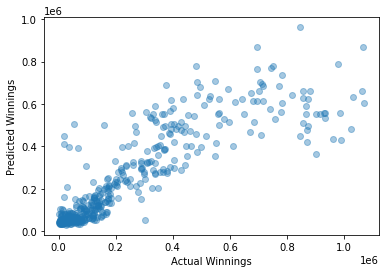

Train score for predicting Winnings from ReturnPointsWon and BreakPointsFaced: 0.11967551714811708
Test score for predicting Winnings from ReturnPointsWon and BreakPointsFaced: 0.09458939892543683 



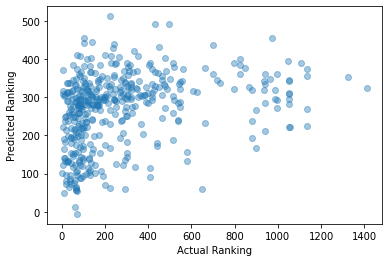

Train score for predicting Winnings from ReturnPointsWon and BreakPointsOpportunities: 0.8386282717676484
Test score for predicting Winnings from ReturnPointsWon and BreakPointsOpportunities: 0.9028290792377547 



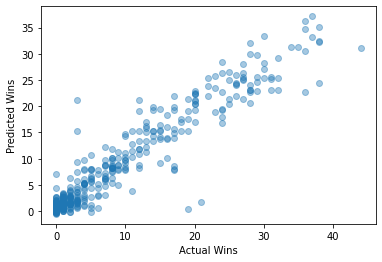

Train score for predicting Winnings from ReturnPointsWon and BreakPointsOpportunities: 0.828306732903428
Test score for predicting Winnings from ReturnPointsWon and BreakPointsOpportunities: 0.8356744221577808 



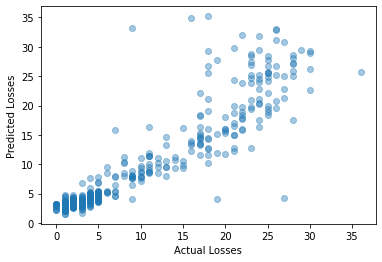

Train score for predicting Winnings from ReturnPointsWon and BreakPointsOpportunities: 0.815802837223878
Test score for predicting Winnings from ReturnPointsWon and BreakPointsOpportunities: 0.8046564256830492 



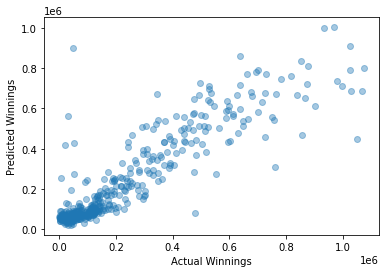

Train score for predicting Winnings from ReturnPointsWon and BreakPointsOpportunities: 0.11757770653824352
Test score for predicting Winnings from ReturnPointsWon and BreakPointsOpportunities: 0.12403314378323782 



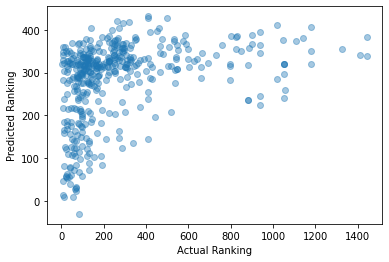

Train score for predicting Winnings from ReturnPointsWon and BreakPointsSaved: 0.13375850207402218
Test score for predicting Winnings from ReturnPointsWon and BreakPointsSaved: 0.13415370179718666 



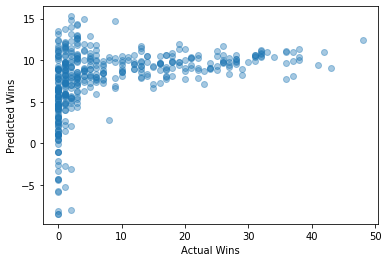

Train score for predicting Winnings from ReturnPointsWon and BreakPointsSaved: 0.12399473680877149
Test score for predicting Winnings from ReturnPointsWon and BreakPointsSaved: 0.12312496894544434 



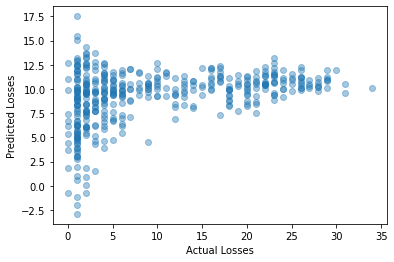

Train score for predicting Winnings from ReturnPointsWon and BreakPointsSaved: 0.14038311536696413
Test score for predicting Winnings from ReturnPointsWon and BreakPointsSaved: 0.09943058677471839 



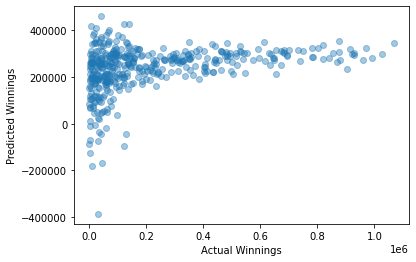

Train score for predicting Winnings from ReturnPointsWon and BreakPointsSaved: 0.063810645456985
Test score for predicting Winnings from ReturnPointsWon and BreakPointsSaved: 0.021978366962094875 



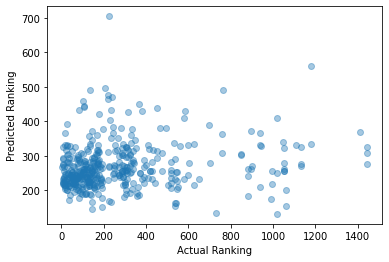

Train score for predicting Winnings from ReturnPointsWon and DoubleFaults: 0.713228250268275
Test score for predicting Winnings from ReturnPointsWon and DoubleFaults: 0.7438208693272168 



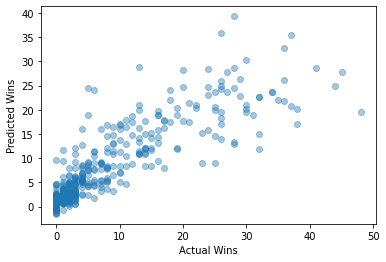

Train score for predicting Winnings from ReturnPointsWon and DoubleFaults: 0.7806116038619748
Test score for predicting Winnings from ReturnPointsWon and DoubleFaults: 0.7698938040444623 



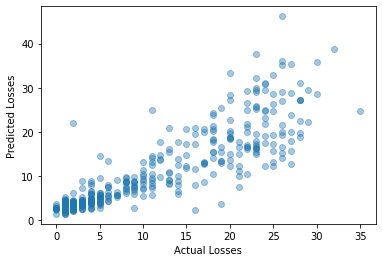

Train score for predicting Winnings from ReturnPointsWon and DoubleFaults: 0.7307651326956348
Test score for predicting Winnings from ReturnPointsWon and DoubleFaults: 0.735454258281161 



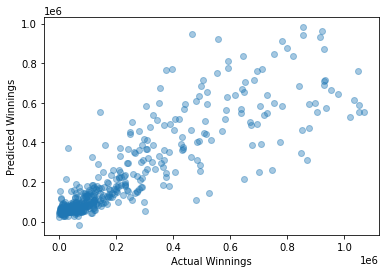

Train score for predicting Winnings from ReturnPointsWon and DoubleFaults: 0.11207432394419858
Test score for predicting Winnings from ReturnPointsWon and DoubleFaults: 0.09914964036840124 



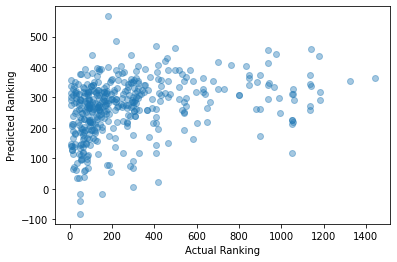

Train score for predicting Winnings from ReturnPointsWon and ReturnGamesPlayed: 0.8668645562967076
Test score for predicting Winnings from ReturnPointsWon and ReturnGamesPlayed: 0.847340682036304 



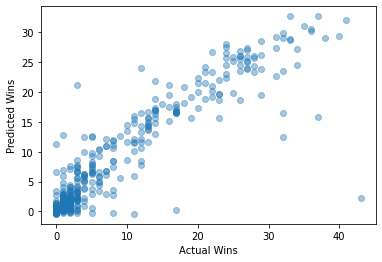

Train score for predicting Winnings from ReturnPointsWon and ReturnGamesPlayed: 0.8856068491290164
Test score for predicting Winnings from ReturnPointsWon and ReturnGamesPlayed: 0.851705080743363 



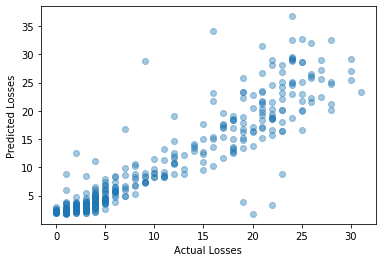

Train score for predicting Winnings from ReturnPointsWon and ReturnGamesPlayed: 0.8213636292528275
Test score for predicting Winnings from ReturnPointsWon and ReturnGamesPlayed: 0.8690996582640016 



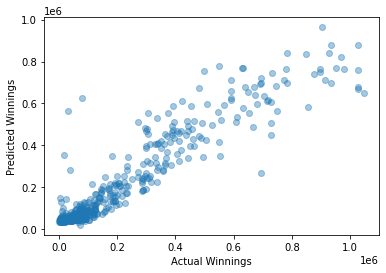

Train score for predicting Winnings from ReturnPointsWon and ReturnGamesPlayed: 0.12224649828296341
Test score for predicting Winnings from ReturnPointsWon and ReturnGamesPlayed: 0.10689548692213513 



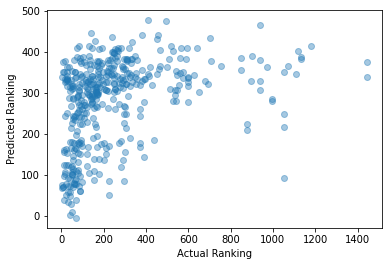

Train score for predicting Winnings from ReturnPointsWon and ReturnGamesWon: 0.08807881665308792
Test score for predicting Winnings from ReturnPointsWon and ReturnGamesWon: 0.08675572719234415 



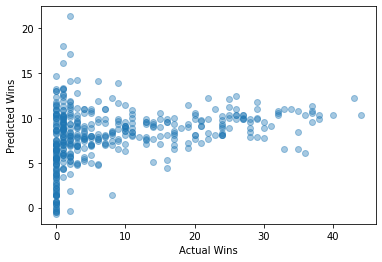

Train score for predicting Winnings from ReturnPointsWon and ReturnGamesWon: 0.06982217897523468
Test score for predicting Winnings from ReturnPointsWon and ReturnGamesWon: 0.08194098599011912 



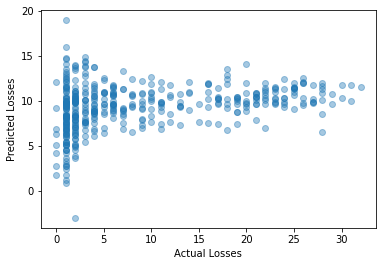

Train score for predicting Winnings from ReturnPointsWon and ReturnGamesWon: 0.07939070772630408
Test score for predicting Winnings from ReturnPointsWon and ReturnGamesWon: 0.08609753886230176 



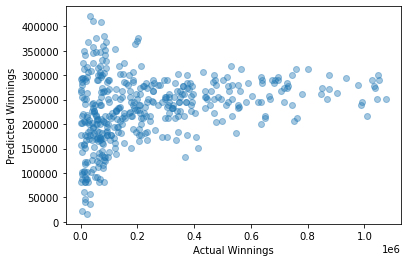

Train score for predicting Winnings from ReturnPointsWon and ReturnGamesWon: 0.0387021891466367
Test score for predicting Winnings from ReturnPointsWon and ReturnGamesWon: 0.04525836287078022 



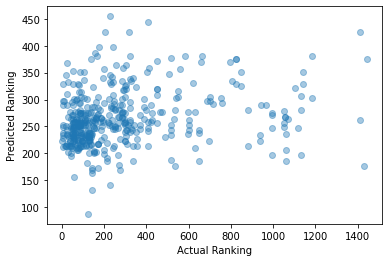

Train score for predicting Winnings from ReturnPointsWon and ServiceGamesPlayed: 0.8709512156899764
Test score for predicting Winnings from ReturnPointsWon and ServiceGamesPlayed: 0.8408254157319839 



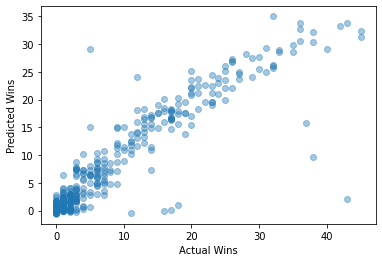

Train score for predicting Winnings from ReturnPointsWon and ServiceGamesPlayed: 0.8668274171521035
Test score for predicting Winnings from ReturnPointsWon and ServiceGamesPlayed: 0.8979900715176756 



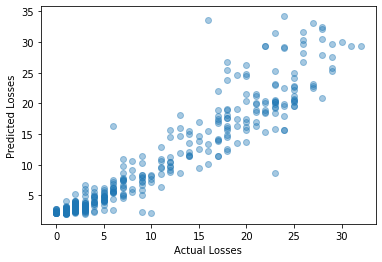

Train score for predicting Winnings from ReturnPointsWon and ServiceGamesPlayed: 0.8372521872566898
Test score for predicting Winnings from ReturnPointsWon and ServiceGamesPlayed: 0.8210433698687534 



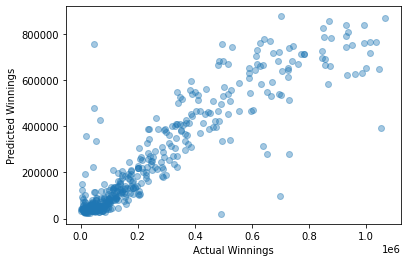

Train score for predicting Winnings from ReturnPointsWon and ServiceGamesPlayed: 0.11422124085074638
Test score for predicting Winnings from ReturnPointsWon and ServiceGamesPlayed: 0.13869900611637287 



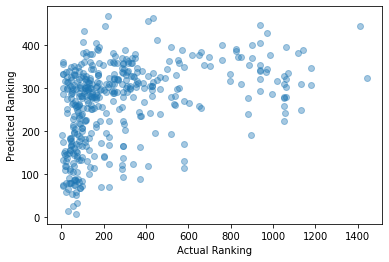

Train score for predicting Winnings from ReturnPointsWon and ServiceGamesWon: 0.20421901209912463
Test score for predicting Winnings from ReturnPointsWon and ServiceGamesWon: 0.2185926104837205 



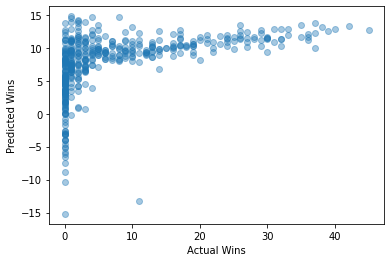

Train score for predicting Winnings from ReturnPointsWon and ServiceGamesWon: 0.1841933566217967
Test score for predicting Winnings from ReturnPointsWon and ServiceGamesWon: 0.19768671207384225 



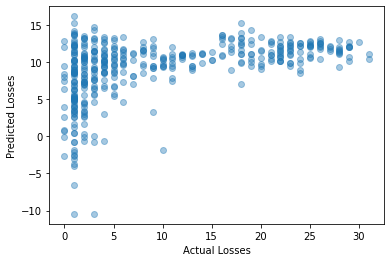

Train score for predicting Winnings from ReturnPointsWon and ServiceGamesWon: 0.20831192188628755
Test score for predicting Winnings from ReturnPointsWon and ServiceGamesWon: 0.21989623406780123 



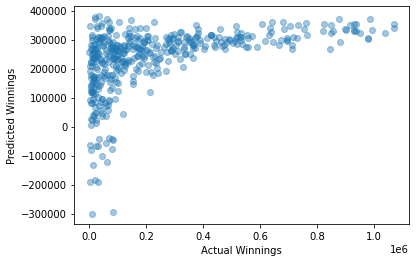

Train score for predicting Winnings from ReturnPointsWon and ServiceGamesWon: 0.08011722906018515
Test score for predicting Winnings from ReturnPointsWon and ServiceGamesWon: 0.04231013186142984 



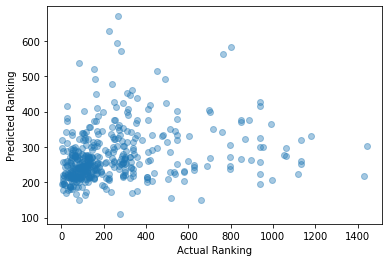

Train score for predicting Winnings from ReturnPointsWon and TotalPointsWon: 0.1997519616856922
Test score for predicting Winnings from ReturnPointsWon and TotalPointsWon: 0.24089528670748006 



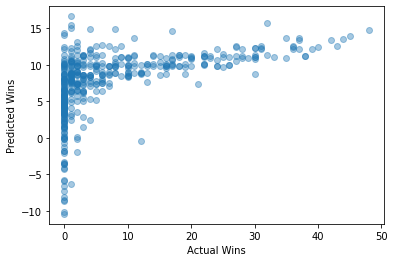

Train score for predicting Winnings from ReturnPointsWon and TotalPointsWon: 0.2169383852573096
Test score for predicting Winnings from ReturnPointsWon and TotalPointsWon: 0.05941788182798502 



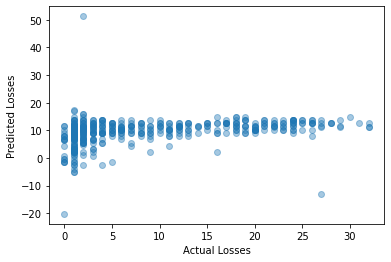

Train score for predicting Winnings from ReturnPointsWon and TotalPointsWon: 0.20868490692134933
Test score for predicting Winnings from ReturnPointsWon and TotalPointsWon: 0.22429744141289554 



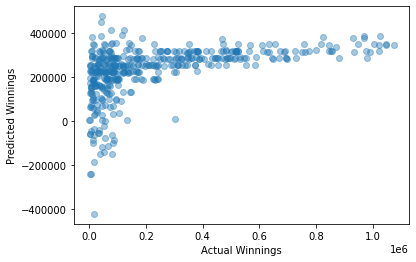

Train score for predicting Winnings from ReturnPointsWon and TotalPointsWon: 0.07865142597463559
Test score for predicting Winnings from ReturnPointsWon and TotalPointsWon: 0.07228015404992971 



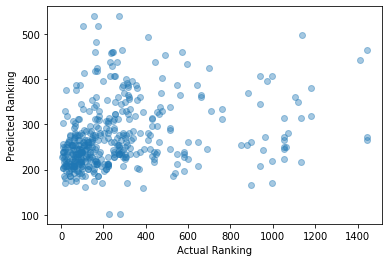

Train score for predicting Winnings from ReturnPointsWon and TotalServicePointsWon: 0.22991866628479152
Test score for predicting Winnings from ReturnPointsWon and TotalServicePointsWon: 0.22104196437394005 



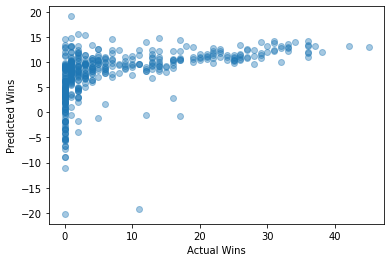

Train score for predicting Winnings from ReturnPointsWon and TotalServicePointsWon: 0.18797314843234747
Test score for predicting Winnings from ReturnPointsWon and TotalServicePointsWon: 0.23122018179844062 



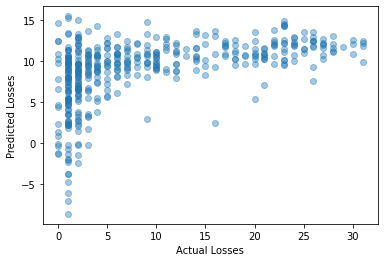

Train score for predicting Winnings from ReturnPointsWon and TotalServicePointsWon: 0.2265594500224608
Test score for predicting Winnings from ReturnPointsWon and TotalServicePointsWon: 0.2396845683953699 



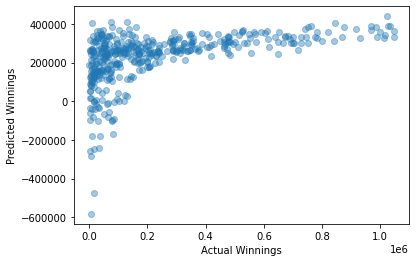

Train score for predicting Winnings from ReturnPointsWon and TotalServicePointsWon: 0.07793581651736459
Test score for predicting Winnings from ReturnPointsWon and TotalServicePointsWon: 0.08757497627256938 



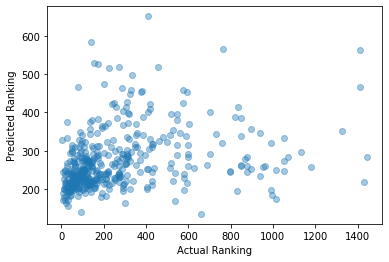

Train score for predicting Winnings from ServiceGamesPlayed and FirstServe: 0.874872758083959
Test score for predicting Winnings from ServiceGamesPlayed and FirstServe: 0.8250672187552628 



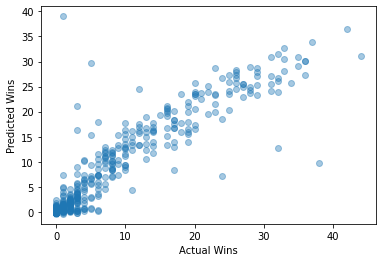

Train score for predicting Winnings from ServiceGamesPlayed and FirstServe: 0.8660989507510679
Test score for predicting Winnings from ServiceGamesPlayed and FirstServe: 0.8994090439980913 



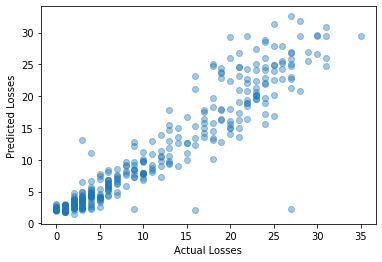

Train score for predicting Winnings from ServiceGamesPlayed and FirstServe: 0.8415141756971839
Test score for predicting Winnings from ServiceGamesPlayed and FirstServe: 0.8093526712042585 



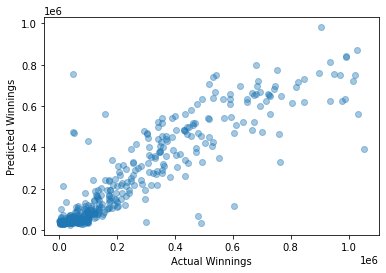

Train score for predicting Winnings from ServiceGamesPlayed and FirstServe: 0.10502758059938254
Test score for predicting Winnings from ServiceGamesPlayed and FirstServe: 0.1240360406517206 



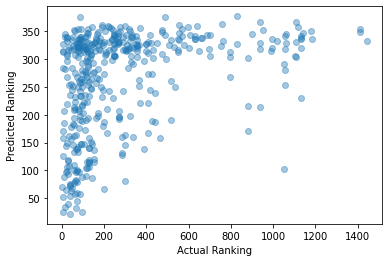

Train score for predicting Winnings from ServiceGamesPlayed and FirstServePointsWon: 0.8568142225869322
Test score for predicting Winnings from ServiceGamesPlayed and FirstServePointsWon: 0.8839435141841057 



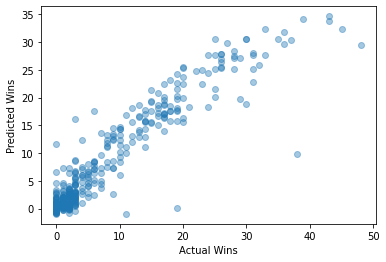

Train score for predicting Winnings from ServiceGamesPlayed and FirstServePointsWon: 0.8699806945865076
Test score for predicting Winnings from ServiceGamesPlayed and FirstServePointsWon: 0.8894189278143982 



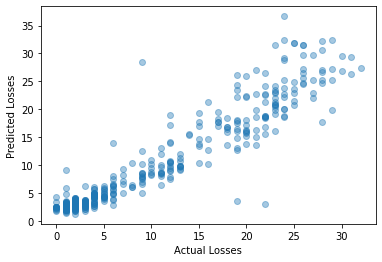

Train score for predicting Winnings from ServiceGamesPlayed and FirstServePointsWon: 0.8285429985019264
Test score for predicting Winnings from ServiceGamesPlayed and FirstServePointsWon: 0.8519846394977655 



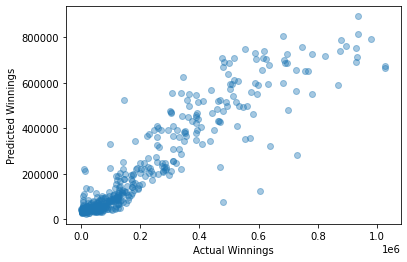

Train score for predicting Winnings from ServiceGamesPlayed and FirstServePointsWon: 0.1049686642198212
Test score for predicting Winnings from ServiceGamesPlayed and FirstServePointsWon: 0.12394720794113745 



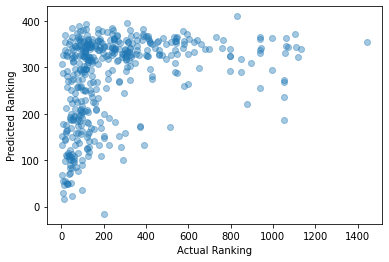

Train score for predicting Winnings from ServiceGamesPlayed and FirstServeReturnPointsWon: 0.8575814245814034
Test score for predicting Winnings from ServiceGamesPlayed and FirstServeReturnPointsWon: 0.8826422099691987 



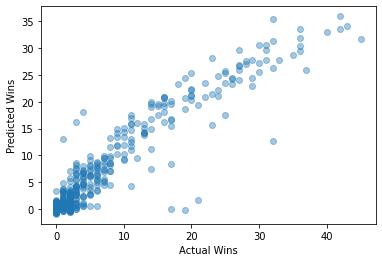

Train score for predicting Winnings from ServiceGamesPlayed and FirstServeReturnPointsWon: 0.8856220346948946
Test score for predicting Winnings from ServiceGamesPlayed and FirstServeReturnPointsWon: 0.8415867900990087 



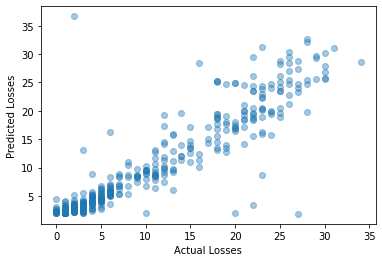

Train score for predicting Winnings from ServiceGamesPlayed and FirstServeReturnPointsWon: 0.8216141720532931
Test score for predicting Winnings from ServiceGamesPlayed and FirstServeReturnPointsWon: 0.8678321722910531 



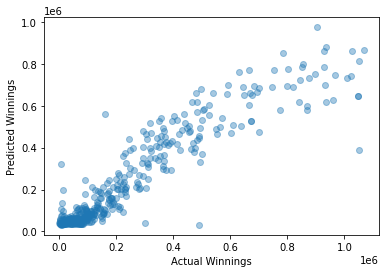

Train score for predicting Winnings from ServiceGamesPlayed and FirstServeReturnPointsWon: 0.1179143598501653
Test score for predicting Winnings from ServiceGamesPlayed and FirstServeReturnPointsWon: 0.11760080564218367 



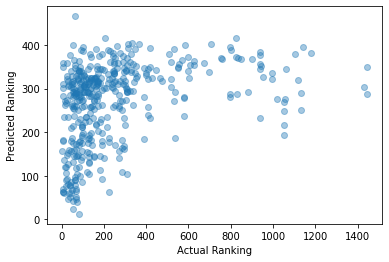

Train score for predicting Winnings from ServiceGamesPlayed and SecondServePointsWon: 0.8471183127666894
Test score for predicting Winnings from ServiceGamesPlayed and SecondServePointsWon: 0.9147702307113916 



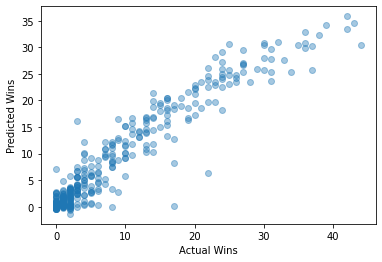

Train score for predicting Winnings from ServiceGamesPlayed and SecondServePointsWon: 0.8705458029274469
Test score for predicting Winnings from ServiceGamesPlayed and SecondServePointsWon: 0.8901267468384809 



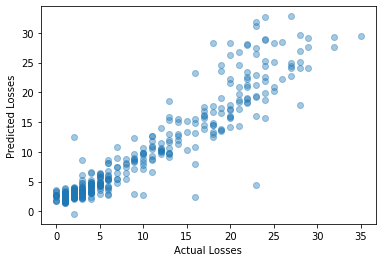

Train score for predicting Winnings from ServiceGamesPlayed and SecondServePointsWon: 0.8302752852652943
Test score for predicting Winnings from ServiceGamesPlayed and SecondServePointsWon: 0.8433384546552813 



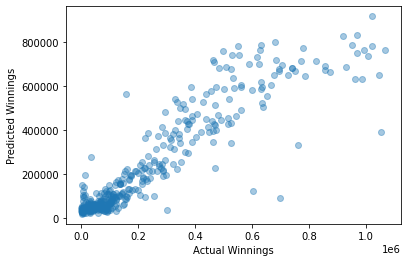

Train score for predicting Winnings from ServiceGamesPlayed and SecondServePointsWon: 0.10640348784427256
Test score for predicting Winnings from ServiceGamesPlayed and SecondServePointsWon: 0.15110690496665027 



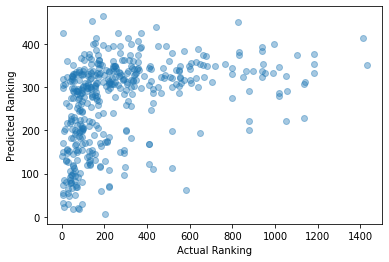

Train score for predicting Winnings from ServiceGamesPlayed and SecondServeReturnPointsWon: 0.8677442372148387
Test score for predicting Winnings from ServiceGamesPlayed and SecondServeReturnPointsWon: 0.8498590534580576 



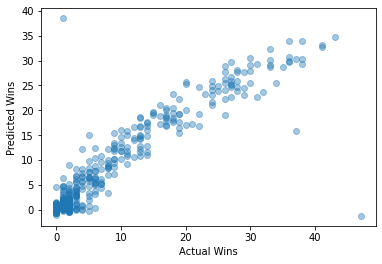

Train score for predicting Winnings from ServiceGamesPlayed and SecondServeReturnPointsWon: 0.8727772750523123
Test score for predicting Winnings from ServiceGamesPlayed and SecondServeReturnPointsWon: 0.8801221203155887 



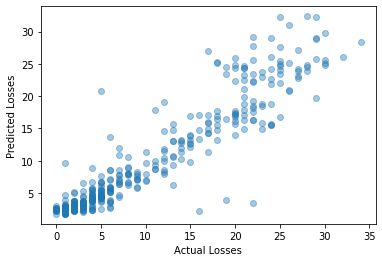

Train score for predicting Winnings from ServiceGamesPlayed and SecondServeReturnPointsWon: 0.8322809339634223
Test score for predicting Winnings from ServiceGamesPlayed and SecondServeReturnPointsWon: 0.836226307825028 



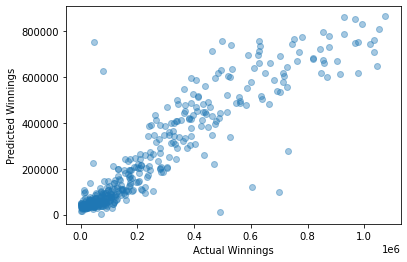

Train score for predicting Winnings from ServiceGamesPlayed and SecondServeReturnPointsWon: 0.1304370735188236
Test score for predicting Winnings from ServiceGamesPlayed and SecondServeReturnPointsWon: 0.07892392825917038 



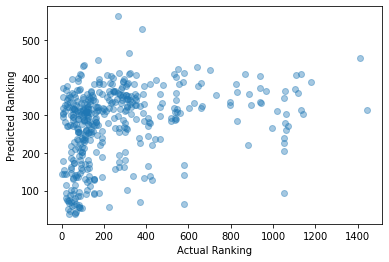

Train score for predicting Winnings from ServiceGamesPlayed and Aces: 0.8701474135638197
Test score for predicting Winnings from ServiceGamesPlayed and Aces: 0.8493099285437604 



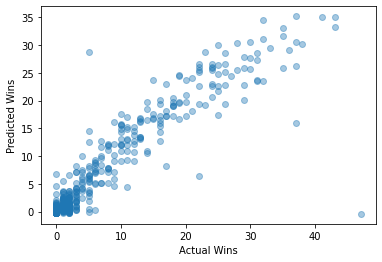

Train score for predicting Winnings from ServiceGamesPlayed and Aces: 0.8867298991393342
Test score for predicting Winnings from ServiceGamesPlayed and Aces: 0.8654636016442746 



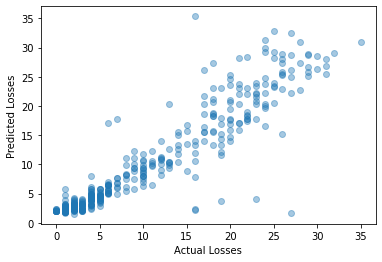

Train score for predicting Winnings from ServiceGamesPlayed and Aces: 0.8235440149034324
Test score for predicting Winnings from ServiceGamesPlayed and Aces: 0.863631466216883 



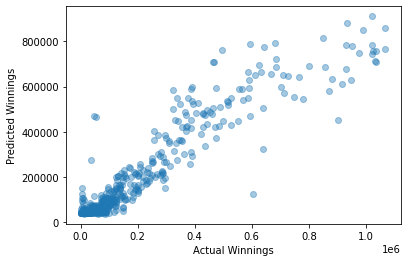

Train score for predicting Winnings from ServiceGamesPlayed and Aces: 0.12912876098384707
Test score for predicting Winnings from ServiceGamesPlayed and Aces: 0.020636779655971105 



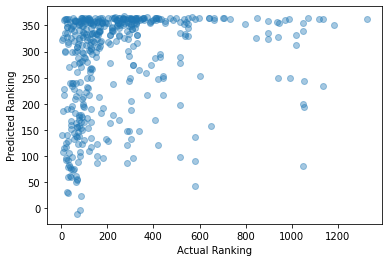

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsConverted: 0.8673933858688176
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsConverted: 0.8515151033350631 



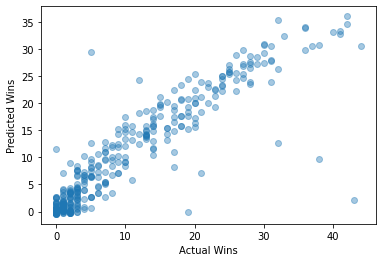

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsConverted: 0.8754437696732279
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsConverted: 0.8723589443123891 



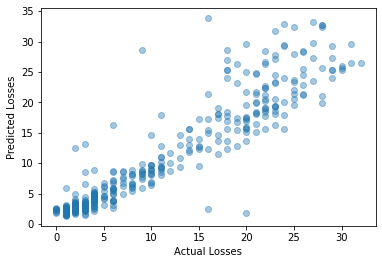

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsConverted: 0.8337453962295823
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsConverted: 0.8327962849439863 



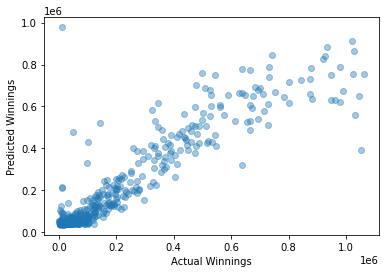

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsConverted: 0.10732769975637746
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsConverted: 0.11219961727130467 



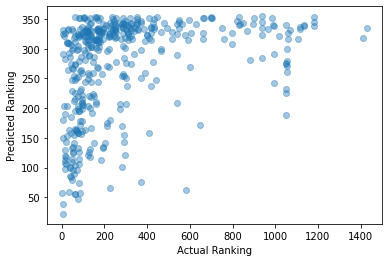

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsFaced: 0.8659518796518255
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsFaced: 0.8801039509767415 



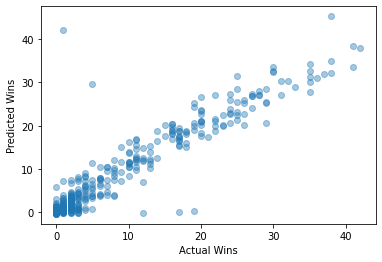

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsFaced: 0.8862787450335724
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsFaced: 0.9232072286395346 



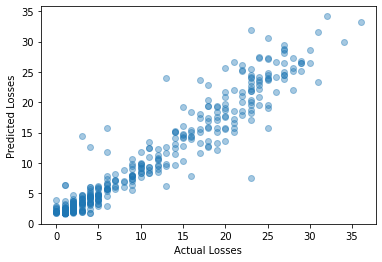

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsFaced: 0.8443225084652518
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsFaced: 0.8087450537967134 



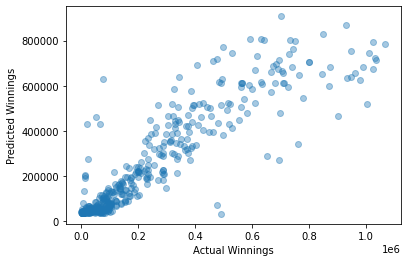

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsFaced: 0.12162292328845427
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsFaced: 0.058474957619024104 



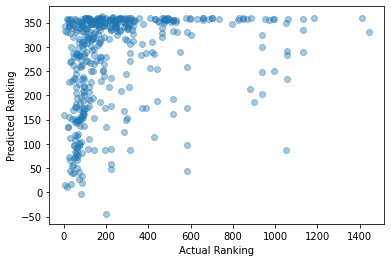

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsOpportunities: 0.8503508734671458
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsOpportunities: 0.9207612888468762 



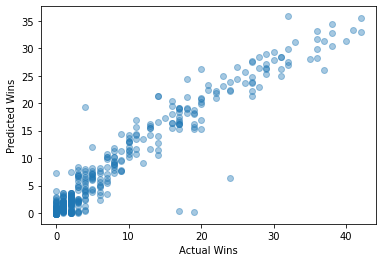

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsOpportunities: 0.8818153433479342
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsOpportunities: 0.8554592382789321 



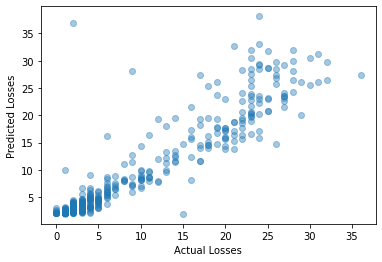

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsOpportunities: 0.835769695334936
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsOpportunities: 0.830255330539213 



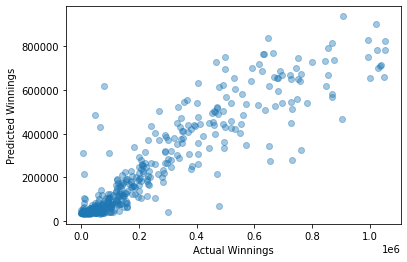

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsOpportunities: 0.11687942185163935
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsOpportunities: 0.08891998259198675 



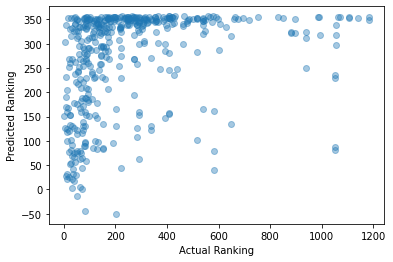

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsSaved: 0.8911695258529224
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsSaved: 0.7734070042796809 



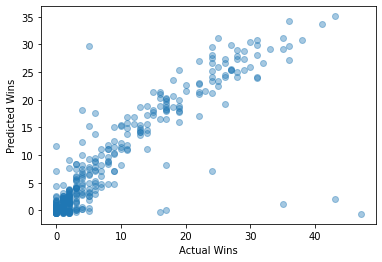

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsSaved: 0.8719337877791352
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsSaved: 0.8827176410061004 



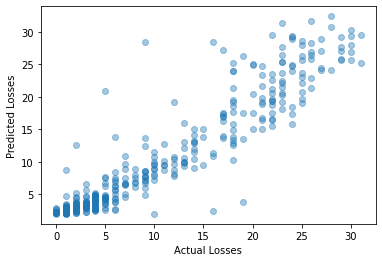

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsSaved: 0.8331341605200675
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsSaved: 0.8343698065016678 



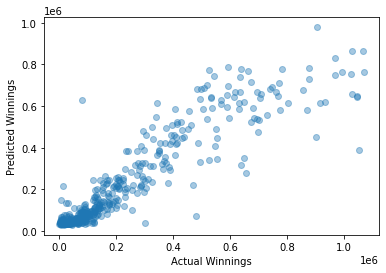

Train score for predicting Winnings from ServiceGamesPlayed and BreakPointsSaved: 0.12039211313381626
Test score for predicting Winnings from ServiceGamesPlayed and BreakPointsSaved: 0.07752237271457196 



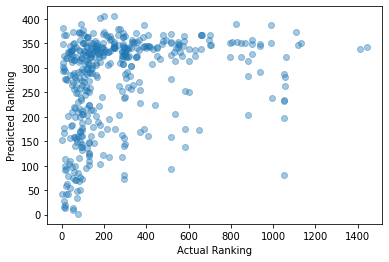

Train score for predicting Winnings from ServiceGamesPlayed and DoubleFaults: 0.8522078720604942
Test score for predicting Winnings from ServiceGamesPlayed and DoubleFaults: 0.8994892209567625 



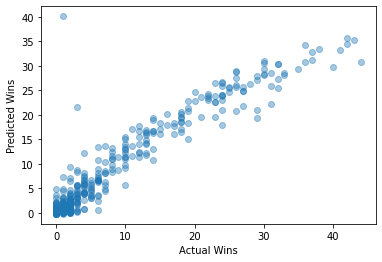

Train score for predicting Winnings from ServiceGamesPlayed and DoubleFaults: 0.8760910275262979
Test score for predicting Winnings from ServiceGamesPlayed and DoubleFaults: 0.8768542091334068 



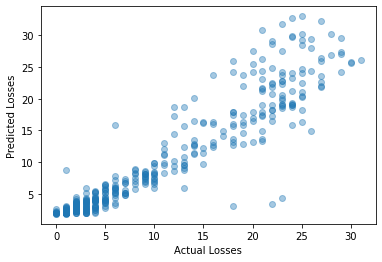

Train score for predicting Winnings from ServiceGamesPlayed and DoubleFaults: 0.836528824209358
Test score for predicting Winnings from ServiceGamesPlayed and DoubleFaults: 0.8267596119977678 



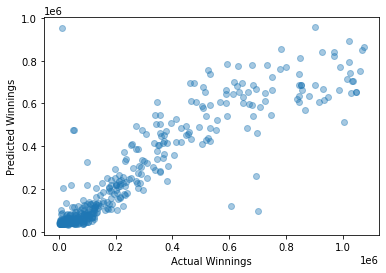

Train score for predicting Winnings from ServiceGamesPlayed and DoubleFaults: 0.09703811432470542
Test score for predicting Winnings from ServiceGamesPlayed and DoubleFaults: 0.14399560459497251 



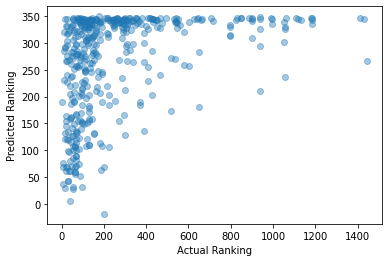

Train score for predicting Winnings from ServiceGamesPlayed and ReturnGamesPlayed: 0.8869085321450539
Test score for predicting Winnings from ServiceGamesPlayed and ReturnGamesPlayed: 0.7958255923878789 



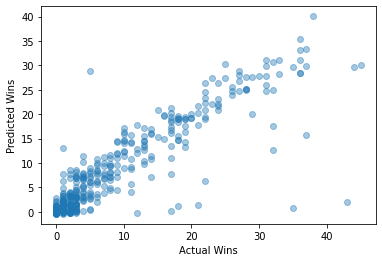

Train score for predicting Winnings from ServiceGamesPlayed and ReturnGamesPlayed: 0.8696547627198962
Test score for predicting Winnings from ServiceGamesPlayed and ReturnGamesPlayed: 0.9237121646484524 



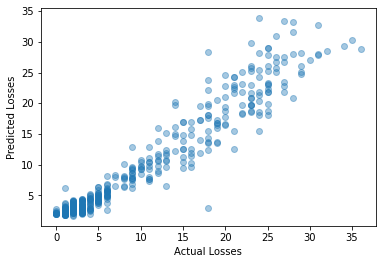

Train score for predicting Winnings from ServiceGamesPlayed and ReturnGamesPlayed: 0.8236940927589909
Test score for predicting Winnings from ServiceGamesPlayed and ReturnGamesPlayed: 0.864881237607137 



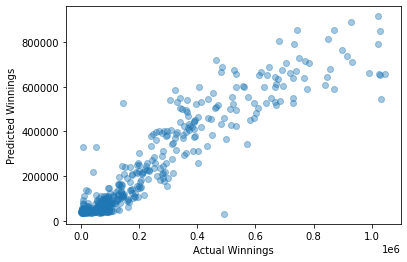

Train score for predicting Winnings from ServiceGamesPlayed and ReturnGamesPlayed: 0.11409579833392103
Test score for predicting Winnings from ServiceGamesPlayed and ReturnGamesPlayed: 0.0972703064796322 



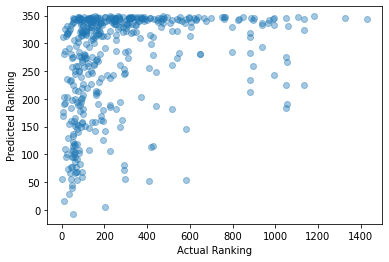

Train score for predicting Winnings from ServiceGamesPlayed and ReturnGamesWon: 0.8539058355774672
Test score for predicting Winnings from ServiceGamesPlayed and ReturnGamesWon: 0.8978615666869383 



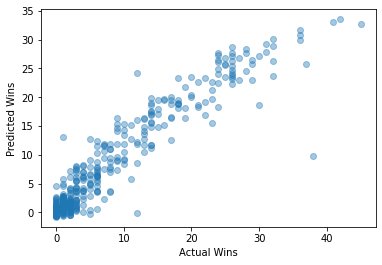

Train score for predicting Winnings from ServiceGamesPlayed and ReturnGamesWon: 0.8760462397644778
Test score for predicting Winnings from ServiceGamesPlayed and ReturnGamesWon: 0.8706250978935122 



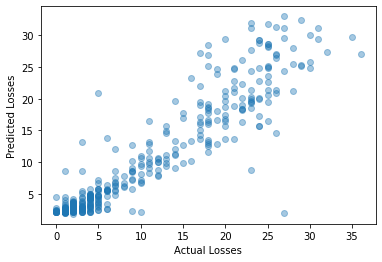

Train score for predicting Winnings from ServiceGamesPlayed and ReturnGamesWon: 0.8325899184829613
Test score for predicting Winnings from ServiceGamesPlayed and ReturnGamesWon: 0.8335298632385282 



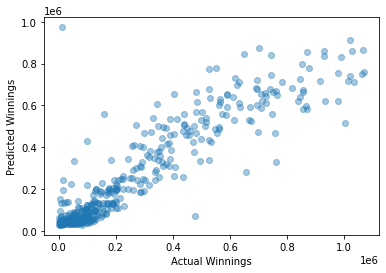

Train score for predicting Winnings from ServiceGamesPlayed and ReturnGamesWon: 0.12064854711933581
Test score for predicting Winnings from ServiceGamesPlayed and ReturnGamesWon: 0.11299806645317591 



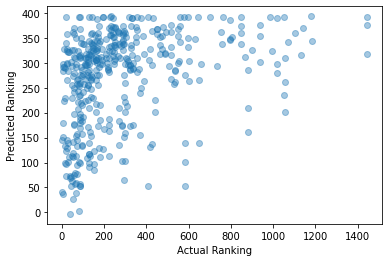

Train score for predicting Winnings from ServiceGamesPlayed and ReturnPointsWon: 0.8601521238349171
Test score for predicting Winnings from ServiceGamesPlayed and ReturnPointsWon: 0.8726944809972477 



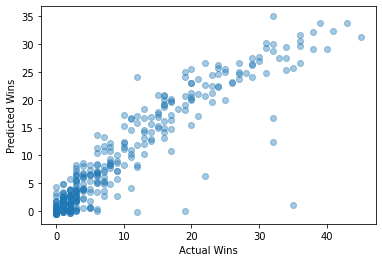

Train score for predicting Winnings from ServiceGamesPlayed and ReturnPointsWon: 0.8688268232328986
Test score for predicting Winnings from ServiceGamesPlayed and ReturnPointsWon: 0.8926955520224067 



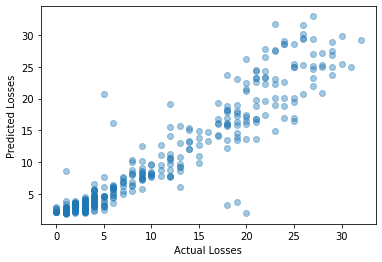

Train score for predicting Winnings from ServiceGamesPlayed and ReturnPointsWon: 0.838886427388184
Test score for predicting Winnings from ServiceGamesPlayed and ReturnPointsWon: 0.818579327366647 



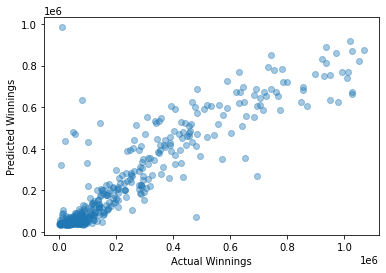

Train score for predicting Winnings from ServiceGamesPlayed and ReturnPointsWon: 0.13401472429450778
Test score for predicting Winnings from ServiceGamesPlayed and ReturnPointsWon: 0.0882455001203023 



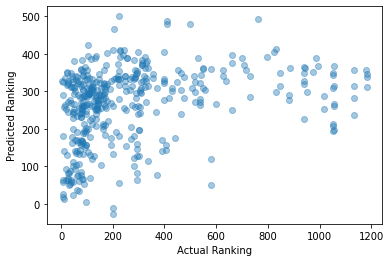

Train score for predicting Winnings from ServiceGamesPlayed and ServiceGamesWon: 0.8692165484660839
Test score for predicting Winnings from ServiceGamesPlayed and ServiceGamesWon: 0.8475643423050433 



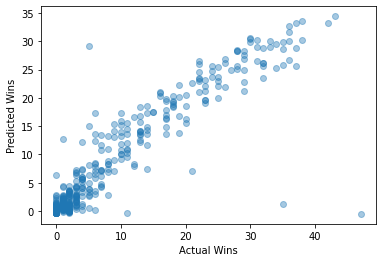

Train score for predicting Winnings from ServiceGamesPlayed and ServiceGamesWon: 0.8697307159791892
Test score for predicting Winnings from ServiceGamesPlayed and ServiceGamesWon: 0.8930663004465713 



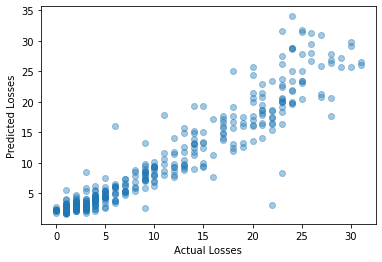

Train score for predicting Winnings from ServiceGamesPlayed and ServiceGamesWon: 0.8382853809748476
Test score for predicting Winnings from ServiceGamesPlayed and ServiceGamesWon: 0.8201119201059467 



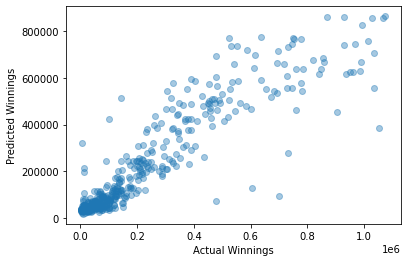

Train score for predicting Winnings from ServiceGamesPlayed and ServiceGamesWon: 0.11085434630752244
Test score for predicting Winnings from ServiceGamesPlayed and ServiceGamesWon: 0.1214019806004708 



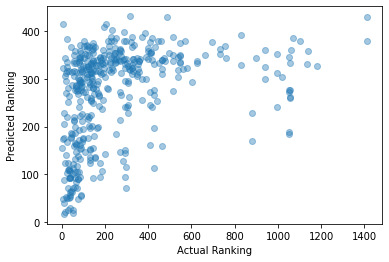

Train score for predicting Winnings from ServiceGamesPlayed and TotalPointsWon: 0.8665799383272652
Test score for predicting Winnings from ServiceGamesPlayed and TotalPointsWon: 0.8528060107361158 



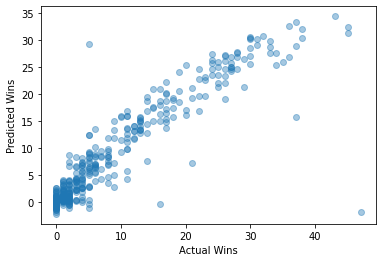

Train score for predicting Winnings from ServiceGamesPlayed and TotalPointsWon: 0.8717154539700377
Test score for predicting Winnings from ServiceGamesPlayed and TotalPointsWon: 0.8873878935535612 



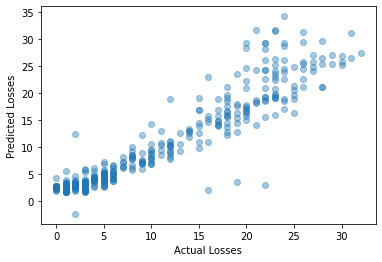

Train score for predicting Winnings from ServiceGamesPlayed and TotalPointsWon: 0.8346877564672687
Test score for predicting Winnings from ServiceGamesPlayed and TotalPointsWon: 0.8298960344257821 



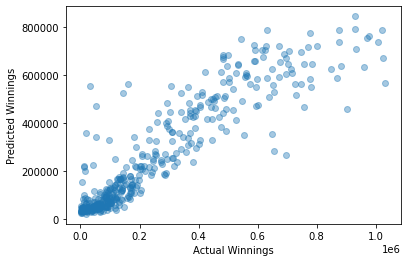

Train score for predicting Winnings from ServiceGamesPlayed and TotalPointsWon: 0.12652957896701478
Test score for predicting Winnings from ServiceGamesPlayed and TotalPointsWon: 0.12332244642186163 



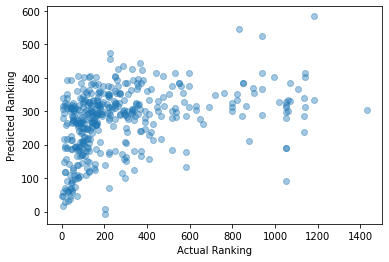

Train score for predicting Winnings from ServiceGamesPlayed and TotalServicePointsWon: 0.8508507696929
Test score for predicting Winnings from ServiceGamesPlayed and TotalServicePointsWon: 0.9033916103343586 



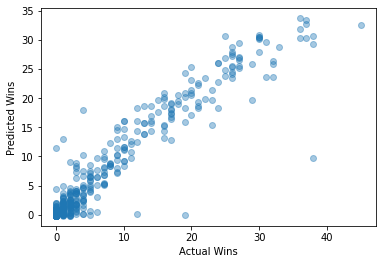

Train score for predicting Winnings from ServiceGamesPlayed and TotalServicePointsWon: 0.8637607364452826
Test score for predicting Winnings from ServiceGamesPlayed and TotalServicePointsWon: 0.9097533625632988 



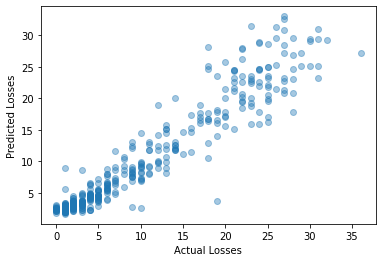

Train score for predicting Winnings from ServiceGamesPlayed and TotalServicePointsWon: 0.8292748286521988
Test score for predicting Winnings from ServiceGamesPlayed and TotalServicePointsWon: 0.8482784607304995 



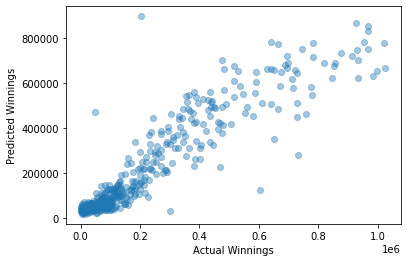

Train score for predicting Winnings from ServiceGamesPlayed and TotalServicePointsWon: 0.12008246466677053
Test score for predicting Winnings from ServiceGamesPlayed and TotalServicePointsWon: 0.09289640018246703 



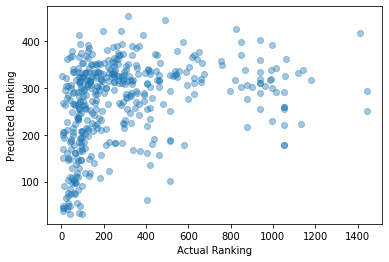

Train score for predicting Winnings from ServiceGamesWon and FirstServe: 0.14711612398851226
Test score for predicting Winnings from ServiceGamesWon and FirstServe: 0.15238730353559682 



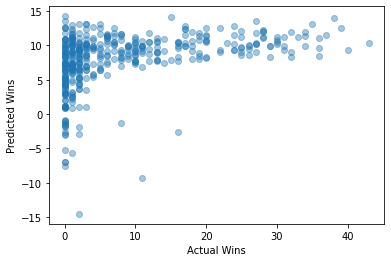

Train score for predicting Winnings from ServiceGamesWon and FirstServe: 0.1532830900304385
Test score for predicting Winnings from ServiceGamesWon and FirstServe: 0.08139172159982 



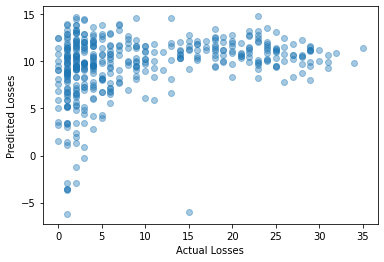

Train score for predicting Winnings from ServiceGamesWon and FirstServe: 0.15751359596860492
Test score for predicting Winnings from ServiceGamesWon and FirstServe: 0.1525511201399925 



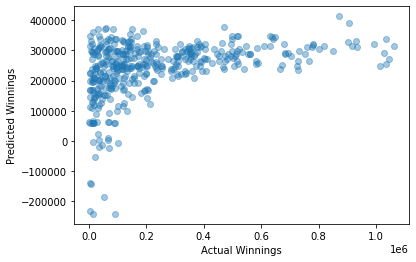

Train score for predicting Winnings from ServiceGamesWon and FirstServe: 0.031656451416611886
Test score for predicting Winnings from ServiceGamesWon and FirstServe: 0.06475877291691501 



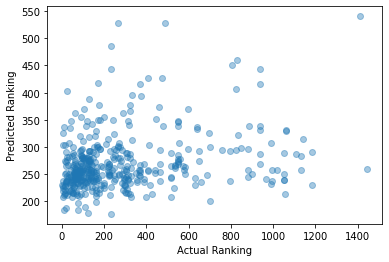

Train score for predicting Winnings from ServiceGamesWon and FirstServePointsWon: 0.14960426836660912
Test score for predicting Winnings from ServiceGamesWon and FirstServePointsWon: 0.15953263915024807 



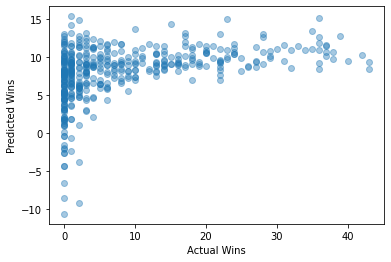

Train score for predicting Winnings from ServiceGamesWon and FirstServePointsWon: 0.14307995397560236
Test score for predicting Winnings from ServiceGamesWon and FirstServePointsWon: 0.1208139448491098 



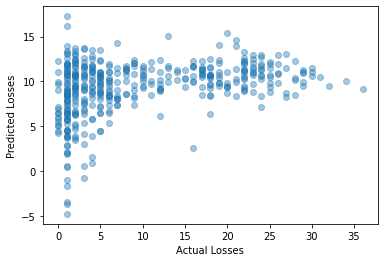

Train score for predicting Winnings from ServiceGamesWon and FirstServePointsWon: 0.16806125356905244
Test score for predicting Winnings from ServiceGamesWon and FirstServePointsWon: 0.13632445521410752 



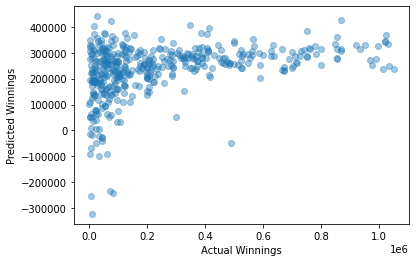

Train score for predicting Winnings from ServiceGamesWon and FirstServePointsWon: 0.04383747145914341
Test score for predicting Winnings from ServiceGamesWon and FirstServePointsWon: 0.015165664187442585 



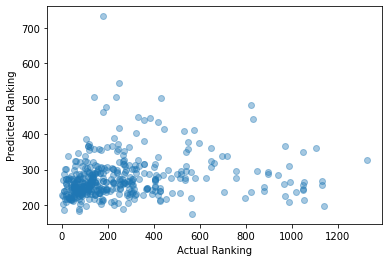

Train score for predicting Winnings from ServiceGamesWon and FirstServeReturnPointsWon: 0.1844223176552755
Test score for predicting Winnings from ServiceGamesWon and FirstServeReturnPointsWon: 0.22729737557534824 



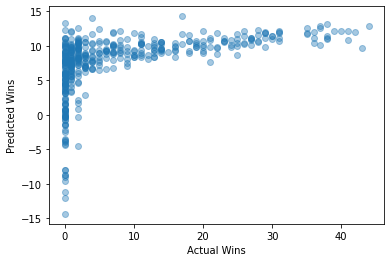

Train score for predicting Winnings from ServiceGamesWon and FirstServeReturnPointsWon: 0.17991248635506119
Test score for predicting Winnings from ServiceGamesWon and FirstServeReturnPointsWon: 0.17632393880981023 



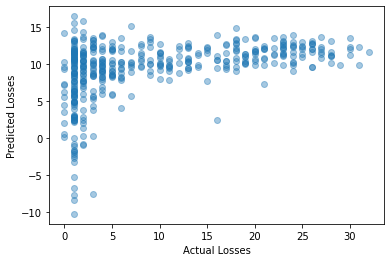

Train score for predicting Winnings from ServiceGamesWon and FirstServeReturnPointsWon: 0.19722891053175506
Test score for predicting Winnings from ServiceGamesWon and FirstServeReturnPointsWon: 0.19787934651869032 



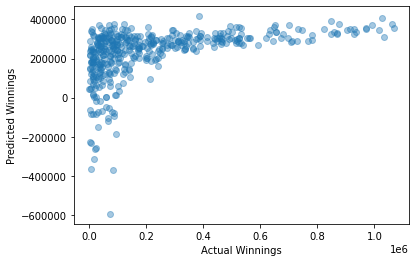

Train score for predicting Winnings from ServiceGamesWon and FirstServeReturnPointsWon: 0.05351181513934122
Test score for predicting Winnings from ServiceGamesWon and FirstServeReturnPointsWon: 0.09582973207967105 



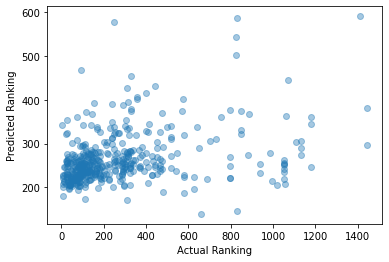

Train score for predicting Winnings from ServiceGamesWon and SecondServePointsWon: 0.13995944016337525
Test score for predicting Winnings from ServiceGamesWon and SecondServePointsWon: 0.17664783229554215 



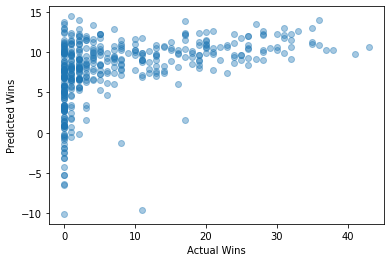

Train score for predicting Winnings from ServiceGamesWon and SecondServePointsWon: 0.14515635308800523
Test score for predicting Winnings from ServiceGamesWon and SecondServePointsWon: 0.09940225960729043 



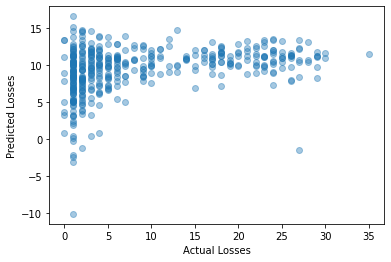

Train score for predicting Winnings from ServiceGamesWon and SecondServePointsWon: 0.15945312851736393
Test score for predicting Winnings from ServiceGamesWon and SecondServePointsWon: 0.14130114273874772 



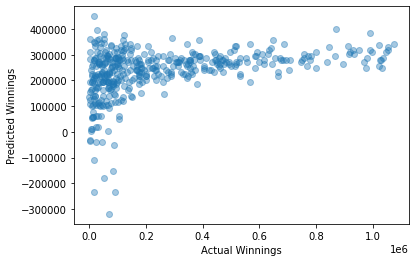

Train score for predicting Winnings from ServiceGamesWon and SecondServePointsWon: 0.04286748227867576
Test score for predicting Winnings from ServiceGamesWon and SecondServePointsWon: 0.046095962737478735 



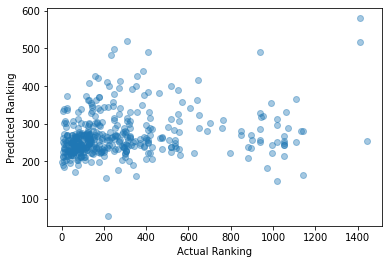

Train score for predicting Winnings from ServiceGamesWon and SecondServeReturnPointsWon: 0.19368679343113715
Test score for predicting Winnings from ServiceGamesWon and SecondServeReturnPointsWon: 0.10500822520844533 



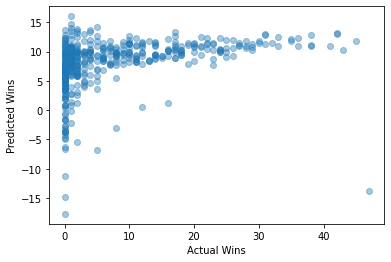

Train score for predicting Winnings from ServiceGamesWon and SecondServeReturnPointsWon: 0.14707434365489092
Test score for predicting Winnings from ServiceGamesWon and SecondServeReturnPointsWon: 0.18708384150989787 



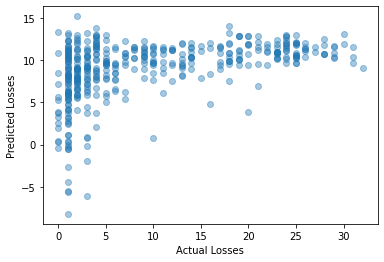

Train score for predicting Winnings from ServiceGamesWon and SecondServeReturnPointsWon: 0.17901612996738514
Test score for predicting Winnings from ServiceGamesWon and SecondServeReturnPointsWon: 0.18690871747260018 



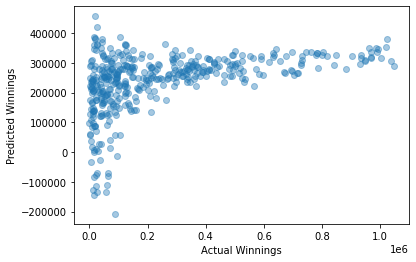

Train score for predicting Winnings from ServiceGamesWon and SecondServeReturnPointsWon: 0.07038165317263889
Test score for predicting Winnings from ServiceGamesWon and SecondServeReturnPointsWon: 0.021420708169542113 



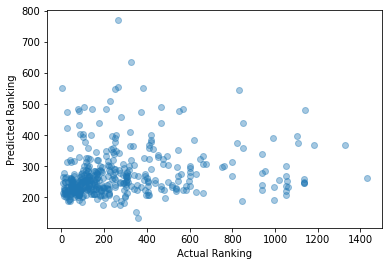

Train score for predicting Winnings from ServiceGamesWon and Aces: 0.6828908791946313
Test score for predicting Winnings from ServiceGamesWon and Aces: 0.6761082159636882 



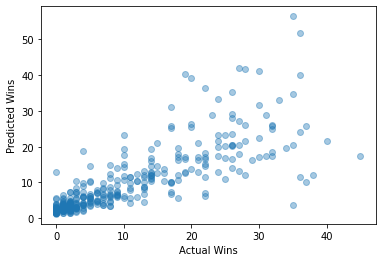

Train score for predicting Winnings from ServiceGamesWon and Aces: 0.5743615141470724
Test score for predicting Winnings from ServiceGamesWon and Aces: 0.6422906840597318 



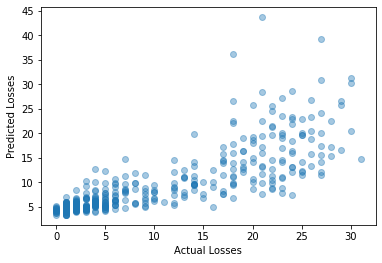

Train score for predicting Winnings from ServiceGamesWon and Aces: 0.6331374464961586
Test score for predicting Winnings from ServiceGamesWon and Aces: 0.6605562089662043 



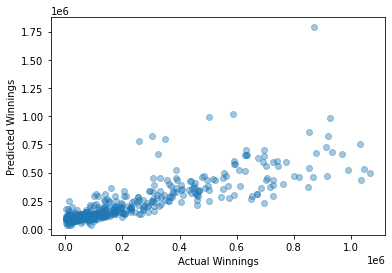

Train score for predicting Winnings from ServiceGamesWon and Aces: 0.07385861669226024
Test score for predicting Winnings from ServiceGamesWon and Aces: 0.11242945536154259 



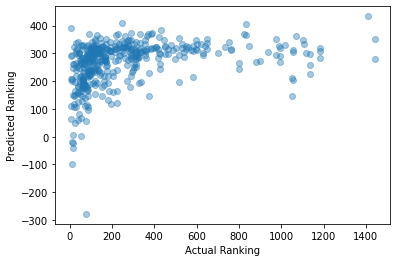

Train score for predicting Winnings from ServiceGamesWon and BreakPointsConverted: 0.14250632739773306
Test score for predicting Winnings from ServiceGamesWon and BreakPointsConverted: 0.16136487635905405 



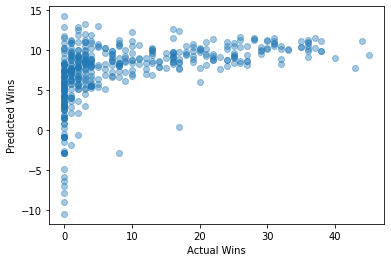

Train score for predicting Winnings from ServiceGamesWon and BreakPointsConverted: 0.14467328524722933
Test score for predicting Winnings from ServiceGamesWon and BreakPointsConverted: 0.1254595564772344 



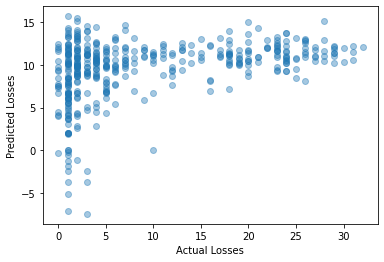

Train score for predicting Winnings from ServiceGamesWon and BreakPointsConverted: 0.16172749786477147
Test score for predicting Winnings from ServiceGamesWon and BreakPointsConverted: 0.16683170271035108 



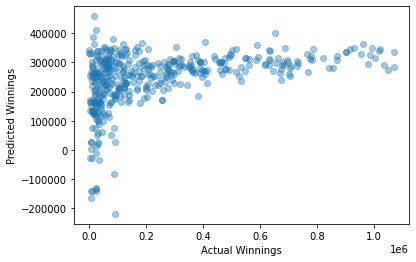

Train score for predicting Winnings from ServiceGamesWon and BreakPointsConverted: 0.04331455925913352
Test score for predicting Winnings from ServiceGamesWon and BreakPointsConverted: 0.034675244301957675 



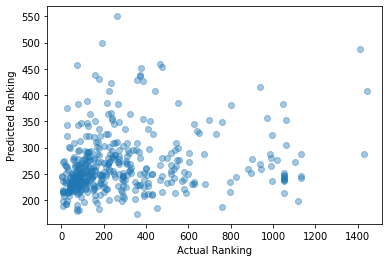

Train score for predicting Winnings from ServiceGamesWon and BreakPointsFaced: 0.7817272609865838
Test score for predicting Winnings from ServiceGamesWon and BreakPointsFaced: 0.8001987364542357 



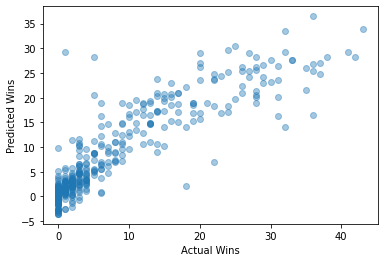

Train score for predicting Winnings from ServiceGamesWon and BreakPointsFaced: 0.8823918655151762
Test score for predicting Winnings from ServiceGamesWon and BreakPointsFaced: 0.9137554463720271 



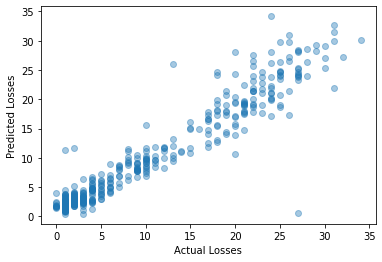

Train score for predicting Winnings from ServiceGamesWon and BreakPointsFaced: 0.7671923302272396
Test score for predicting Winnings from ServiceGamesWon and BreakPointsFaced: 0.799945101843605 



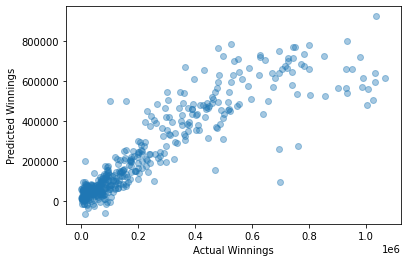

Train score for predicting Winnings from ServiceGamesWon and BreakPointsFaced: 0.10064703263112762
Test score for predicting Winnings from ServiceGamesWon and BreakPointsFaced: 0.1426145904650996 



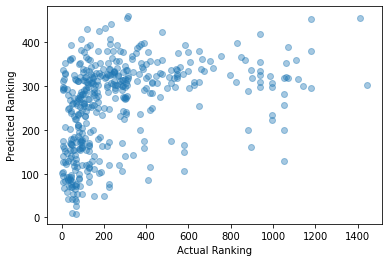

Train score for predicting Winnings from ServiceGamesWon and BreakPointsOpportunities: 0.8401968346553406
Test score for predicting Winnings from ServiceGamesWon and BreakPointsOpportunities: 0.9027965822545225 



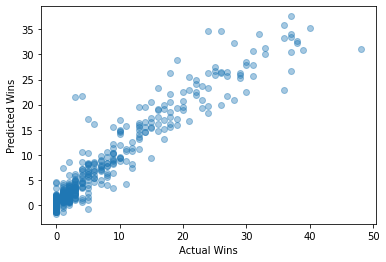

Train score for predicting Winnings from ServiceGamesWon and BreakPointsOpportunities: 0.8243737898924539
Test score for predicting Winnings from ServiceGamesWon and BreakPointsOpportunities: 0.8381035890539433 



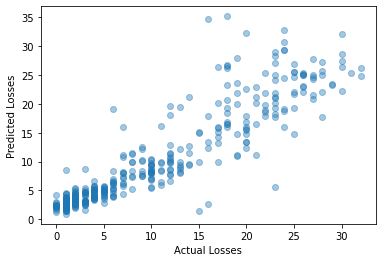

Train score for predicting Winnings from ServiceGamesWon and BreakPointsOpportunities: 0.8141340036404854
Test score for predicting Winnings from ServiceGamesWon and BreakPointsOpportunities: 0.8173078326732947 



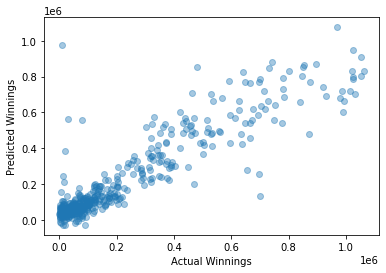

Train score for predicting Winnings from ServiceGamesWon and BreakPointsOpportunities: 0.11259818833969726
Test score for predicting Winnings from ServiceGamesWon and BreakPointsOpportunities: 0.13022845163280294 



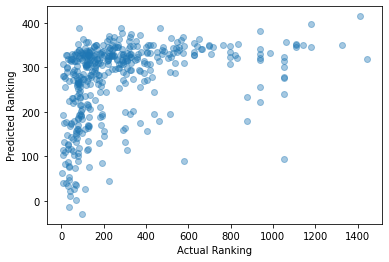

Train score for predicting Winnings from ServiceGamesWon and BreakPointsSaved: 0.16109680084114986
Test score for predicting Winnings from ServiceGamesWon and BreakPointsSaved: 0.1238302881789002 



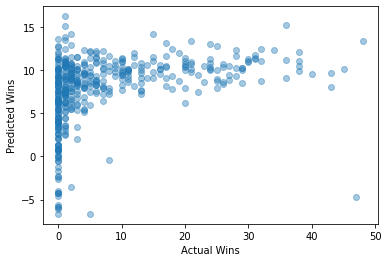

Train score for predicting Winnings from ServiceGamesWon and BreakPointsSaved: 0.134244241511291
Test score for predicting Winnings from ServiceGamesWon and BreakPointsSaved: 0.15140037270600515 



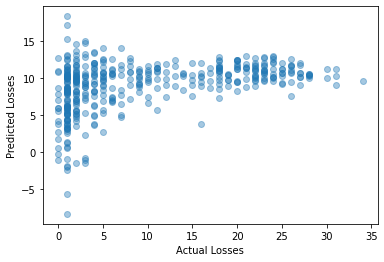

Train score for predicting Winnings from ServiceGamesWon and BreakPointsSaved: 0.15466309387167054
Test score for predicting Winnings from ServiceGamesWon and BreakPointsSaved: 0.17583339384688038 



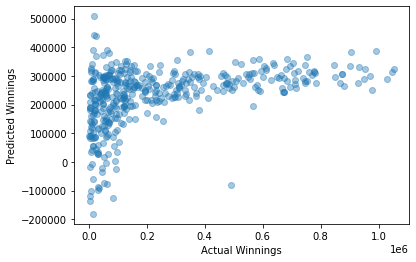

Train score for predicting Winnings from ServiceGamesWon and BreakPointsSaved: 0.03811566408745326
Test score for predicting Winnings from ServiceGamesWon and BreakPointsSaved: 0.0444207053065967 



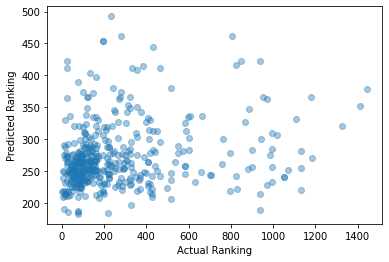

Train score for predicting Winnings from ServiceGamesWon and DoubleFaults: 0.719892611827719
Test score for predicting Winnings from ServiceGamesWon and DoubleFaults: 0.7306354755980105 



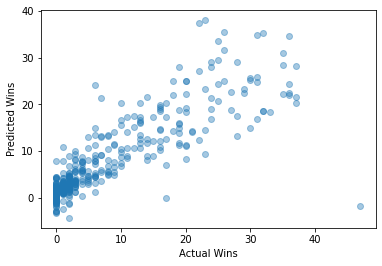

Train score for predicting Winnings from ServiceGamesWon and DoubleFaults: 0.784211675837741
Test score for predicting Winnings from ServiceGamesWon and DoubleFaults: 0.7634492429769569 



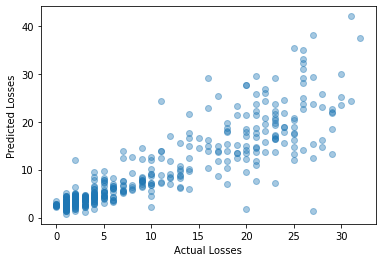

Train score for predicting Winnings from ServiceGamesWon and DoubleFaults: 0.7373898519119093
Test score for predicting Winnings from ServiceGamesWon and DoubleFaults: 0.7335888183972018 



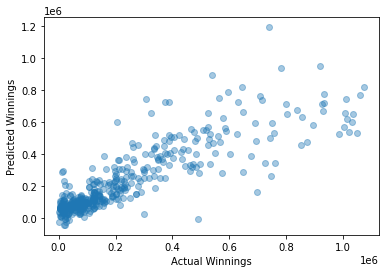

Train score for predicting Winnings from ServiceGamesWon and DoubleFaults: 0.10111554669406599
Test score for predicting Winnings from ServiceGamesWon and DoubleFaults: 0.10200965014997654 



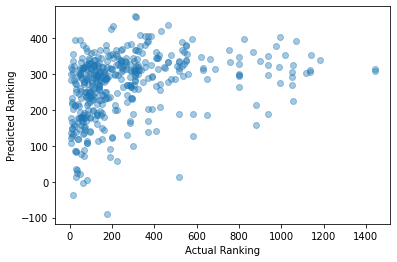

Train score for predicting Winnings from ServiceGamesWon and ReturnGamesPlayed: 0.866823550157592
Test score for predicting Winnings from ServiceGamesWon and ReturnGamesPlayed: 0.8454825087970759 



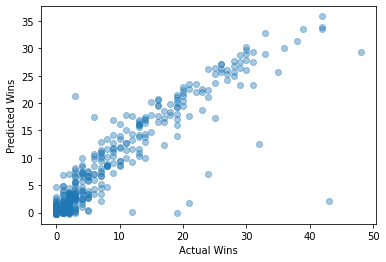

Train score for predicting Winnings from ServiceGamesWon and ReturnGamesPlayed: 0.8785502848640561
Test score for predicting Winnings from ServiceGamesWon and ReturnGamesPlayed: 0.8758523687634365 



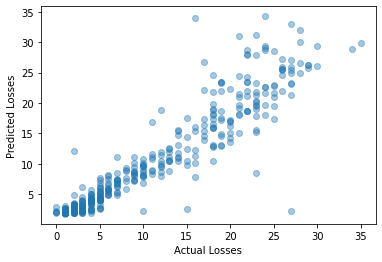

Train score for predicting Winnings from ServiceGamesWon and ReturnGamesPlayed: 0.8261384274443085
Test score for predicting Winnings from ServiceGamesWon and ReturnGamesPlayed: 0.8528742224110974 



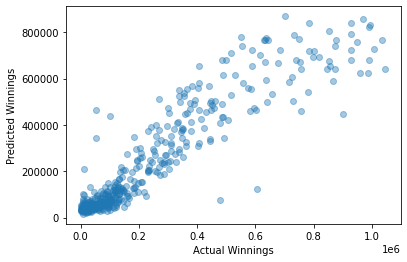

Train score for predicting Winnings from ServiceGamesWon and ReturnGamesPlayed: 0.1146695770190803
Test score for predicting Winnings from ServiceGamesWon and ReturnGamesPlayed: 0.10837018701208656 



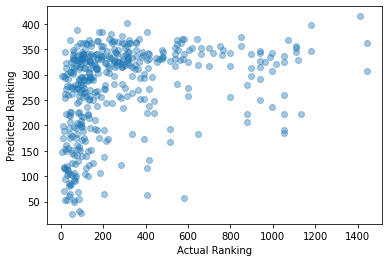

Train score for predicting Winnings from ServiceGamesWon and ReturnGamesWon: 0.22387585281386002
Test score for predicting Winnings from ServiceGamesWon and ReturnGamesWon: 0.2108702804836683 



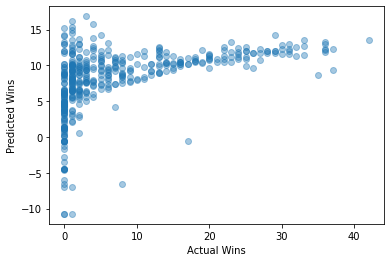

Train score for predicting Winnings from ServiceGamesWon and ReturnGamesWon: 0.20075170291240862
Test score for predicting Winnings from ServiceGamesWon and ReturnGamesWon: 0.16883557381678915 



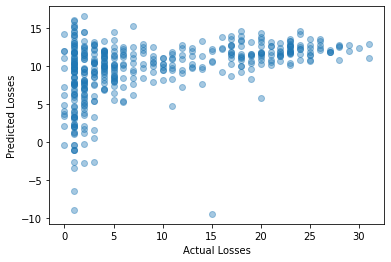

Train score for predicting Winnings from ServiceGamesWon and ReturnGamesWon: 0.2215432612749615
Test score for predicting Winnings from ServiceGamesWon and ReturnGamesWon: 0.22588313886039402 



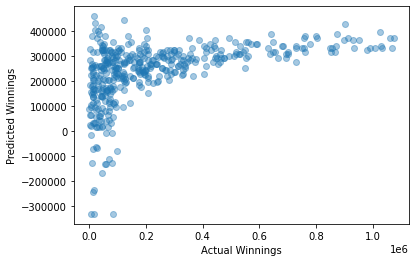

Train score for predicting Winnings from ServiceGamesWon and ReturnGamesWon: 0.05833658450147128
Test score for predicting Winnings from ServiceGamesWon and ReturnGamesWon: 0.1063926778372406 



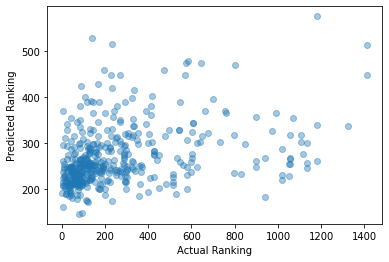

Train score for predicting Winnings from ServiceGamesWon and ReturnPointsWon: 0.21286280375871336
Test score for predicting Winnings from ServiceGamesWon and ReturnPointsWon: 0.18475450408888072 



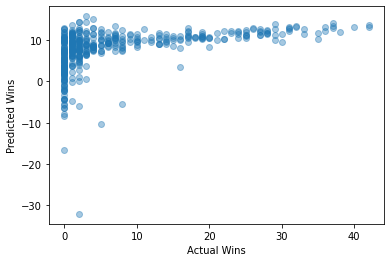

Train score for predicting Winnings from ServiceGamesWon and ReturnPointsWon: 0.18597747110664675
Test score for predicting Winnings from ServiceGamesWon and ReturnPointsWon: 0.1939791220890178 



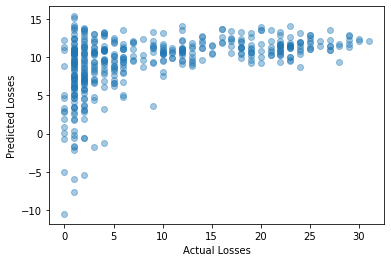

Train score for predicting Winnings from ServiceGamesWon and ReturnPointsWon: 0.20033660127306996
Test score for predicting Winnings from ServiceGamesWon and ReturnPointsWon: 0.23240955271064945 



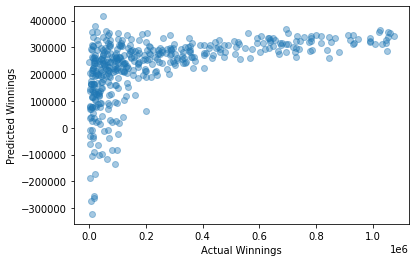

Train score for predicting Winnings from ServiceGamesWon and ReturnPointsWon: 0.069514369684191
Test score for predicting Winnings from ServiceGamesWon and ReturnPointsWon: 0.08484313990679904 



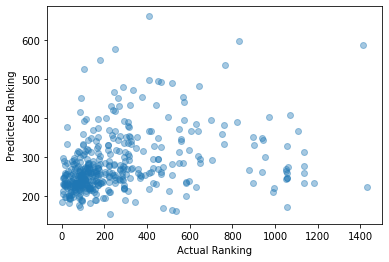

Train score for predicting Winnings from ServiceGamesWon and ServiceGamesPlayed: 0.8713369255066714
Test score for predicting Winnings from ServiceGamesWon and ServiceGamesPlayed: 0.8409797498116149 



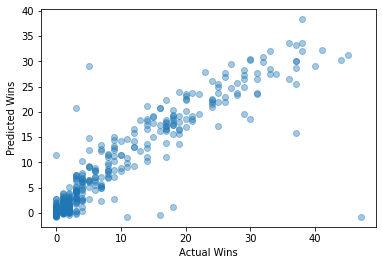

Train score for predicting Winnings from ServiceGamesWon and ServiceGamesPlayed: 0.8698929980290167
Test score for predicting Winnings from ServiceGamesWon and ServiceGamesPlayed: 0.8891184095569783 



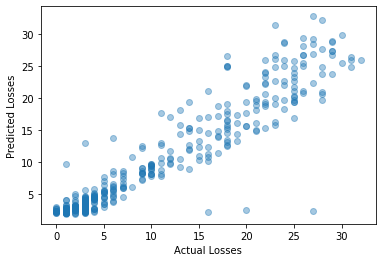

Train score for predicting Winnings from ServiceGamesWon and ServiceGamesPlayed: 0.8357209187924968
Test score for predicting Winnings from ServiceGamesWon and ServiceGamesPlayed: 0.8266547101683485 



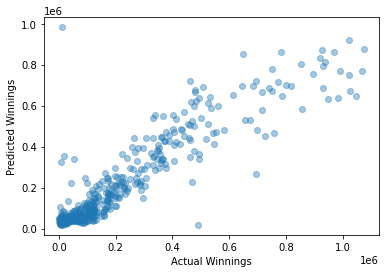

Train score for predicting Winnings from ServiceGamesWon and ServiceGamesPlayed: 0.11558374166997121
Test score for predicting Winnings from ServiceGamesWon and ServiceGamesPlayed: 0.11070231899159111 



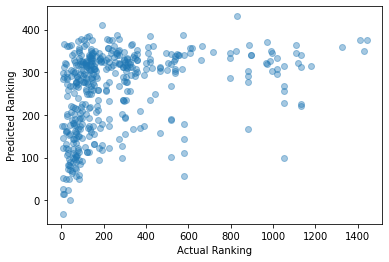

Train score for predicting Winnings from ServiceGamesWon and TotalPointsWon: 0.20707433107954376
Test score for predicting Winnings from ServiceGamesWon and TotalPointsWon: 0.24608049758594142 



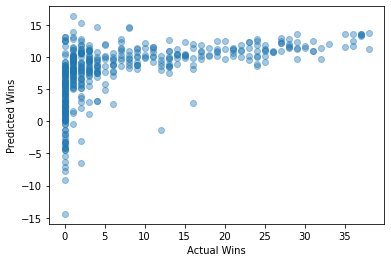

Train score for predicting Winnings from ServiceGamesWon and TotalPointsWon: 0.19344555997681875
Test score for predicting Winnings from ServiceGamesWon and TotalPointsWon: 0.16692777799713332 



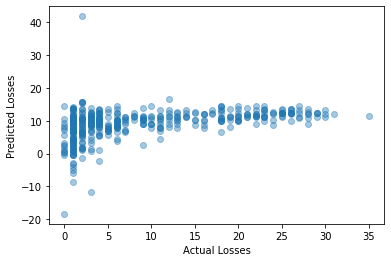

Train score for predicting Winnings from ServiceGamesWon and TotalPointsWon: 0.22506995355156556
Test score for predicting Winnings from ServiceGamesWon and TotalPointsWon: 0.19333974009367083 



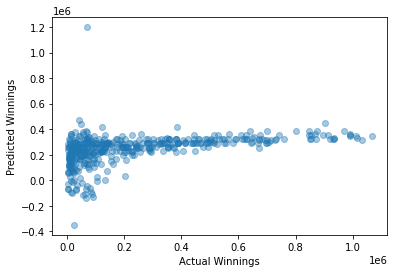

Train score for predicting Winnings from ServiceGamesWon and TotalPointsWon: 0.06554584092408777
Test score for predicting Winnings from ServiceGamesWon and TotalPointsWon: 0.10021653722337176 



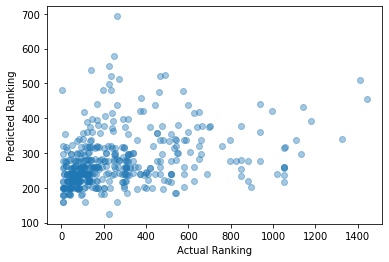

Train score for predicting Winnings from ServiceGamesWon and TotalServicePointsWon: 0.15676855954477376
Test score for predicting Winnings from ServiceGamesWon and TotalServicePointsWon: 0.17288468883750985 



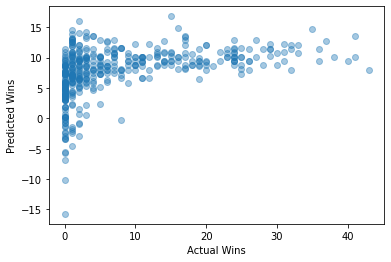

Train score for predicting Winnings from ServiceGamesWon and TotalServicePointsWon: 0.13346527240324457
Test score for predicting Winnings from ServiceGamesWon and TotalServicePointsWon: 0.15750981667167208 



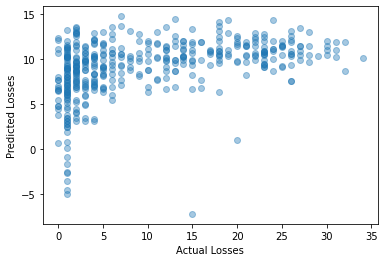

Train score for predicting Winnings from ServiceGamesWon and TotalServicePointsWon: 0.16212724098337095
Test score for predicting Winnings from ServiceGamesWon and TotalServicePointsWon: 0.18529084308781563 



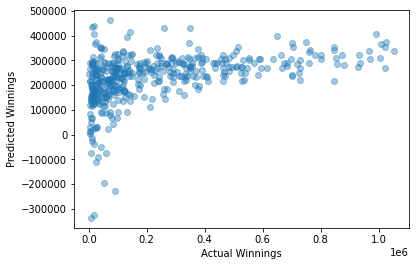

Train score for predicting Winnings from ServiceGamesWon and TotalServicePointsWon: 0.04528214646898344
Test score for predicting Winnings from ServiceGamesWon and TotalServicePointsWon: 0.03750479735945467 



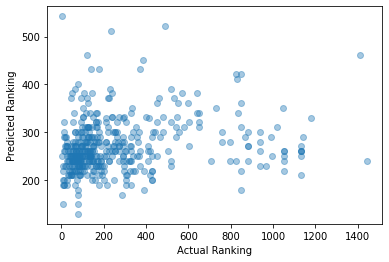

Train score for predicting Winnings from TotalPointsWon and FirstServe: 0.19368025568275016
Test score for predicting Winnings from TotalPointsWon and FirstServe: 0.24816277733929634 



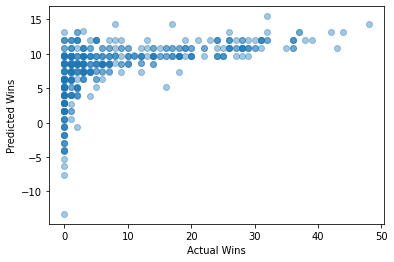

Train score for predicting Winnings from TotalPointsWon and FirstServe: 0.19651561156909936
Test score for predicting Winnings from TotalPointsWon and FirstServe: 0.11940820708651556 



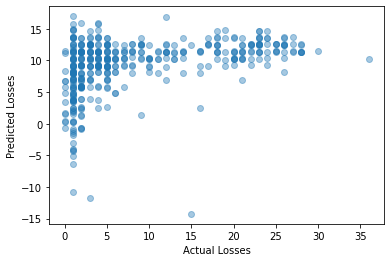

Train score for predicting Winnings from TotalPointsWon and FirstServe: 0.2112179336024933
Test score for predicting Winnings from TotalPointsWon and FirstServe: 0.21279962111471887 



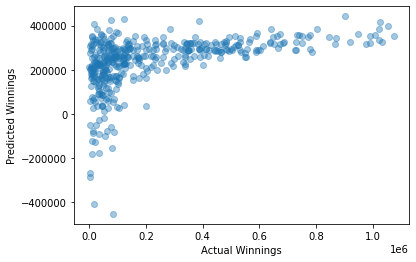

Train score for predicting Winnings from TotalPointsWon and FirstServe: 0.07117783261771504
Test score for predicting Winnings from TotalPointsWon and FirstServe: 0.08086794373905437 



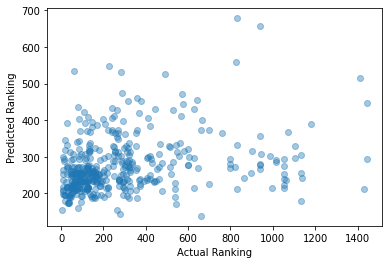

Train score for predicting Winnings from TotalPointsWon and FirstServePointsWon: 0.207035881506073
Test score for predicting Winnings from TotalPointsWon and FirstServePointsWon: 0.24519930919673874 



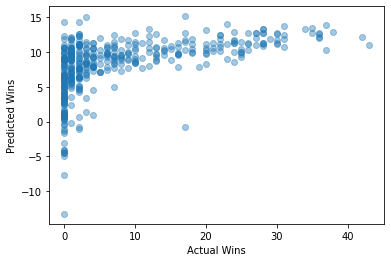

Train score for predicting Winnings from TotalPointsWon and FirstServePointsWon: 0.18082805032592367
Test score for predicting Winnings from TotalPointsWon and FirstServePointsWon: 0.20959573922726749 



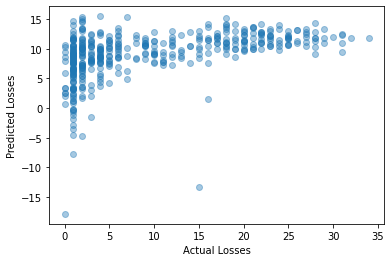

Train score for predicting Winnings from TotalPointsWon and FirstServePointsWon: 0.2043250666071843
Test score for predicting Winnings from TotalPointsWon and FirstServePointsWon: 0.25985725631935075 



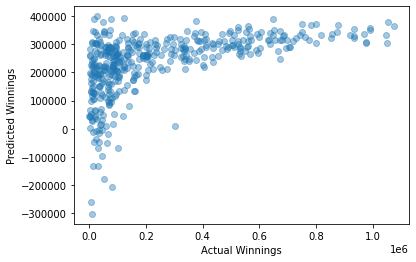

Train score for predicting Winnings from TotalPointsWon and FirstServePointsWon: 0.07465181763292106
Test score for predicting Winnings from TotalPointsWon and FirstServePointsWon: 0.07479285210680908 



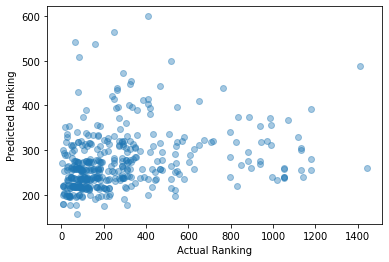

Train score for predicting Winnings from TotalPointsWon and FirstServeReturnPointsWon: 0.19639948257847883
Test score for predicting Winnings from TotalPointsWon and FirstServeReturnPointsWon: 0.25992642215054595 



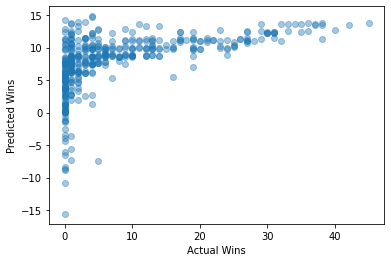

Train score for predicting Winnings from TotalPointsWon and FirstServeReturnPointsWon: 0.21043370898014835
Test score for predicting Winnings from TotalPointsWon and FirstServeReturnPointsWon: 0.10320881861563946 



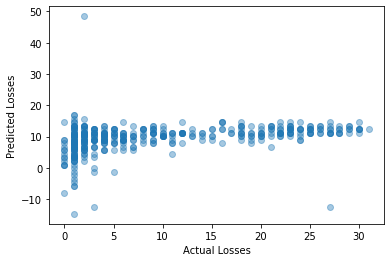

Train score for predicting Winnings from TotalPointsWon and FirstServeReturnPointsWon: 0.2123163109867021
Test score for predicting Winnings from TotalPointsWon and FirstServeReturnPointsWon: 0.2127657929536474 



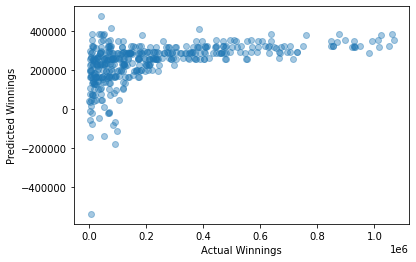

Train score for predicting Winnings from TotalPointsWon and FirstServeReturnPointsWon: 0.06669720372607901
Test score for predicting Winnings from TotalPointsWon and FirstServeReturnPointsWon: 0.09753081796741148 



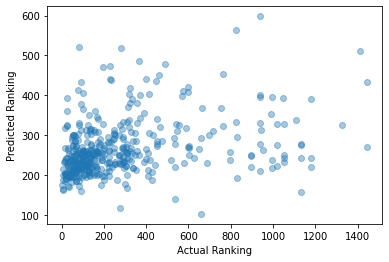

Train score for predicting Winnings from TotalPointsWon and SecondServePointsWon: 0.2052464300025737
Test score for predicting Winnings from TotalPointsWon and SecondServePointsWon: 0.22484199545407133 



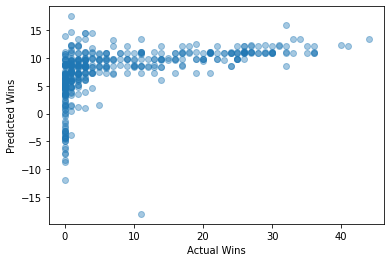

Train score for predicting Winnings from TotalPointsWon and SecondServePointsWon: 0.17061422550150374
Test score for predicting Winnings from TotalPointsWon and SecondServePointsWon: 0.216156530405766 



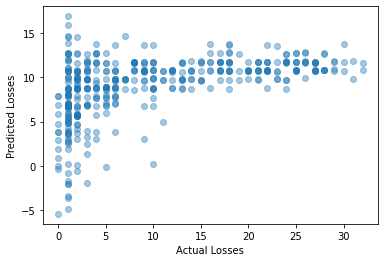

Train score for predicting Winnings from TotalPointsWon and SecondServePointsWon: 0.20987339100815938
Test score for predicting Winnings from TotalPointsWon and SecondServePointsWon: 0.20831620564899722 



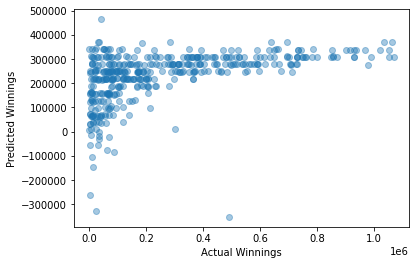

Train score for predicting Winnings from TotalPointsWon and SecondServePointsWon: 0.07196214493735353
Test score for predicting Winnings from TotalPointsWon and SecondServePointsWon: 0.07844940336682205 



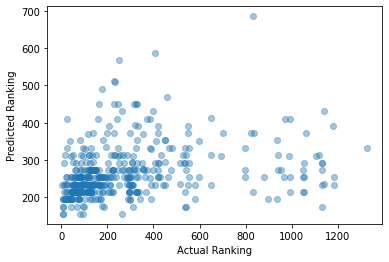

Train score for predicting Winnings from TotalPointsWon and SecondServeReturnPointsWon: 0.2173751754271186
Test score for predicting Winnings from TotalPointsWon and SecondServeReturnPointsWon: 0.18132312689650076 



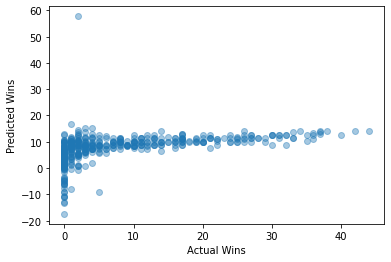

Train score for predicting Winnings from TotalPointsWon and SecondServeReturnPointsWon: 0.17883465646859886
Test score for predicting Winnings from TotalPointsWon and SecondServeReturnPointsWon: 0.19414144016544188 



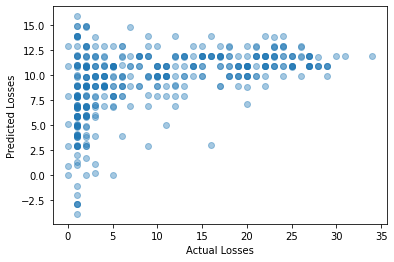

Train score for predicting Winnings from TotalPointsWon and SecondServeReturnPointsWon: 0.2167250652583885
Test score for predicting Winnings from TotalPointsWon and SecondServeReturnPointsWon: 0.19960471354934162 



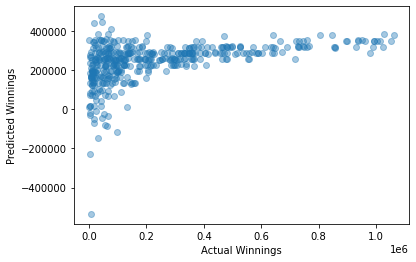

Train score for predicting Winnings from TotalPointsWon and SecondServeReturnPointsWon: 0.07922917484193592
Test score for predicting Winnings from TotalPointsWon and SecondServeReturnPointsWon: 0.06718225748913742 



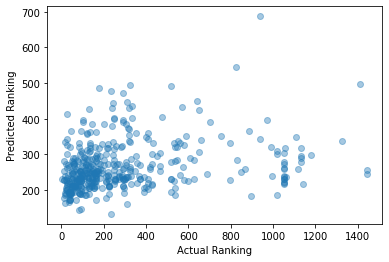

Train score for predicting Winnings from TotalPointsWon and Aces: 0.6810525268178849
Test score for predicting Winnings from TotalPointsWon and Aces: 0.7352374041340024 



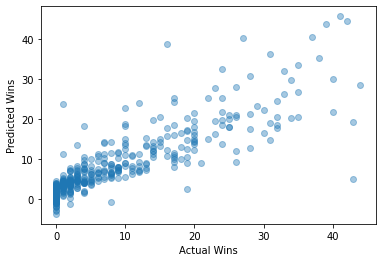

Train score for predicting Winnings from TotalPointsWon and Aces: 0.6066127275229602
Test score for predicting Winnings from TotalPointsWon and Aces: 0.5897228639590821 



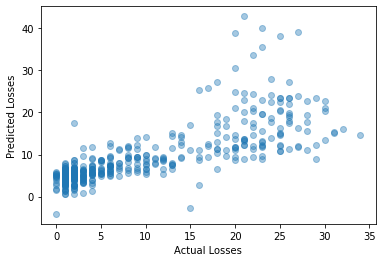

Train score for predicting Winnings from TotalPointsWon and Aces: 0.655392693527739
Test score for predicting Winnings from TotalPointsWon and Aces: 0.6517808567593115 



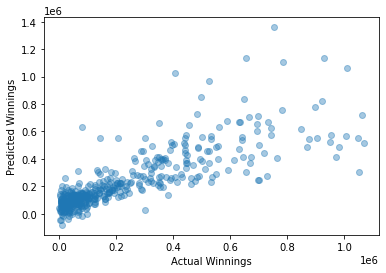

Train score for predicting Winnings from TotalPointsWon and Aces: 0.10292973212177882
Test score for predicting Winnings from TotalPointsWon and Aces: 0.11446772977680442 



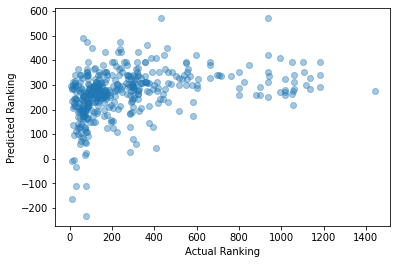

Train score for predicting Winnings from TotalPointsWon and BreakPointsConverted: 0.20149126146657426
Test score for predicting Winnings from TotalPointsWon and BreakPointsConverted: 0.24752459727160378 



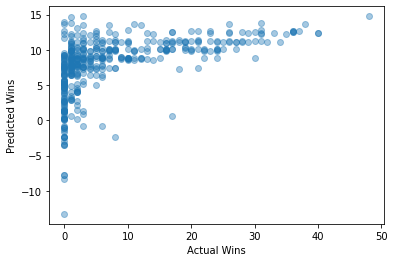

Train score for predicting Winnings from TotalPointsWon and BreakPointsConverted: 0.18499398659322575
Test score for predicting Winnings from TotalPointsWon and BreakPointsConverted: 0.18095866838127295 



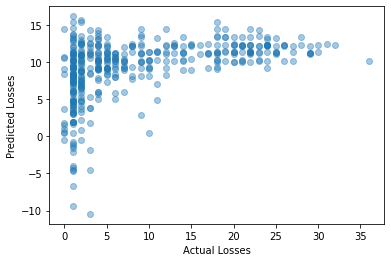

Train score for predicting Winnings from TotalPointsWon and BreakPointsConverted: 0.22141928468850613
Test score for predicting Winnings from TotalPointsWon and BreakPointsConverted: 0.19071430577188295 



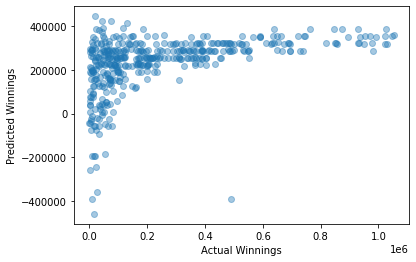

Train score for predicting Winnings from TotalPointsWon and BreakPointsConverted: 0.06874599812785698
Test score for predicting Winnings from TotalPointsWon and BreakPointsConverted: 0.08753248643806677 



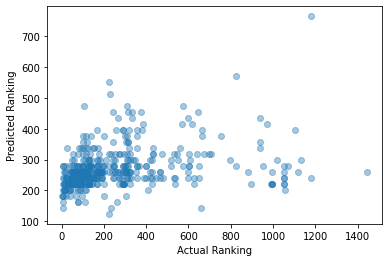

Train score for predicting Winnings from TotalPointsWon and BreakPointsFaced: 0.7857292171402207
Test score for predicting Winnings from TotalPointsWon and BreakPointsFaced: 0.7748917334217329 



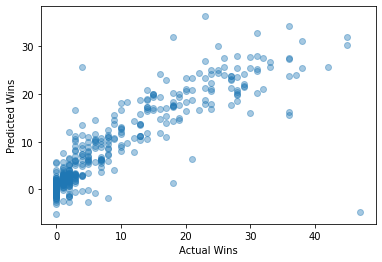

Train score for predicting Winnings from TotalPointsWon and BreakPointsFaced: 0.9016872793292843
Test score for predicting Winnings from TotalPointsWon and BreakPointsFaced: 0.8517858888516274 



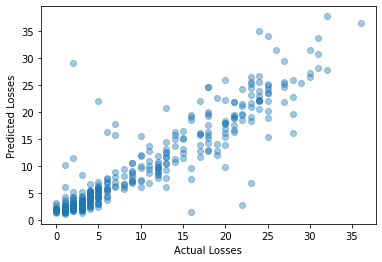

Train score for predicting Winnings from TotalPointsWon and BreakPointsFaced: 0.7750556742172764
Test score for predicting Winnings from TotalPointsWon and BreakPointsFaced: 0.7607926089334963 



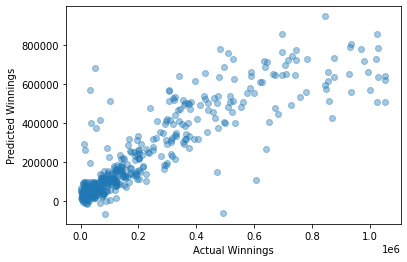

Train score for predicting Winnings from TotalPointsWon and BreakPointsFaced: 0.12988964219214894
Test score for predicting Winnings from TotalPointsWon and BreakPointsFaced: 0.09370060024196769 



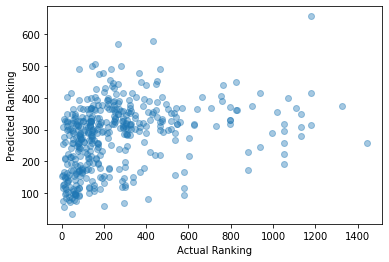

Train score for predicting Winnings from TotalPointsWon and BreakPointsOpportunities: 0.8517397681306277
Test score for predicting Winnings from TotalPointsWon and BreakPointsOpportunities: 0.8543036378874839 



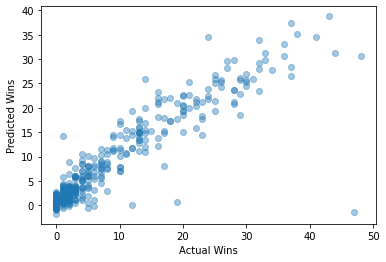

Train score for predicting Winnings from TotalPointsWon and BreakPointsOpportunities: 0.8273466823632968
Test score for predicting Winnings from TotalPointsWon and BreakPointsOpportunities: 0.8255948707347097 



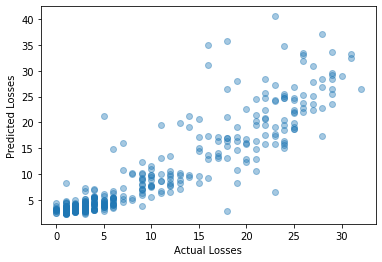

Train score for predicting Winnings from TotalPointsWon and BreakPointsOpportunities: 0.81756780828091
Test score for predicting Winnings from TotalPointsWon and BreakPointsOpportunities: 0.7950584611332414 



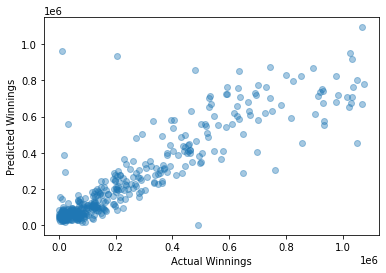

Train score for predicting Winnings from TotalPointsWon and BreakPointsOpportunities: 0.14252488834231758
Test score for predicting Winnings from TotalPointsWon and BreakPointsOpportunities: 0.07989401362188242 



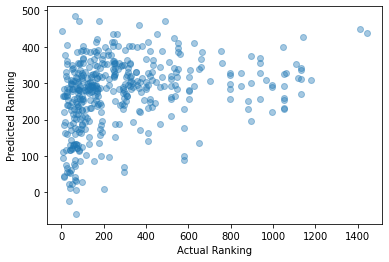

Train score for predicting Winnings from TotalPointsWon and BreakPointsSaved: 0.238921009904577
Test score for predicting Winnings from TotalPointsWon and BreakPointsSaved: 0.12484330342249306 



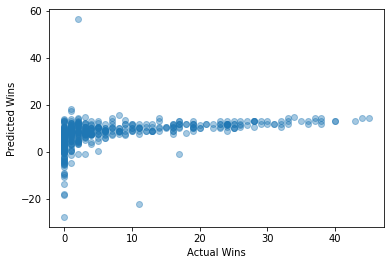

Train score for predicting Winnings from TotalPointsWon and BreakPointsSaved: 0.17567775378770034
Test score for predicting Winnings from TotalPointsWon and BreakPointsSaved: 0.21831580628757064 



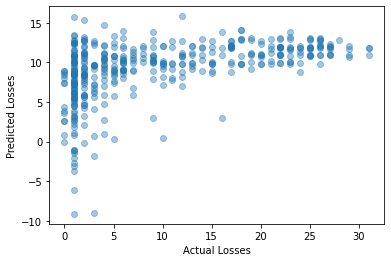

Train score for predicting Winnings from TotalPointsWon and BreakPointsSaved: 0.21095399341231988
Test score for predicting Winnings from TotalPointsWon and BreakPointsSaved: 0.226196442163067 



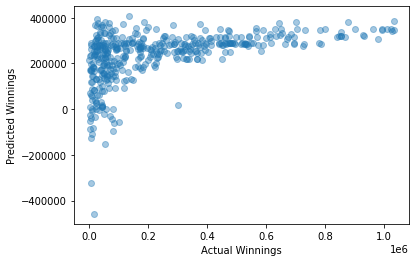

Train score for predicting Winnings from TotalPointsWon and BreakPointsSaved: 0.05679881572112477
Test score for predicting Winnings from TotalPointsWon and BreakPointsSaved: 0.10665416527825322 



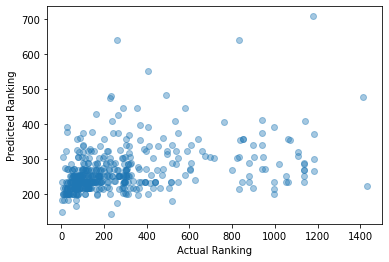

Train score for predicting Winnings from TotalPointsWon and DoubleFaults: 0.7246681449169429
Test score for predicting Winnings from TotalPointsWon and DoubleFaults: 0.7278225188120179 



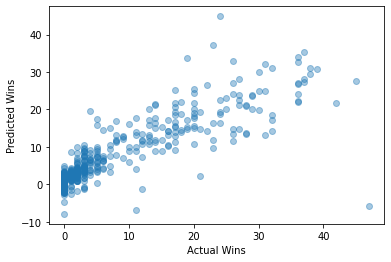

Train score for predicting Winnings from TotalPointsWon and DoubleFaults: 0.775531347459717
Test score for predicting Winnings from TotalPointsWon and DoubleFaults: 0.7905945189496475 



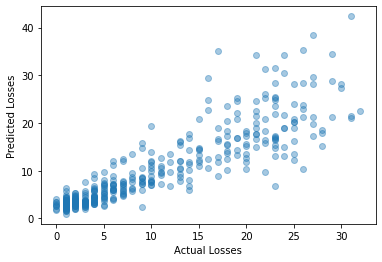

Train score for predicting Winnings from TotalPointsWon and DoubleFaults: 0.7563649845099757
Test score for predicting Winnings from TotalPointsWon and DoubleFaults: 0.6864694991527343 



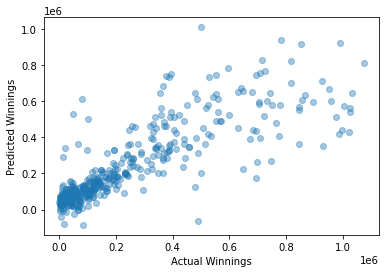

Train score for predicting Winnings from TotalPointsWon and DoubleFaults: 0.1186825426076753
Test score for predicting Winnings from TotalPointsWon and DoubleFaults: 0.10562863418890944 



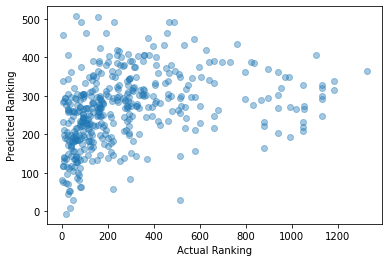

Train score for predicting Winnings from TotalPointsWon and ReturnGamesPlayed: 0.8587206532158866
Test score for predicting Winnings from TotalPointsWon and ReturnGamesPlayed: 0.8698956905653122 



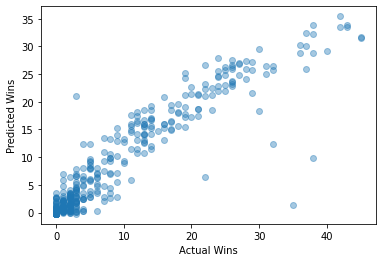

Train score for predicting Winnings from TotalPointsWon and ReturnGamesPlayed: 0.8790015454095597
Test score for predicting Winnings from TotalPointsWon and ReturnGamesPlayed: 0.8770890835808408 



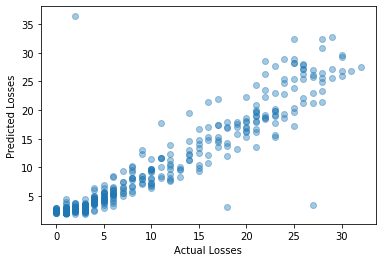

Train score for predicting Winnings from TotalPointsWon and ReturnGamesPlayed: 0.8362468391416157
Test score for predicting Winnings from TotalPointsWon and ReturnGamesPlayed: 0.8227532993212877 



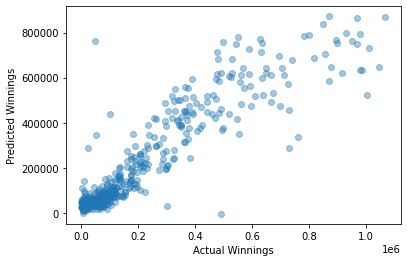

Train score for predicting Winnings from TotalPointsWon and ReturnGamesPlayed: 0.12556759620052727
Test score for predicting Winnings from TotalPointsWon and ReturnGamesPlayed: 0.12584179362232284 



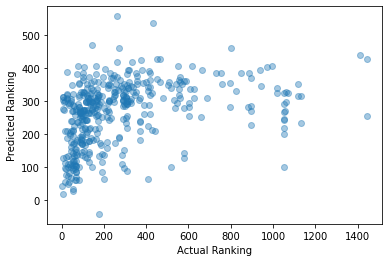

Train score for predicting Winnings from TotalPointsWon and ReturnGamesWon: 0.19483126564442654
Test score for predicting Winnings from TotalPointsWon and ReturnGamesWon: 0.2646076288658561 



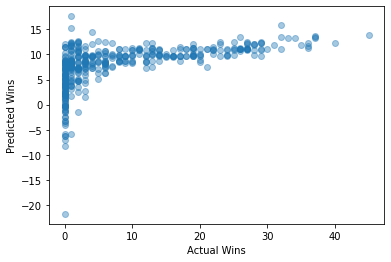

Train score for predicting Winnings from TotalPointsWon and ReturnGamesWon: 0.21288040224411853
Test score for predicting Winnings from TotalPointsWon and ReturnGamesWon: 0.07794705679715064 



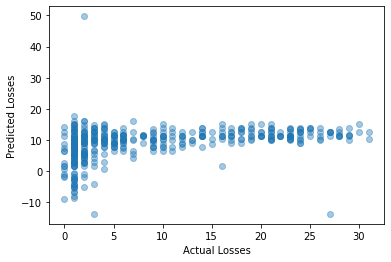

Train score for predicting Winnings from TotalPointsWon and ReturnGamesWon: 0.20927799904740285
Test score for predicting Winnings from TotalPointsWon and ReturnGamesWon: 0.22552710567326198 



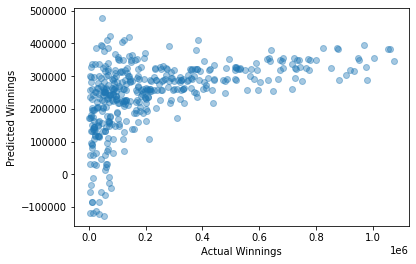

Train score for predicting Winnings from TotalPointsWon and ReturnGamesWon: 0.0922246692796519
Test score for predicting Winnings from TotalPointsWon and ReturnGamesWon: 0.025389122154643062 



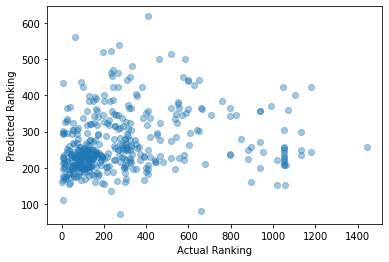

Train score for predicting Winnings from TotalPointsWon and ReturnPointsWon: 0.20005309619901712
Test score for predicting Winnings from TotalPointsWon and ReturnPointsWon: 0.24223151407160626 



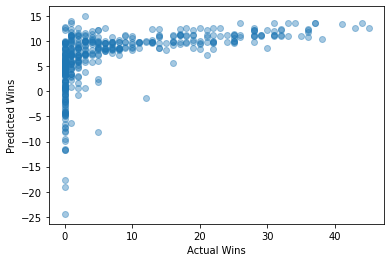

Train score for predicting Winnings from TotalPointsWon and ReturnPointsWon: 0.18376446376608035
Test score for predicting Winnings from TotalPointsWon and ReturnPointsWon: 0.1824701819018203 



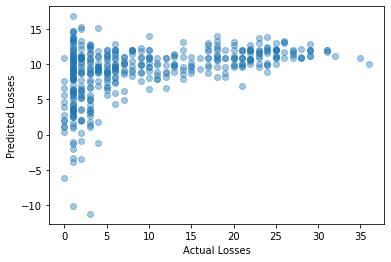

Train score for predicting Winnings from TotalPointsWon and ReturnPointsWon: 0.22841793913606245
Test score for predicting Winnings from TotalPointsWon and ReturnPointsWon: 0.13467323697744782 



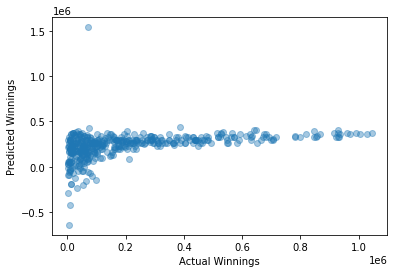

Train score for predicting Winnings from TotalPointsWon and ReturnPointsWon: 0.06266395241051237
Test score for predicting Winnings from TotalPointsWon and ReturnPointsWon: 0.11365850196809246 



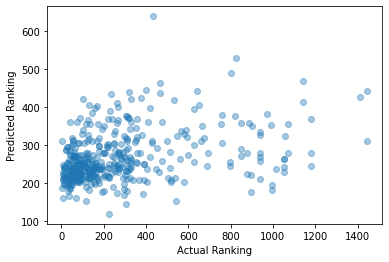

Train score for predicting Winnings from TotalPointsWon and ServiceGamesPlayed: 0.8548320286587949
Test score for predicting Winnings from TotalPointsWon and ServiceGamesPlayed: 0.890545140589233 



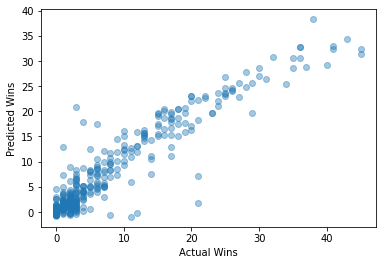

Train score for predicting Winnings from TotalPointsWon and ServiceGamesPlayed: 0.874602699446751
Test score for predicting Winnings from TotalPointsWon and ServiceGamesPlayed: 0.8778005132932828 



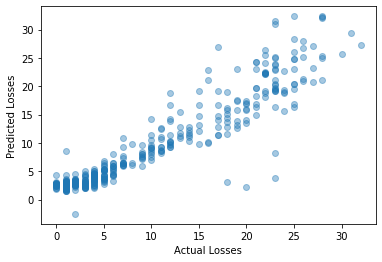

Train score for predicting Winnings from TotalPointsWon and ServiceGamesPlayed: 0.8398698864859852
Test score for predicting Winnings from TotalPointsWon and ServiceGamesPlayed: 0.815089137868292 



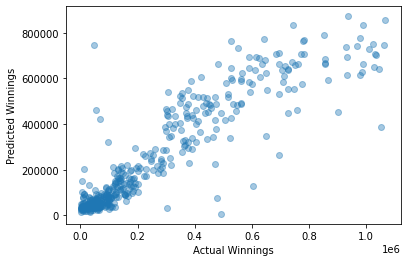

Train score for predicting Winnings from TotalPointsWon and ServiceGamesPlayed: 0.12344524816535762
Test score for predicting Winnings from TotalPointsWon and ServiceGamesPlayed: 0.131804203226501 



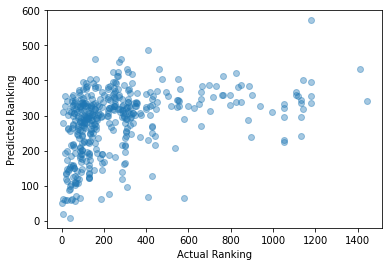

Train score for predicting Winnings from TotalPointsWon and ServiceGamesWon: 0.20922431315064094
Test score for predicting Winnings from TotalPointsWon and ServiceGamesWon: 0.22993812434621672 



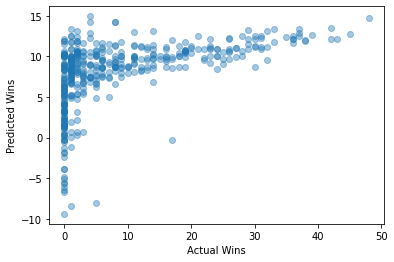

Train score for predicting Winnings from TotalPointsWon and ServiceGamesWon: 0.18970333140879111
Test score for predicting Winnings from TotalPointsWon and ServiceGamesWon: 0.1908458917150585 



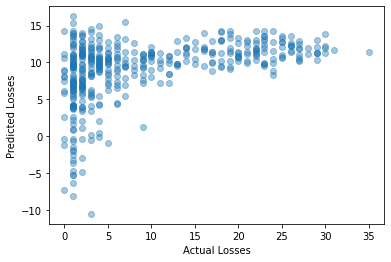

Train score for predicting Winnings from TotalPointsWon and ServiceGamesWon: 0.22352341154154554
Test score for predicting Winnings from TotalPointsWon and ServiceGamesWon: 0.204250582393804 



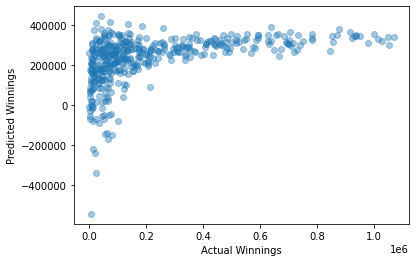

Train score for predicting Winnings from TotalPointsWon and ServiceGamesWon: 0.06905482957109643
Test score for predicting Winnings from TotalPointsWon and ServiceGamesWon: 0.08927723074164362 



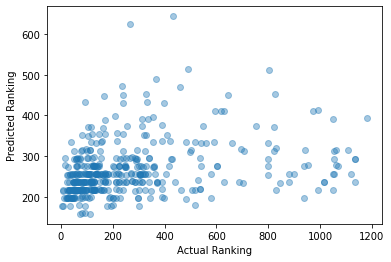

Train score for predicting Winnings from TotalPointsWon and TotalServicePointsWon: 0.21739812217299515
Test score for predicting Winnings from TotalPointsWon and TotalServicePointsWon: 0.20227913425550925 



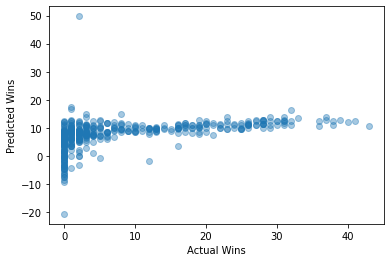

Train score for predicting Winnings from TotalPointsWon and TotalServicePointsWon: 0.19876711644714495
Test score for predicting Winnings from TotalPointsWon and TotalServicePointsWon: 0.14300212432382953 



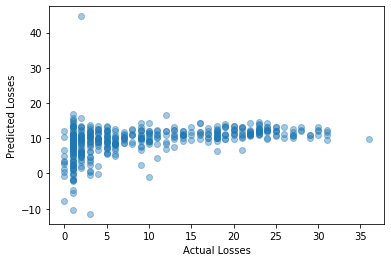

Train score for predicting Winnings from TotalPointsWon and TotalServicePointsWon: 0.2192456853267125
Test score for predicting Winnings from TotalPointsWon and TotalServicePointsWon: 0.20903068540024172 



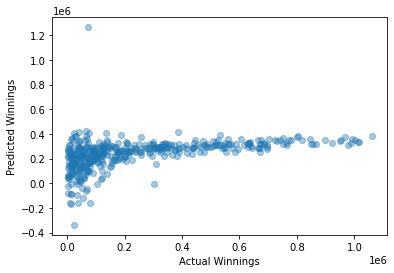

Train score for predicting Winnings from TotalPointsWon and TotalServicePointsWon: 0.08814399431534414
Test score for predicting Winnings from TotalPointsWon and TotalServicePointsWon: 0.027141663488752465 



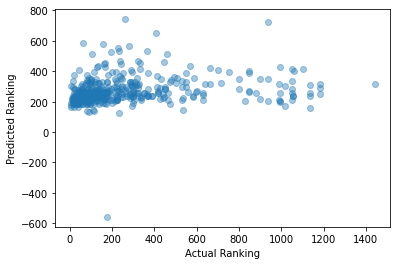

Train score for predicting Winnings from TotalServicePointsWon and FirstServe: 0.1593842920531917
Test score for predicting Winnings from TotalServicePointsWon and FirstServe: 0.15945463977135022 



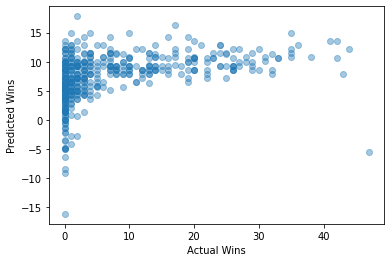

Train score for predicting Winnings from TotalServicePointsWon and FirstServe: 0.13491509447190375
Test score for predicting Winnings from TotalServicePointsWon and FirstServe: 0.1439951191577451 



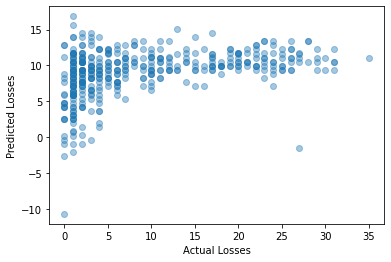

Train score for predicting Winnings from TotalServicePointsWon and FirstServe: 0.16312450923186173
Test score for predicting Winnings from TotalServicePointsWon and FirstServe: 0.17424829250818483 



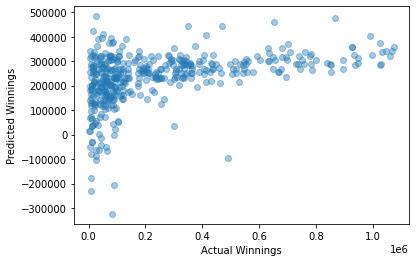

Train score for predicting Winnings from TotalServicePointsWon and FirstServe: 0.046921517221567566
Test score for predicting Winnings from TotalServicePointsWon and FirstServe: 0.03444341280822749 



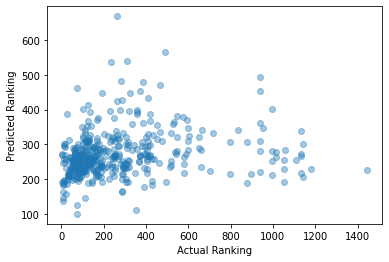

Train score for predicting Winnings from TotalServicePointsWon and FirstServePointsWon: 0.15522982147623288
Test score for predicting Winnings from TotalServicePointsWon and FirstServePointsWon: 0.17419825376832176 



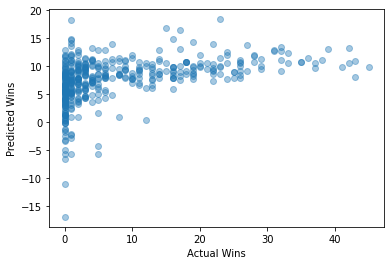

Train score for predicting Winnings from TotalServicePointsWon and FirstServePointsWon: 0.13526645420338923
Test score for predicting Winnings from TotalServicePointsWon and FirstServePointsWon: 0.1453708631824142 



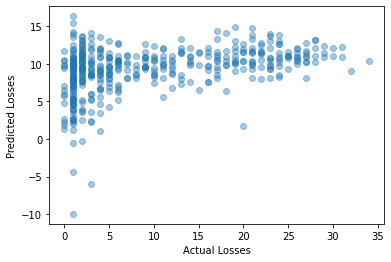

Train score for predicting Winnings from TotalServicePointsWon and FirstServePointsWon: 0.16628235483722698
Test score for predicting Winnings from TotalServicePointsWon and FirstServePointsWon: 0.16267942091666743 



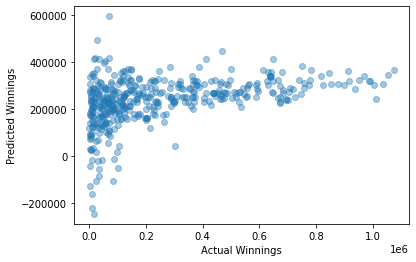

Train score for predicting Winnings from TotalServicePointsWon and FirstServePointsWon: 0.045434548294227106
Test score for predicting Winnings from TotalServicePointsWon and FirstServePointsWon: 0.04879388005480789 



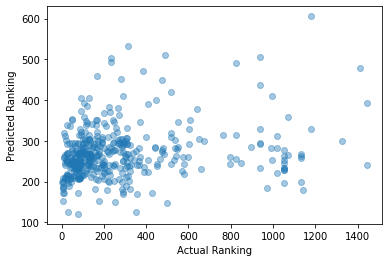

Train score for predicting Winnings from TotalServicePointsWon and FirstServeReturnPointsWon: 0.2088432255533661
Test score for predicting Winnings from TotalServicePointsWon and FirstServeReturnPointsWon: 0.23041851458584806 



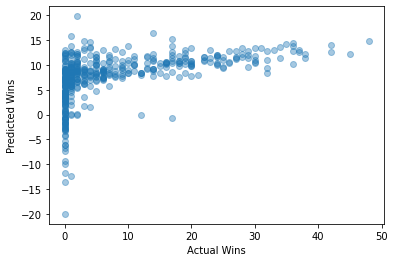

Train score for predicting Winnings from TotalServicePointsWon and FirstServeReturnPointsWon: 0.18016032780960045
Test score for predicting Winnings from TotalServicePointsWon and FirstServeReturnPointsWon: 0.2113538503661534 



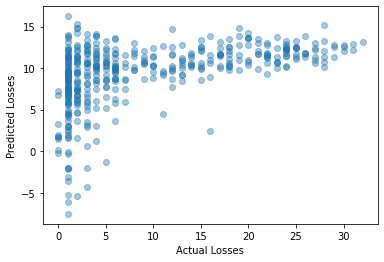

Train score for predicting Winnings from TotalServicePointsWon and FirstServeReturnPointsWon: 0.21176150700881824
Test score for predicting Winnings from TotalServicePointsWon and FirstServeReturnPointsWon: 0.2126614473922137 



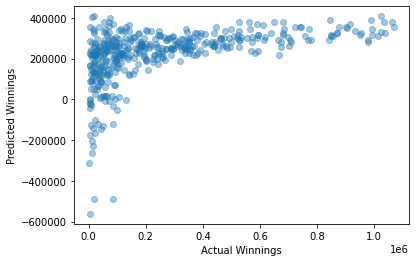

Train score for predicting Winnings from TotalServicePointsWon and FirstServeReturnPointsWon: 0.06889538377864268
Test score for predicting Winnings from TotalServicePointsWon and FirstServeReturnPointsWon: 0.07798990375547865 



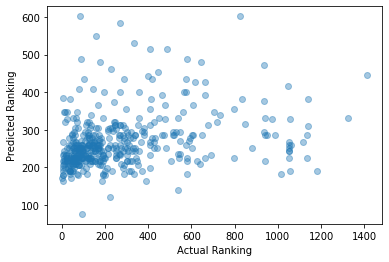

Train score for predicting Winnings from TotalServicePointsWon and SecondServePointsWon: 0.16329894017259294
Test score for predicting Winnings from TotalServicePointsWon and SecondServePointsWon: 0.14690719947881892 



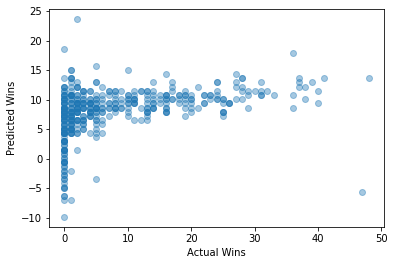

Train score for predicting Winnings from TotalServicePointsWon and SecondServePointsWon: 0.1372933358495283
Test score for predicting Winnings from TotalServicePointsWon and SecondServePointsWon: 0.1406140698176852 



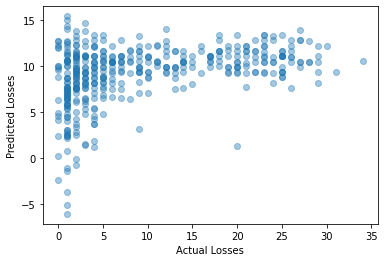

Train score for predicting Winnings from TotalServicePointsWon and SecondServePointsWon: 0.182931383452004
Test score for predicting Winnings from TotalServicePointsWon and SecondServePointsWon: 0.09852146195253164 



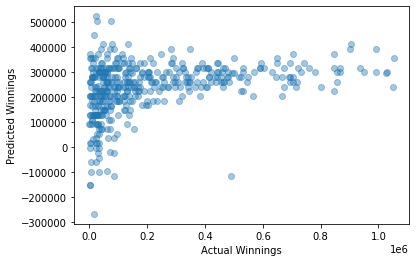

Train score for predicting Winnings from TotalServicePointsWon and SecondServePointsWon: 0.05796507039480514
Test score for predicting Winnings from TotalServicePointsWon and SecondServePointsWon: -0.004178277414484066 



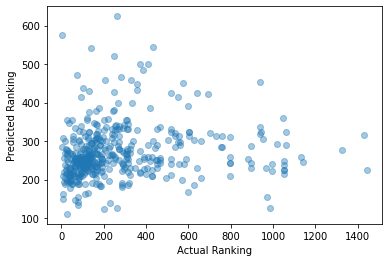

Train score for predicting Winnings from TotalServicePointsWon and SecondServeReturnPointsWon: 0.1914625015478969
Test score for predicting Winnings from TotalServicePointsWon and SecondServeReturnPointsWon: 0.178668091301464 



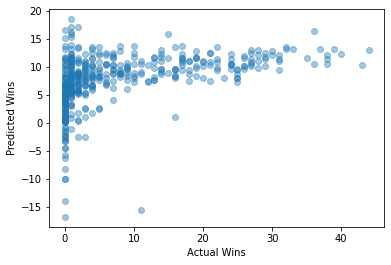

Train score for predicting Winnings from TotalServicePointsWon and SecondServeReturnPointsWon: 0.16743592993373535
Test score for predicting Winnings from TotalServicePointsWon and SecondServeReturnPointsWon: 0.15692799671232183 



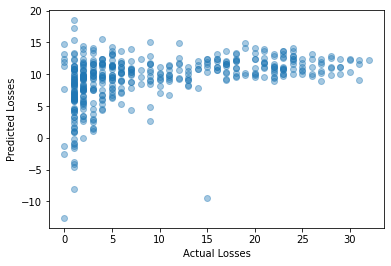

Train score for predicting Winnings from TotalServicePointsWon and SecondServeReturnPointsWon: 0.1978005066950943
Test score for predicting Winnings from TotalServicePointsWon and SecondServeReturnPointsWon: 0.1953400459048128 



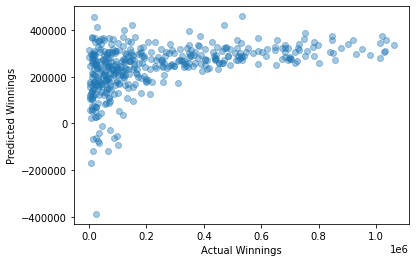

Train score for predicting Winnings from TotalServicePointsWon and SecondServeReturnPointsWon: 0.0712102174523489
Test score for predicting Winnings from TotalServicePointsWon and SecondServeReturnPointsWon: 0.040323720159023524 



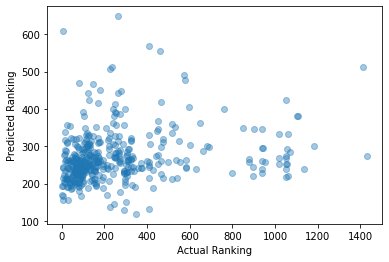

Train score for predicting Winnings from TotalServicePointsWon and Aces: 0.7039355454287234
Test score for predicting Winnings from TotalServicePointsWon and Aces: 0.6047111388304055 



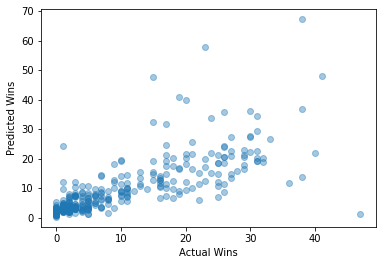

Train score for predicting Winnings from TotalServicePointsWon and Aces: 0.5879607339634936
Test score for predicting Winnings from TotalServicePointsWon and Aces: 0.5987479644852731 



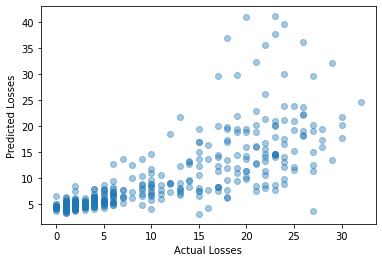

Train score for predicting Winnings from TotalServicePointsWon and Aces: 0.6327709173040614
Test score for predicting Winnings from TotalServicePointsWon and Aces: 0.6563013498072343 



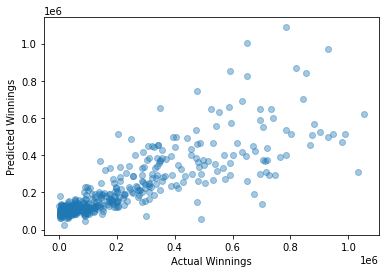

Train score for predicting Winnings from TotalServicePointsWon and Aces: 0.07349761647384012
Test score for predicting Winnings from TotalServicePointsWon and Aces: 0.11814755079337902 



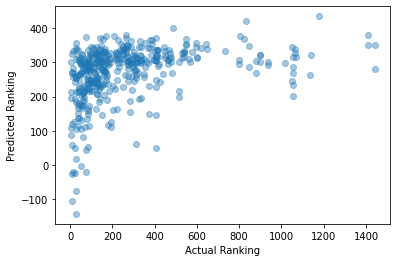

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsConverted: 0.1460200484706634
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsConverted: 0.20775931922982316 



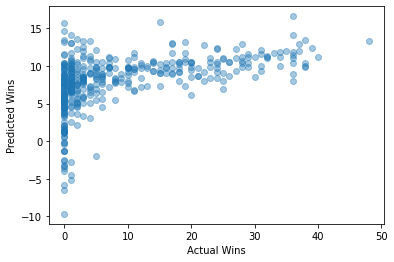

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsConverted: 0.14394775727590892
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsConverted: 0.12893144309389648 



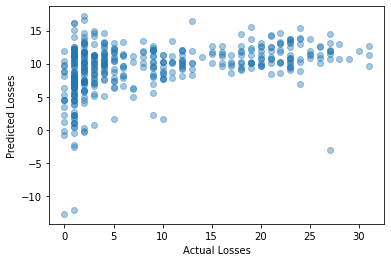

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsConverted: 0.17995433784247072
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsConverted: 0.14612470244623466 



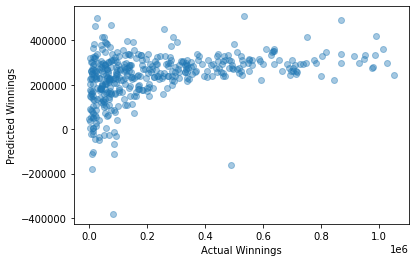

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsConverted: 0.03710757250551744
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsConverted: 0.06791152992279714 



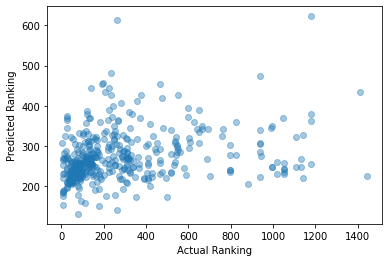

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsFaced: 0.7813931122051482
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsFaced: 0.8110290882968734 



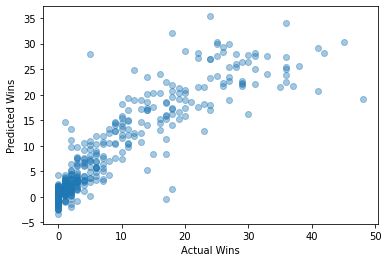

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsFaced: 0.890529192804313
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsFaced: 0.893725887491011 



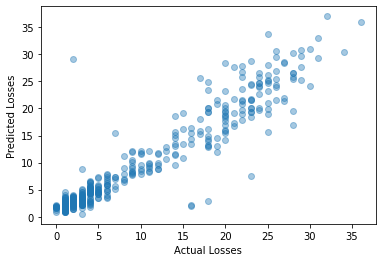

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsFaced: 0.7765117514008598
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsFaced: 0.7819592843999366 



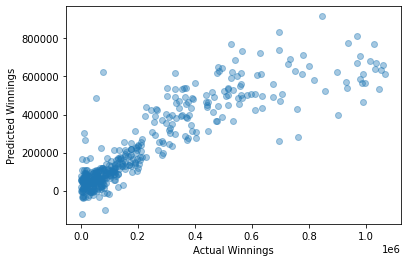

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsFaced: 0.10891406827138961
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsFaced: 0.12910655101817226 



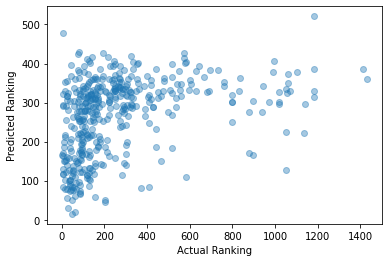

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsOpportunities: 0.8530202683873703
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsOpportunities: 0.8623423324725958 



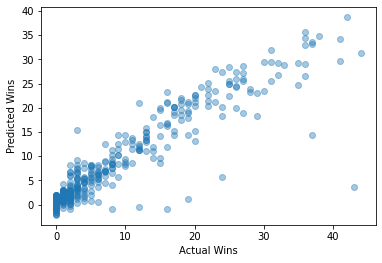

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsOpportunities: 0.8232043085370124
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsOpportunities: 0.8396185779384711 



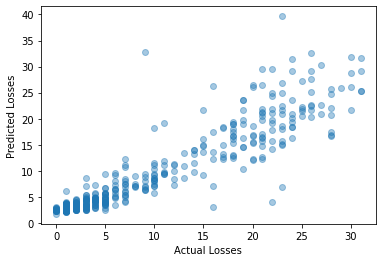

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsOpportunities: 0.8214542996118755
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsOpportunities: 0.7938311311585353 



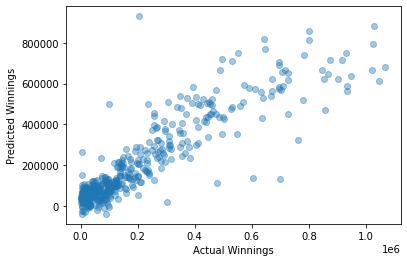

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsOpportunities: 0.11675367069482734
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsOpportunities: 0.118267098759116 



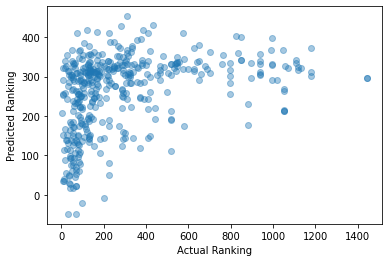

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsSaved: 0.15625631407081886
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsSaved: 0.18814563805406026 



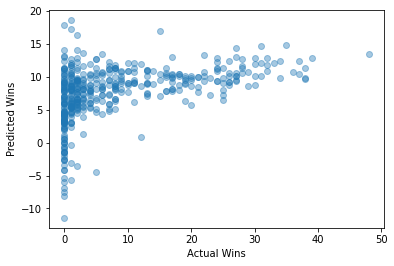

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsSaved: 0.14253165398043144
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsSaved: 0.14797163848327566 



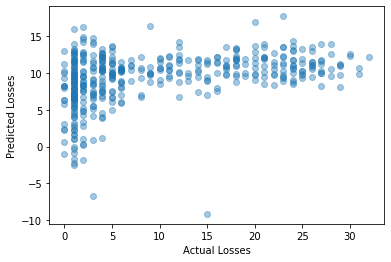

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsSaved: 0.16555978684556094
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsSaved: 0.18438154096231552 



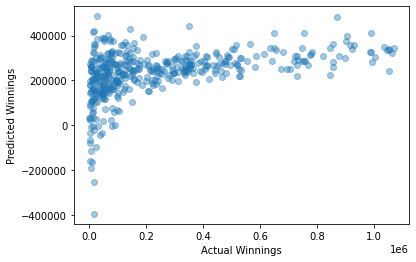

Train score for predicting Winnings from TotalServicePointsWon and BreakPointsSaved: 0.04063208506254856
Test score for predicting Winnings from TotalServicePointsWon and BreakPointsSaved: 0.052058472367910724 



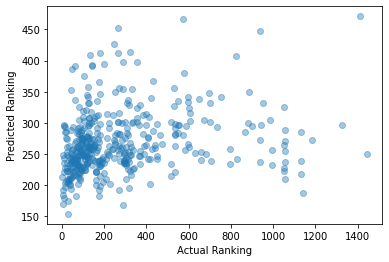

Train score for predicting Winnings from TotalServicePointsWon and DoubleFaults: 0.7337136787887266
Test score for predicting Winnings from TotalServicePointsWon and DoubleFaults: 0.6924175182247443 



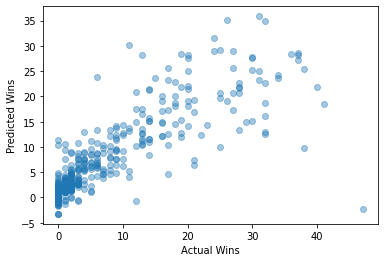

Train score for predicting Winnings from TotalServicePointsWon and DoubleFaults: 0.7691931927517585
Test score for predicting Winnings from TotalServicePointsWon and DoubleFaults: 0.8090171959642275 



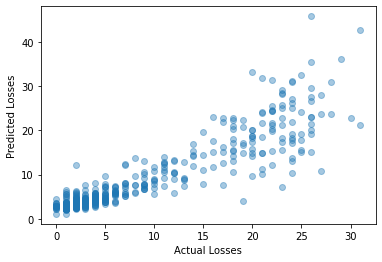

Train score for predicting Winnings from TotalServicePointsWon and DoubleFaults: 0.7487052827550508
Test score for predicting Winnings from TotalServicePointsWon and DoubleFaults: 0.7037160908488191 



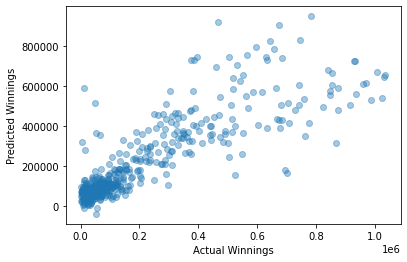

Train score for predicting Winnings from TotalServicePointsWon and DoubleFaults: 0.10839203192444014
Test score for predicting Winnings from TotalServicePointsWon and DoubleFaults: 0.08669986893032489 



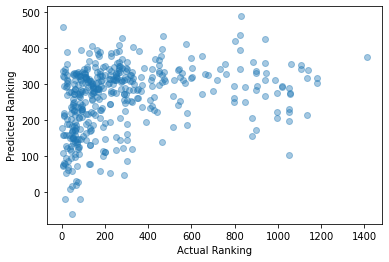

Train score for predicting Winnings from TotalServicePointsWon and ReturnGamesPlayed: 0.8537423080626075
Test score for predicting Winnings from TotalServicePointsWon and ReturnGamesPlayed: 0.8866875981314513 



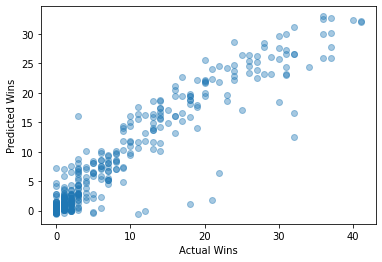

Train score for predicting Winnings from TotalServicePointsWon and ReturnGamesPlayed: 0.8827358501441558
Test score for predicting Winnings from TotalServicePointsWon and ReturnGamesPlayed: 0.8658836606668477 



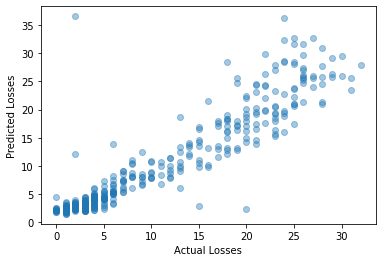

Train score for predicting Winnings from TotalServicePointsWon and ReturnGamesPlayed: 0.835408849900048
Test score for predicting Winnings from TotalServicePointsWon and ReturnGamesPlayed: 0.8265724883646924 



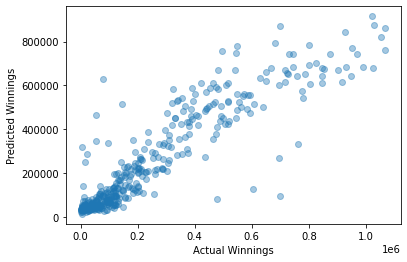

Train score for predicting Winnings from TotalServicePointsWon and ReturnGamesPlayed: 0.1280099152930564
Test score for predicting Winnings from TotalServicePointsWon and ReturnGamesPlayed: 0.07638468935158149 



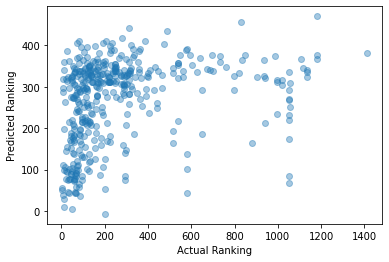

Train score for predicting Winnings from TotalServicePointsWon and ReturnGamesWon: 0.23799889083658066
Test score for predicting Winnings from TotalServicePointsWon and ReturnGamesWon: 0.23192451003239445 



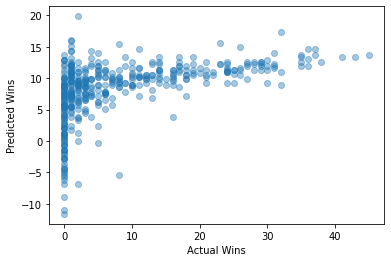

Train score for predicting Winnings from TotalServicePointsWon and ReturnGamesWon: 0.18253704791082004
Test score for predicting Winnings from TotalServicePointsWon and ReturnGamesWon: 0.25075668640729865 



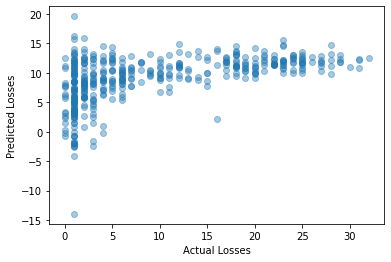

Train score for predicting Winnings from TotalServicePointsWon and ReturnGamesWon: 0.24766947743120085
Test score for predicting Winnings from TotalServicePointsWon and ReturnGamesWon: 0.19549452980933535 



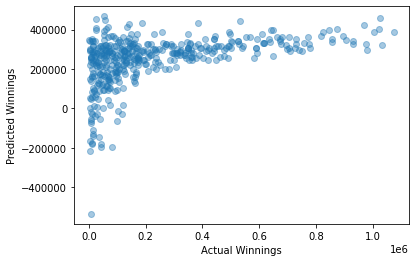

Train score for predicting Winnings from TotalServicePointsWon and ReturnGamesWon: 0.07438148093853858
Test score for predicting Winnings from TotalServicePointsWon and ReturnGamesWon: 0.08178373491514757 



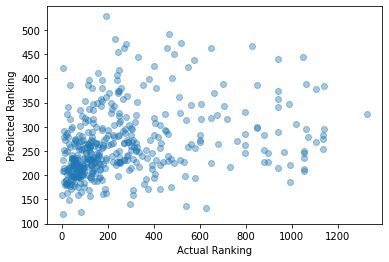

Train score for predicting Winnings from TotalServicePointsWon and ReturnPointsWon: 0.24709745666756833
Test score for predicting Winnings from TotalServicePointsWon and ReturnPointsWon: 0.1721935658222843 



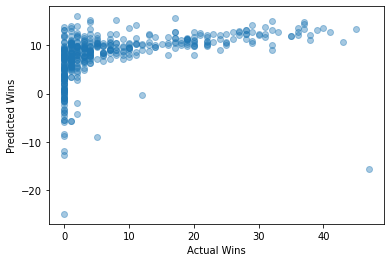

Train score for predicting Winnings from TotalServicePointsWon and ReturnPointsWon: 0.2000588294527014
Test score for predicting Winnings from TotalServicePointsWon and ReturnPointsWon: 0.18390246687282844 



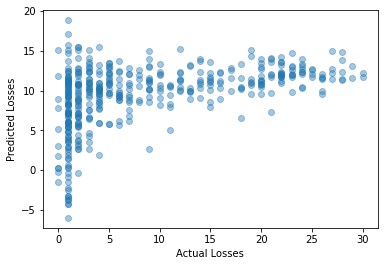

Train score for predicting Winnings from TotalServicePointsWon and ReturnPointsWon: 0.2302363020667826
Test score for predicting Winnings from TotalServicePointsWon and ReturnPointsWon: 0.22768206248220846 



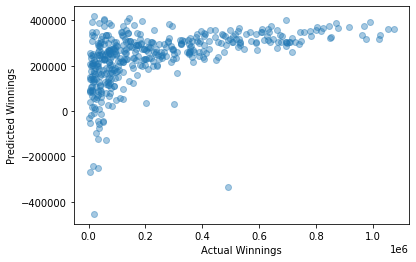

Train score for predicting Winnings from TotalServicePointsWon and ReturnPointsWon: 0.09701289507776534
Test score for predicting Winnings from TotalServicePointsWon and ReturnPointsWon: 0.03099119731334654 



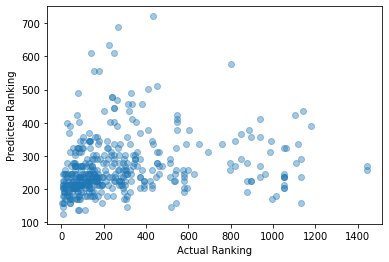

Train score for predicting Winnings from TotalServicePointsWon and ServiceGamesPlayed: 0.8632215897899947
Test score for predicting Winnings from TotalServicePointsWon and ServiceGamesPlayed: 0.8628437356092215 



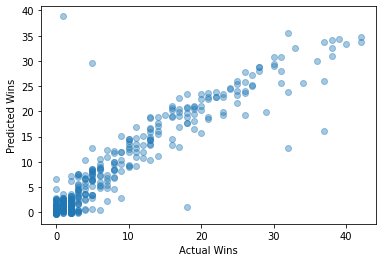

Train score for predicting Winnings from TotalServicePointsWon and ServiceGamesPlayed: 0.8730495377516014
Test score for predicting Winnings from TotalServicePointsWon and ServiceGamesPlayed: 0.883411458392106 



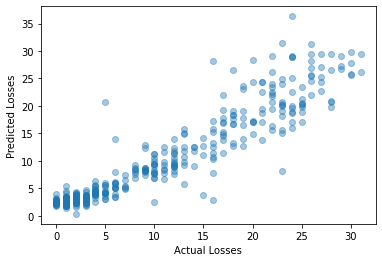

Train score for predicting Winnings from TotalServicePointsWon and ServiceGamesPlayed: 0.8428566982791342
Test score for predicting Winnings from TotalServicePointsWon and ServiceGamesPlayed: 0.7986756320083949 



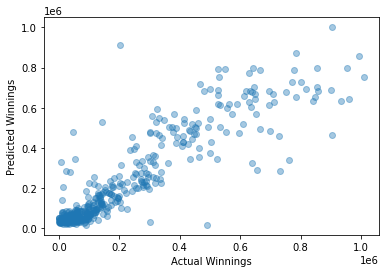

Train score for predicting Winnings from TotalServicePointsWon and ServiceGamesPlayed: 0.124321441719895
Test score for predicting Winnings from TotalServicePointsWon and ServiceGamesPlayed: 0.08596523566441838 



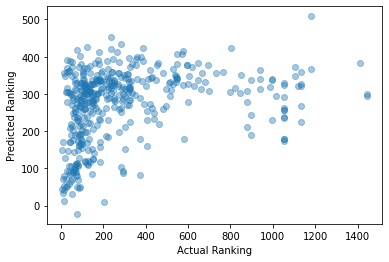

Train score for predicting Winnings from TotalServicePointsWon and ServiceGamesWon: 0.1617951543018551
Test score for predicting Winnings from TotalServicePointsWon and ServiceGamesWon: 0.1553873214445598 



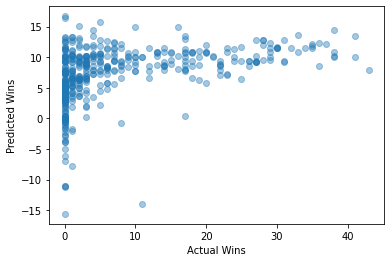

Train score for predicting Winnings from TotalServicePointsWon and ServiceGamesWon: 0.13838971525241706
Test score for predicting Winnings from TotalServicePointsWon and ServiceGamesWon: 0.14842703858896478 



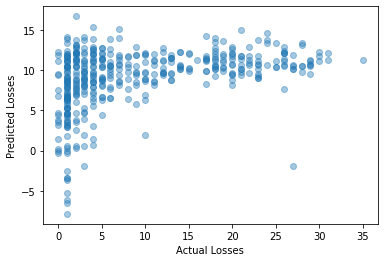

Train score for predicting Winnings from TotalServicePointsWon and ServiceGamesWon: 0.15980038372842187
Test score for predicting Winnings from TotalServicePointsWon and ServiceGamesWon: 0.1877242473567764 



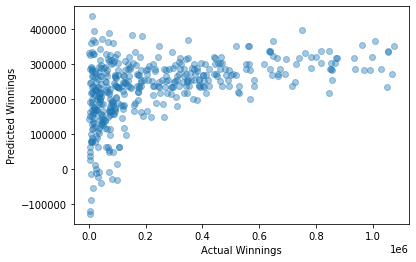

Train score for predicting Winnings from TotalServicePointsWon and ServiceGamesWon: 0.04216778282563394
Test score for predicting Winnings from TotalServicePointsWon and ServiceGamesWon: 0.044334806838963736 



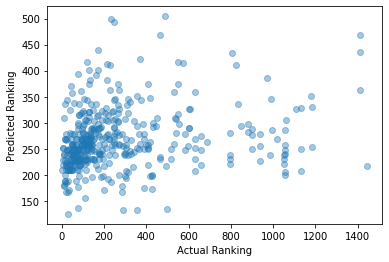

Train score for predicting Winnings from TotalServicePointsWon and TotalPointsWon: 0.21768992779975316
Test score for predicting Winnings from TotalServicePointsWon and TotalPointsWon: 0.20004746424945322 



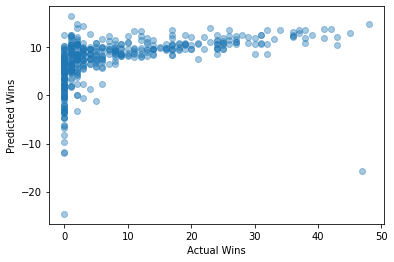

Train score for predicting Winnings from TotalServicePointsWon and TotalPointsWon: 0.18447039971296567
Test score for predicting Winnings from TotalServicePointsWon and TotalPointsWon: 0.18987272184066073 



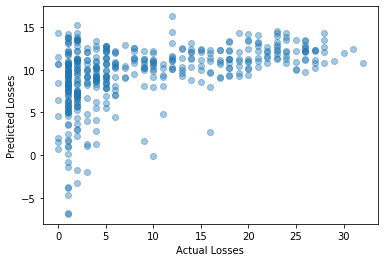

Train score for predicting Winnings from TotalServicePointsWon and TotalPointsWon: 0.21077667840331915
Test score for predicting Winnings from TotalServicePointsWon and TotalPointsWon: 0.22710910841684662 



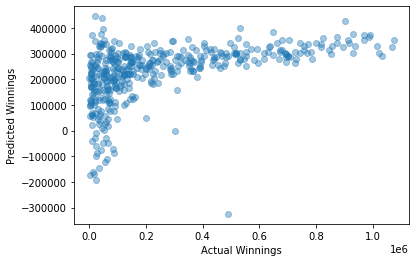

Train score for predicting Winnings from TotalServicePointsWon and TotalPointsWon: 0.07534698299337361
Test score for predicting Winnings from TotalServicePointsWon and TotalPointsWon: 0.06892221809599053 



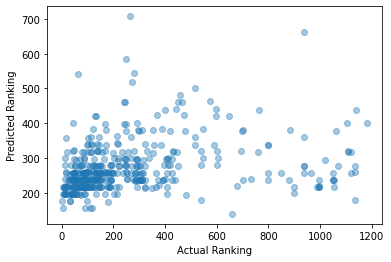

<Figure size 432x288 with 0 Axes>

In [68]:
test_train_score_two_features = []
for i in two_features:
    for j in outcomes:
        x_train, x_test, y_train, y_test = train_test_split(tennis[i], tennis[j].values.reshape(-1,1))
        lr = LinearRegression()
        lr.fit(x_train, y_train)
        y_pred = lr.predict(x_test)
        print('Train score for predicting Winnings from '+i[0]+' and '+i[1]+':',lr.score(x_train, y_train))
        print('Test score for predicting Winnings from '+i[0]+' and '+i[1]+':',lr.score(x_test, y_test), '\n')
        test_train_score_two_features.append([lr.score(x_train, y_train),lr.score(x_test, y_test), i[0]+' and '+i[1] ])
        plt.scatter(y_test, y_pred, alpha = 0.4)
        plt.xlabel('Actual '+j)
        plt.ylabel('Predicted '+j)
        plt.show()
        plt.clf()
    
    
    

In [72]:
test_train_score_two_features = []
for i in two_features:
    for j in outcomes:
        x_train, x_test, y_train, y_test = train_test_split(tennis[i], tennis[j].values.reshape(-1,1))
        lr = LinearRegression()
        lr.fit(x_train, y_train)
        y_pred = lr.predict(x_test)
        
        test_train_score_two_features.append([lr.score(x_train, y_train),lr.score(x_test, y_test), j+' vs '+i[0]+' and '+i[1] ])
        
    
    
    

In [73]:
test_train_score_two_features.sort(reverse = True)

In [74]:
test_train_score_two_features

[[0.9104578862090039,
  0.8275873035594599,
  'Losses vs BreakPointsFaced and BreakPointsConverted'],
 [0.9064471659512021,
  0.8687025688061332,
  'Losses vs ReturnGamesPlayed and BreakPointsFaced'],
 [0.9057098219941889,
  0.8652662639336546,
  'Losses vs BreakPointsFaced and ServiceGamesPlayed'],
 [0.9055175143519675,
  0.8465301561349167,
  'Losses vs BreakPointsFaced and FirstServePointsWon'],
 [0.9033884098138347,
  0.8149695719901506,
  'Losses vs ServiceGamesPlayed and Aces'],
 [0.9012866846718106,
  0.8836542691636073,
  'Losses vs BreakPointsFaced and Aces'],
 [0.9008026067151758,
  0.8527244706213069,
  'Losses vs BreakPointsFaced and TotalPointsWon'],
 [0.9006200832223817,
  0.8844319481348424,
  'Losses vs BreakPointsFaced and ReturnGamesPlayed'],
 [0.8992376543019793,
  0.8677917758882099,
  'Losses vs BreakPointsFaced and DoubleFaults'],
 [0.8949895842670021,
  0.8973817874673153,
  'Losses vs ServiceGamesPlayed and BreakPointsFaced'],
 [0.8947384876434871,
  0.875032923

In [75]:
# Considering R-squared value r >= 0.7 as a strong effect size or which means a good model,

for i in test_train_score_two_features:
    if i[0] >=0.7:
        print(i[-1])

Losses vs BreakPointsFaced and BreakPointsConverted
Losses vs ReturnGamesPlayed and BreakPointsFaced
Losses vs BreakPointsFaced and ServiceGamesPlayed
Losses vs BreakPointsFaced and FirstServePointsWon
Losses vs ServiceGamesPlayed and Aces
Losses vs BreakPointsFaced and Aces
Losses vs BreakPointsFaced and TotalPointsWon
Losses vs BreakPointsFaced and ReturnGamesPlayed
Losses vs BreakPointsFaced and DoubleFaults
Losses vs ServiceGamesPlayed and BreakPointsFaced
Losses vs BreakPointsFaced and FirstServe
Losses vs BreakPointsConverted and BreakPointsFaced
Losses vs ServiceGamesWon and BreakPointsFaced
Losses vs ServiceGamesPlayed and ReturnGamesPlayed
Wins vs ReturnGamesPlayed and Aces
Losses vs SecondServeReturnPointsWon and BreakPointsFaced
Losses vs BreakPointsFaced and BreakPointsOpportunities
Losses vs BreakPointsConverted and ServiceGamesPlayed
Wins vs BreakPointsOpportunities and FirstServeReturnPointsWon
Losses vs FirstServe and BreakPointsFaced
Losses vs DoubleFaults and BreakPoi

### Now, using all features 

0.8990868775556238
0.8519028238813459


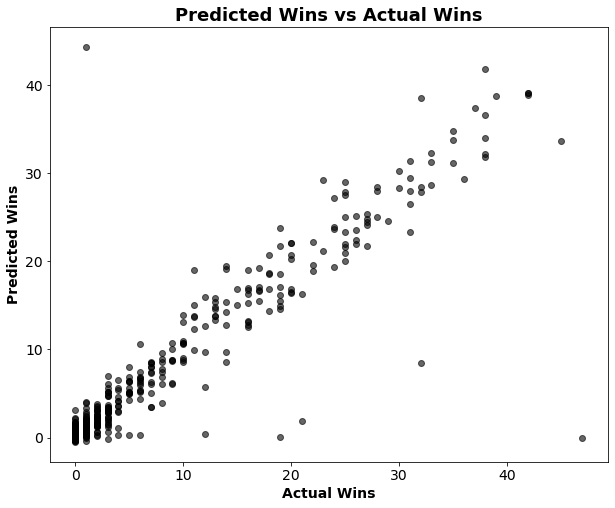

0.9106399296265326
0.92146405246746


<Figure size 432x288 with 0 Axes>

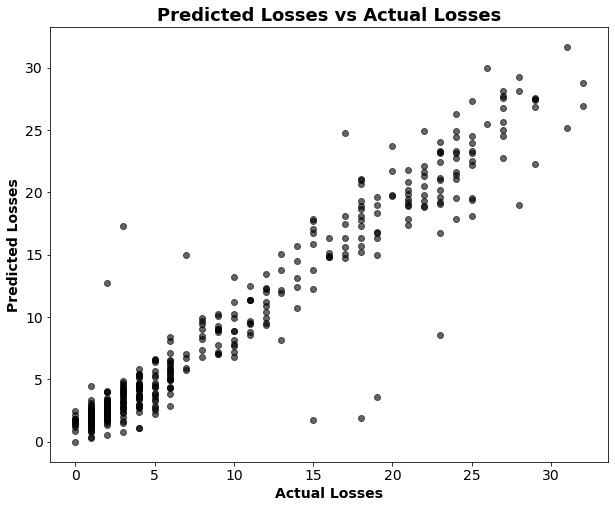

0.8360927385022465
0.8590413663213932


<Figure size 432x288 with 0 Axes>

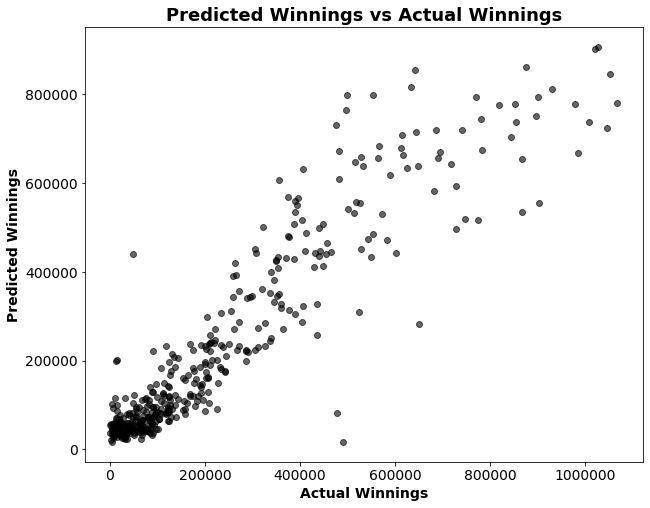

0.127892511893277
0.1302951783921471


<Figure size 432x288 with 0 Axes>

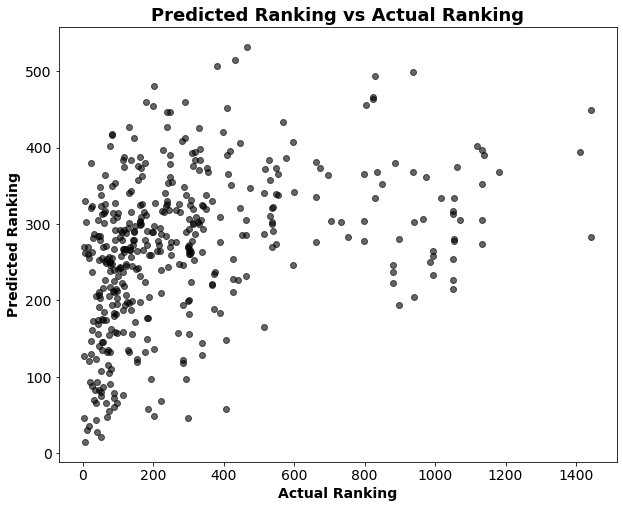

<Figure size 432x288 with 0 Axes>

In [76]:
for i in outcomes:
    x_train, x_test, y_train, y_test = train_test_split(tennis[features], tennis[i].values.reshape(-1,1))
    mlr = LinearRegression()
    mlr.fit(x_train, y_train)
    y_pred = mlr.predict(x_test)
    print(mlr.score(x_train, y_train))
    print(mlr.score(x_test, y_test))
    plt.figure(figsize = (10,8))
    plt.scatter(y_test, y_pred, alpha = 0.6, color = 'k')
    plt.xlabel('Actual '+i, fontsize = 14, fontweight = 'bold')
    plt.ylabel('Predicted '+i, fontsize = 14, fontweight = 'bold')
    plt.ticklabel_format(style = 'plain')
    plt.tick_params(labelsize = 14)
    plt.title('Predicted {} vs Actual {}'.format(i,i), fontsize = '18', fontweight= 'bold')
    plt.show()
    plt.clf()

### So, using multi-feature, though we can predict Wins, losses and Winning amounts quite well, it's a bit hard to predict Rankings